# ALL DATA GOTTEN FROM WORLD BANK MICRODATA LIBRARY API

# THIS IS FOR DATA ACQUSITION, CLEANING AND EXPLORATORY DATA ANALYSIS OF FOOD PRICE DATA

In [1]:

## FUNCTION TO CLEAN FETCHED DATA FROM API

import requests
import pandas as pd
from datetime import datetime

def fetch_nigeria_food_prices(api_url, food_items, country='Nigeria', years_back=10):
    """
    Fetches and processes Nigerian food price data from the World Bank API.
    Optimized to request only necessary fields directly from the API.

    Parameters:
    - api_url (str): The API endpoint to retrieve data from.
    - food_items (list): List of food items (e.g., 'gari', 'maize') to extract.
    - country (str): Country to filter data for. Default is 'Nigeria'.
    - years_back (int): Number of years back from the current year to include. Default is 5.

    Returns:
    - pd.DataFrame: Cleaned and reshaped dataframe with columns:
        ['State', 'Year', 'Month', 'Food_Item', 'Unit', 'Price']
    """
    limit = 10000
    offset = 0
    all_records = []

    # Identify the specific price columns for the requested food items
    close_price_columns = [f'c_{item}' for item in food_items]

    # Construct the list of fields to request from the API
    # These are the columns explicitly needed for filtering, grouping, and the final output.
    desired_api_fields = ['country', 'adm1_name', 'year', 'month', 'DATES'] + close_price_columns
    fields_param = ','.join(desired_api_fields)

    # Fetch paginated data
    while True:
        params = {
            'limit': limit,
            'offset': offset,
            'country': country,
            'fields': fields_param # <-- This is the key change! Requesting only desired fields
        }
        response = requests.get(api_url, params=params)
        if response.status_code == 200:
            data = response.json()
            if 'data' in data:
                records = data['data']
                if not records:
                    break # No more data
                all_records.extend(records)
                offset += limit
            else:
                print("No 'data' key found in the response JSON.")
                break
        else:
            print(f"Failed to fetch data. Status code: {response.status_code}")
            break

    # Load to DataFrame
    df = pd.DataFrame(all_records)

    # --- Initial Data Cleaning and Filtering ---

    # Ensure 'year' and 'month' are numeric, coerce errors to NaN
    df['year'] = pd.to_numeric(df['year'], errors='coerce')
    df['month'] = pd.to_numeric(df['month'], errors='coerce')

    # Ensure date and year filtering
    if 'DATES' in df.columns:
        df['DATES'] = pd.to_datetime(df['DATES'], errors='coerce')
        # Filter out rows where DATES, year, or month could not be parsed
        df.dropna(subset=['DATES', 'year', 'month'], inplace=True)

        current_year = datetime.now().year
        start_year = current_year - years_back
        df = df[df['year'] >= start_year].copy()
    else:
        print("Warning: 'DATES' column not found in API response. Filtering by 'year' only.")
        current_year = datetime.now().year
        start_year = current_year - years_back
        df = df[df['year'] >= start_year].copy()
        # Ensure year and month are not NaN if DATES is missing
        df.dropna(subset=['year', 'month'], inplace=True)


    # Convert price columns to numeric, coercing errors to NaN
    # We now filter based on what columns actually arrived from the API call,
    # as some requested food_items might not have data.
    actual_price_columns_in_df = [col for col in close_price_columns if col in df.columns]

    for col in actual_price_columns_in_df:
        df[col] = pd.to_numeric(df[col], errors='coerce')

    # Drop rows where all the actual price columns are NaN after conversion
    df_clean = df.dropna(subset=actual_price_columns_in_df, how='all')

    # Group by region and time, averaging prices
    groupby_cols = ['country', 'adm1_name', 'year', 'month']
    
    # Ensure all groupby columns actually exist before proceeding
    if not all(col in df_clean.columns for col in groupby_cols):
        missing = [col for col in groupby_cols if col not in df_clean.columns]
        raise ValueError(f"Essential grouping columns missing after data fetch/clean: {missing}. Check API fields and data schema.")

    df_avg = df_clean.groupby(groupby_cols)[actual_price_columns_in_df].mean().reset_index()

    # Add 'unit' column (assuming it's always '100 KG' as per original code)
    df_avg['unit'] = '100 KG'

    # Rename food columns by removing prefix and capitalizing
    df_avg.rename(columns={col: col[2:].capitalize() for col in actual_price_columns_in_df}, inplace=True)

    # Rename other useful columns
    df_avg.rename(columns={'year': 'Year', 'month': 'Month', 'unit': 'Unit'}, inplace=True)

    # Drop 'country' column as it's 'Nigeria' for all records and 'adm1_name' is more specific
    df_avg.drop('country', axis=1, inplace=True)

    # Melt from wide to long format
    id_vars_for_melt = ['adm1_name', 'Year', 'Month', 'Unit']
    
    # Ensure id_vars_for_melt columns exist in df_avg before melting
    if not all(col in df_avg.columns for col in id_vars_for_melt):
        missing = [col for col in id_vars_for_melt if col not in df_avg.columns]
        raise ValueError(f"Columns for melting (id_vars) missing: {missing}. Check previous renames or API fields.")

    df_long = pd.melt(
        df_avg,
        id_vars=id_vars_for_melt,
        var_name='Food_Item',
        value_name='Price'
    )

    # Final formatting
    df_long.rename(columns={'adm1_name': 'State'}, inplace=True)
    df_long = df_long[['State', 'Year', 'Month', 'Food_Item', 'Unit', 'Price']]
    df_long.sort_values(by=['State', 'Year', 'Month', 'Food_Item'], inplace=True)
    df_long.reset_index(drop=True, inplace=True)

    
    # Drop rows where 'Price' is NaN after melting (e.g., if a food item had no data for a period)
    df_long.dropna(subset=['Price'], inplace=True)


    return df_long

In [2]:

## FETCH & CLEAN API DATA 

import os
url = "https://microdata.worldbank.org/index.php/api/tables/data/fcv/wld_2021_rtfp_v02_m"
food_items = ['gari', 'groundnuts', 'maize', 'sorghum', "cassava_meal"]

df_fetched = fetch_nigeria_food_prices(url, food_items)

# Filter out 'Market Average' state if it exists and is not desired
df_food_prices = df_fetched[df_fetched['State'] != 'Market Average']

df_food_prices.head(100)


,State,Year,Month,Food_Item,Unit,Price
0,Abia,2015,1,Cassava_meal,100 KG,9638.49
1,Abia,2015,1,Gari,100 KG,8103.82
2,Abia,2015,1,Groundnuts,100 KG,17624.43
3,Abia,2015,1,Maize,100 KG,4994.13
4,Abia,2015,1,Sorghum,100 KG,6243.33
...,...,...,...,...,...,...
95,Abia,2016,8,Cassava_meal,100 KG,16015.72
96,Abia,2016,8,Gari,100 KG,14161.57
97,Abia,2016,8,Groundnuts,100 KG,30175.40
98,Abia,2016,8,Maize,100 KG,9508.30


In [50]:
df_food_prices.info()


<class 'pandas.core.frame.DataFrame'>
Index: 8190 entries, 0 to 8819
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   State      8190 non-null   object 
 1   Year       8190 non-null   int64  
 2   Month      8190 non-null   int64  
 3   Food_Item  8190 non-null   object 
 4   Unit       8190 non-null   object 
 5   Price      8190 non-null   float64
dtypes: float64(1), int64(2), object(3)
memory usage: 447.9+ KB


Food_Item     Cassava_meal      Gari  Groundnuts     Maize   Sorghum
Food_Item                                                           
Cassava_meal      1.000000  0.840492    0.633679  0.677541  0.674229
Gari              0.840492  1.000000    0.660012  0.720895  0.707423
Groundnuts        0.633679  0.660012    1.000000  0.724043  0.673212
Maize             0.677541  0.720895    0.724043  1.000000  0.820423
Sorghum           0.674229  0.707423    0.673212  0.820423  1.000000


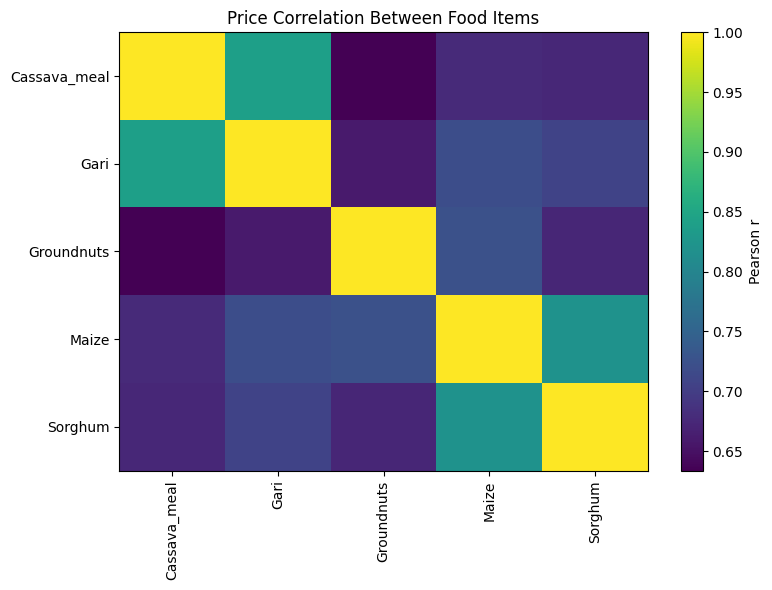

In [34]:
#CORRELATION PLOT OF HOW PRICES OF FOOD ITEMS CORRELATE WITH OTHER FOOD ITEMS

df_food_prices['Date'] = pd.to_datetime(df_food_prices[['Year','Month']].assign(DAY=1))

df_wide = df_food_prices.pivot_table(
    index=['State', 'Date'],
    columns='Food_Item',
    values='Price'
)
df_returns = df_wide.pct_change().dropna()
return_corr = df_returns.corr()
print(return_corr)

import matplotlib.pyplot as plt

plt.figure(figsize=(8,6))
plt.imshow(return_corr, interpolation='none', aspect='auto')
plt.colorbar(label='Pearson r')
plt.xticks(range(len(return_corr)), return_corr.columns, rotation=90)
plt.yticks(range(len(return_corr)), return_corr.columns)
plt.title('Price Correlation Between Food Items')
plt.tight_layout()
plt.show()


In [35]:
import numpy as np
import pandas as pd

#CORRELATION RATIO FOR HOW MUCH STATES IMPACT THE VARIABILITY OF THE FOOD PRICE
def correlation_ratio(categories, measurements):
    df2 = pd.DataFrame({"cat": categories, "x": measurements})
    grand_mean = df2["x"].mean()
    # Between‐group sum of squares
    ss_between = df2.groupby("cat")["x"]\
                    .apply(lambda g: len(g)*(g.mean() - grand_mean)**2)\
                    .sum()
    # Total sum of squares
    ss_total = ((df2["x"] - grand_mean)**2).sum()
    return np.sqrt(ss_between / ss_total)

# Example: compute η for each Food_Item
etas = {}
for item, grp in df_food_prices.groupby("Food_Item"):
    etas[item] = correlation_ratio(grp["State"], grp["Price"])
pd.Series(etas).sort_values(ascending=False)


Cassava_meal    0.616148
Gari            0.430394
Sorghum         0.361285
Groundnuts      0.234697
Maize           0.160690
dtype: float64

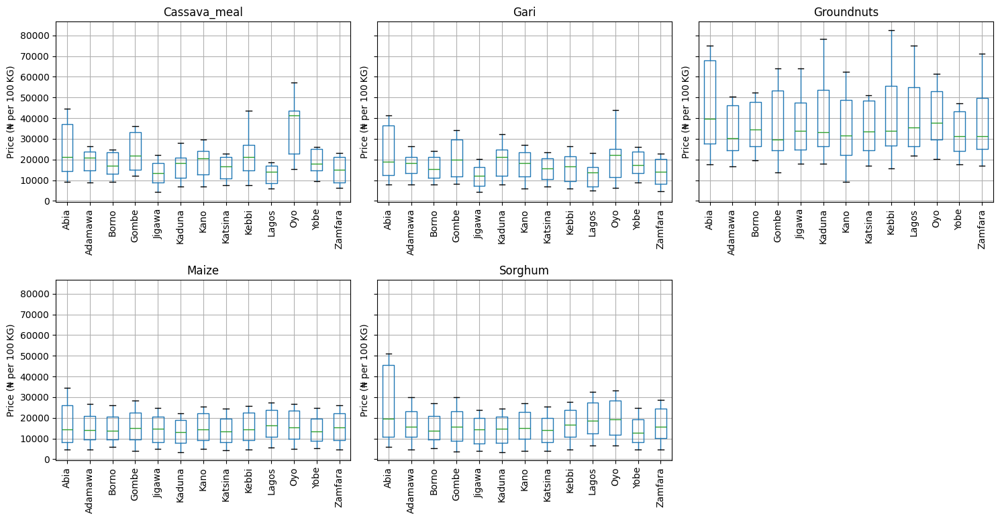

In [36]:
#BOX PLOTS TO SHOW FOOD PRICE DISTRIBUTION ACCROSS STATES

import math
items = df_food_prices['Food_Item'].unique()
n = len(items)
cols = 3                         # pick how many columns you want
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols*5, rows*4), sharey=True)
axes = axes.flatten()            # flatten in case rows*cols > n

# ——— Loop over each Food_Item ———
for ax, item in zip(axes, items):
    sub = df_food_prices[df_food_prices['Food_Item'] == item]
    # pandas boxplot onto the given axis
    sub.boxplot(column='Price', by='State', ax=ax)
    ax.set_title(item)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_xlabel('')
    ax.set_ylabel('Price (₦ per 100 KG)')

# Remove any unused subplots
for empty_ax in axes[n:]:
    fig.delaxes(empty_ax)

fig.suptitle('')               # remove the automatic “Boxplot grouped by …”
plt.tight_layout()
plt.show()

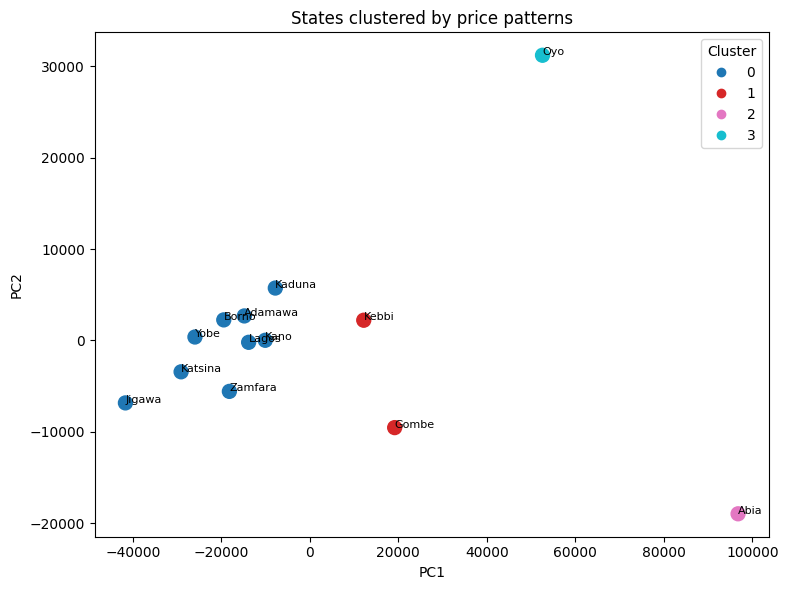

In [48]:
#clustering states by average food prices

from sklearn.cluster import KMeans

wide = df_food_prices.pivot_table(index='State', columns=['Year','Month'], values='Price')
km = KMeans(n_clusters=4, random_state=0).fit(wide.fillna(wide.mean()))
wide['cluster'] = km.labels_


from sklearn.decomposition import PCA

# drop the cluster column and any NA fill
X = wide.drop(columns='cluster').fillna(wide.mean())
pca = PCA(n_components=2)
coords = pca.fit_transform(X)

plt.figure(figsize=(8,6))
scatter = plt.scatter(coords[:,0], coords[:,1],
                      c=wide['cluster'], cmap='tab10', s=100)
for i, state in enumerate(wide.index):
    plt.text(coords[i,0]+0.1, coords[i,1]+0.1, state, fontsize=8)
plt.xlabel('PC1'); plt.ylabel('PC2')
plt.title('States clustered by price patterns')
plt.legend(*scatter.legend_elements(), title='Cluster')
plt.tight_layout()
plt.show()


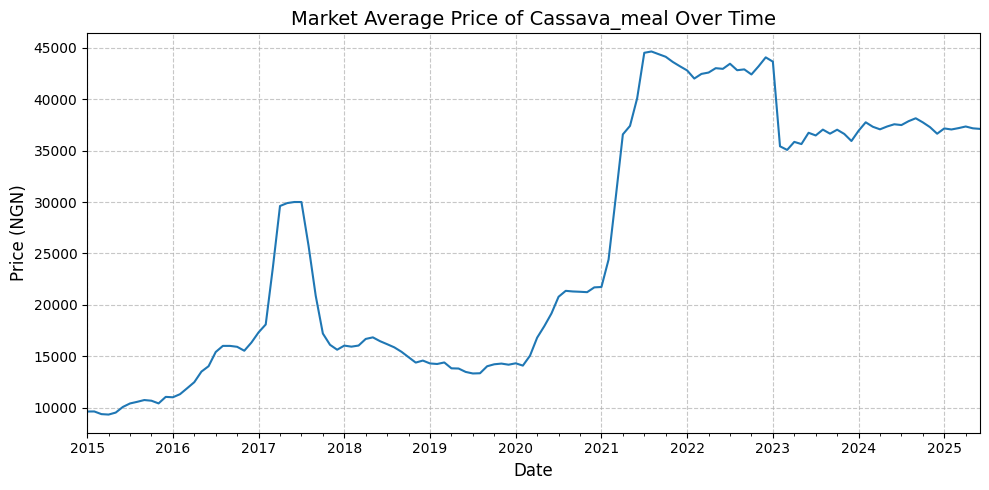

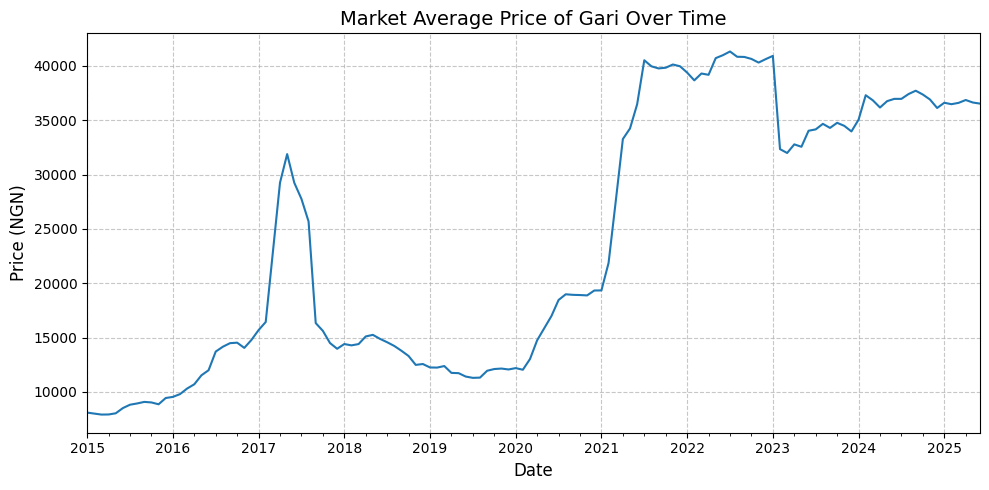

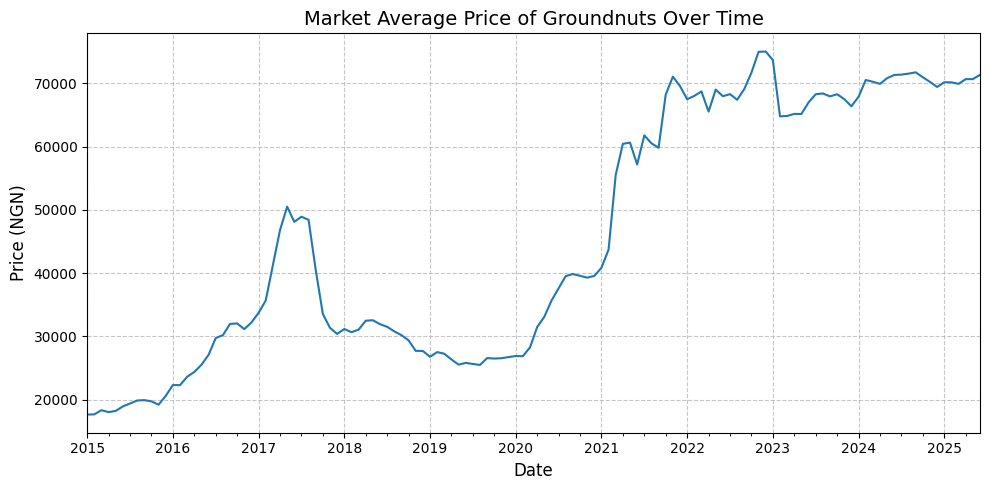

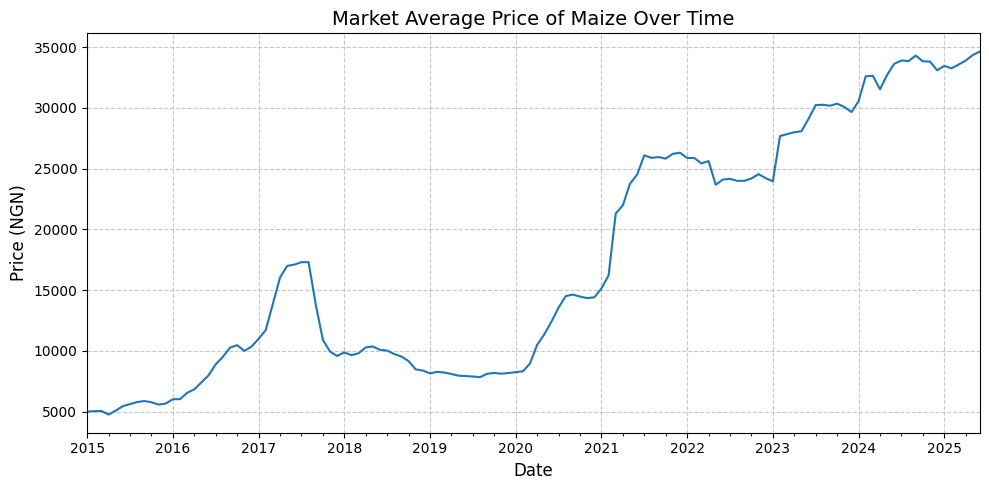

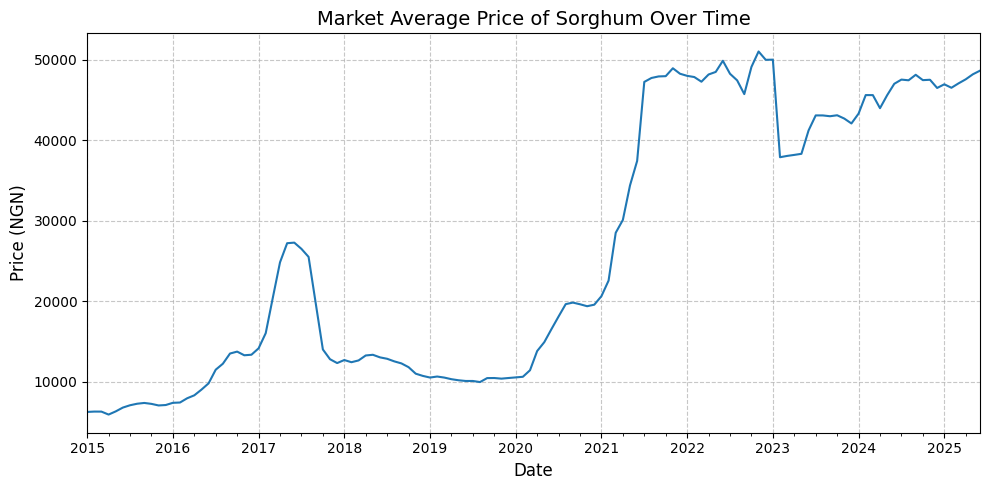


All Market Average food item price plots generated successfully!


In [63]:
#Line plot of market average food item prices over time across all states

import matplotlib.pyplot as plt

df_market_average = df_fetched[df_fetched['State'] == 'Market Average'][['State','Month', 'Year', 'Food_Item', 'Price']]

# Ensure the 'DATE' column is in datetime format for proper plotting
df_market_average['Date'] = pd.to_datetime(df_market_average[['Year', 'Month']].assign(DAY=1))

food_items_in_market_average = df_market_average['Food_Item'].unique()

# Loop through each food item to generate a separate line plot
for item in food_items_in_market_average:
    # Filter the 'Market Average' DataFrame for the current food item
    # Then, set 'Date' as the index and select the 'Price' column to get the time series
    item_series = df_market_average[df_market_average['Food_Item'] == item]\
                        .set_index('Date')['Price']

    # Create a new figure for each plot.
    plt.figure(figsize=(10, 5))

    # Plot the series
    item_series.plot(kind='line', linestyle='-') # Added marker for clarity

    # Set plot titles and labels
    plt.title(f'Market Average Price of {item} Over Time', fontsize=14)
    plt.ylabel('Price (NGN)', fontsize=12)
    plt.xlabel('Date', fontsize=12)

    # Add a grid for better readability
    plt.grid(True, linestyle='--', alpha=0.7)

    # Adjust layout to prevent labels/titles from overlapping
    plt.tight_layout()

    # Display the plot
    plt.show()

print("\nAll Market Average food item price plots generated successfully!")

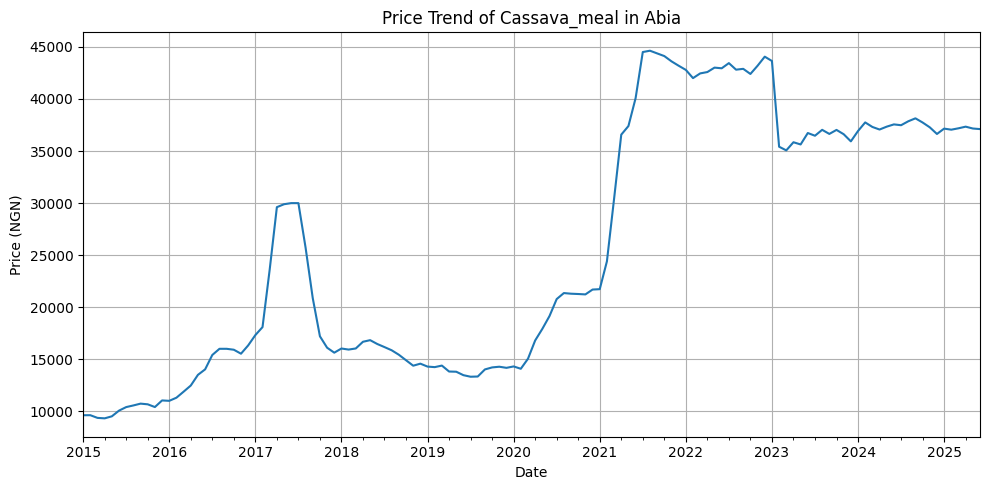

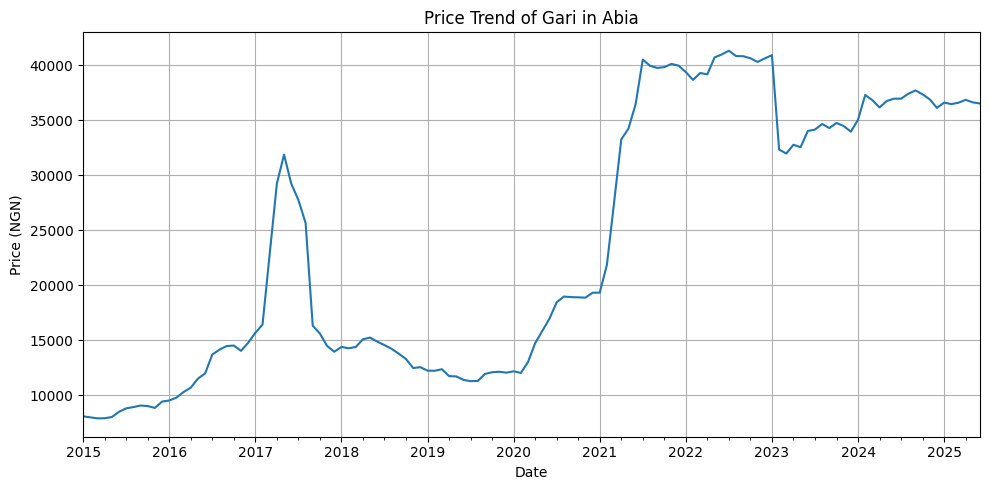

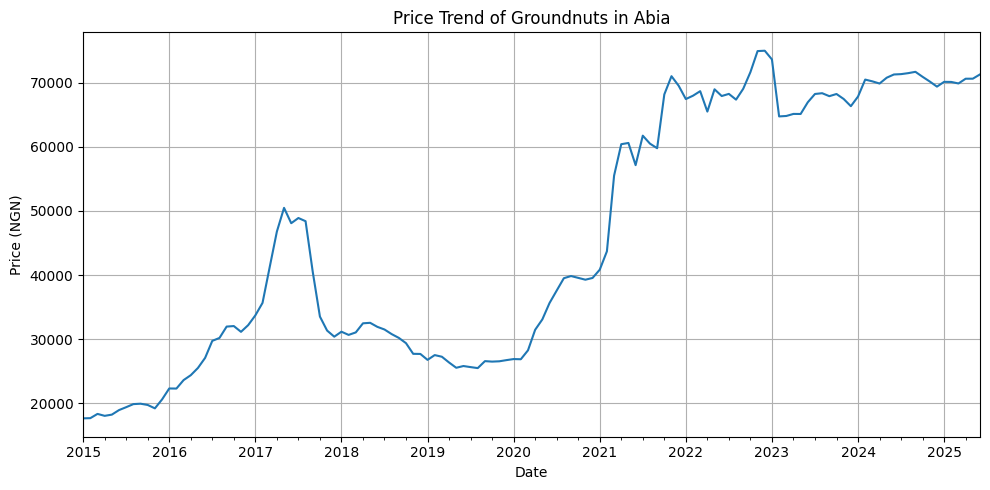

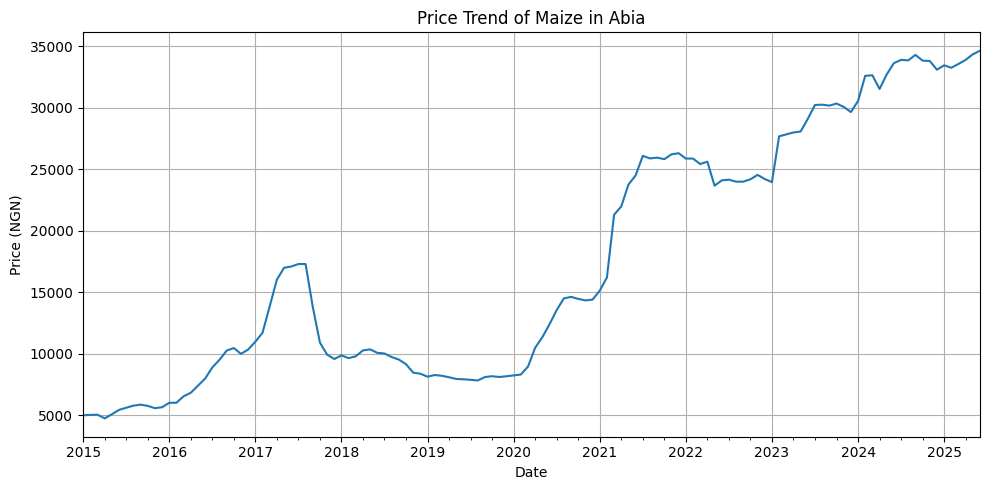

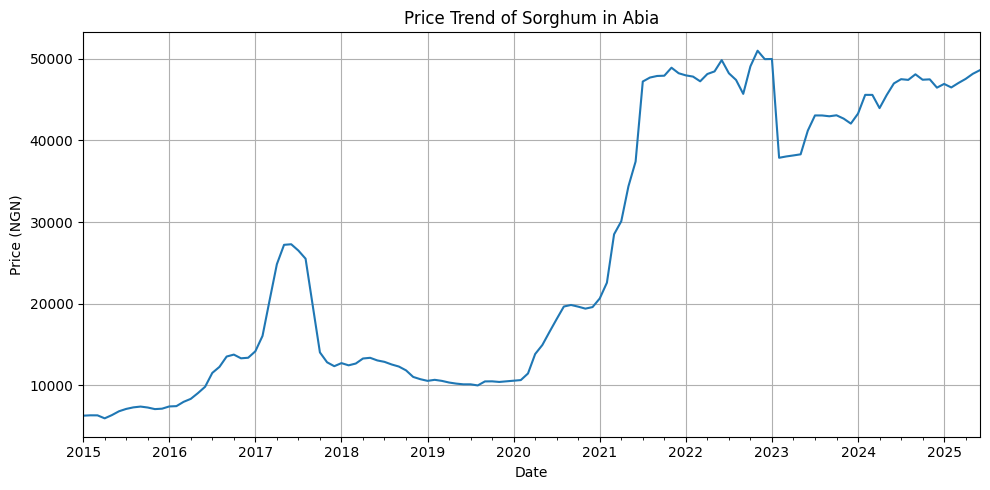

...

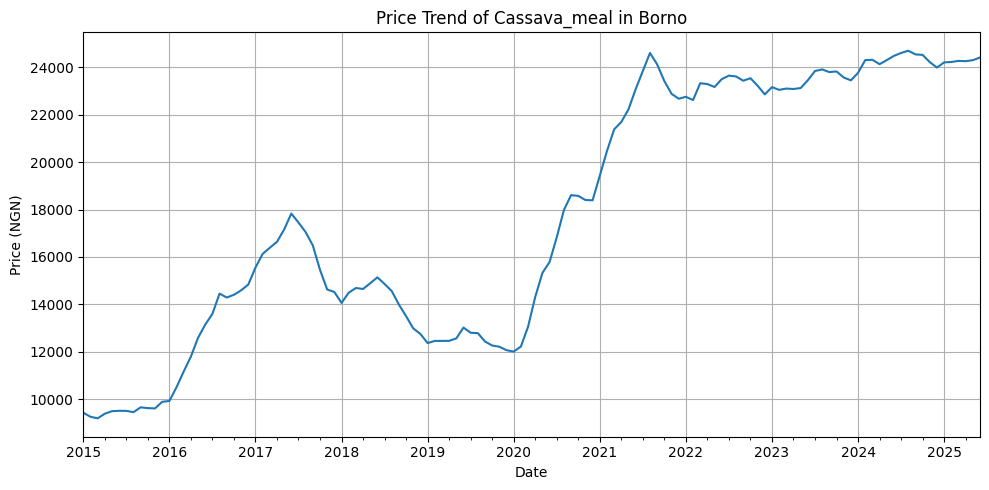

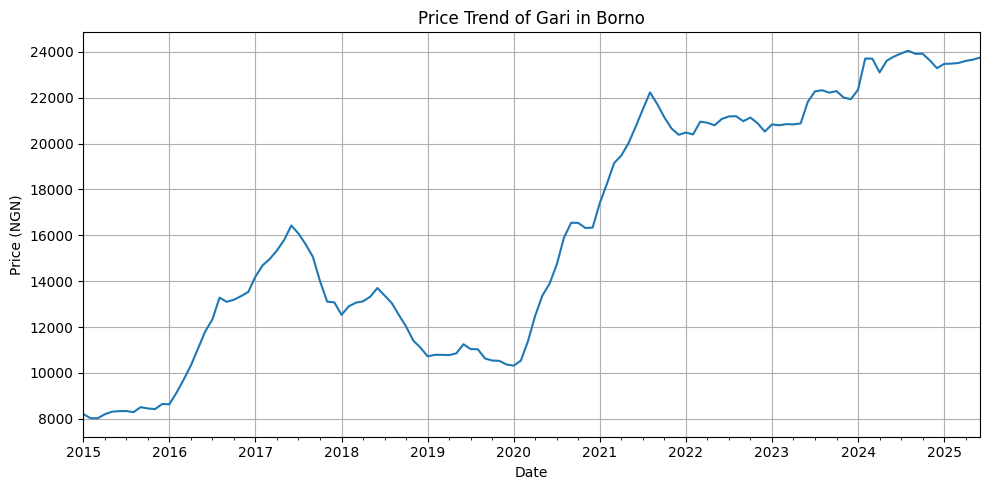

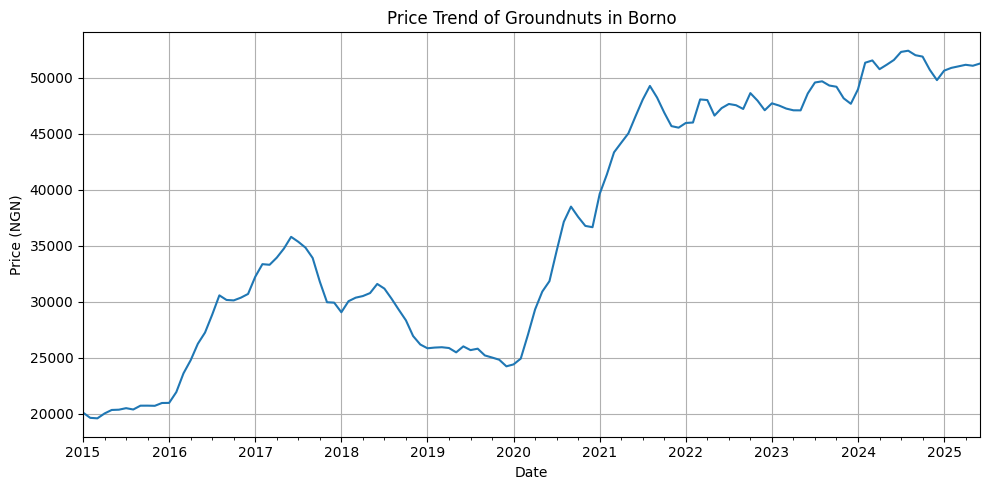

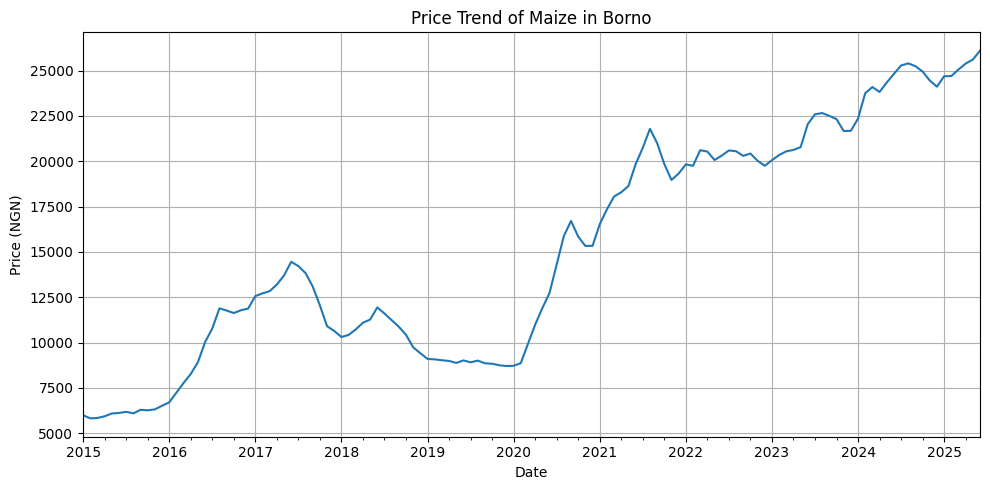

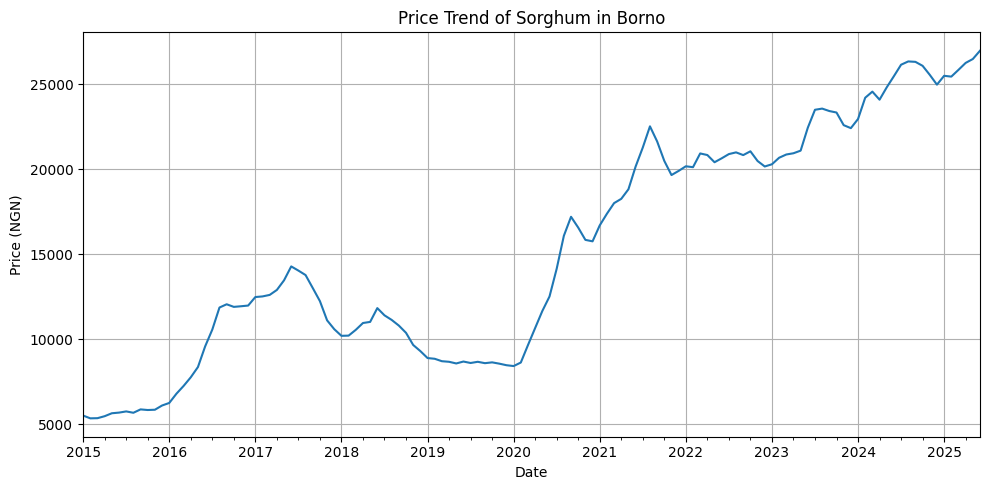

KeyboardInterrupt: 

In [49]:


import pandas as pd
import matplotlib.pyplot as plt

# Ensure 'Date' column exists
df_food_prices['Date'] = pd.to_datetime(df_food_prices[['Year', 'Month']].assign(DAY=1))

# Get unique combinations of Food_Item and State
food_states = df_food_prices[['Food_Item', 'State']].drop_duplicates()

# Loop through each combination and plot
for _, row in food_states.iterrows():
    food = row['Food_Item']
    state = row['State']

    # Filter and group
    subset = df_food_prices[(df_food_prices['Food_Item'] == food) & (df_food_prices['State'] == state)]
    time_series = subset.groupby('Date')['Price'].mean()

    # Plot
    plt.figure(figsize=(10, 5))
    time_series.plot()
    plt.title(f'Price Trend of {food} in {state}')
    plt.xlabel('Date')
    plt.ylabel('Price (NGN)')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [ ]:
#bar chart of avg food prices by state

import seaborn as sns
import matplotlib.pyplot as plt

# Group and average
avg_prices = df_food_prices.groupby(['State', 'Food_Item'])['Price'].mean().reset_index()

# Barplot
plt.figure(figsize=(14, 6))
sns.barplot(data=avg_prices, x='State', y='Price', hue='Food_Item')
plt.title('Average Food Prices by State')
plt.xticks(rotation=90)
plt.ylabel('Average Price (NGN)')
plt.tight_layout()
plt.show()



--- Analyzing: Gari in Abia ---
Observations for Gari in Abia: 126


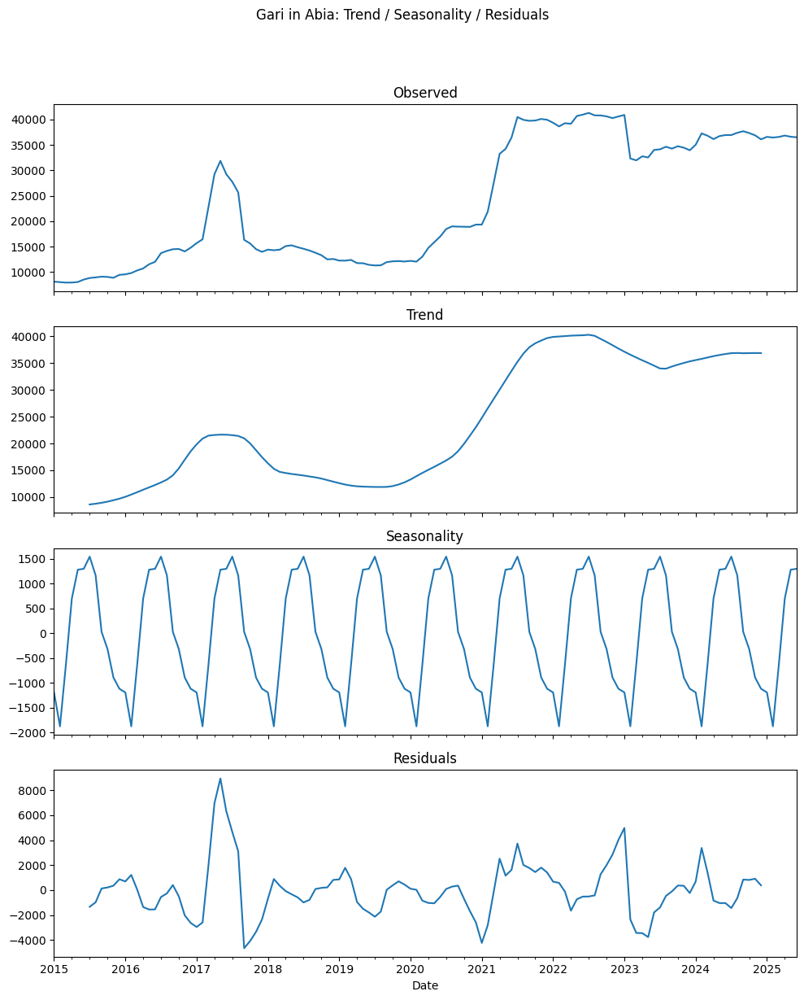

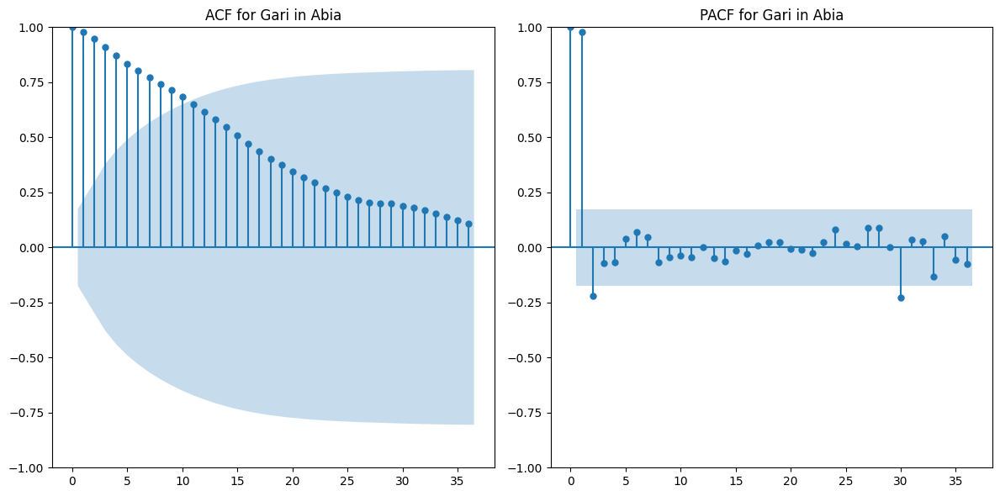


--- Analyzing: Gari in Adamawa ---
Observations for Gari in Adamawa: 126


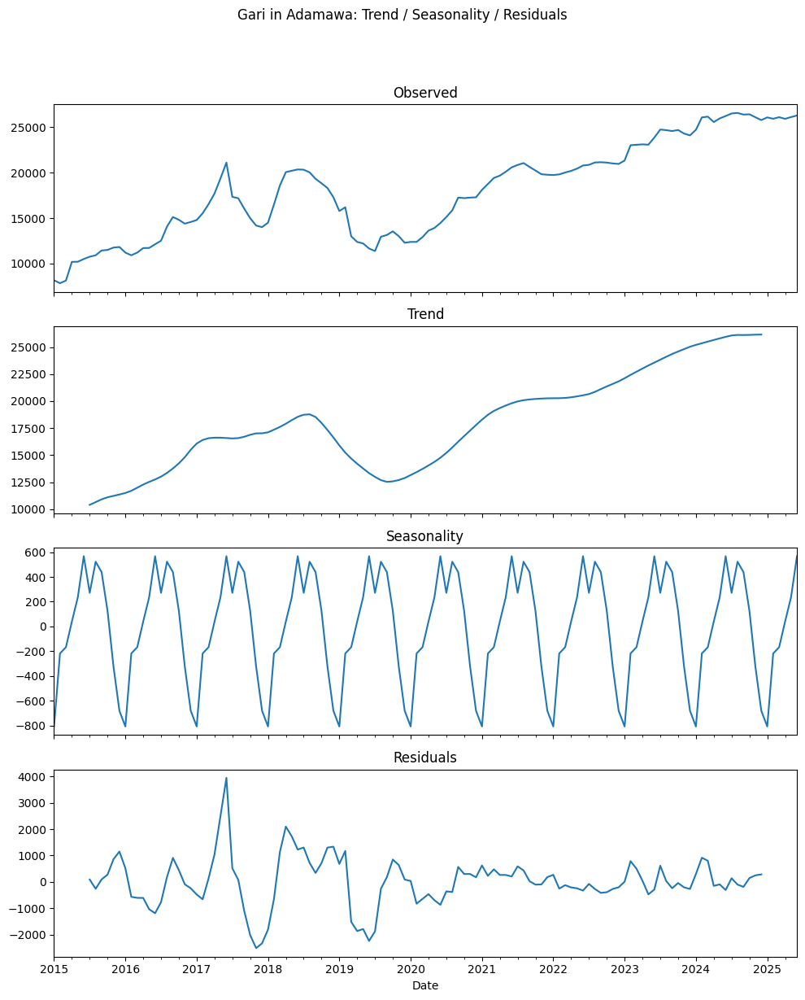

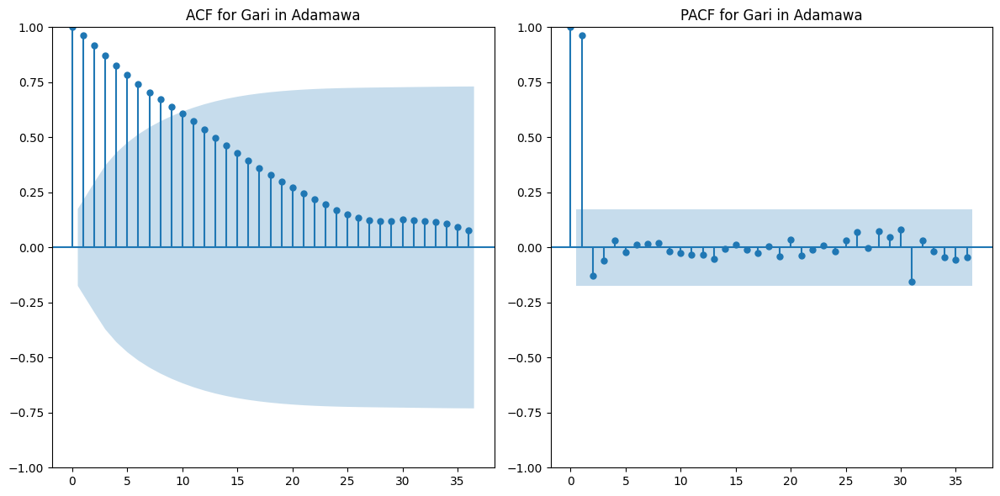


--- Analyzing: Gari in Borno ---
Observations for Gari in Borno: 126


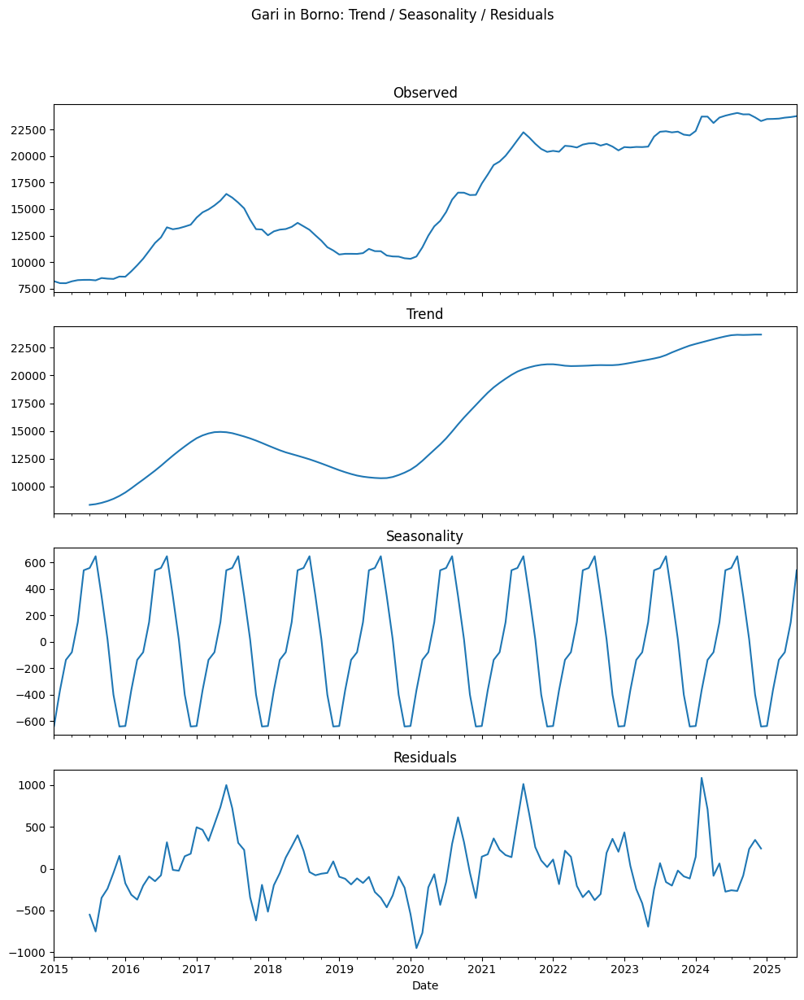

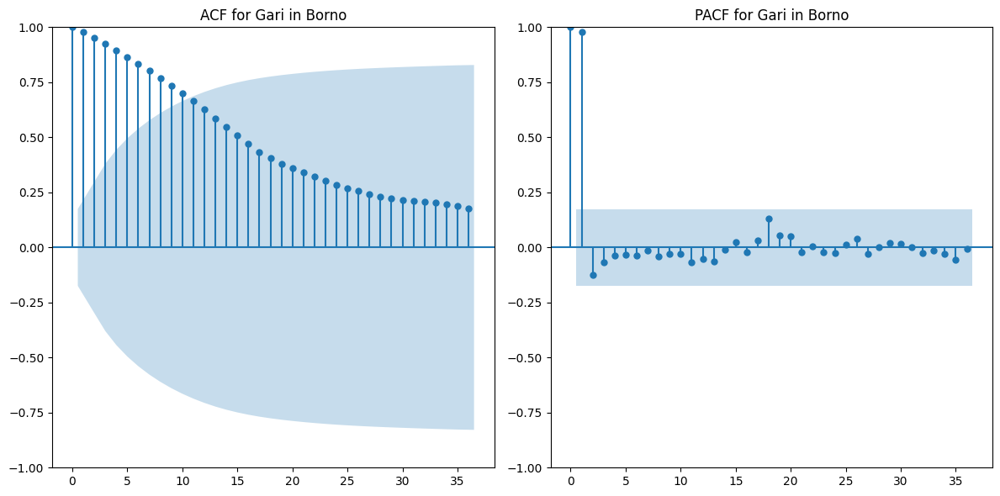


--- Analyzing: Gari in Gombe ---
Observations for Gari in Gombe: 126


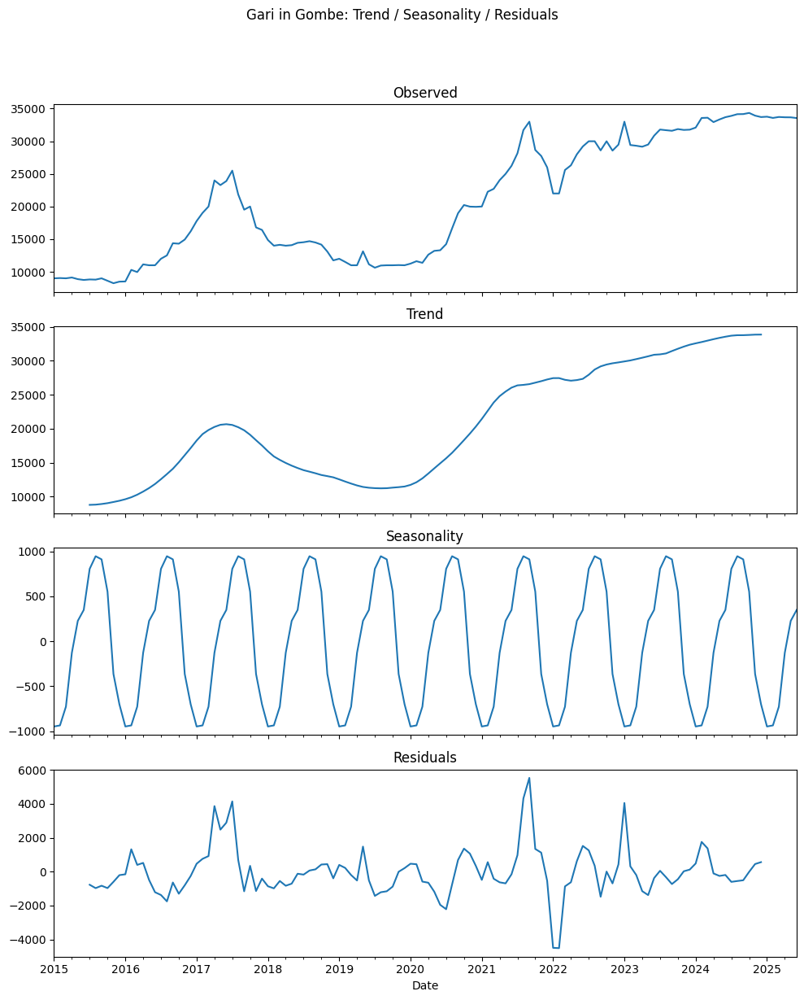

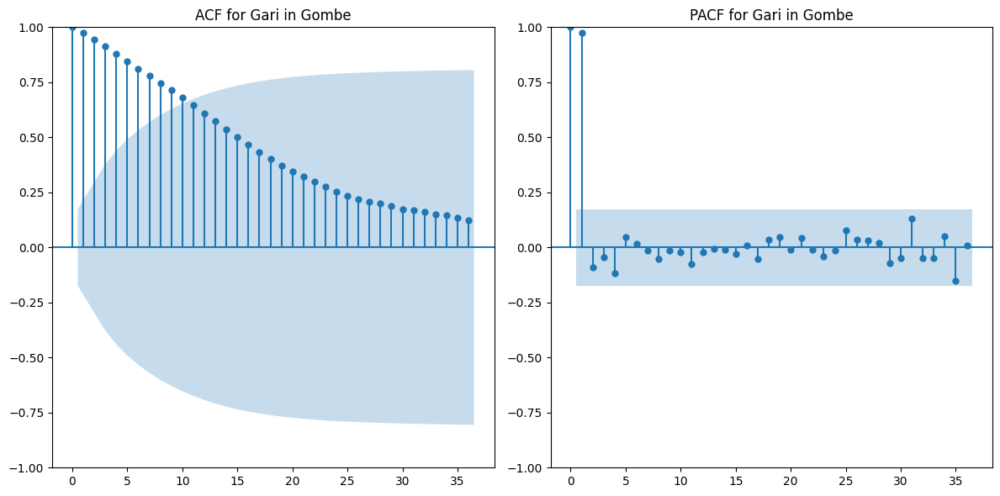


--- Analyzing: Gari in Jigawa ---
Observations for Gari in Jigawa: 126


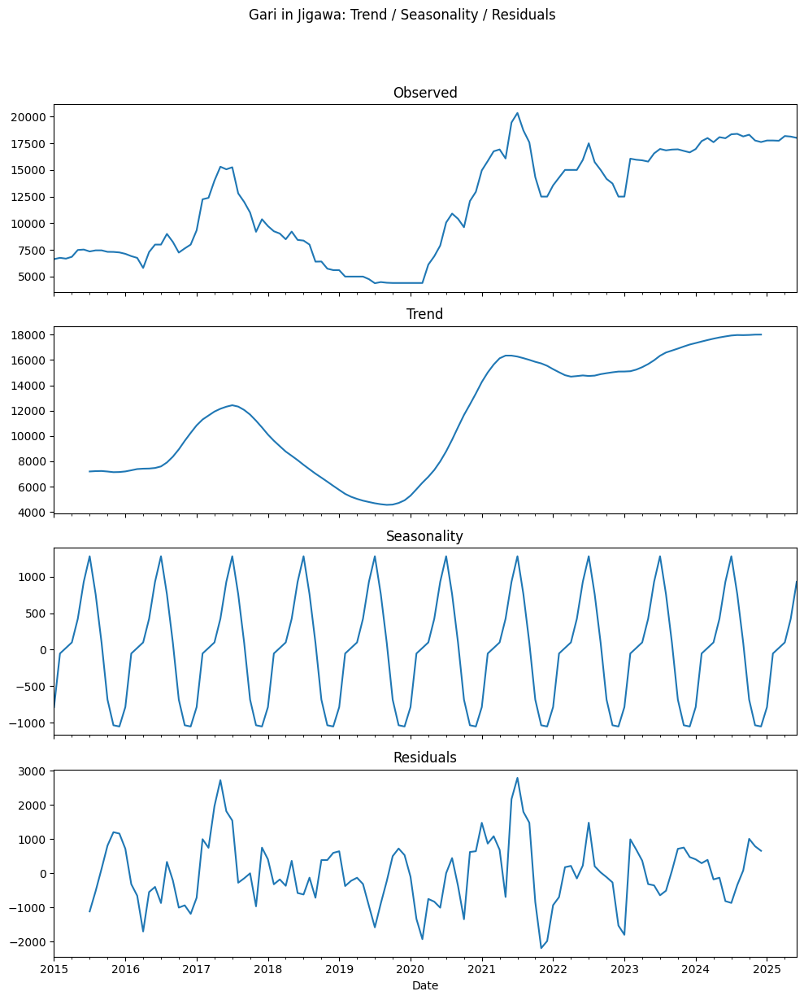

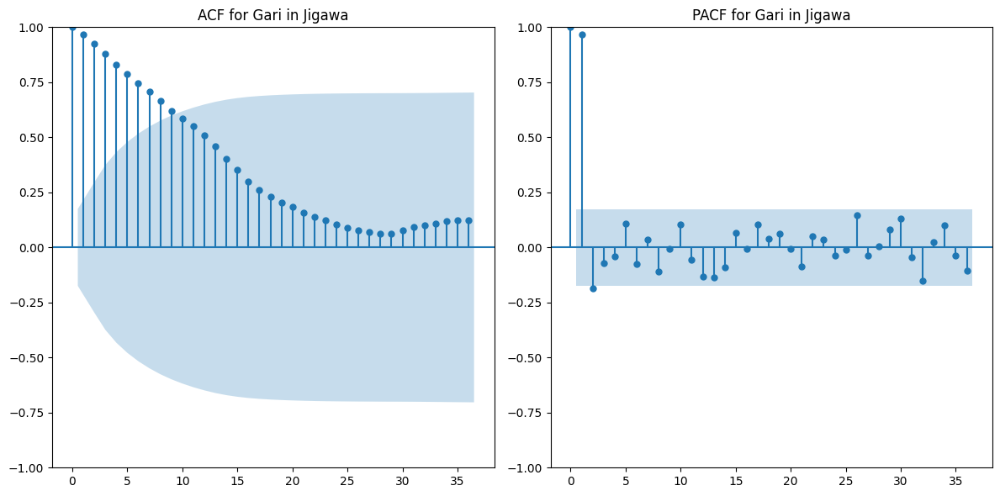


--- Analyzing: Gari in Kaduna ---
Observations for Gari in Kaduna: 126


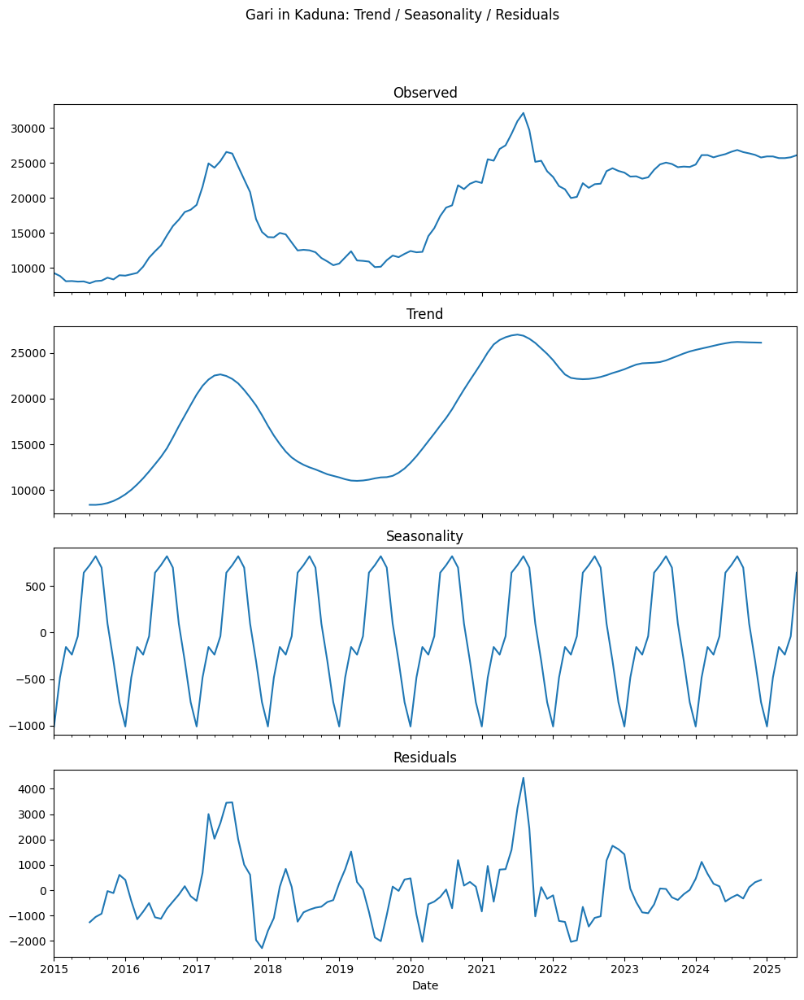

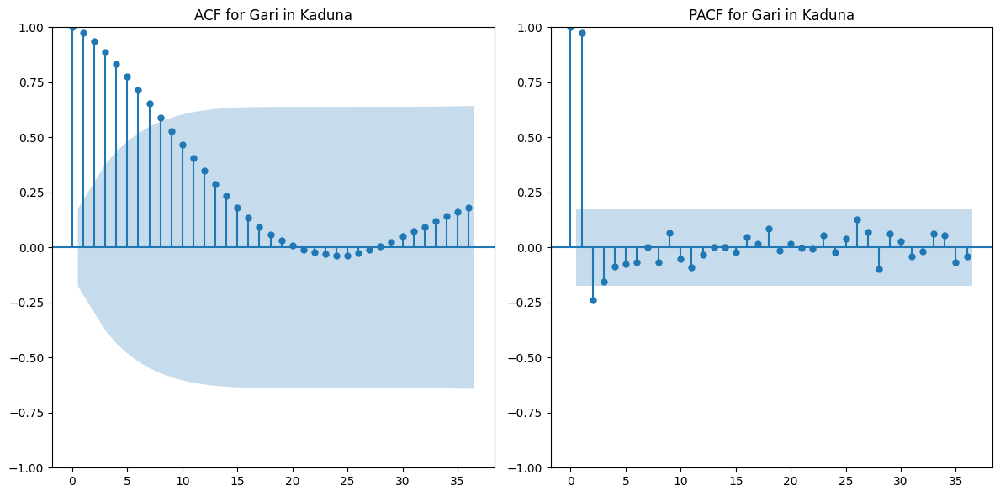


--- Analyzing: Gari in Kano ---
Observations for Gari in Kano: 126


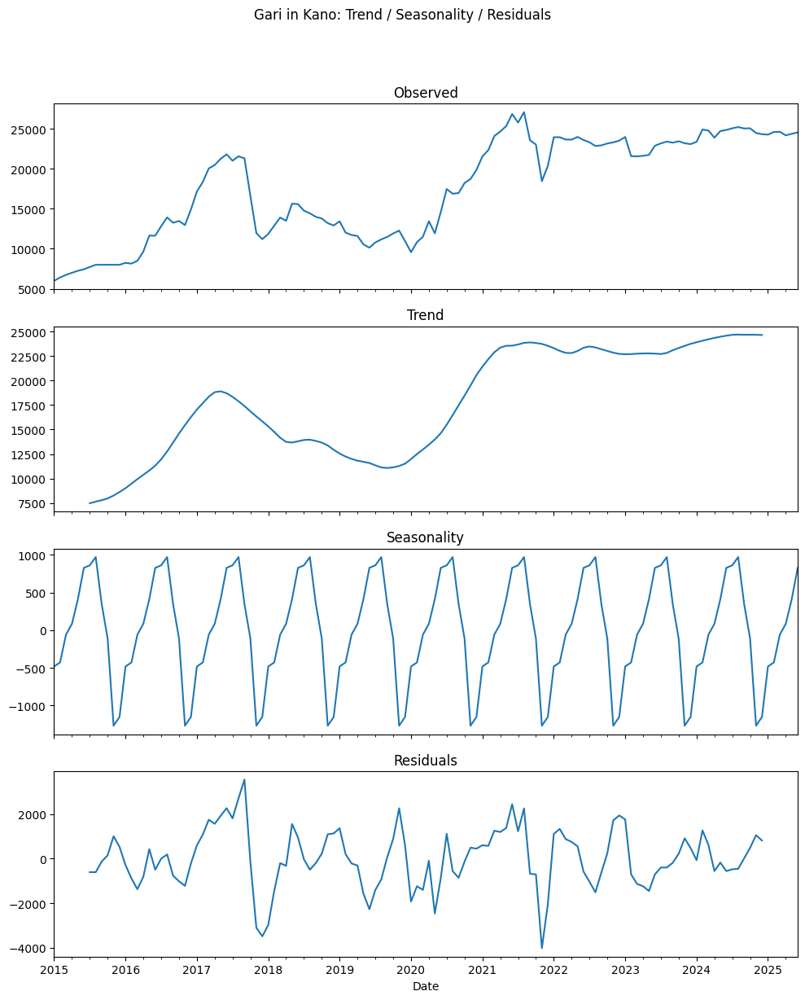

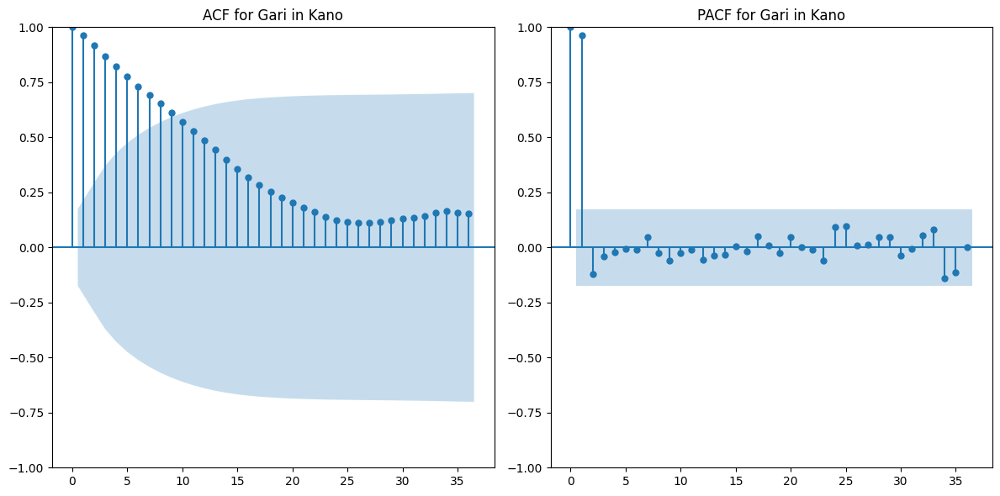


--- Analyzing: Gari in Katsina ---
Observations for Gari in Katsina: 126


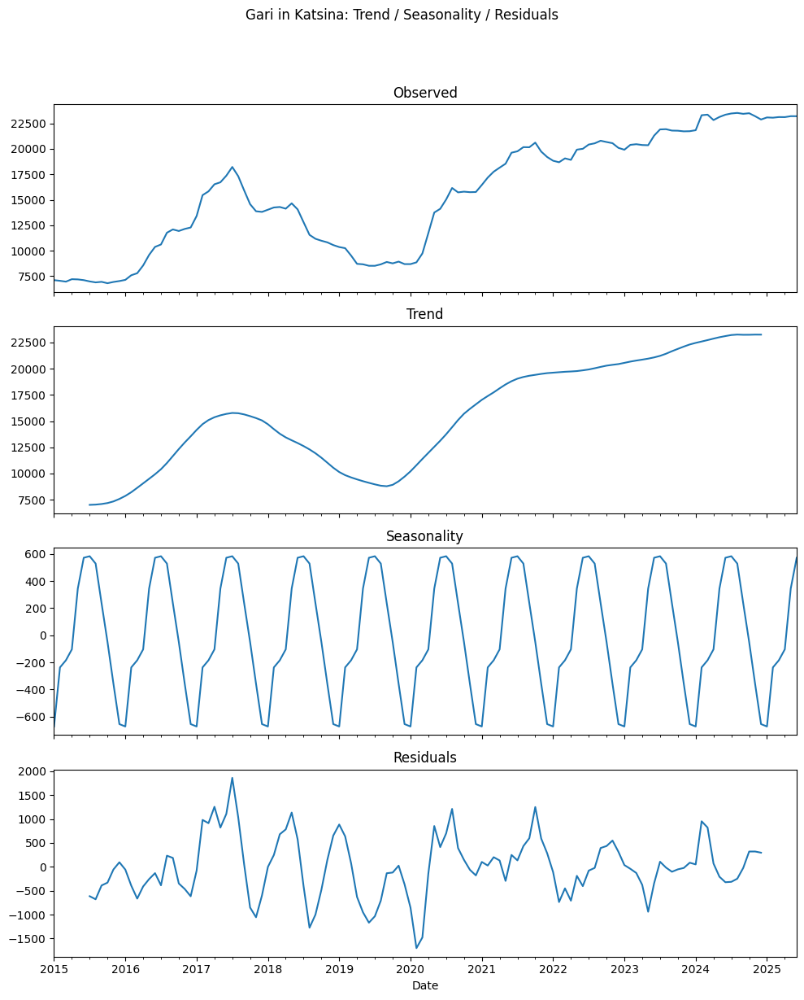

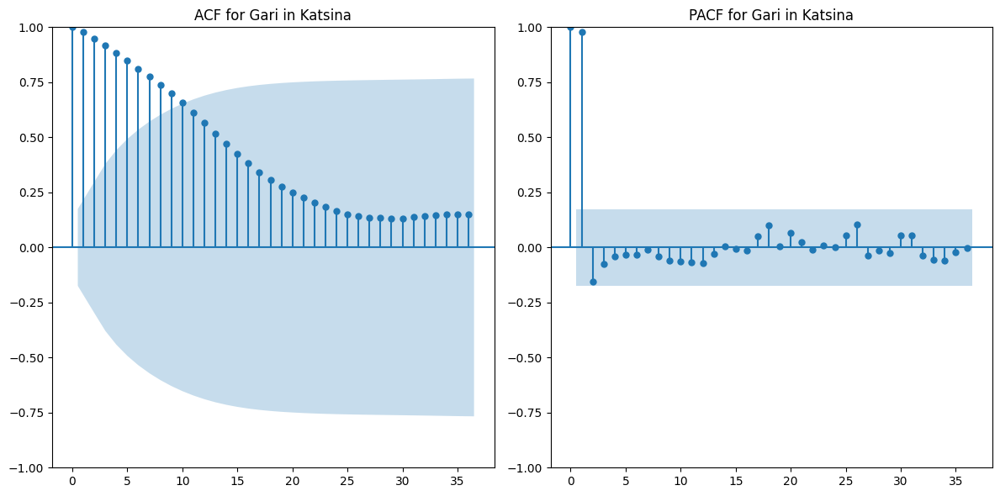


--- Analyzing: Gari in Kebbi ---
Observations for Gari in Kebbi: 126


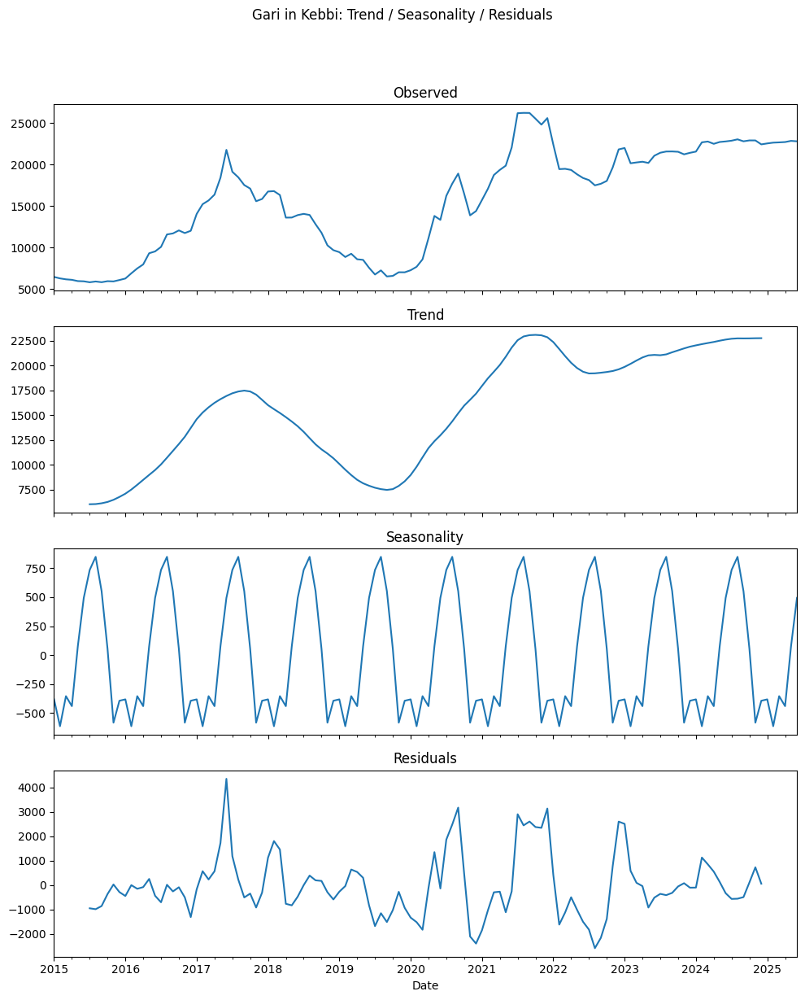

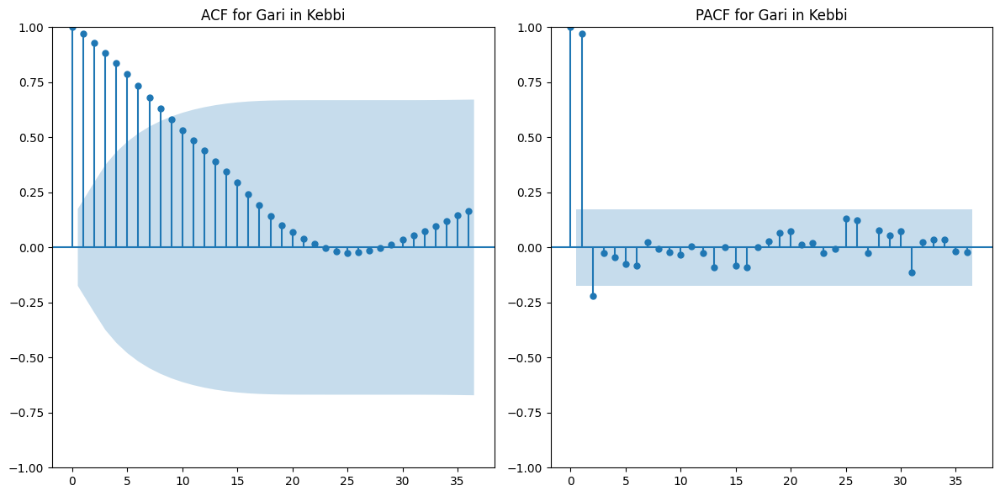


--- Analyzing: Gari in Lagos ---
Observations for Gari in Lagos: 126


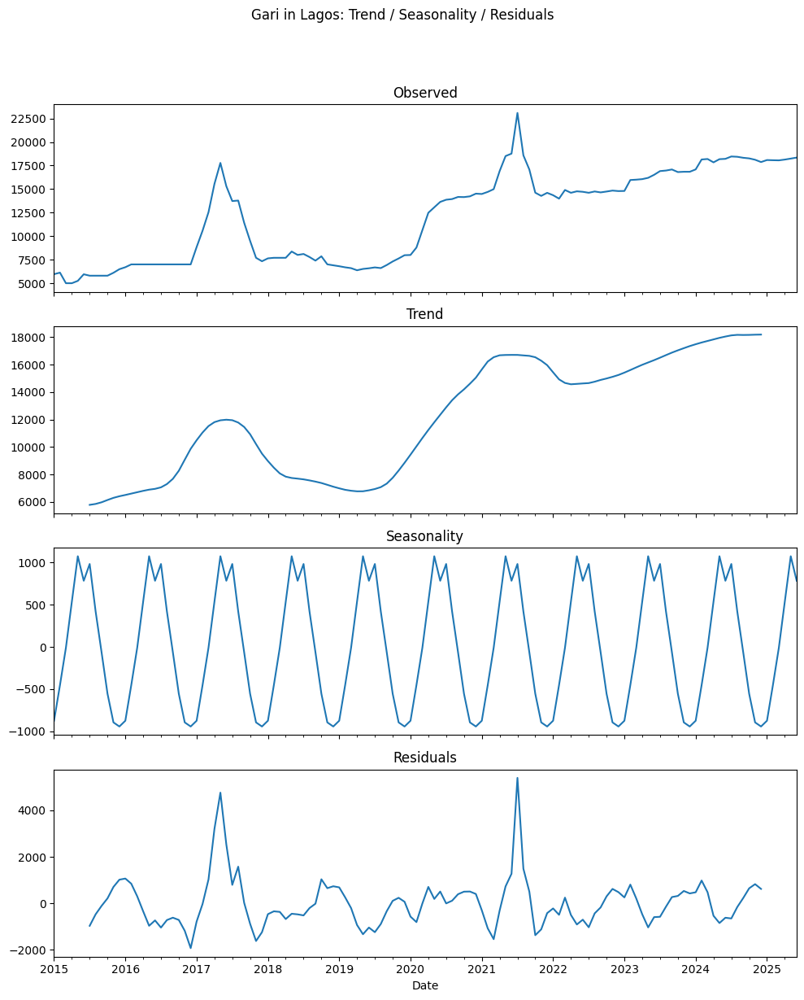

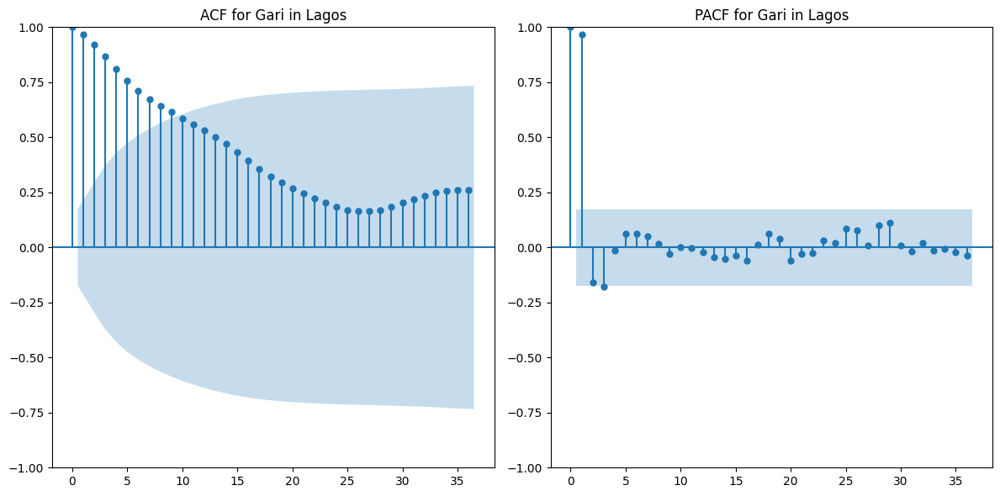


--- Analyzing: Gari in Oyo ---
Observations for Gari in Oyo: 126


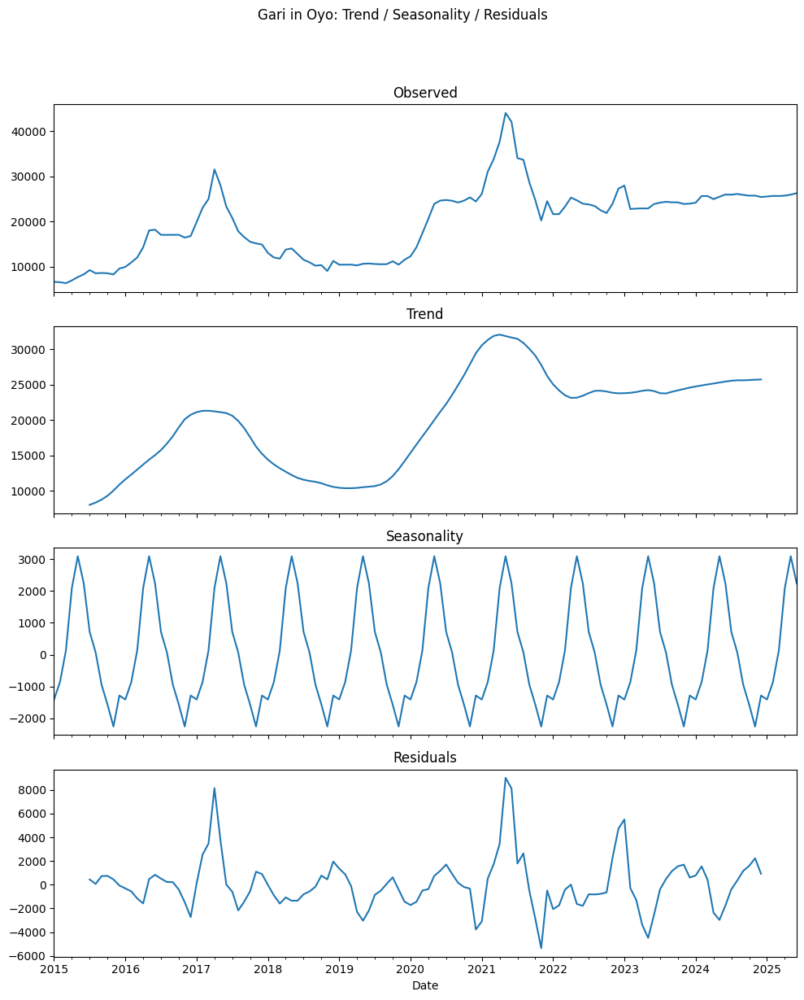

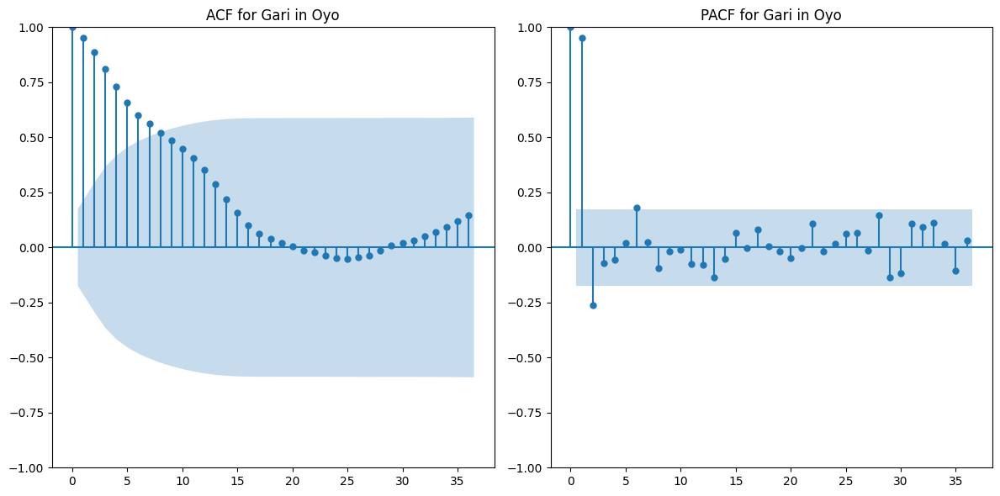


--- Analyzing: Gari in Yobe ---
Observations for Gari in Yobe: 126


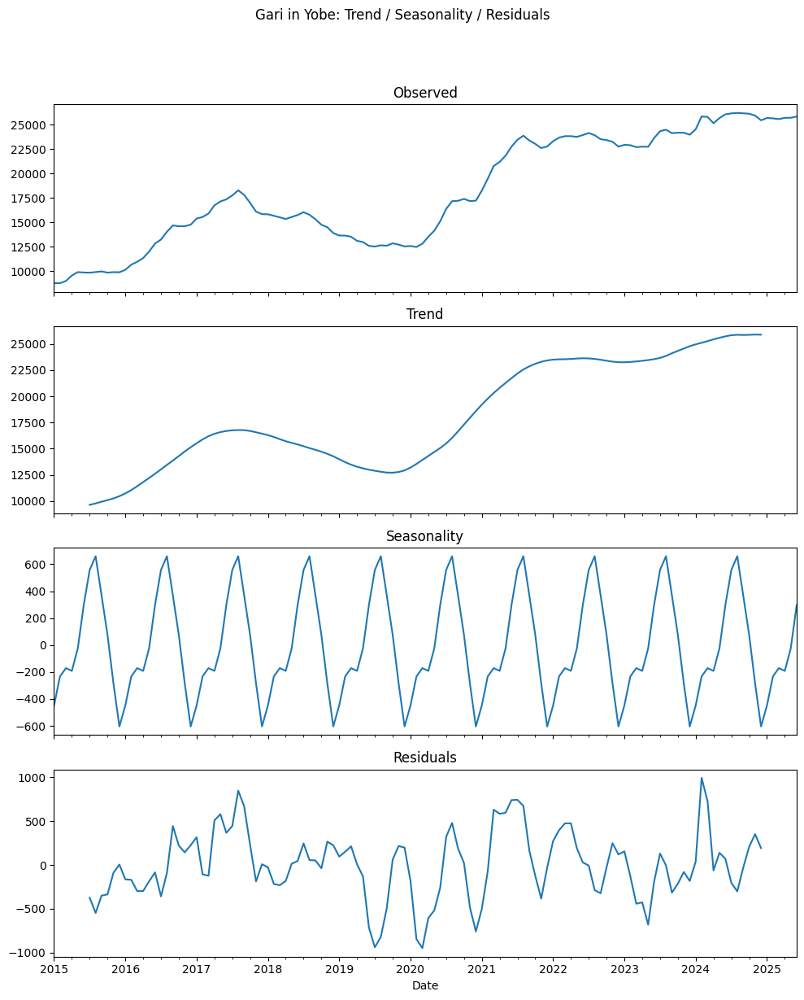

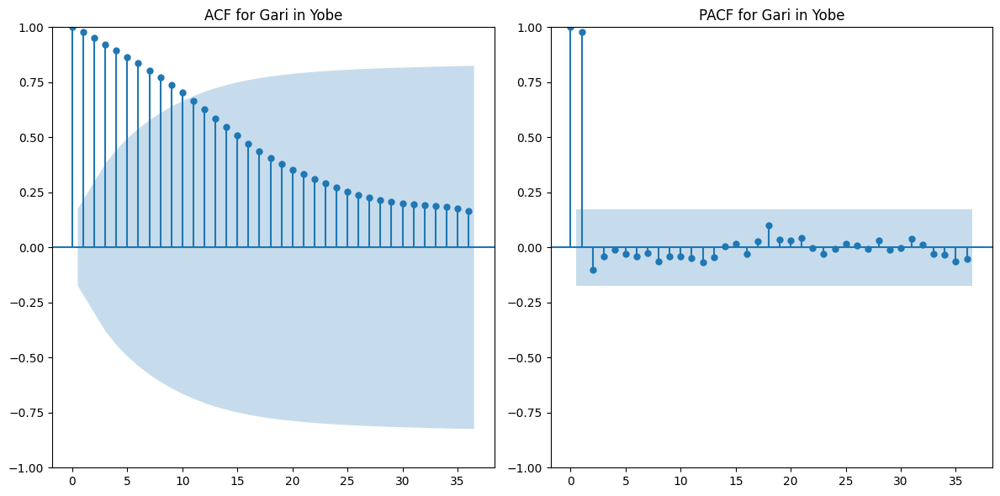


--- Analyzing: Gari in Zamfara ---
Observations for Gari in Zamfara: 126


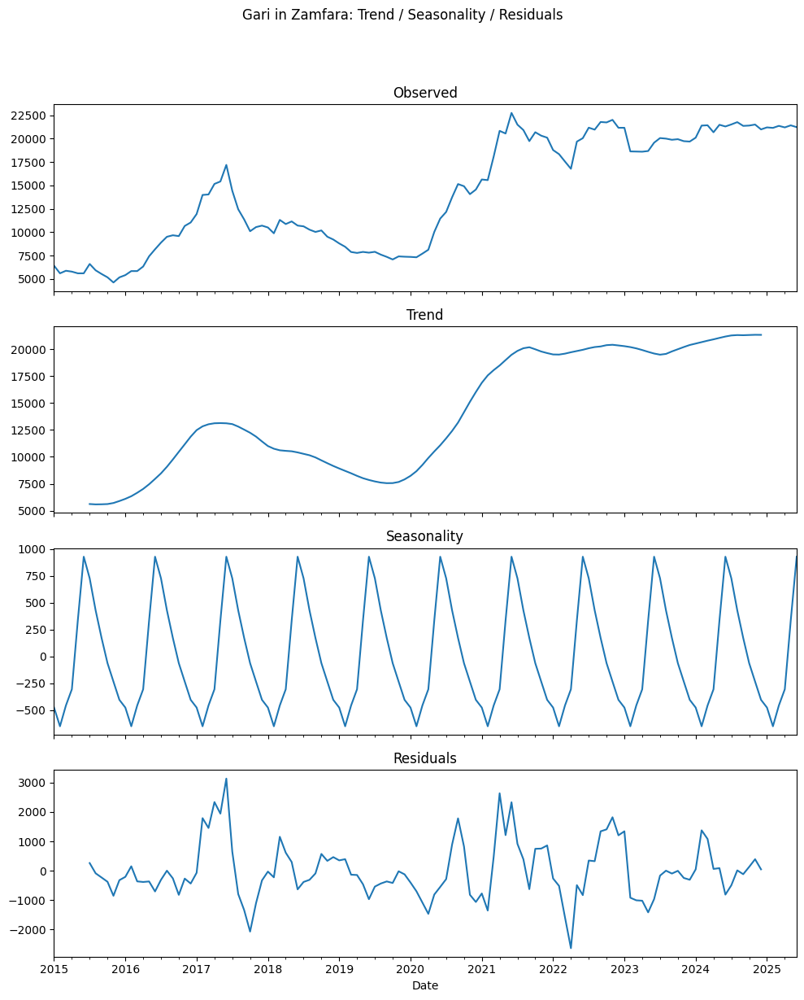

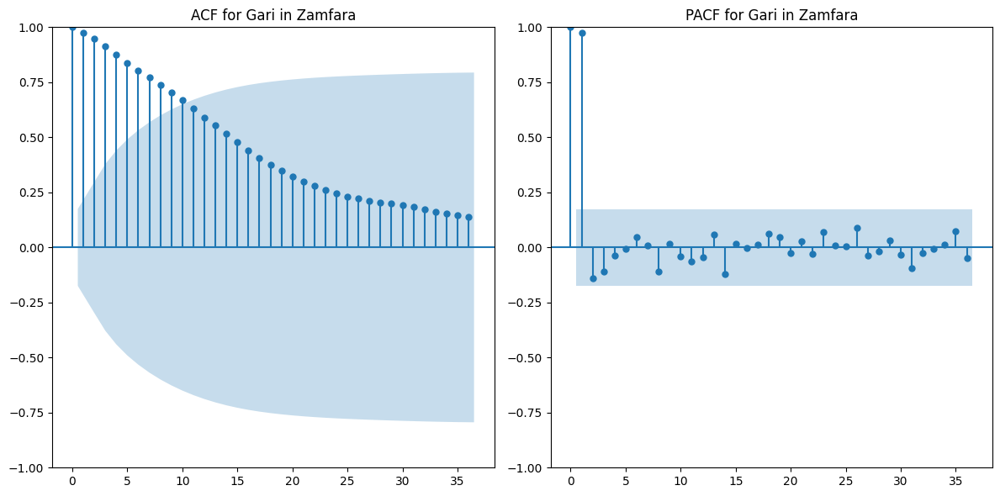


--- Analyzing: Groundnuts in Abia ---
Observations for Groundnuts in Abia: 126


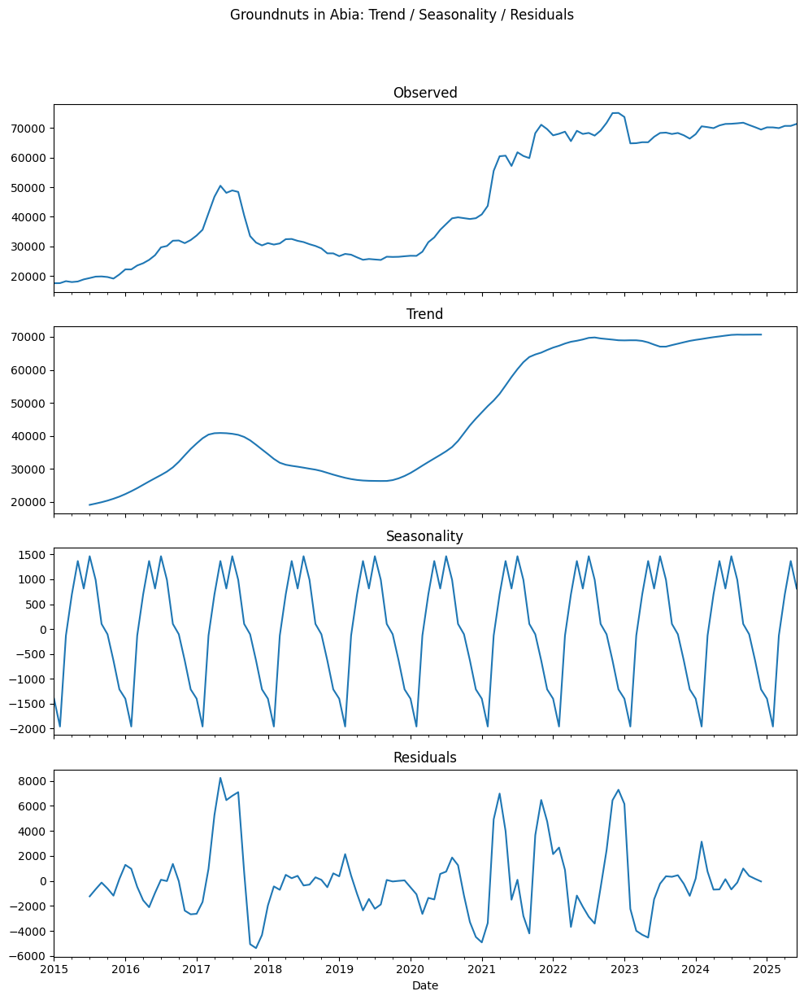

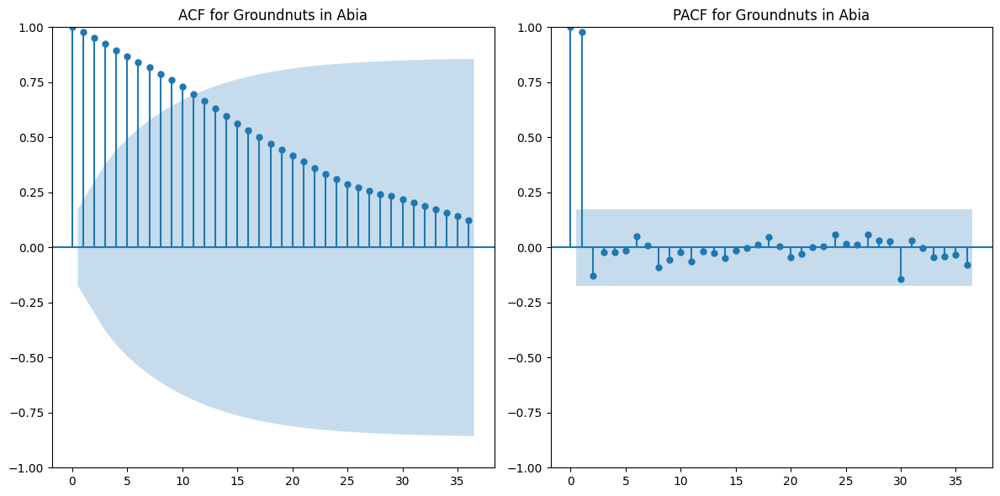


--- Analyzing: Groundnuts in Adamawa ---
Observations for Groundnuts in Adamawa: 126


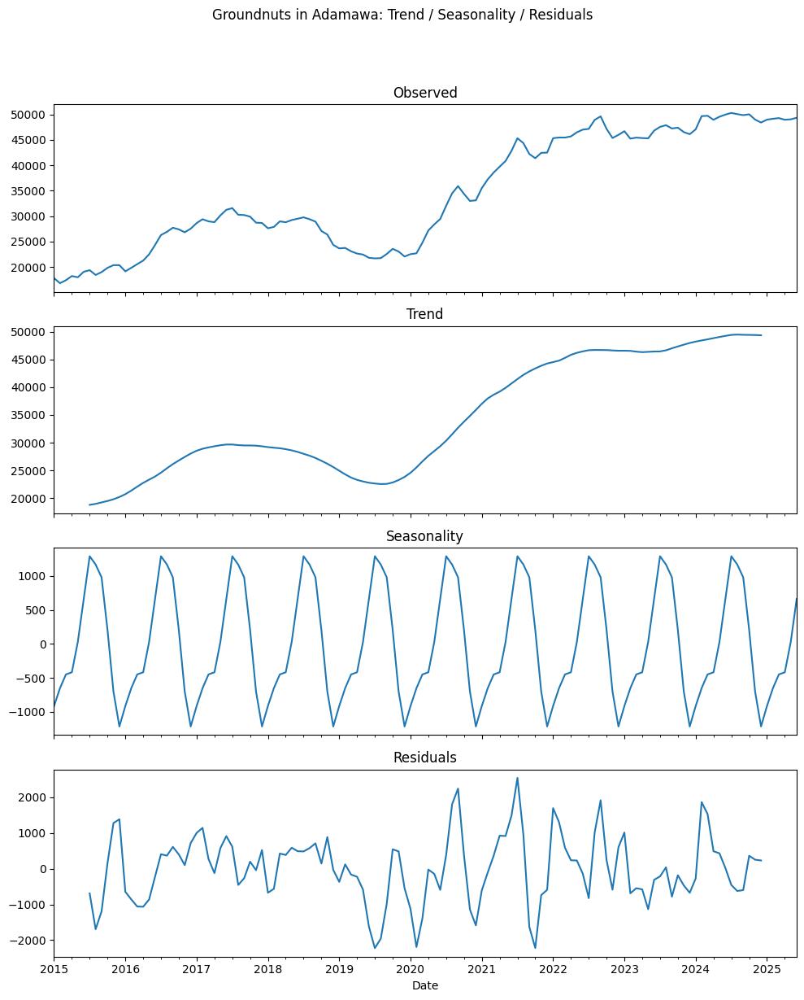

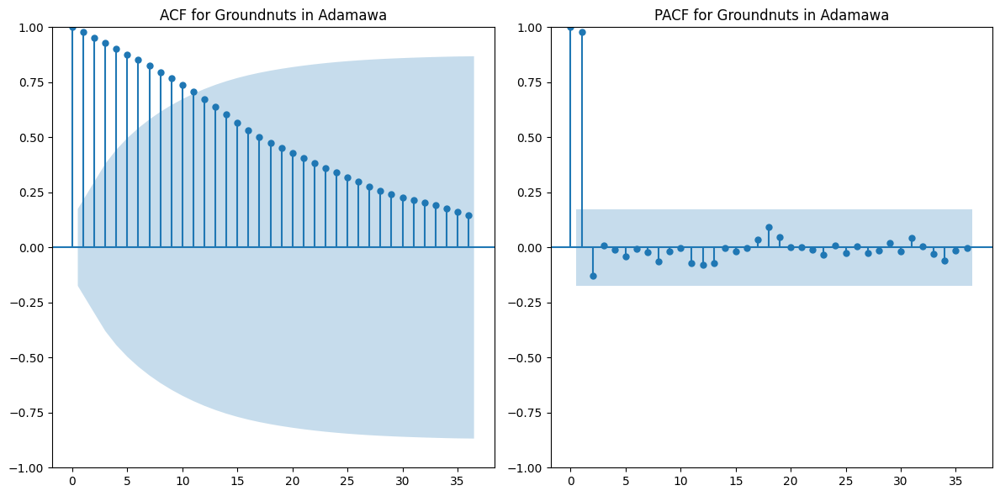


--- Analyzing: Groundnuts in Borno ---
Observations for Groundnuts in Borno: 126


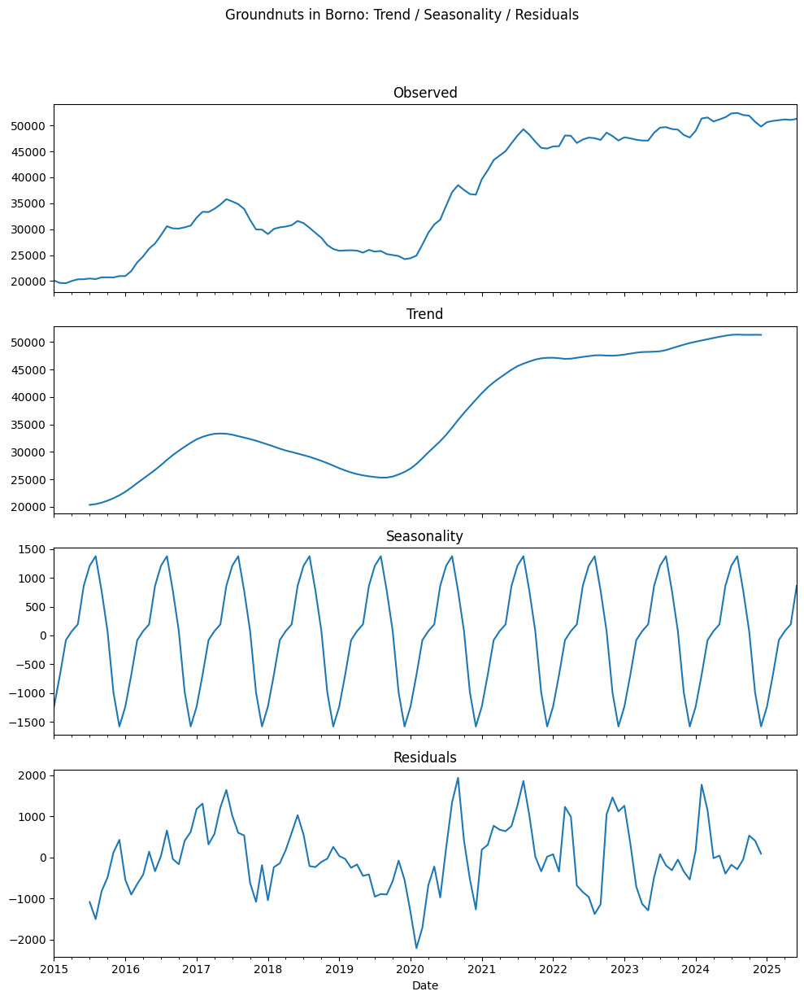

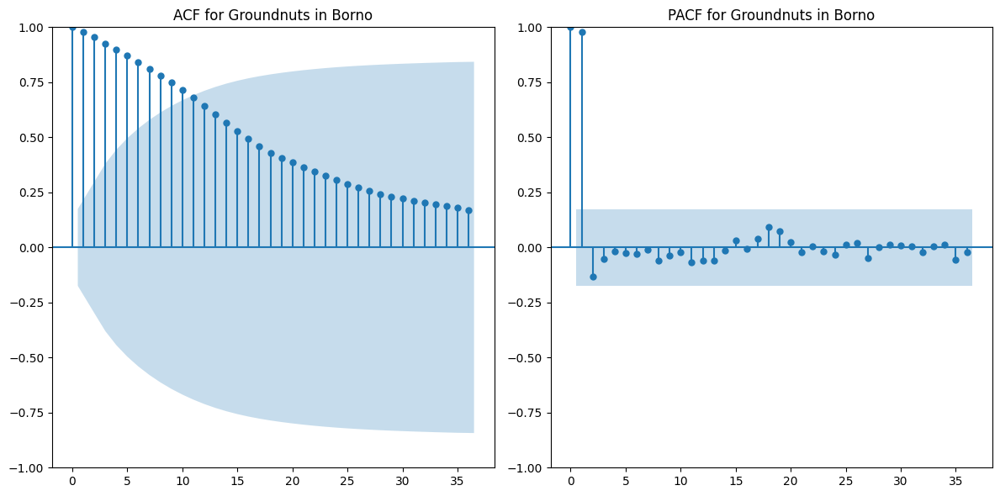


--- Analyzing: Groundnuts in Gombe ---
Observations for Groundnuts in Gombe: 126


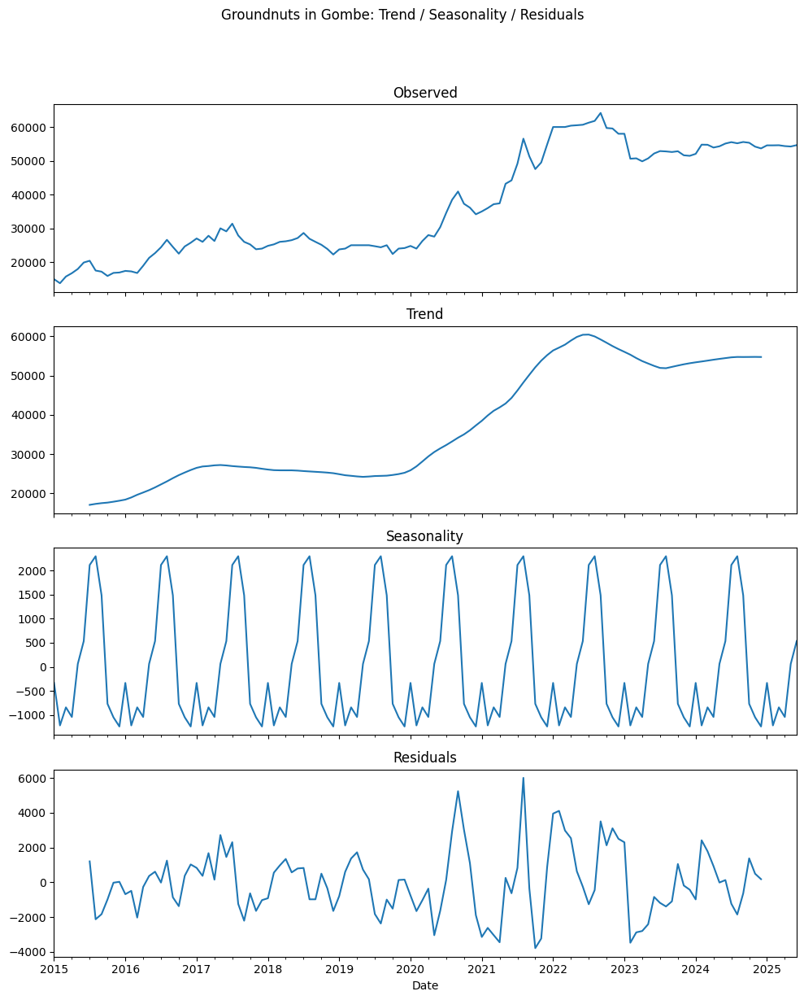

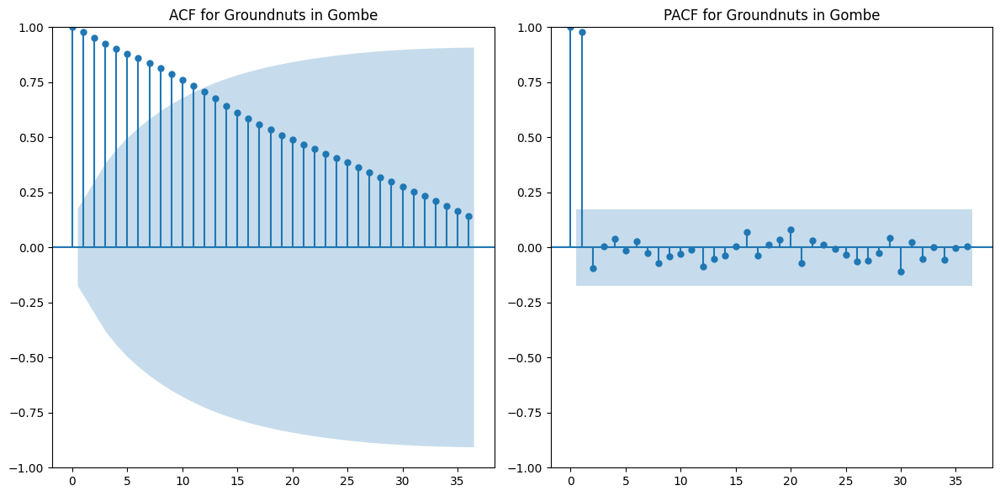


--- Analyzing: Groundnuts in Jigawa ---
Observations for Groundnuts in Jigawa: 126


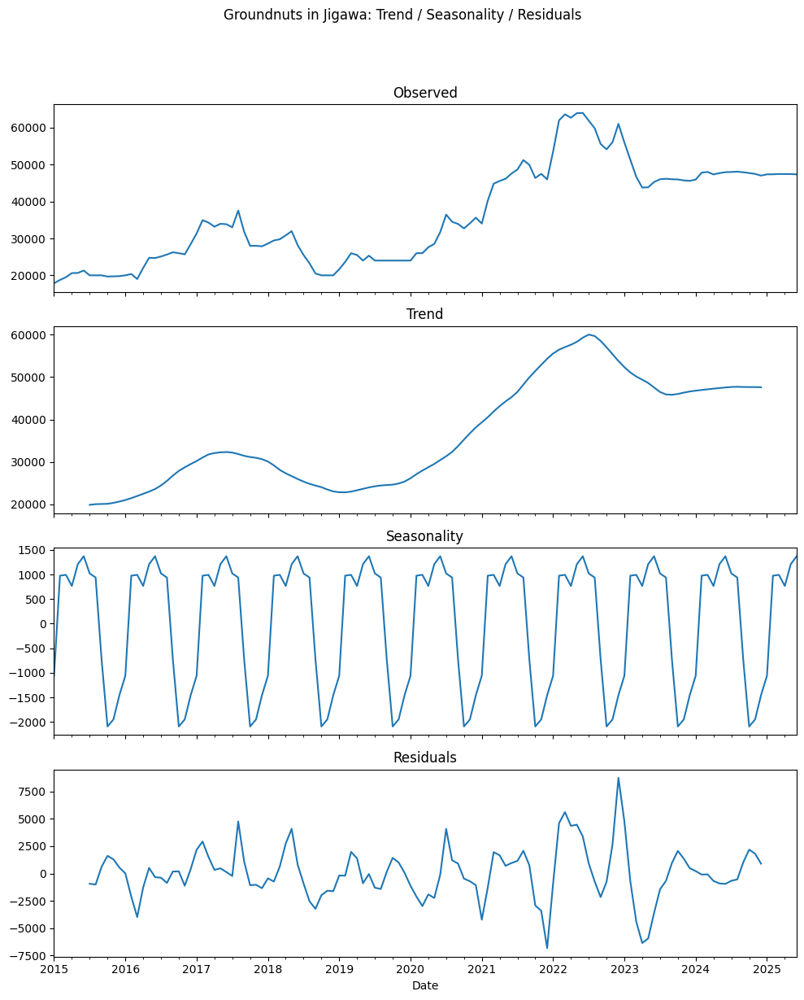

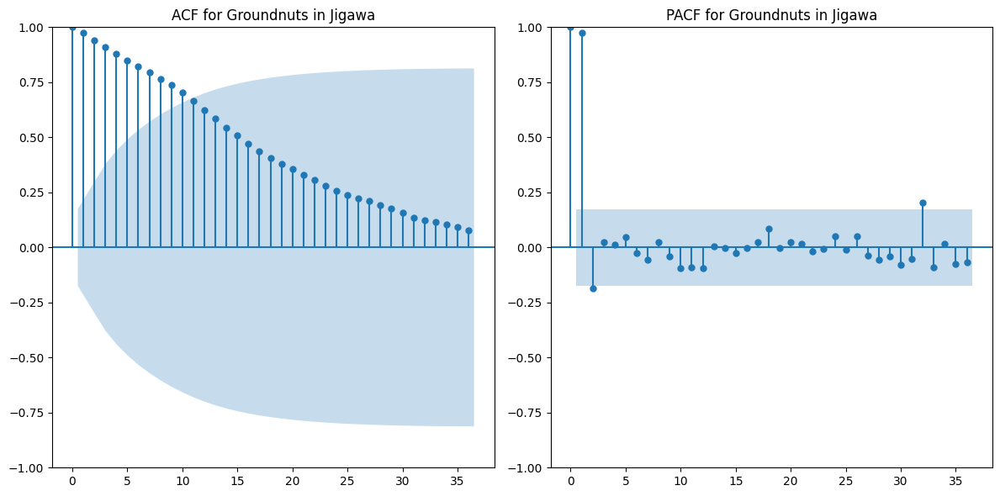


--- Analyzing: Groundnuts in Kaduna ---
Observations for Groundnuts in Kaduna: 126


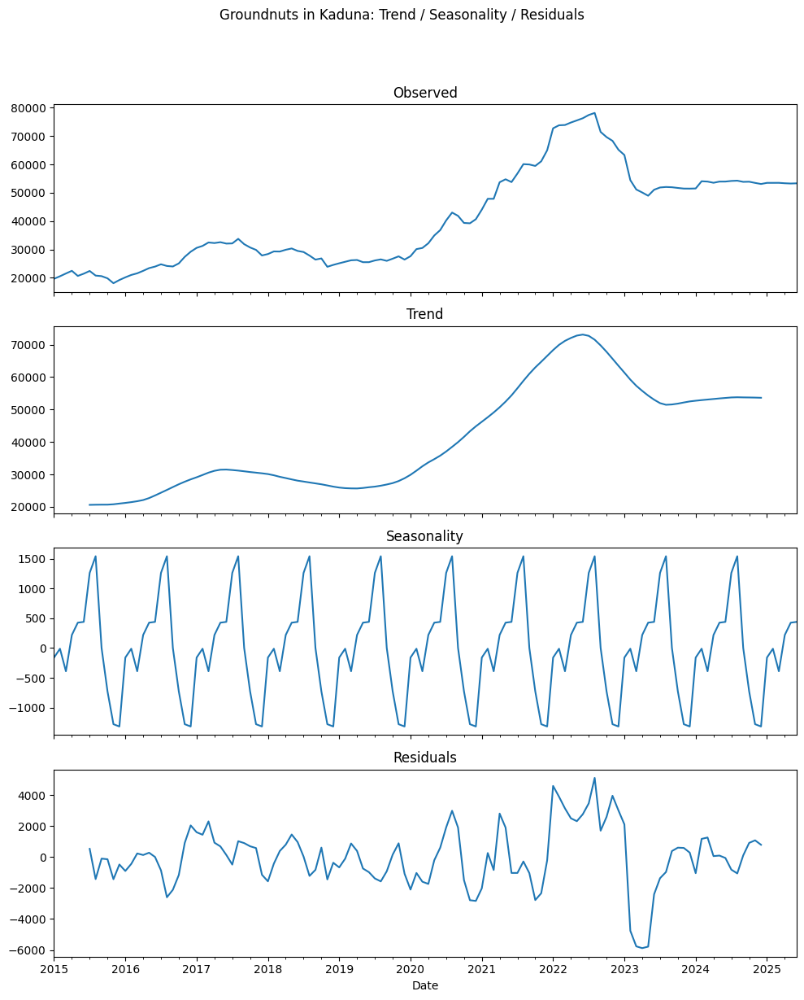

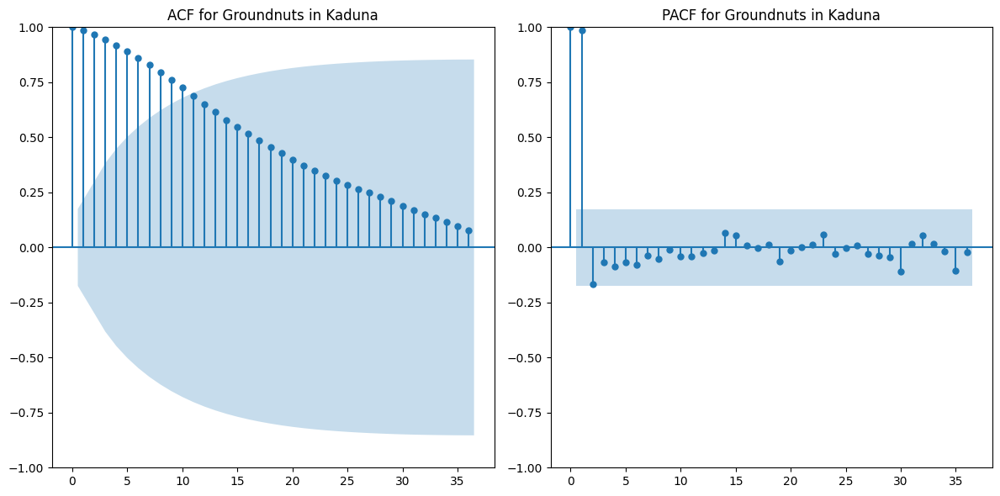


--- Analyzing: Groundnuts in Kano ---
Observations for Groundnuts in Kano: 126


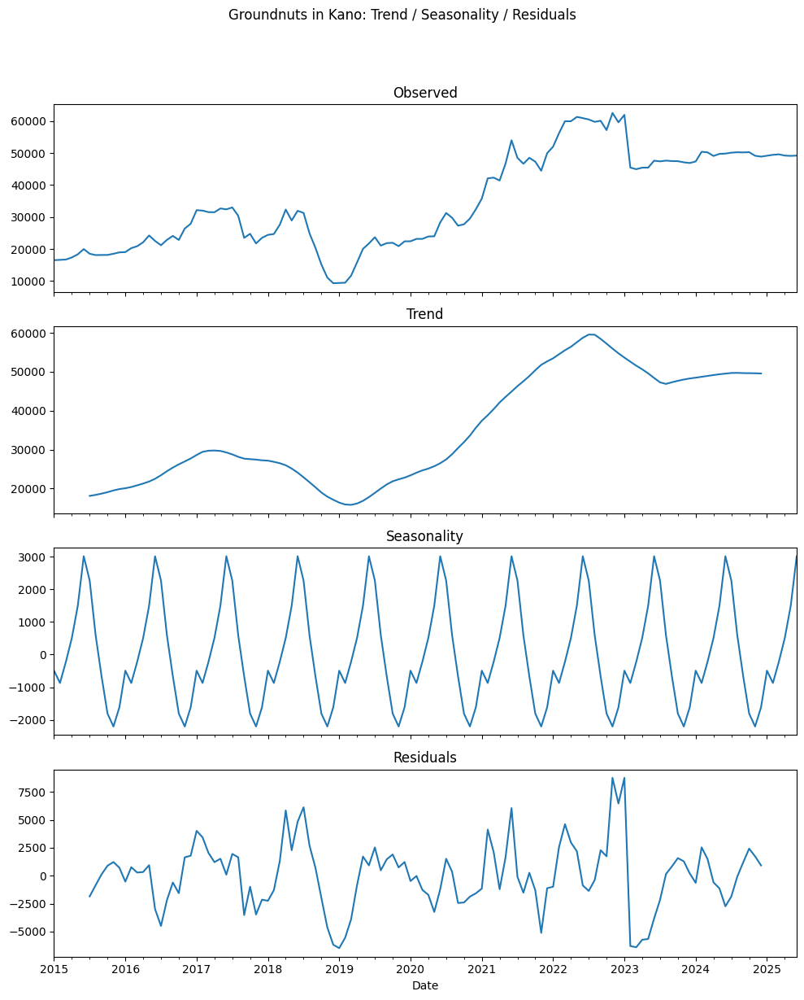

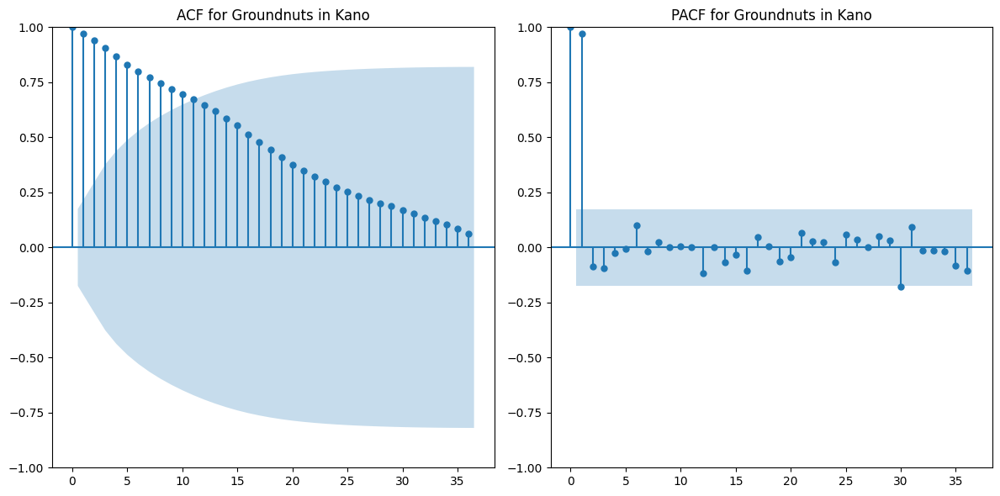


--- Analyzing: Groundnuts in Katsina ---
Observations for Groundnuts in Katsina: 126


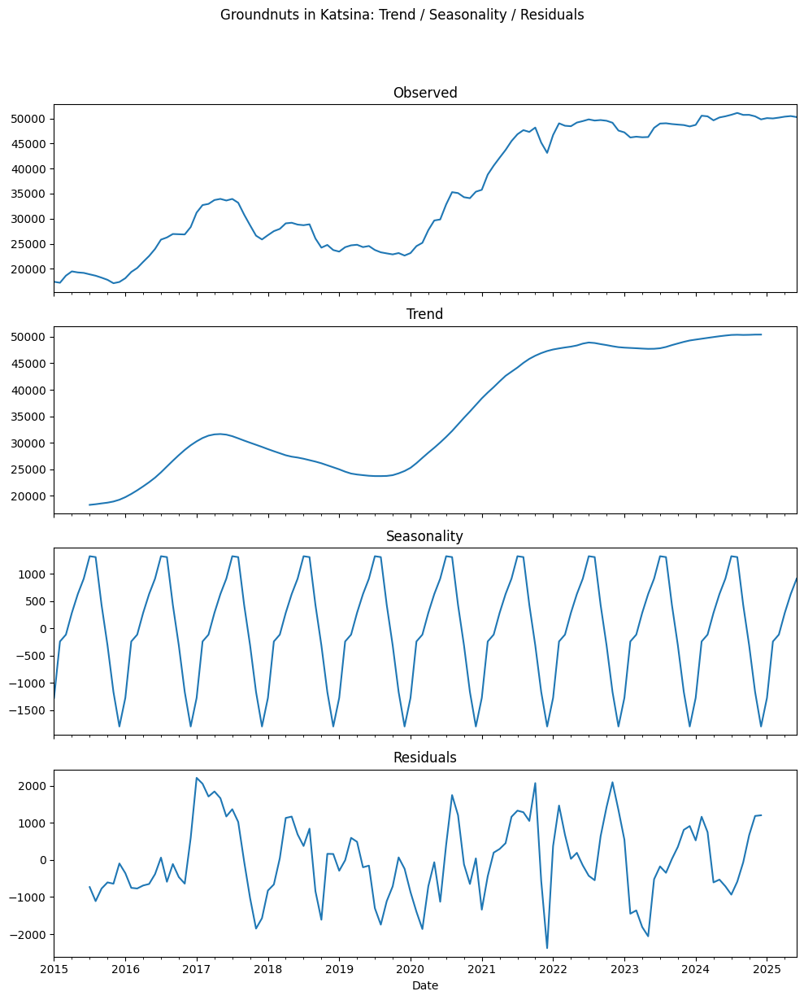

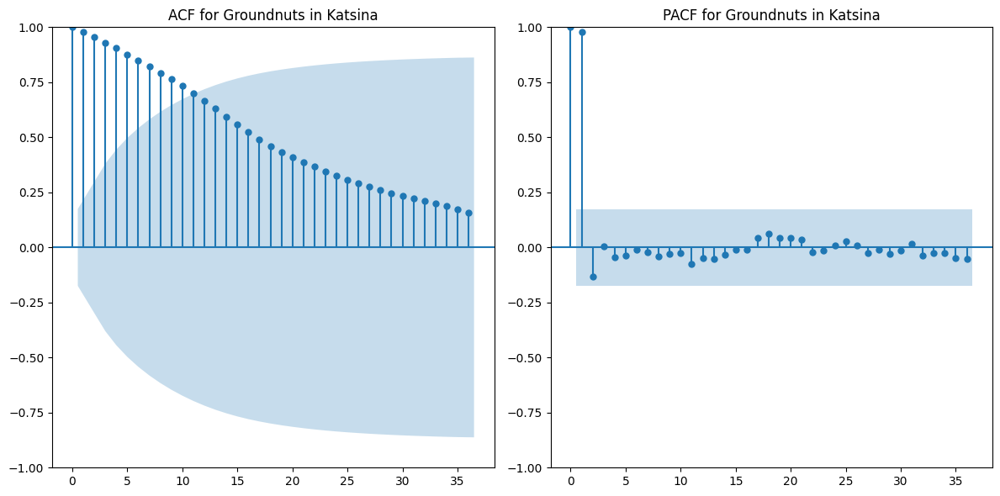


--- Analyzing: Groundnuts in Kebbi ---
Observations for Groundnuts in Kebbi: 126


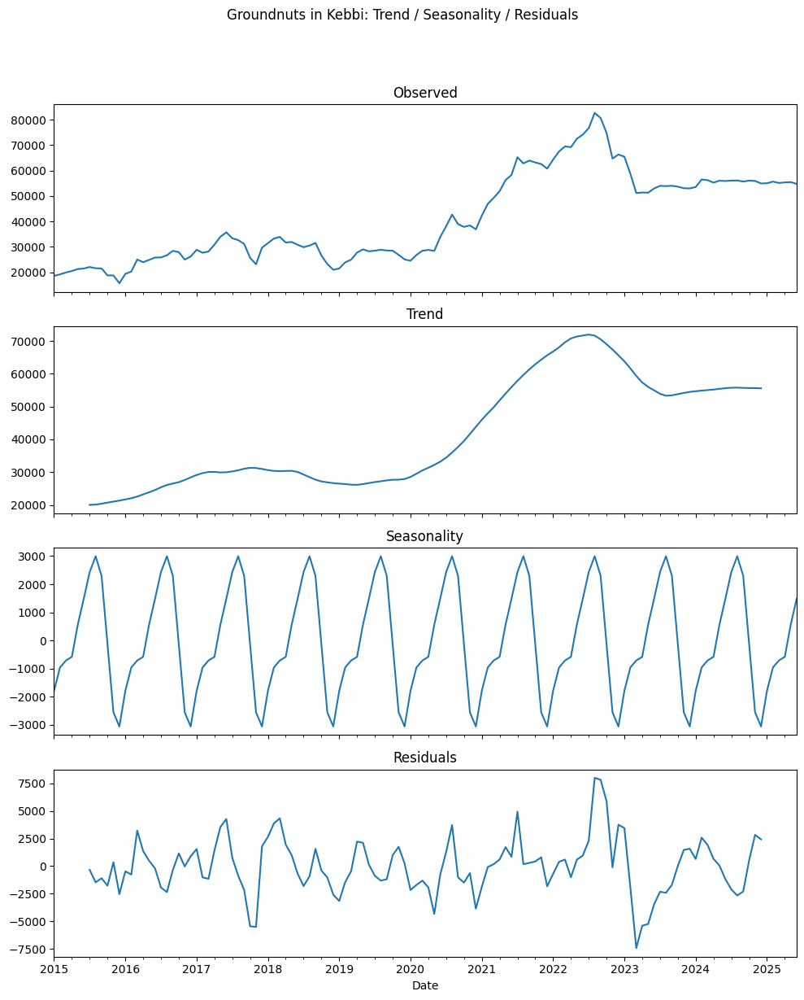

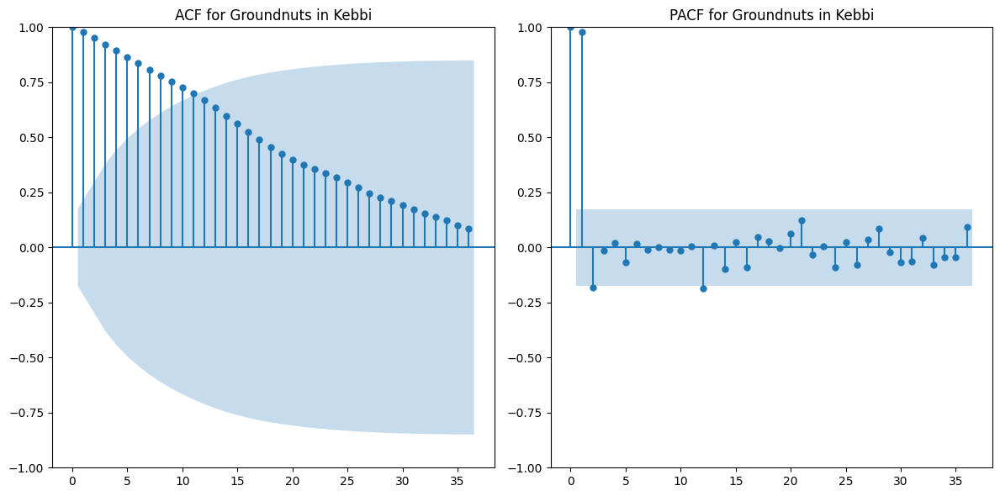


--- Analyzing: Groundnuts in Lagos ---
Observations for Groundnuts in Lagos: 126


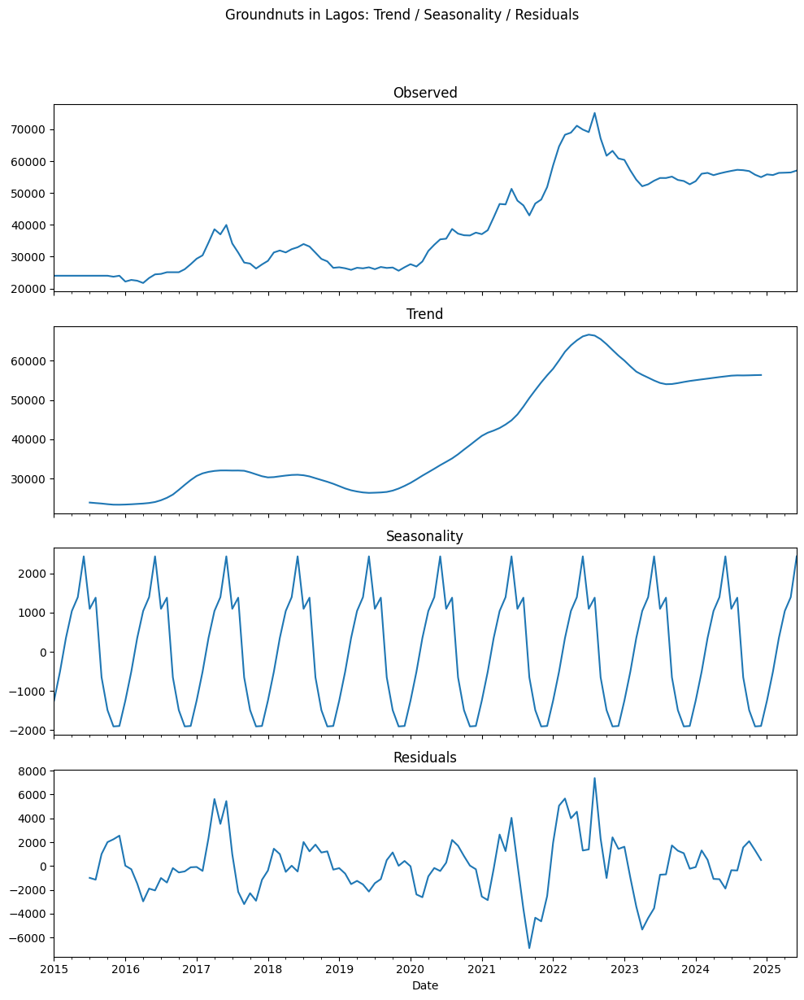

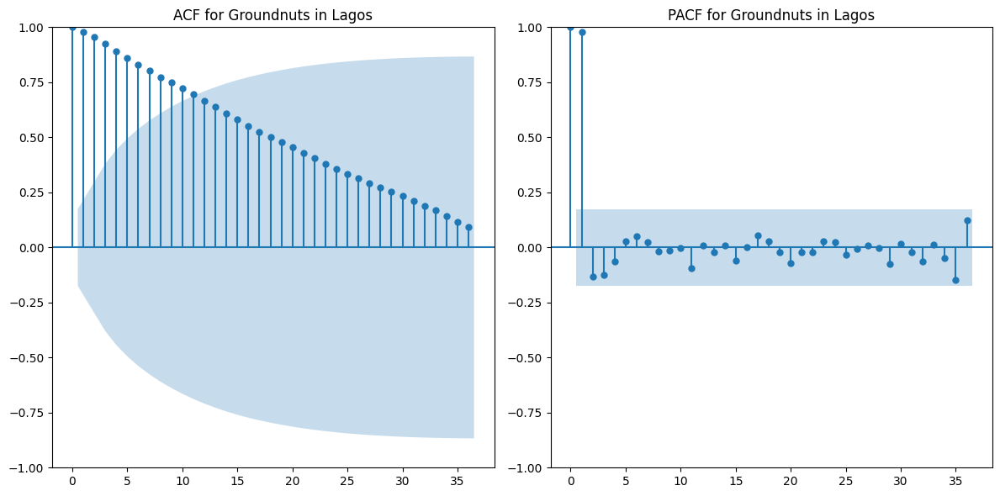


--- Analyzing: Groundnuts in Oyo ---
Observations for Groundnuts in Oyo: 126


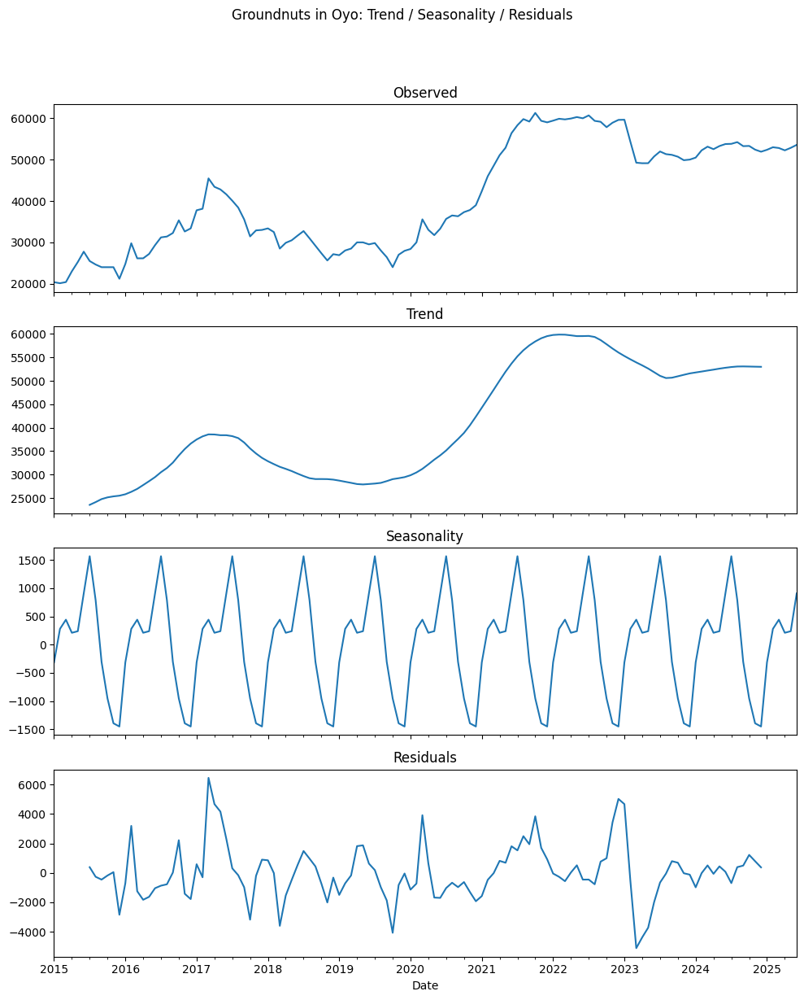

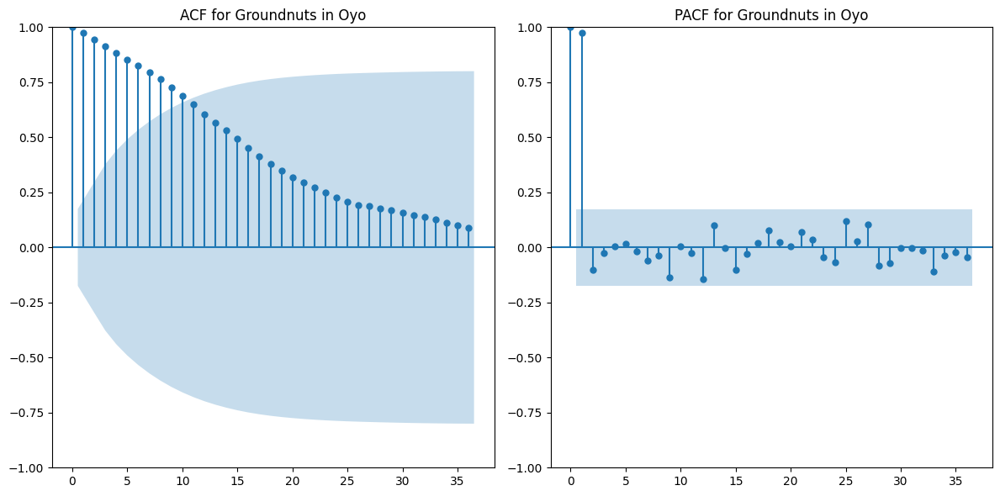


--- Analyzing: Groundnuts in Yobe ---
Observations for Groundnuts in Yobe: 126


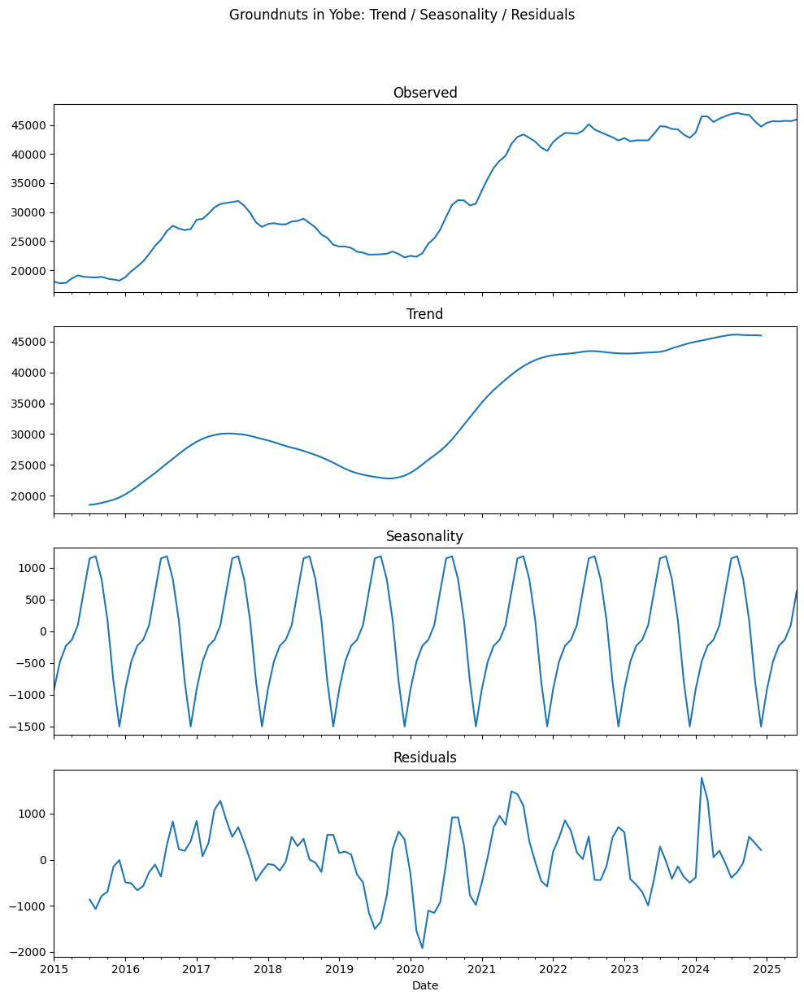

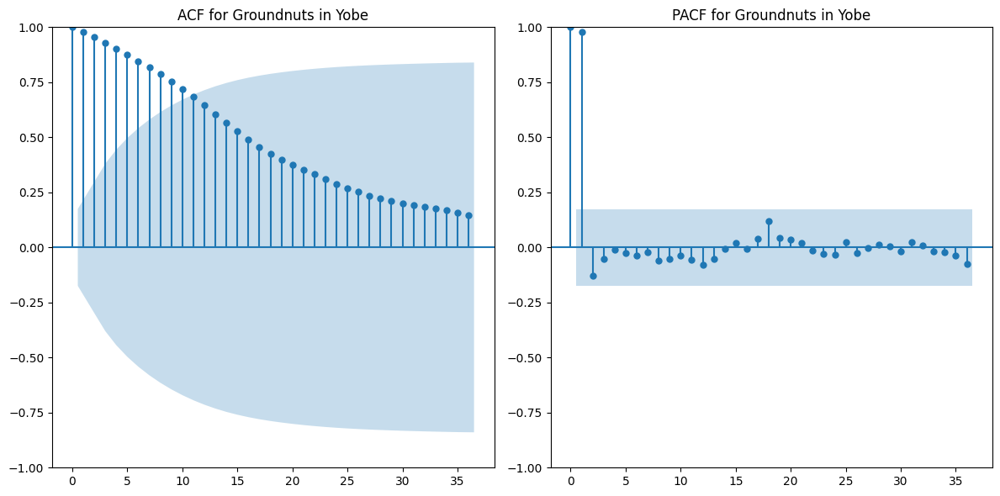


--- Analyzing: Groundnuts in Zamfara ---
Observations for Groundnuts in Zamfara: 126


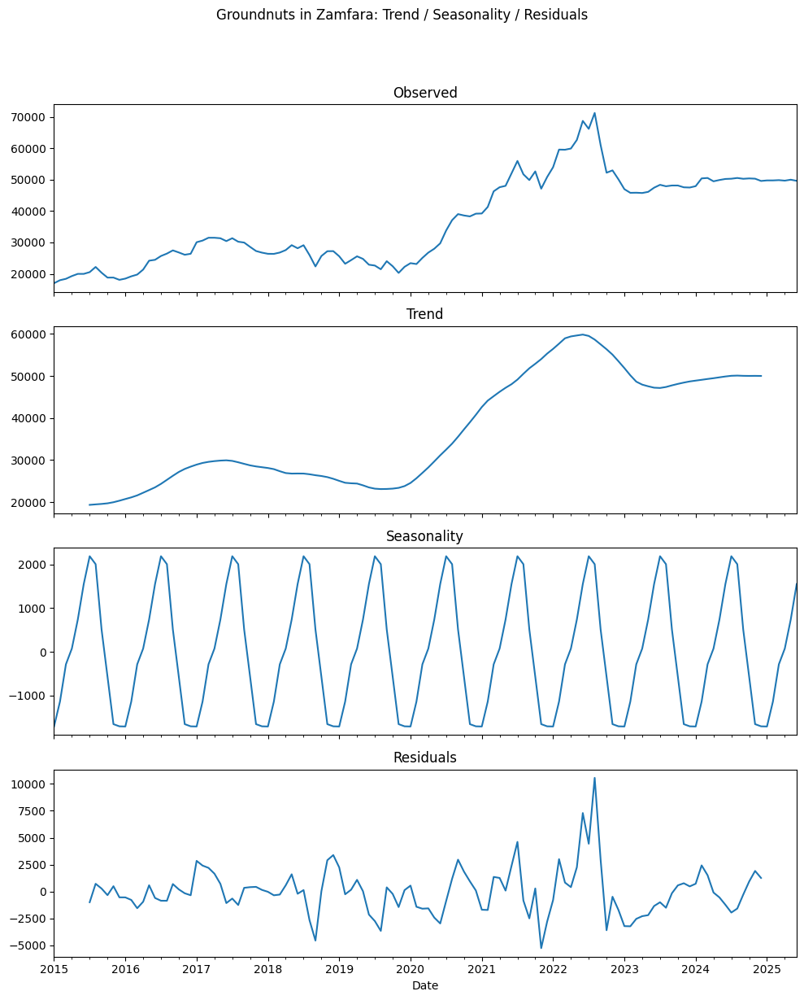

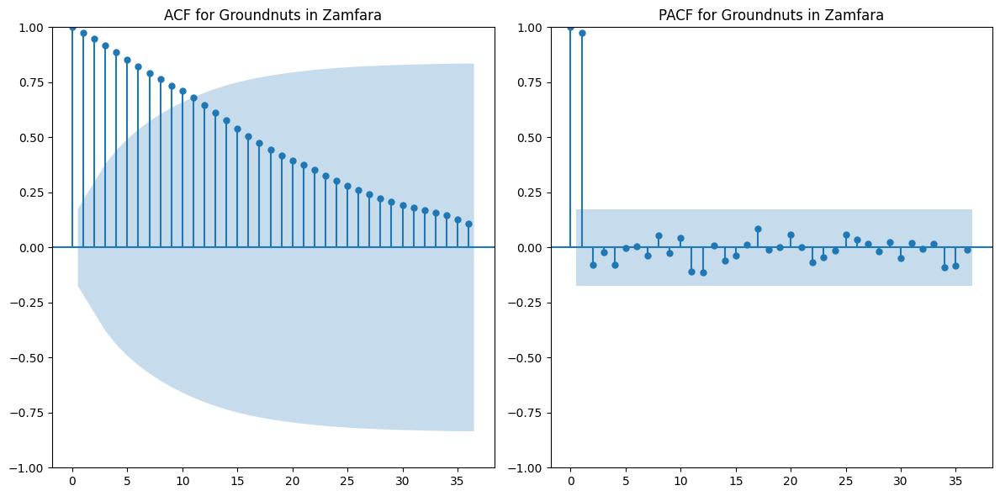


--- Analyzing: Maize in Abia ---
Observations for Maize in Abia: 126


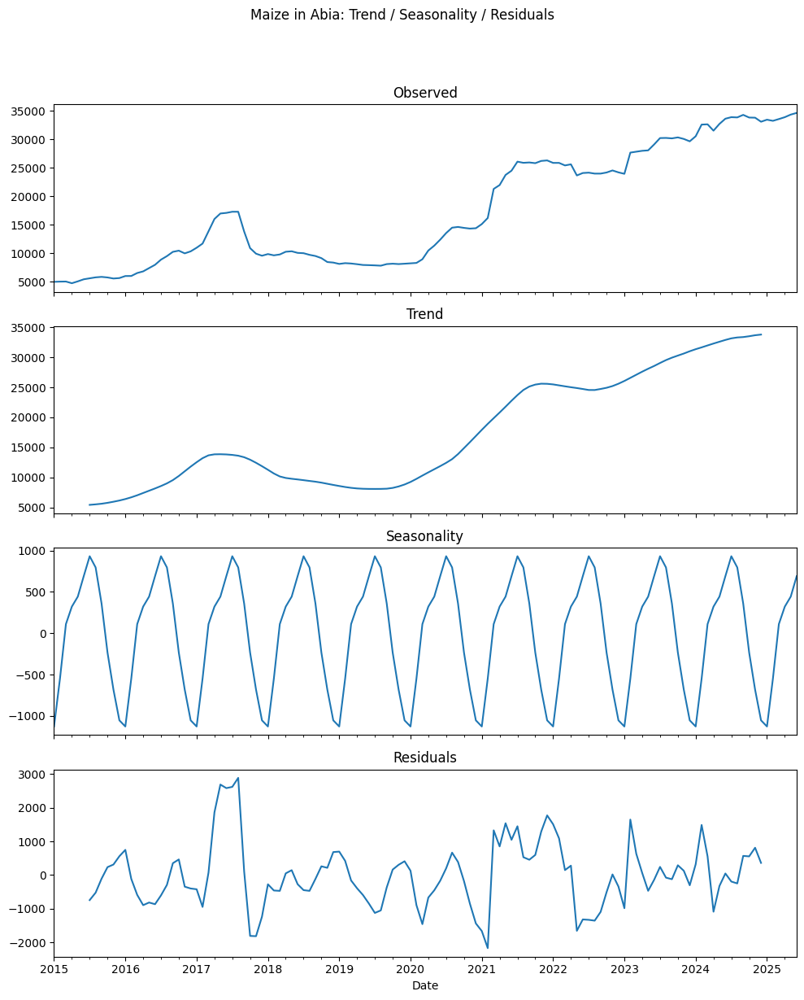

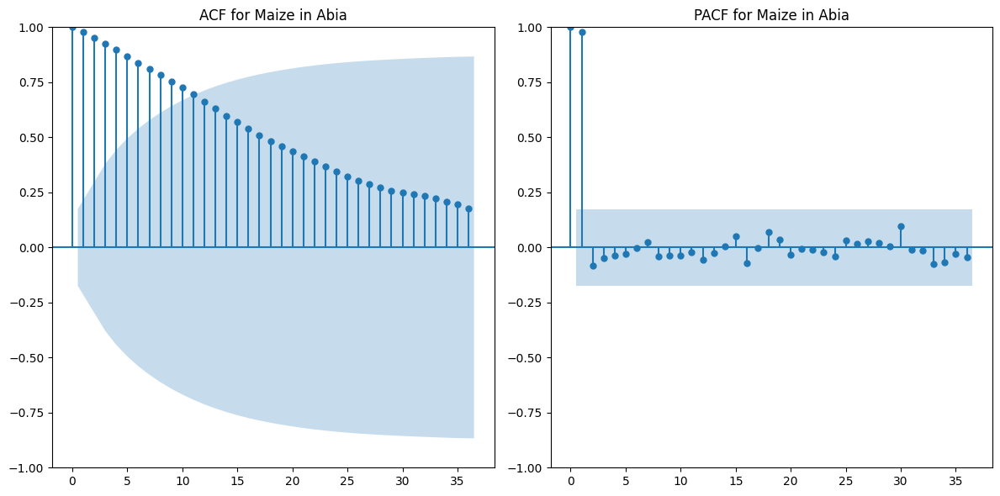


--- Analyzing: Maize in Adamawa ---
Observations for Maize in Adamawa: 126


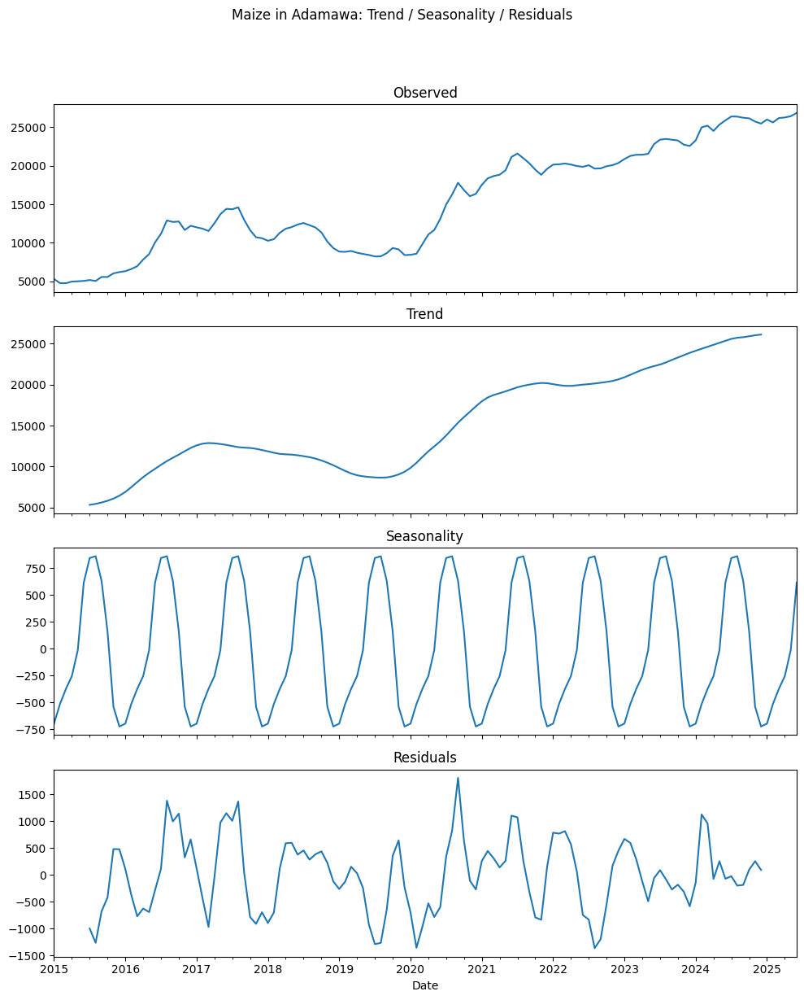

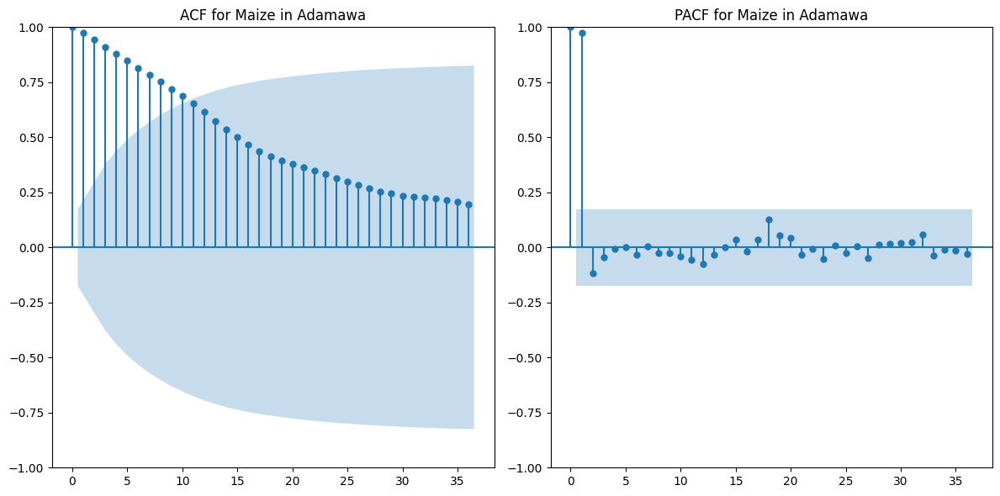


--- Analyzing: Maize in Borno ---
Observations for Maize in Borno: 126


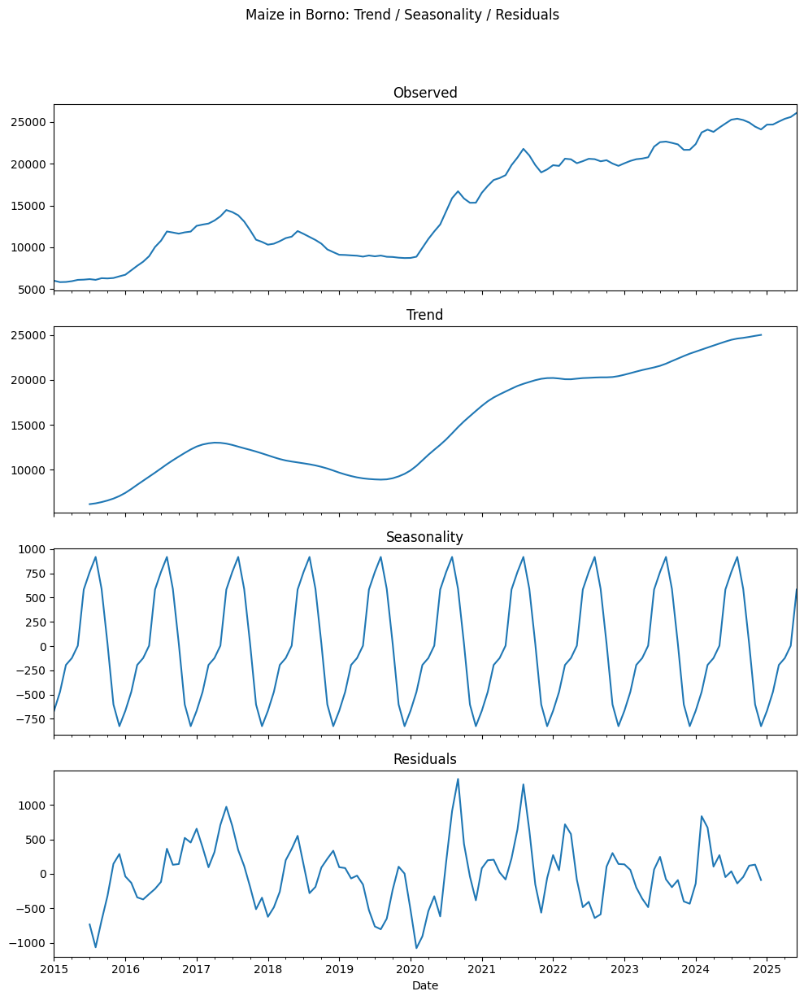

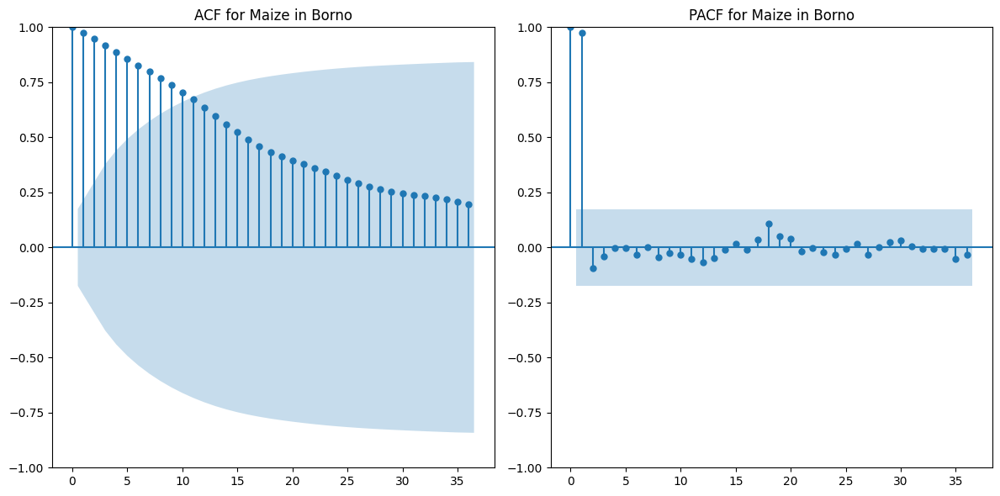


--- Analyzing: Maize in Gombe ---
Observations for Maize in Gombe: 126


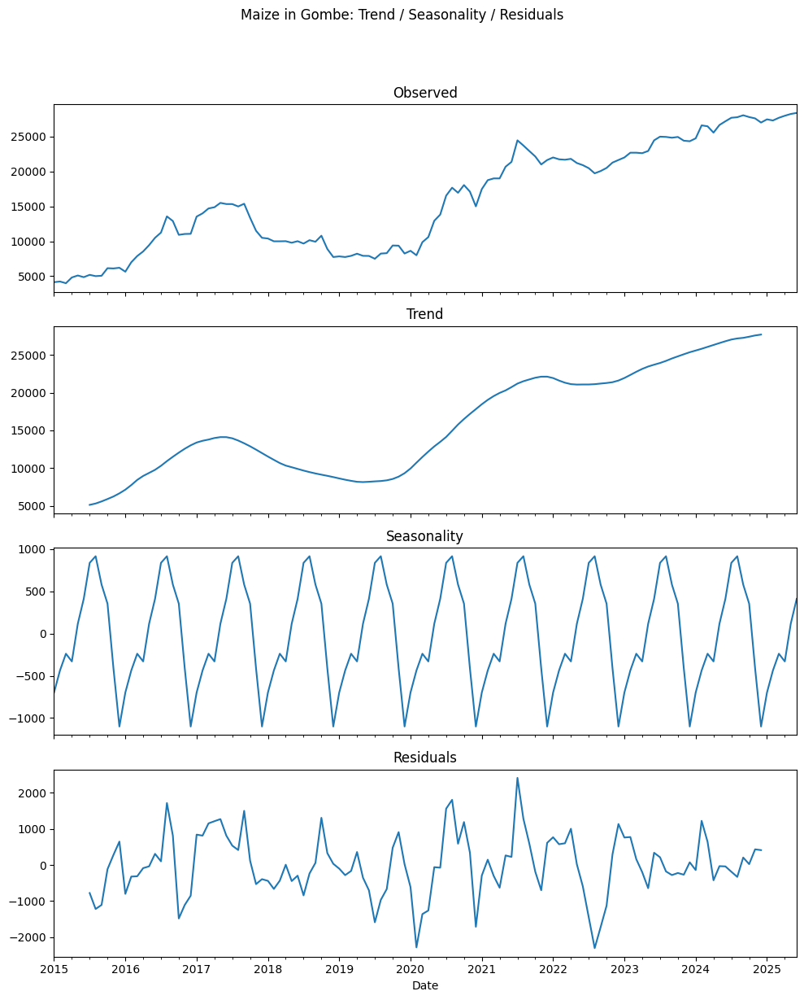

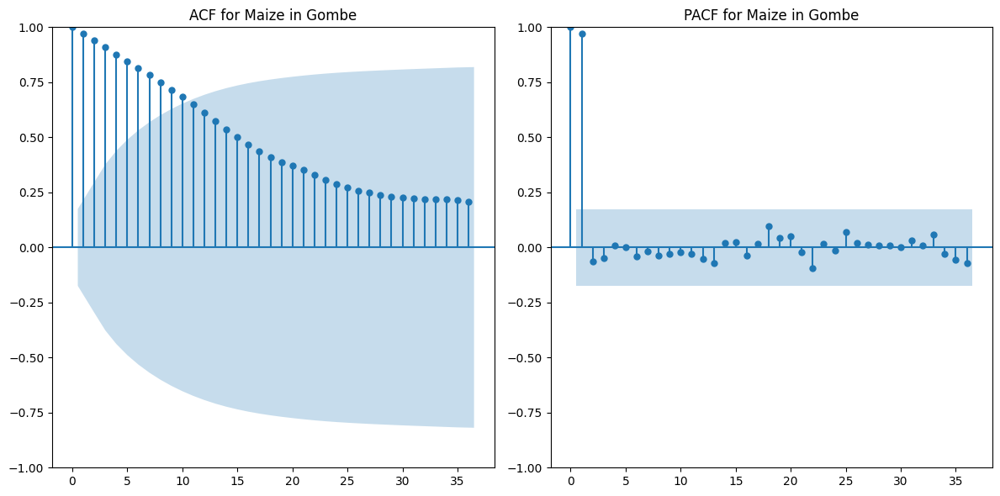


--- Analyzing: Maize in Jigawa ---
Observations for Maize in Jigawa: 126


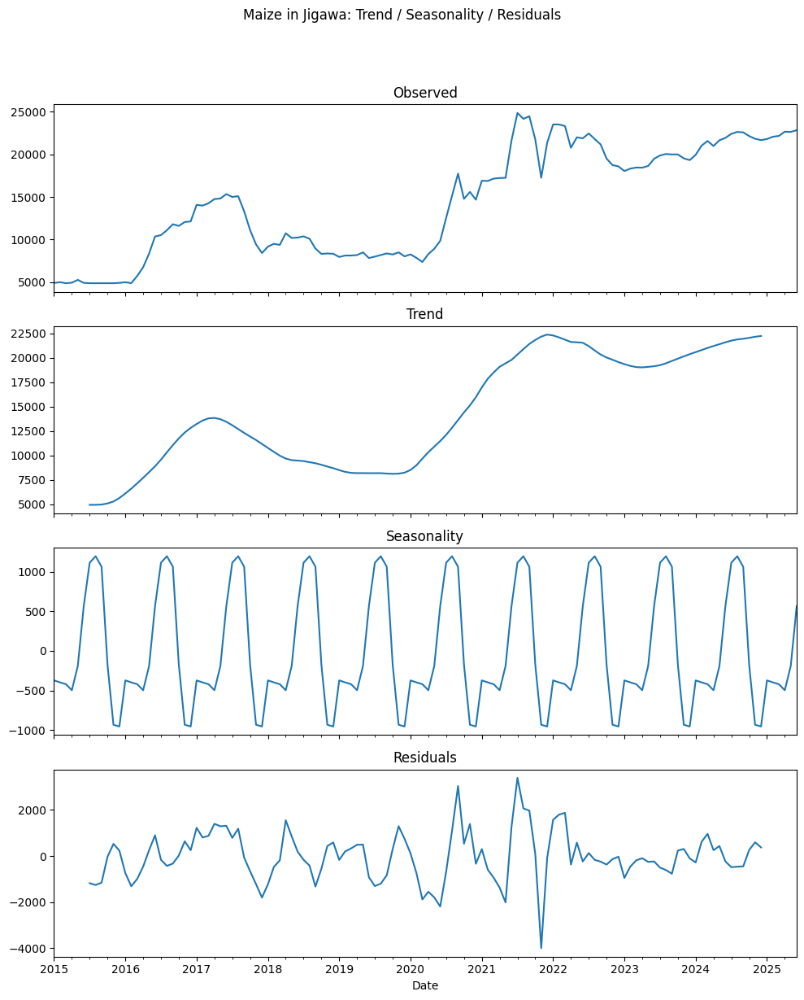

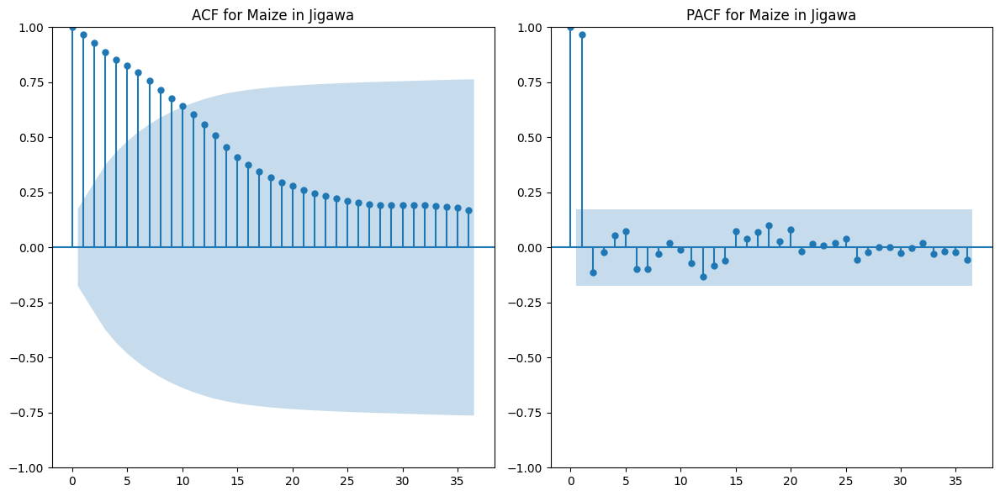


--- Analyzing: Maize in Kaduna ---
Observations for Maize in Kaduna: 126


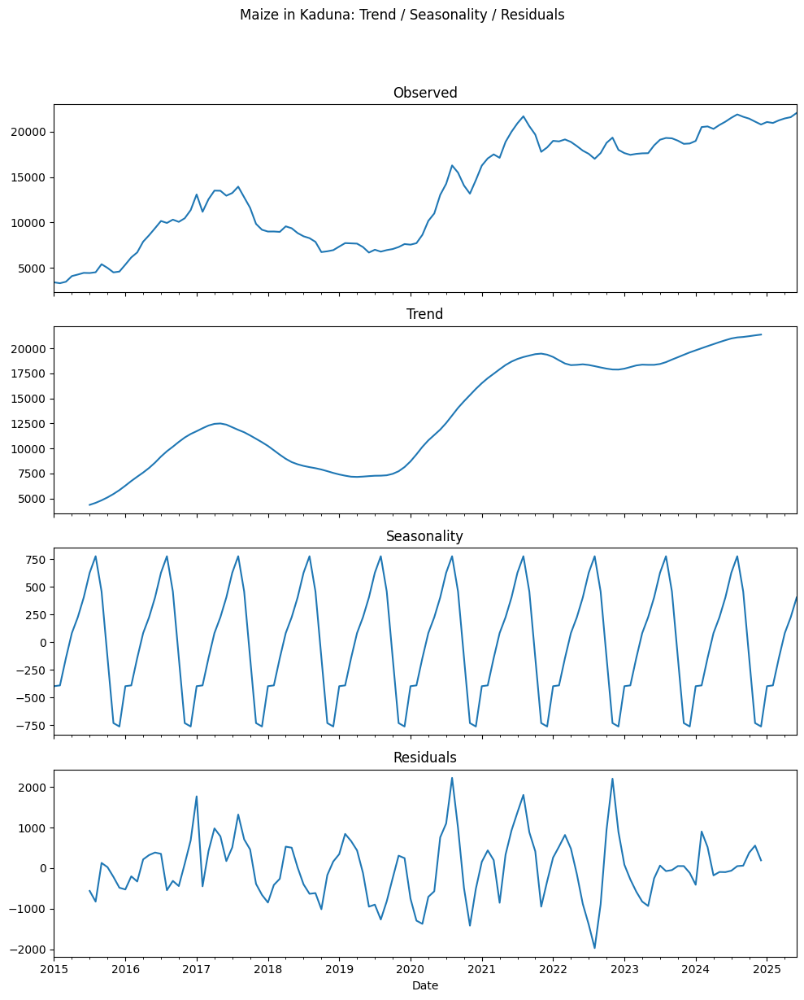

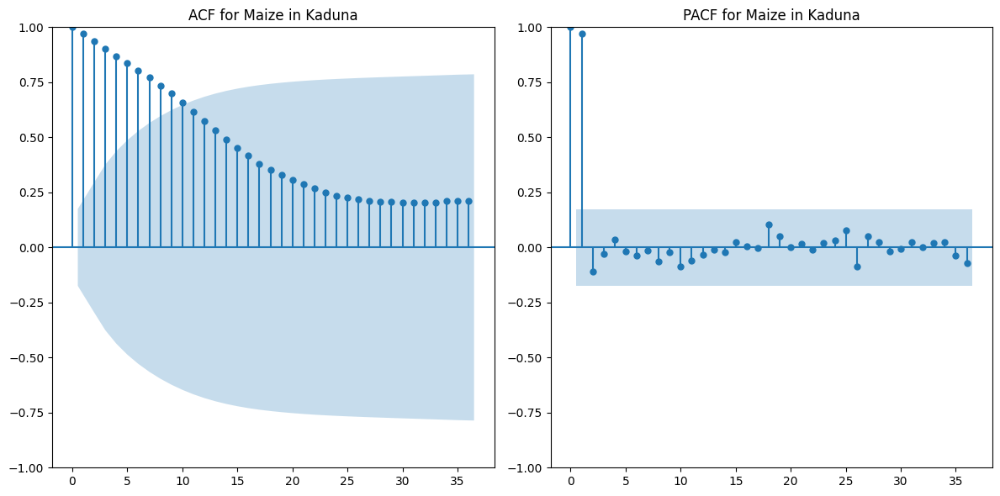


--- Analyzing: Maize in Kano ---
Observations for Maize in Kano: 126


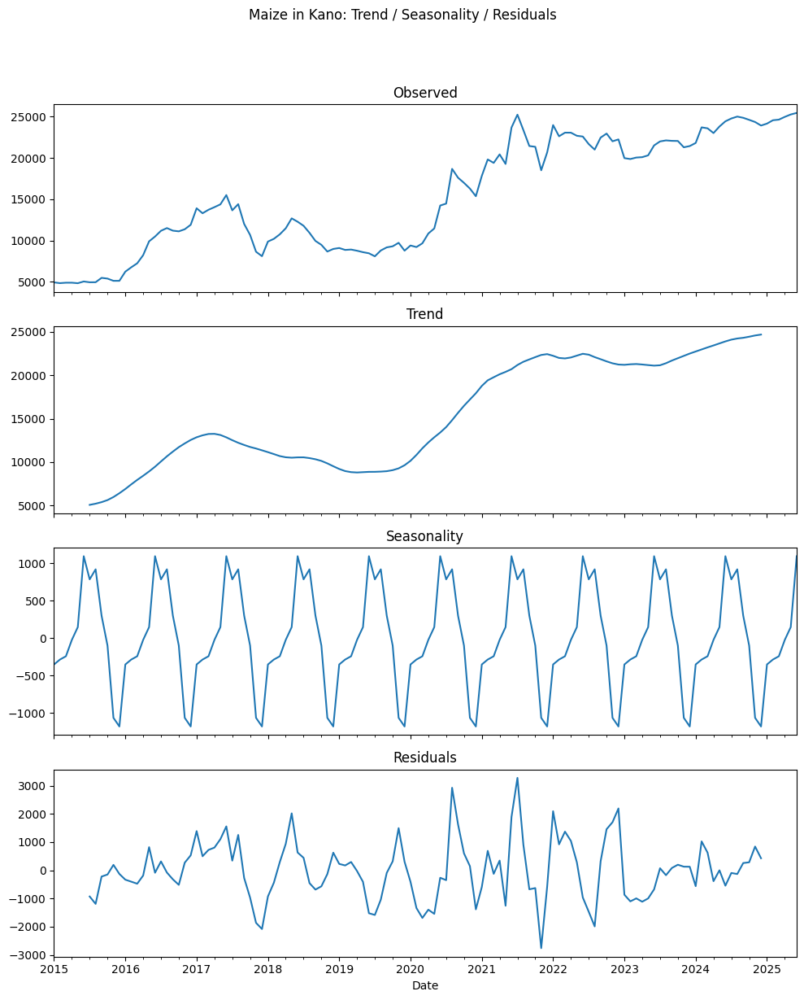

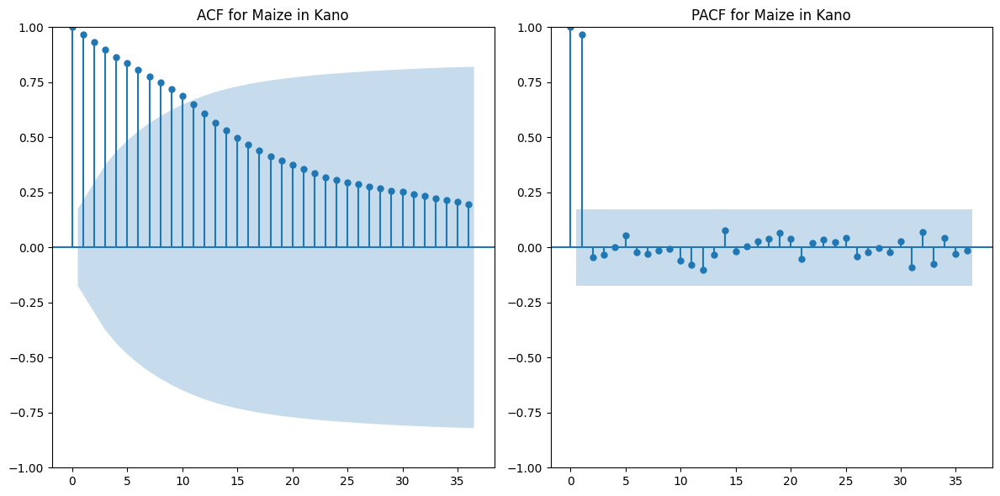


--- Analyzing: Maize in Katsina ---
Observations for Maize in Katsina: 126


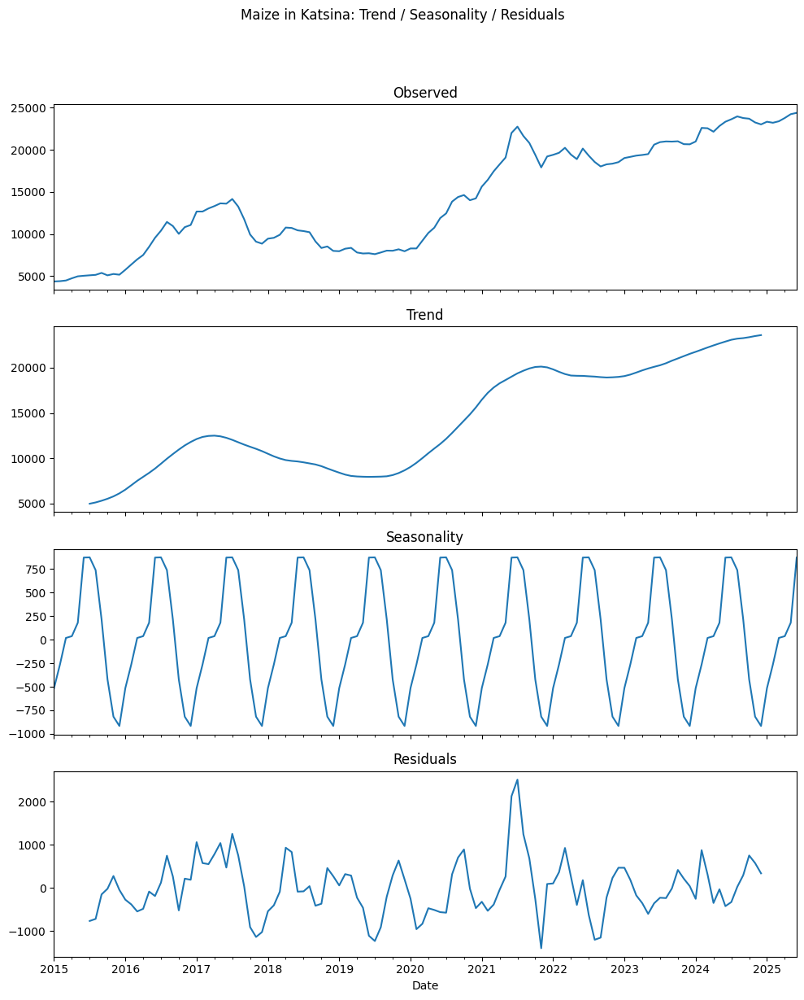

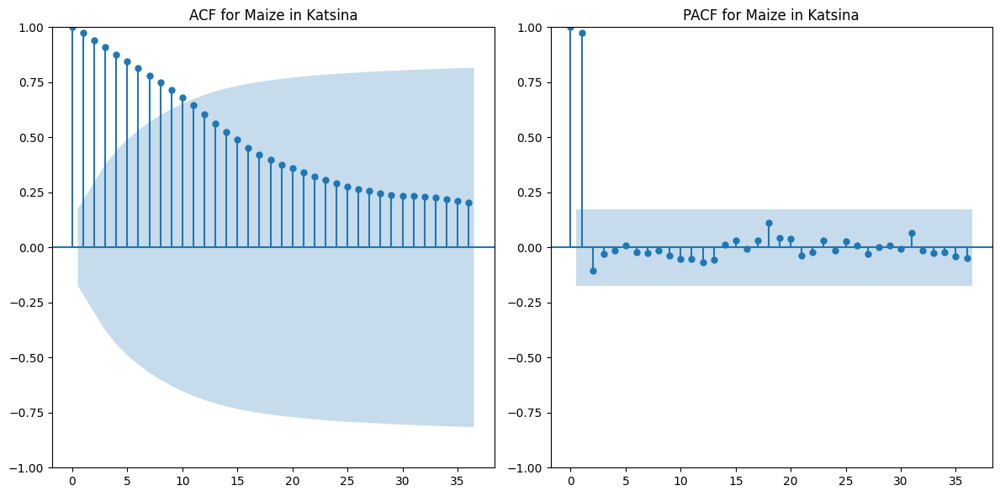


--- Analyzing: Maize in Kebbi ---
Observations for Maize in Kebbi: 126


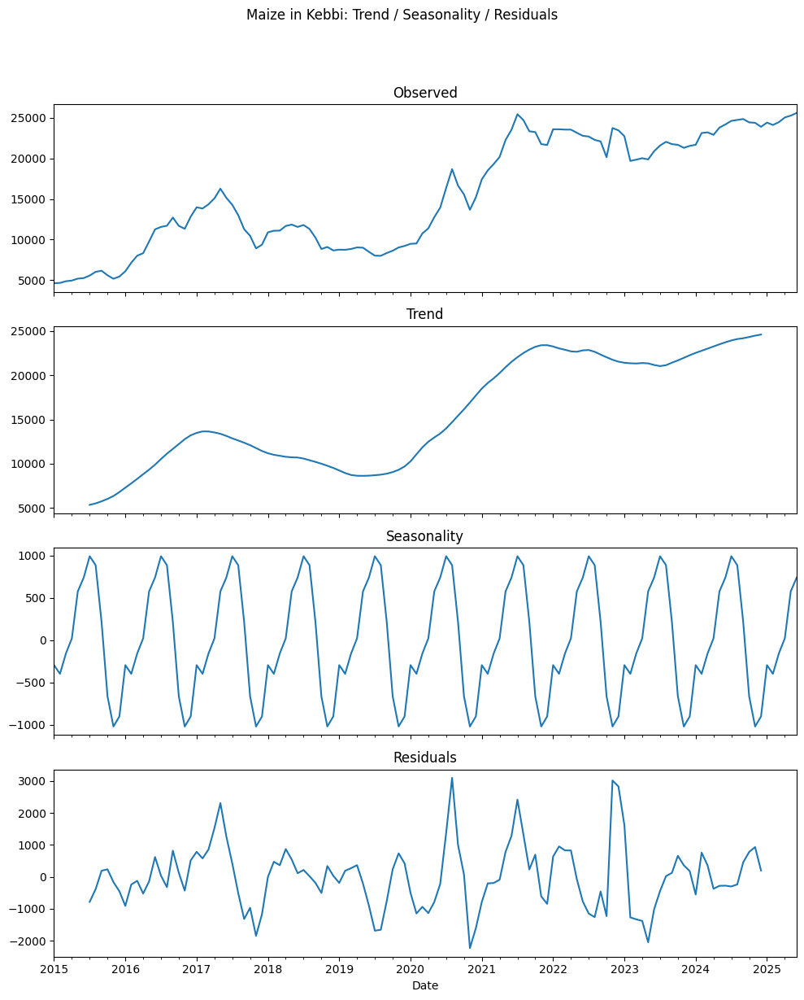

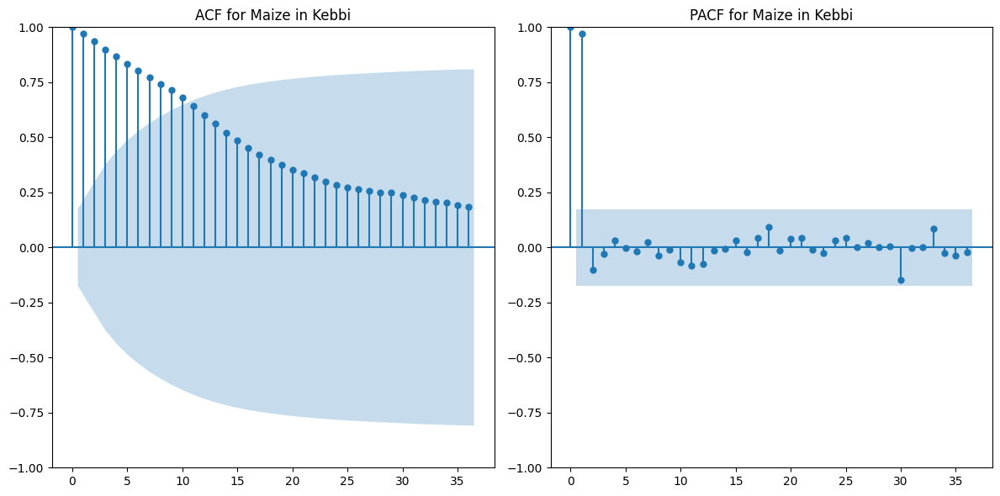


--- Analyzing: Maize in Lagos ---
Observations for Maize in Lagos: 126


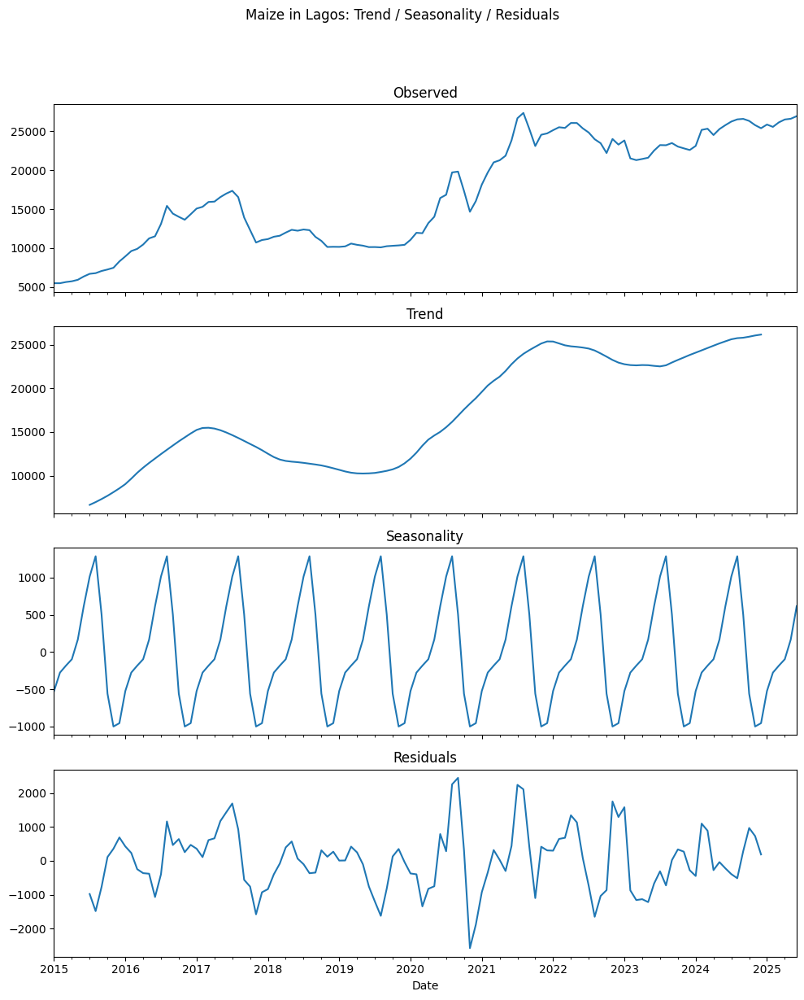

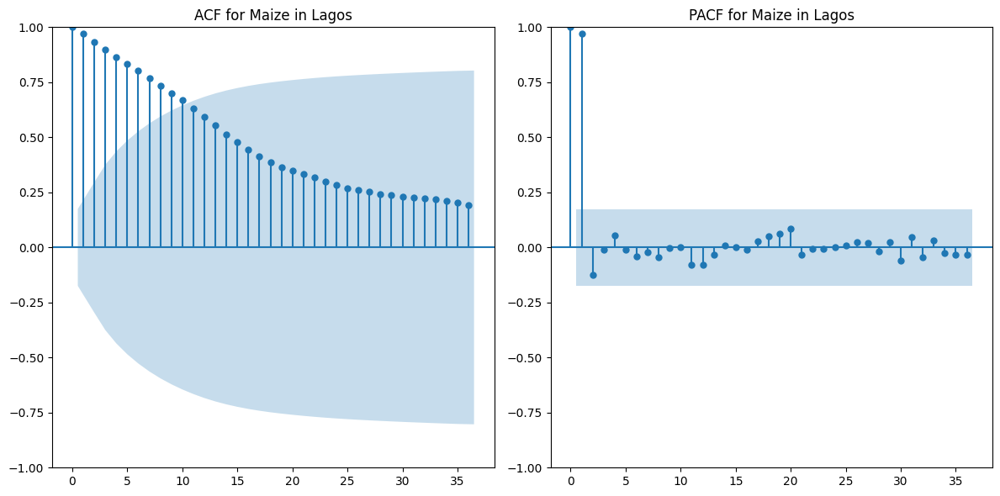


--- Analyzing: Maize in Oyo ---
Observations for Maize in Oyo: 126


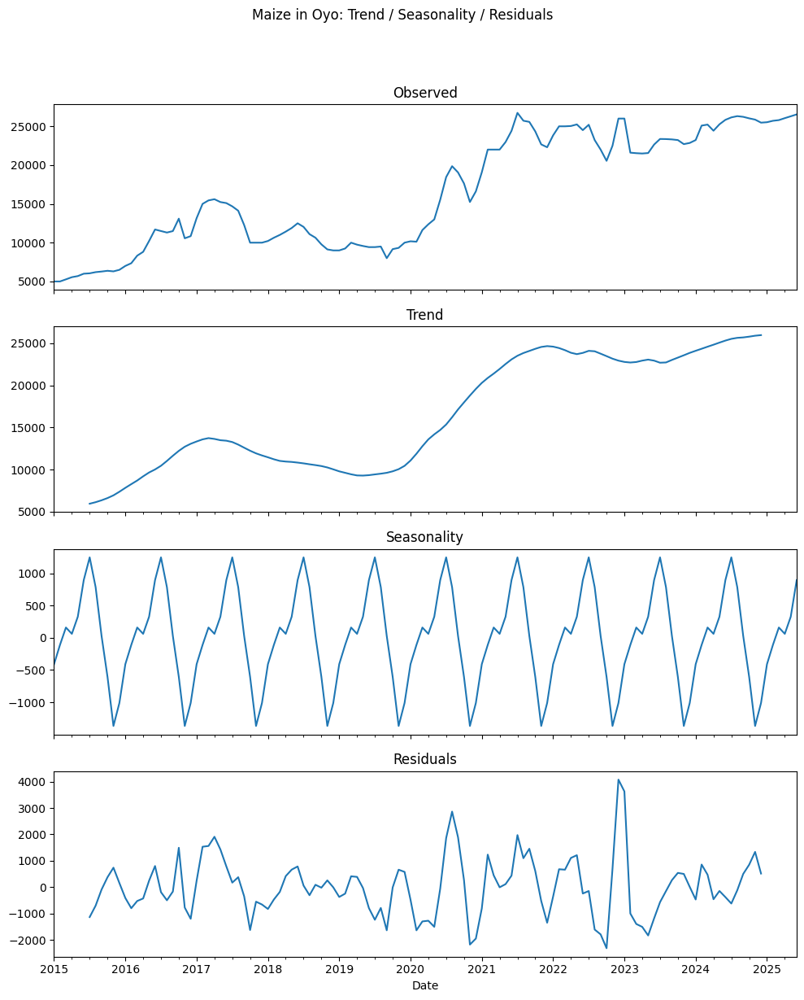

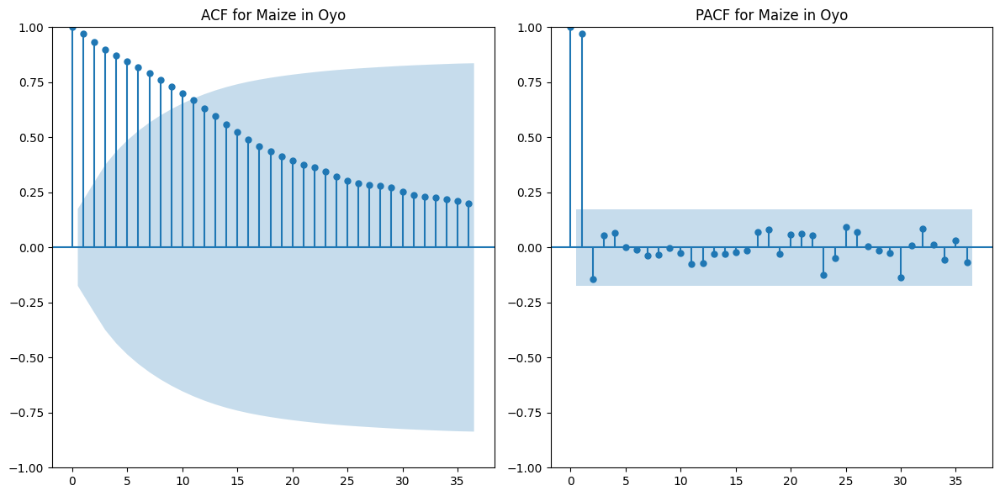


--- Analyzing: Maize in Yobe ---
Observations for Maize in Yobe: 126


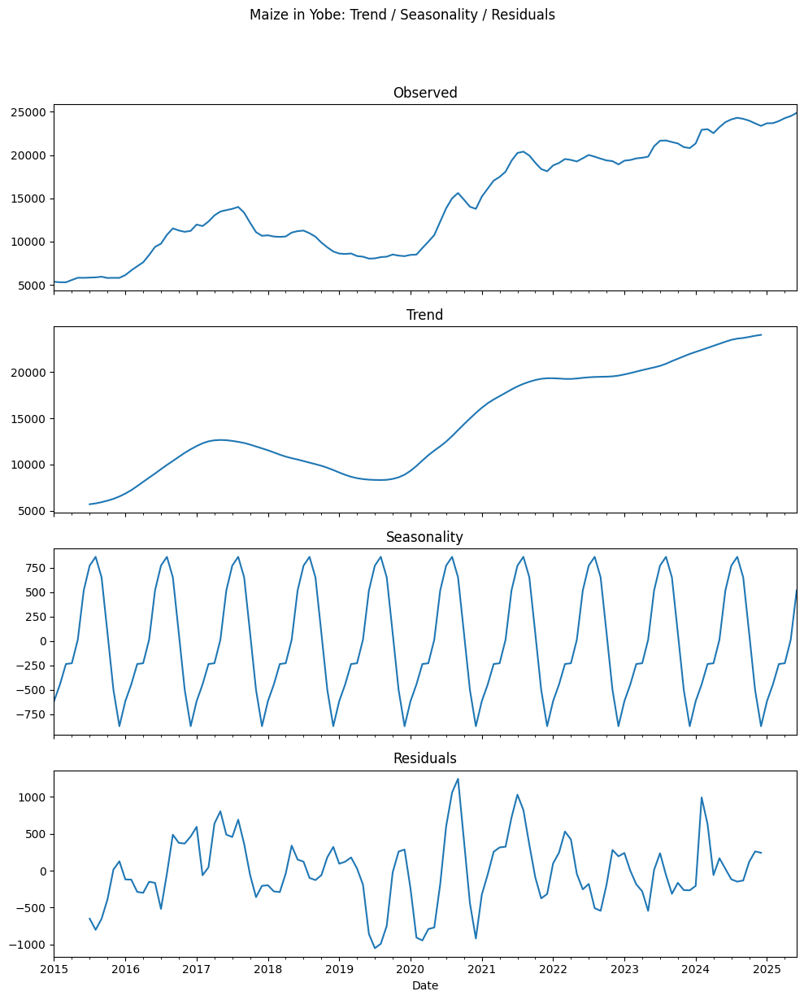

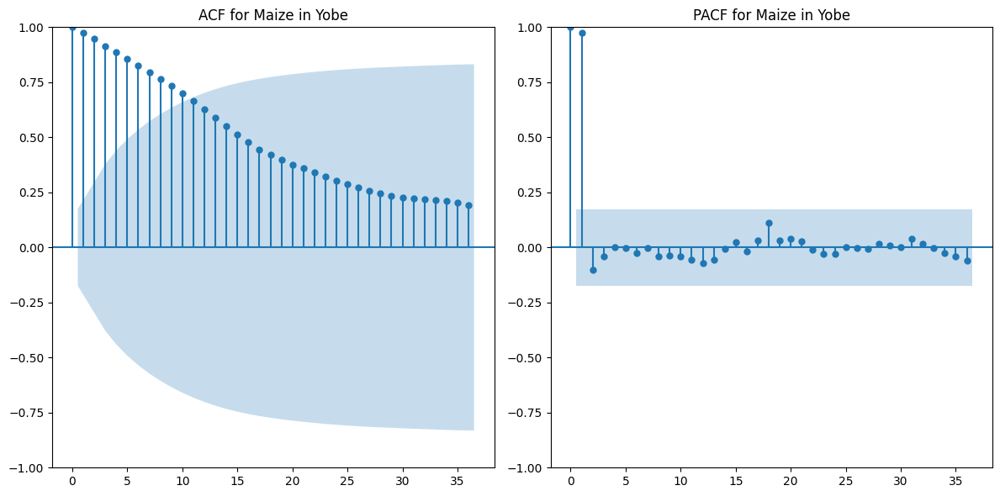


--- Analyzing: Maize in Zamfara ---
Observations for Maize in Zamfara: 126


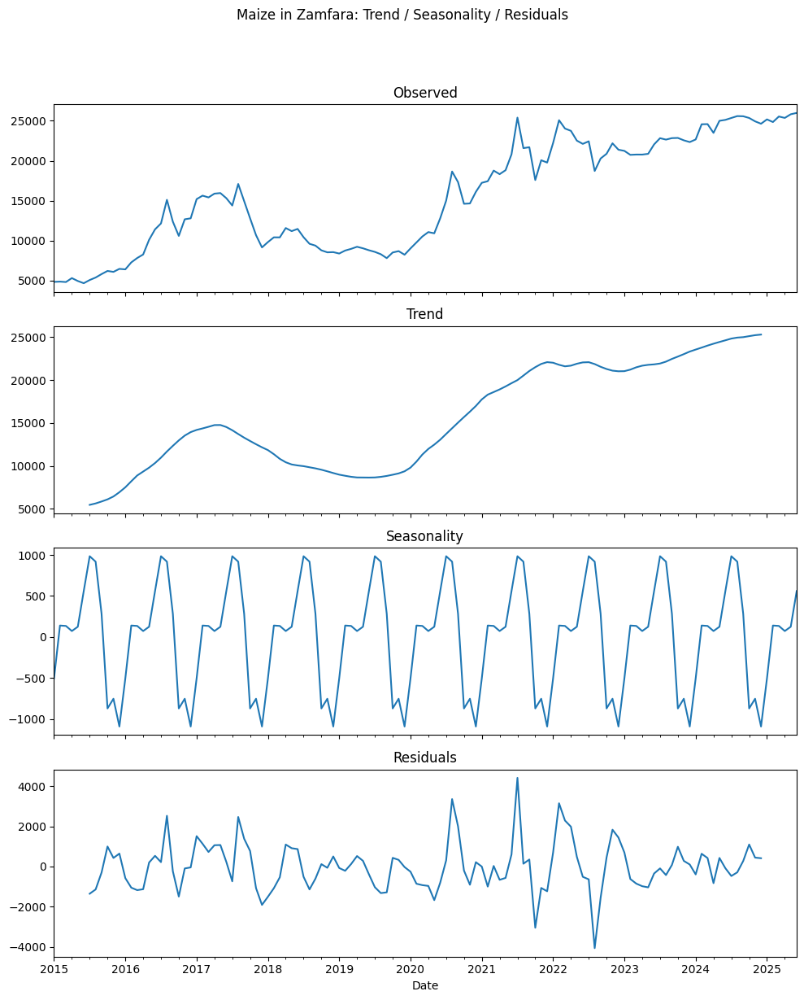

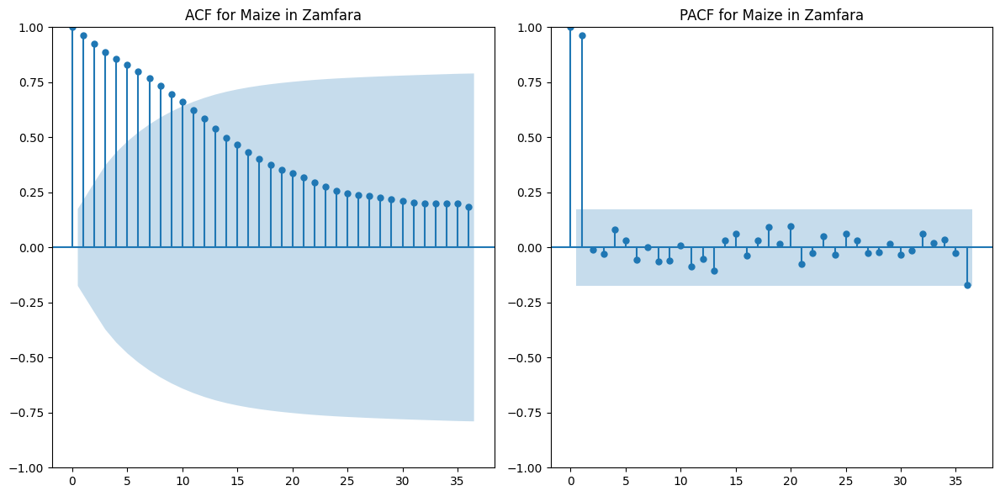


--- Analyzing: Millet in Abia ---
Observations for Millet in Abia: 0
⚠️ Skipping Millet in Abia: not enough data (need at least 24 months for decomposition). Found 0.

--- Analyzing: Millet in Adamawa ---
Observations for Millet in Adamawa: 0
⚠️ Skipping Millet in Adamawa: not enough data (need at least 24 months for decomposition). Found 0.

--- Analyzing: Millet in Borno ---
Observations for Millet in Borno: 0
⚠️ Skipping Millet in Borno: not enough data (need at least 24 months for decomposition). Found 0.

--- Analyzing: Millet in Gombe ---
Observations for Millet in Gombe: 0
⚠️ Skipping Millet in Gombe: not enough data (need at least 24 months for decomposition). Found 0.

--- Analyzing: Millet in Jigawa ---
Observations for Millet in Jigawa: 0
⚠️ Skipping Millet in Jigawa: not enough data (need at least 24 months for decomposition). Found 0.

--- Analyzing: Millet in Kaduna ---
Observations for Millet in Kaduna: 0
⚠️ Skipping Millet in Kaduna: not enough data (need at least 24 m

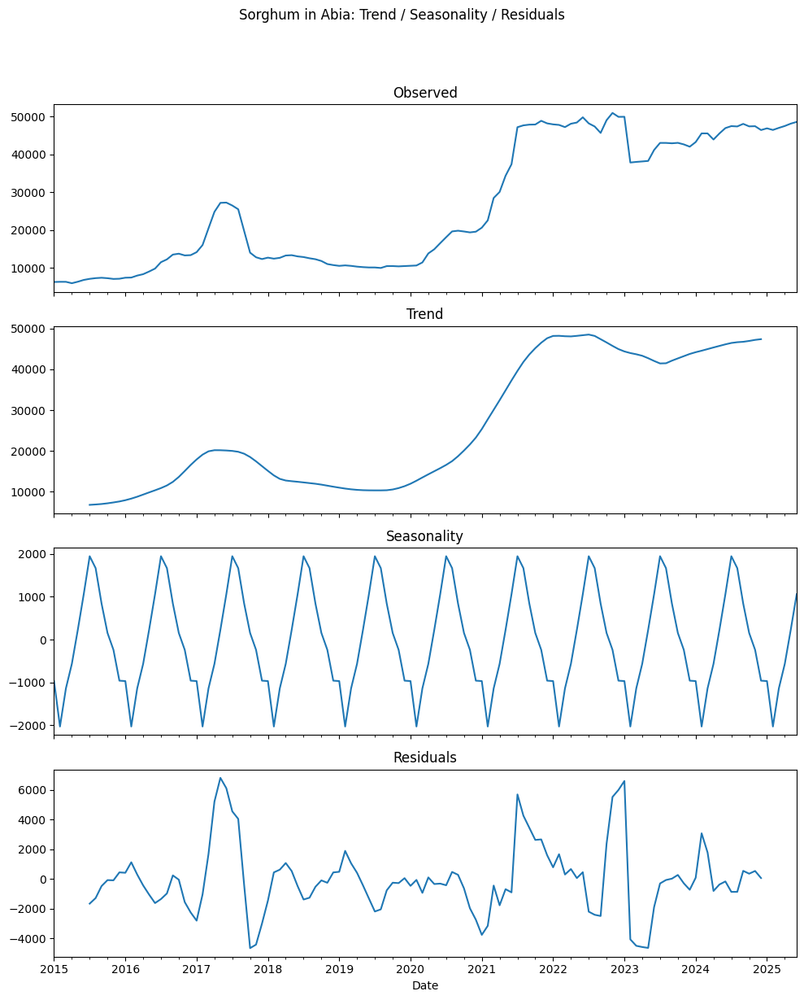

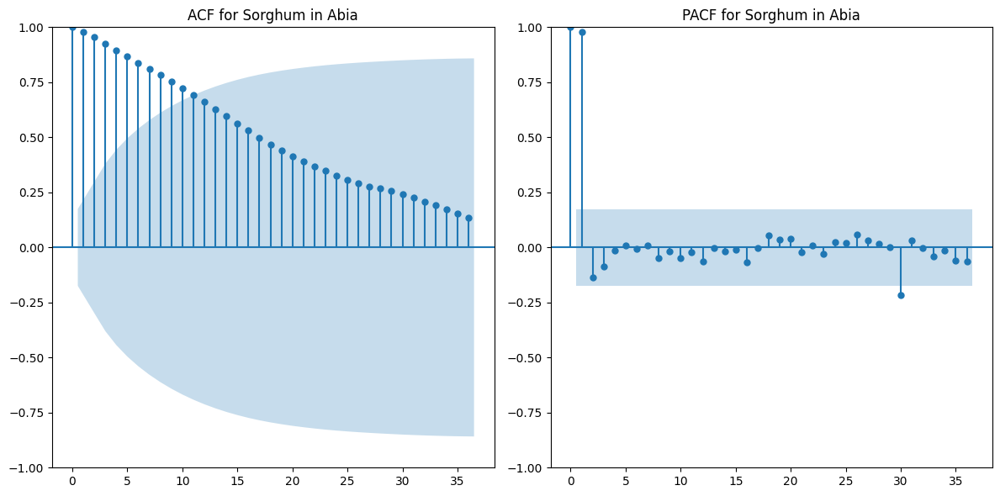


--- Analyzing: Sorghum in Adamawa ---
Observations for Sorghum in Adamawa: 126


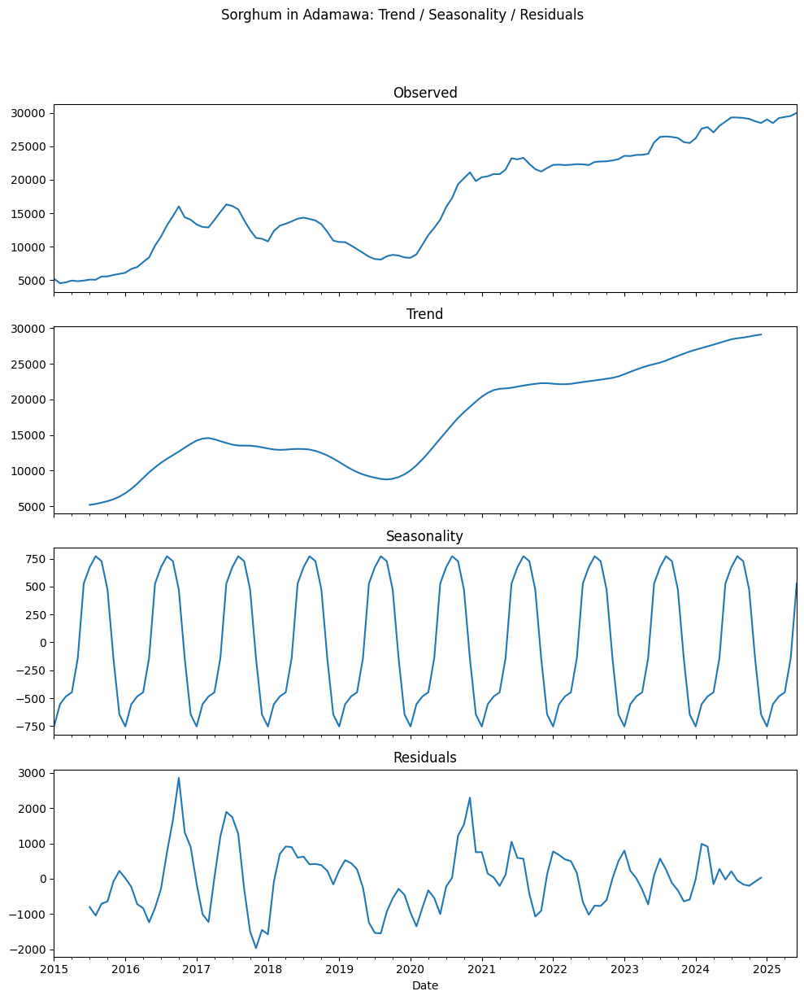

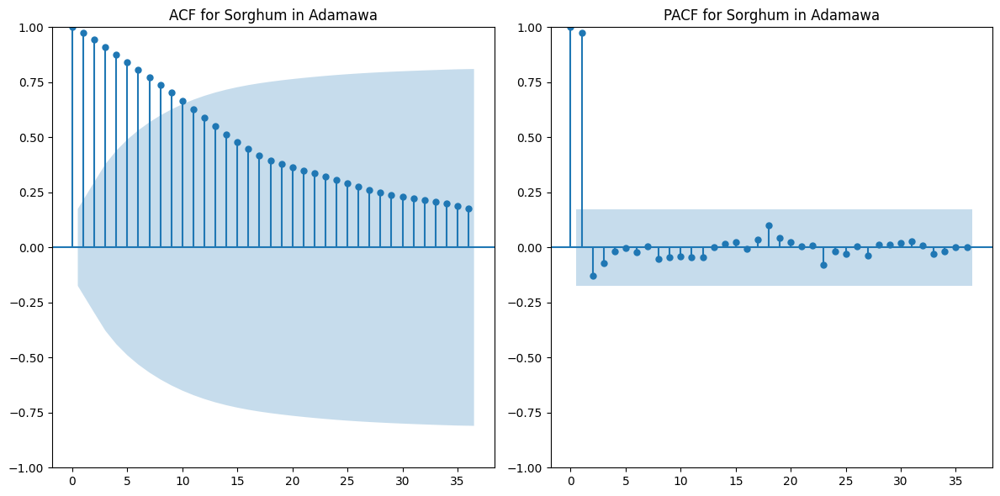


--- Analyzing: Sorghum in Borno ---
Observations for Sorghum in Borno: 126


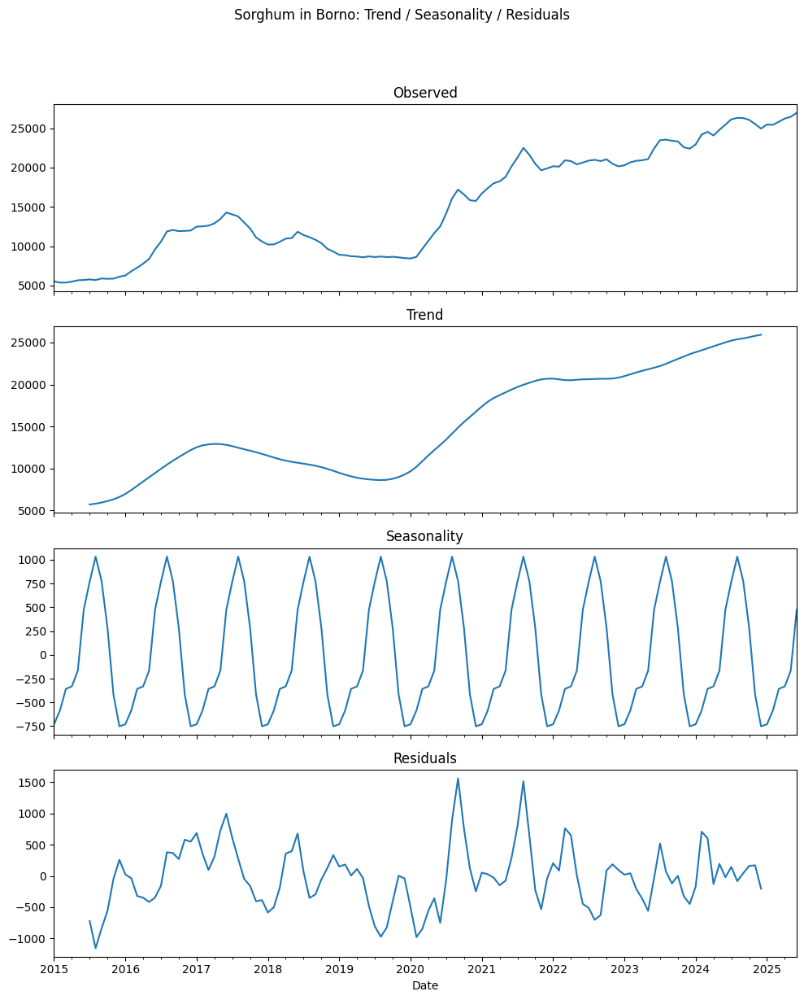

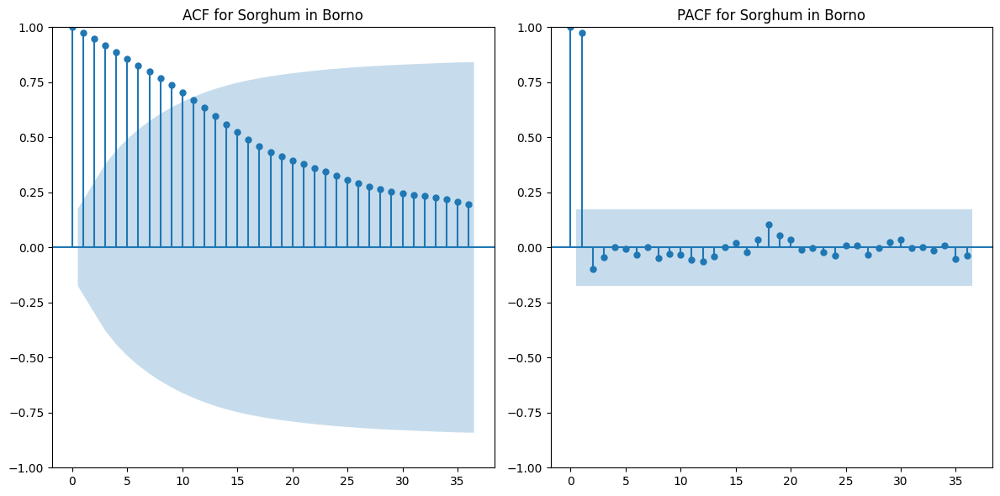


--- Analyzing: Sorghum in Gombe ---
Observations for Sorghum in Gombe: 126


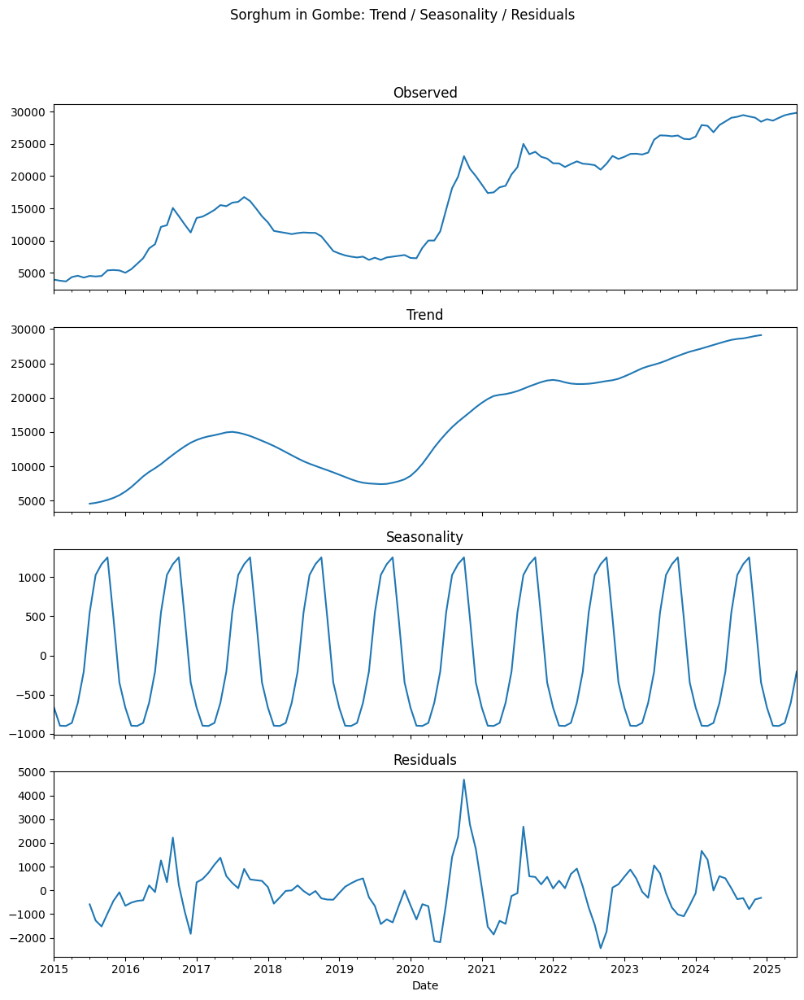

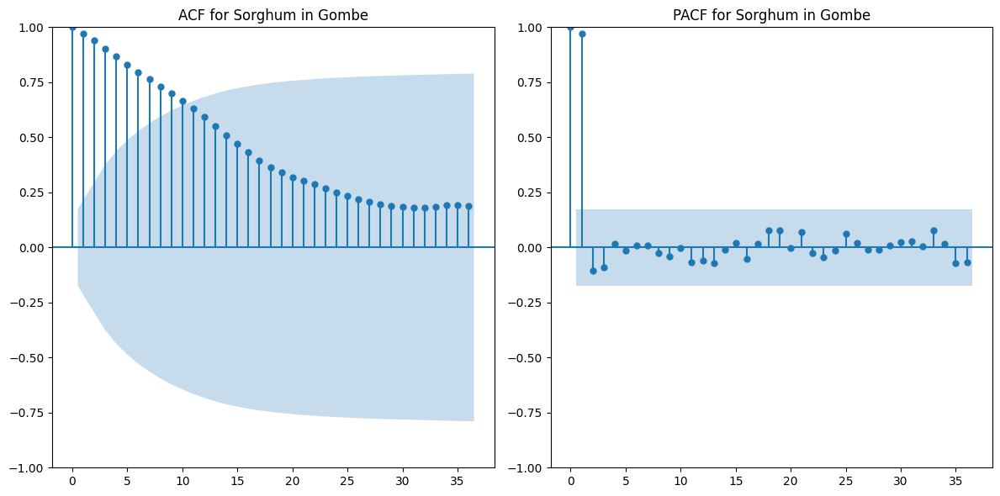


--- Analyzing: Sorghum in Jigawa ---
Observations for Sorghum in Jigawa: 126


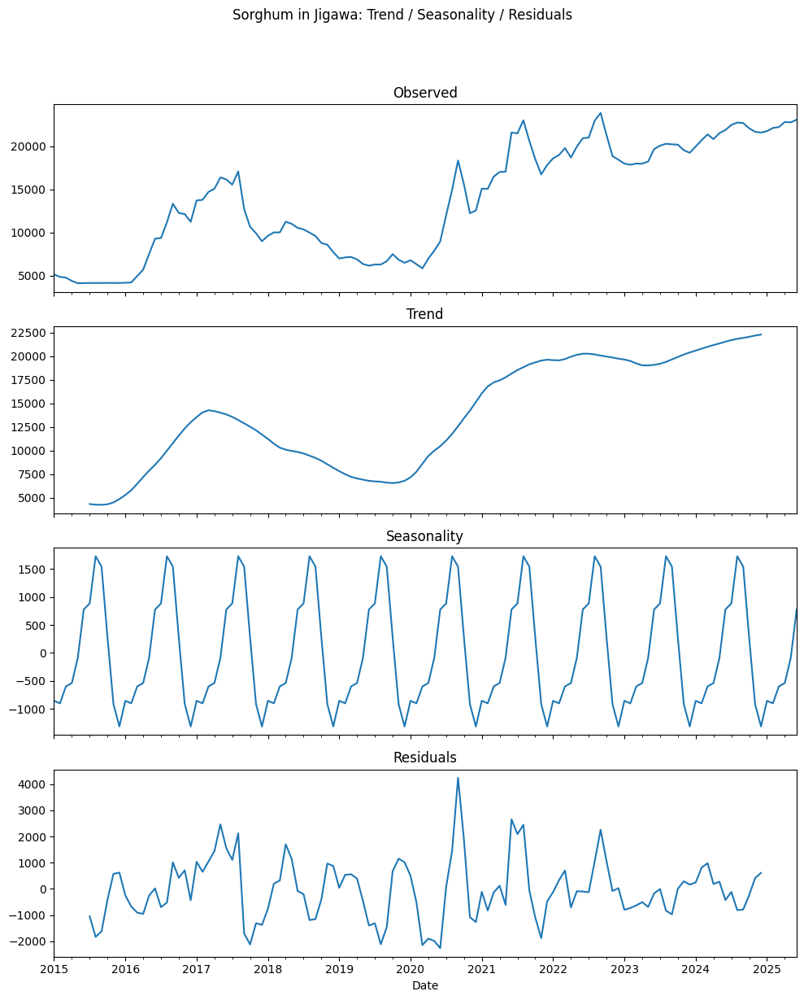

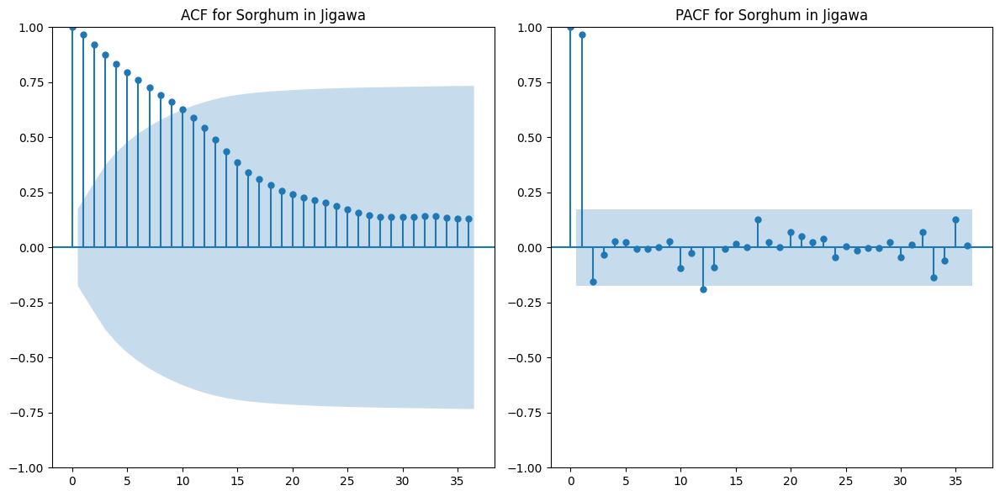


--- Analyzing: Sorghum in Kaduna ---
Observations for Sorghum in Kaduna: 126


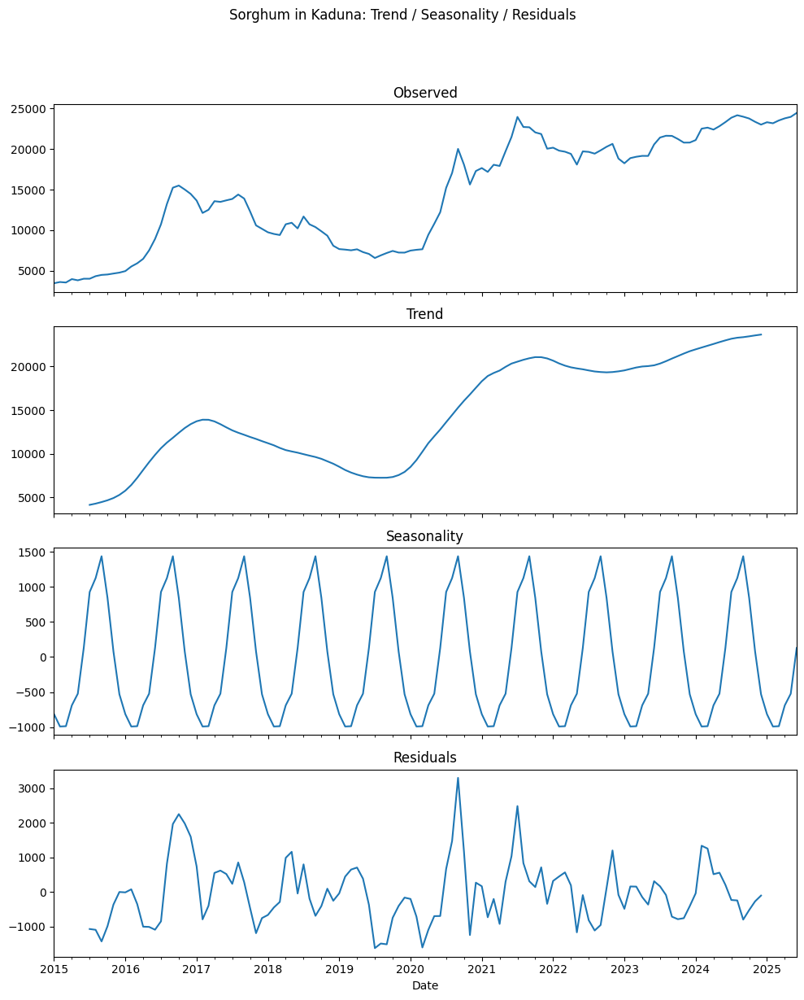

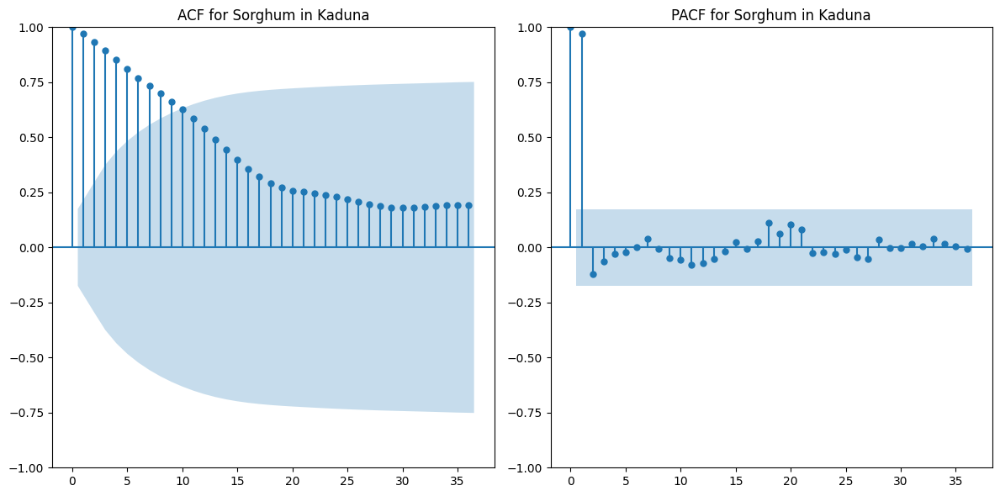


--- Analyzing: Sorghum in Kano ---
Observations for Sorghum in Kano: 126


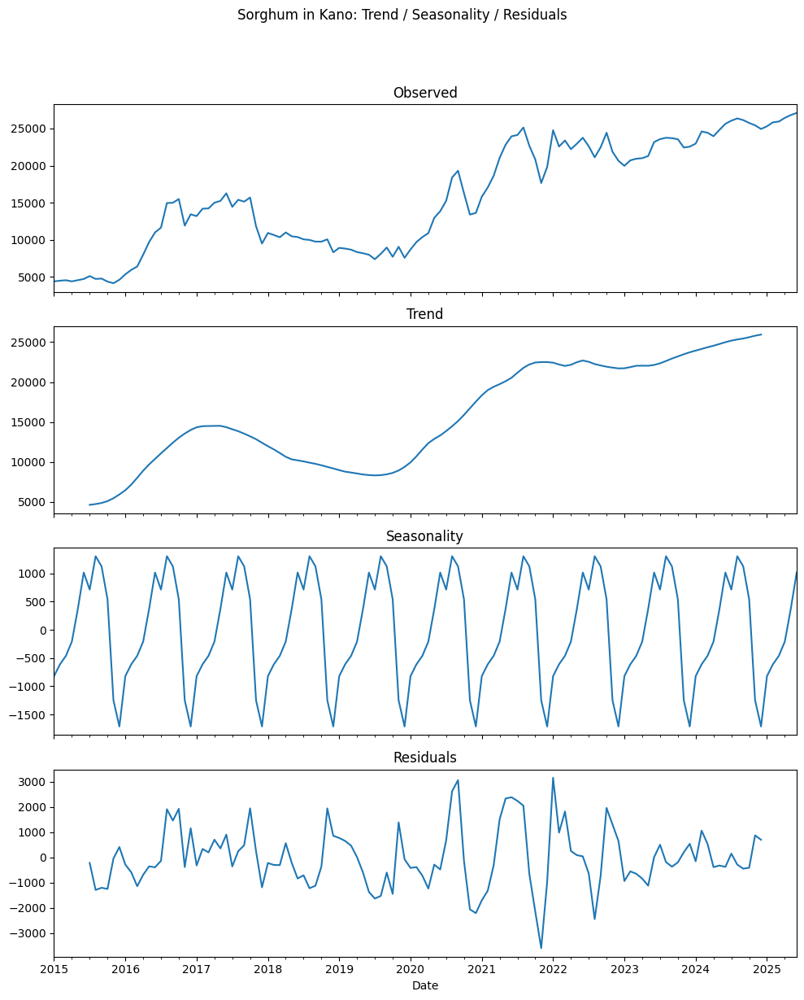

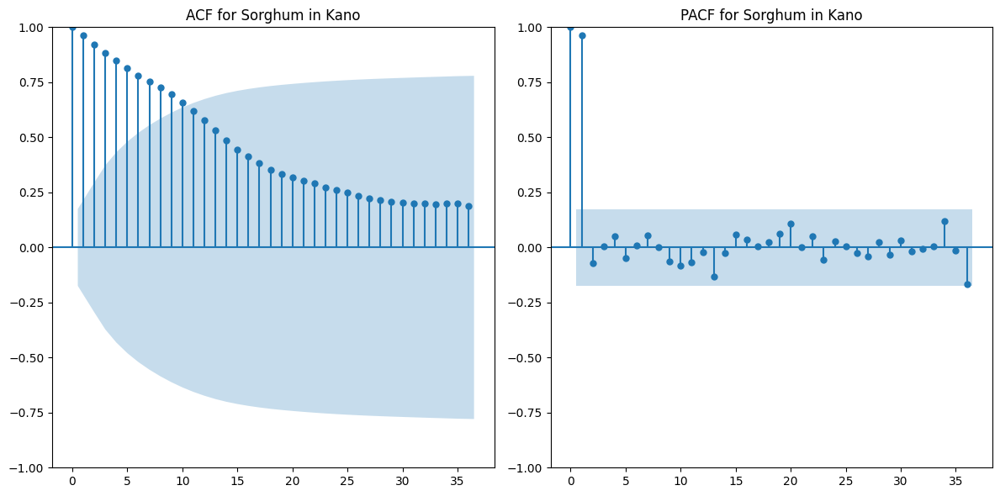


--- Analyzing: Sorghum in Katsina ---
Observations for Sorghum in Katsina: 126


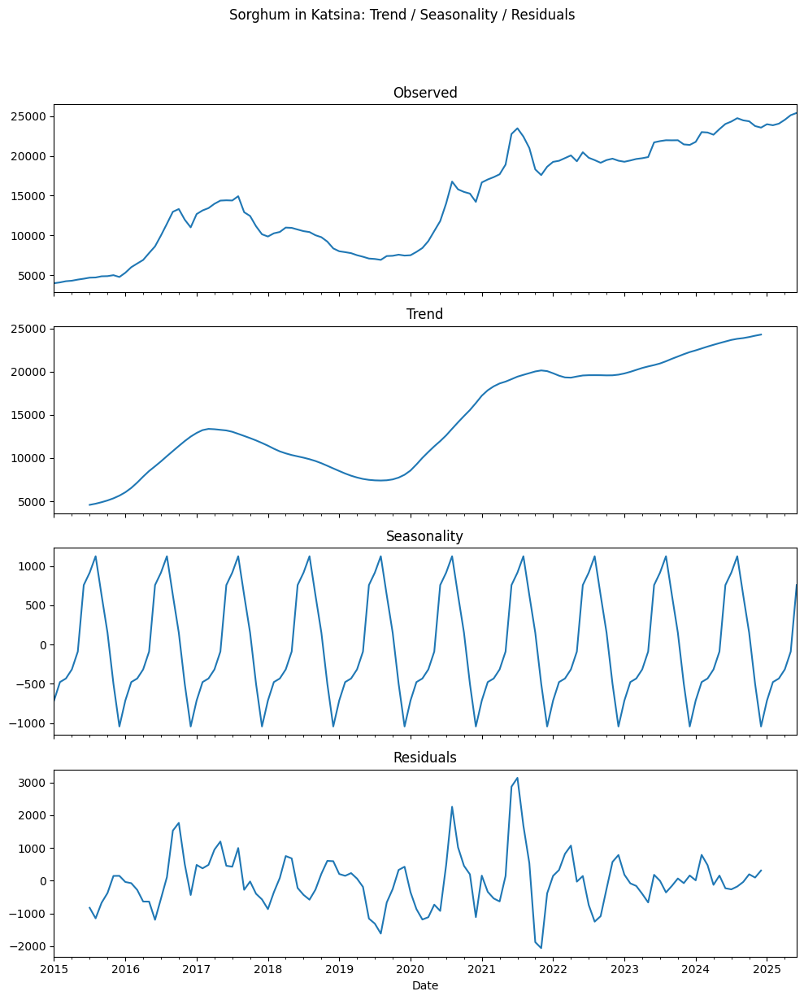

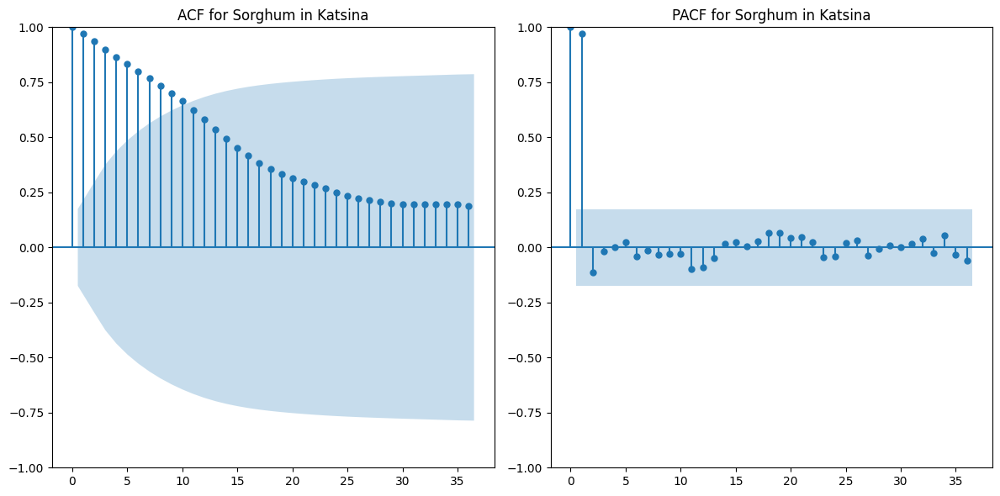


--- Analyzing: Sorghum in Kebbi ---
Observations for Sorghum in Kebbi: 126


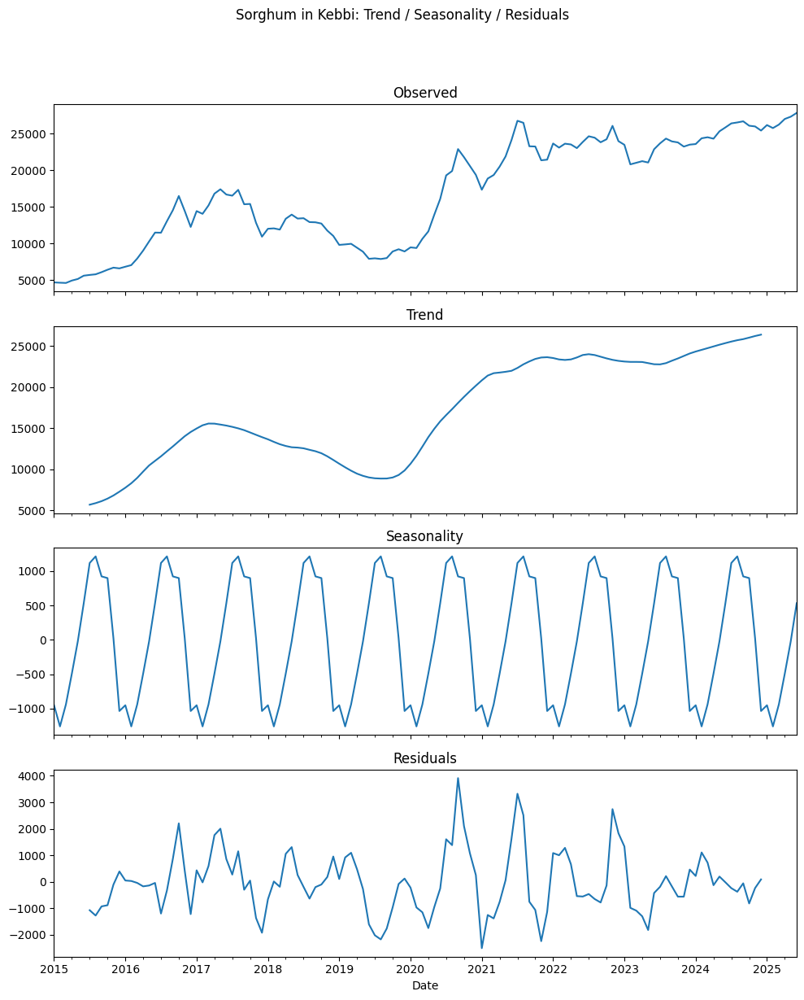

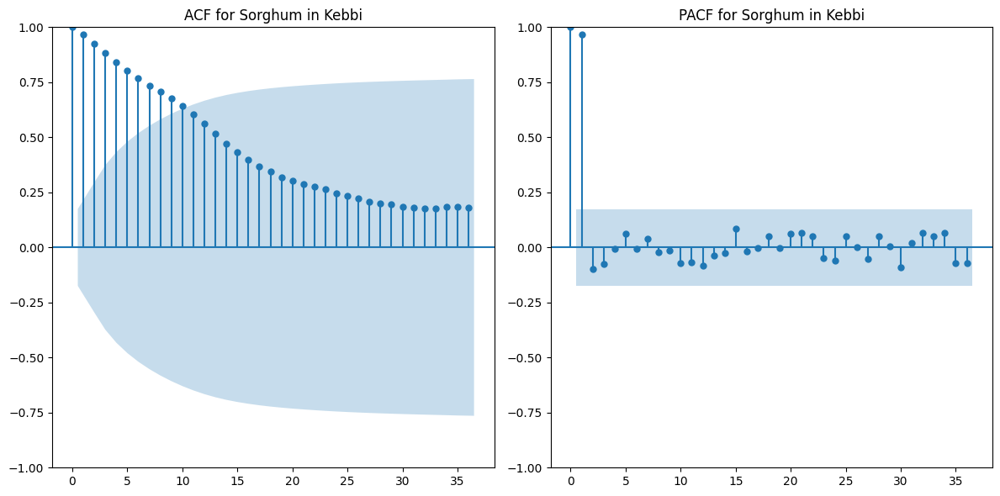


--- Analyzing: Sorghum in Lagos ---
Observations for Sorghum in Lagos: 126


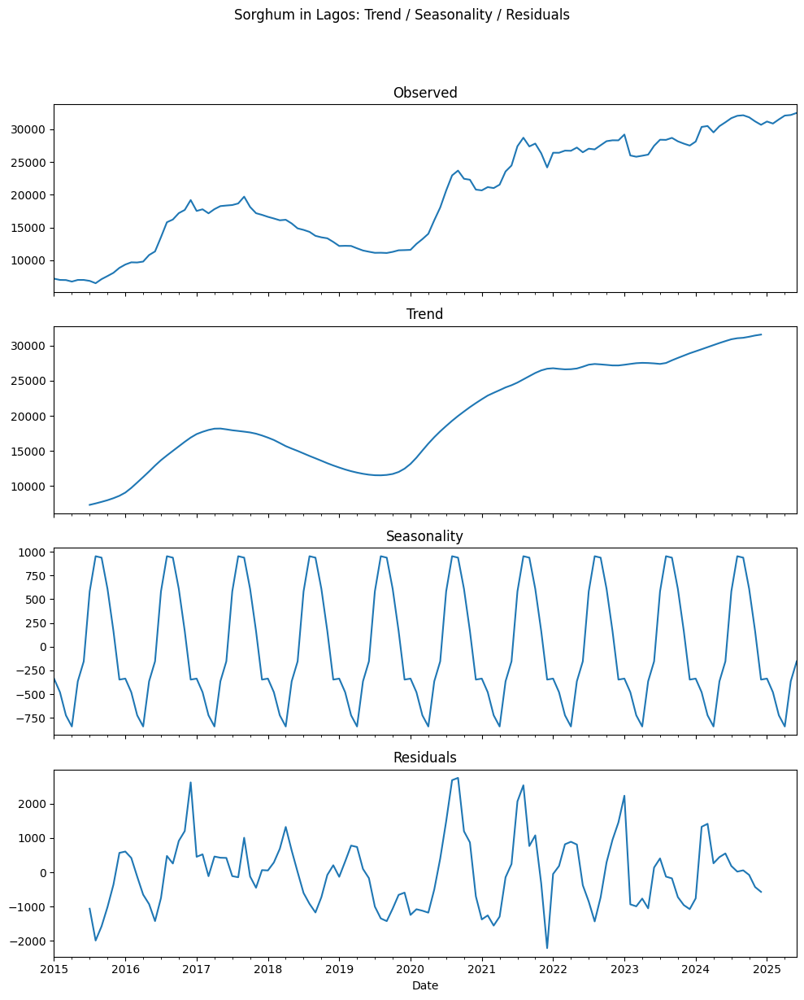

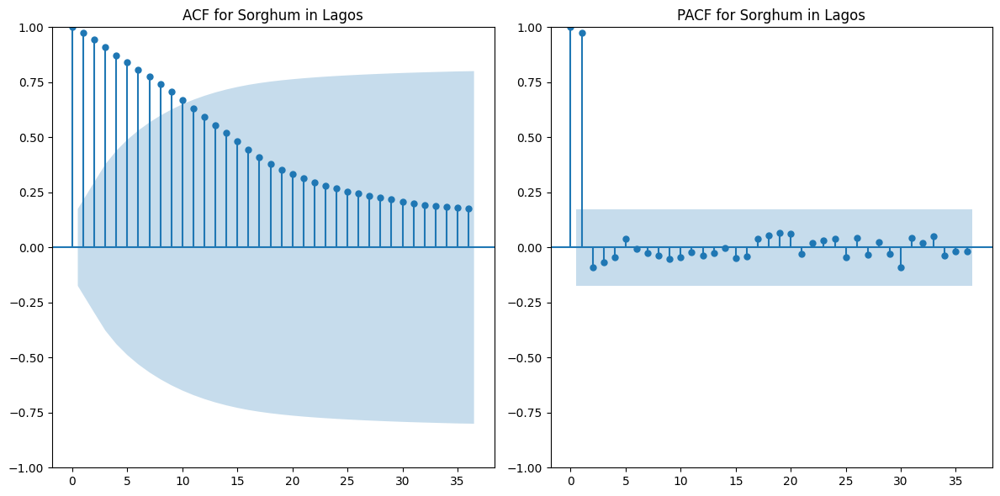


--- Analyzing: Sorghum in Oyo ---
Observations for Sorghum in Oyo: 126


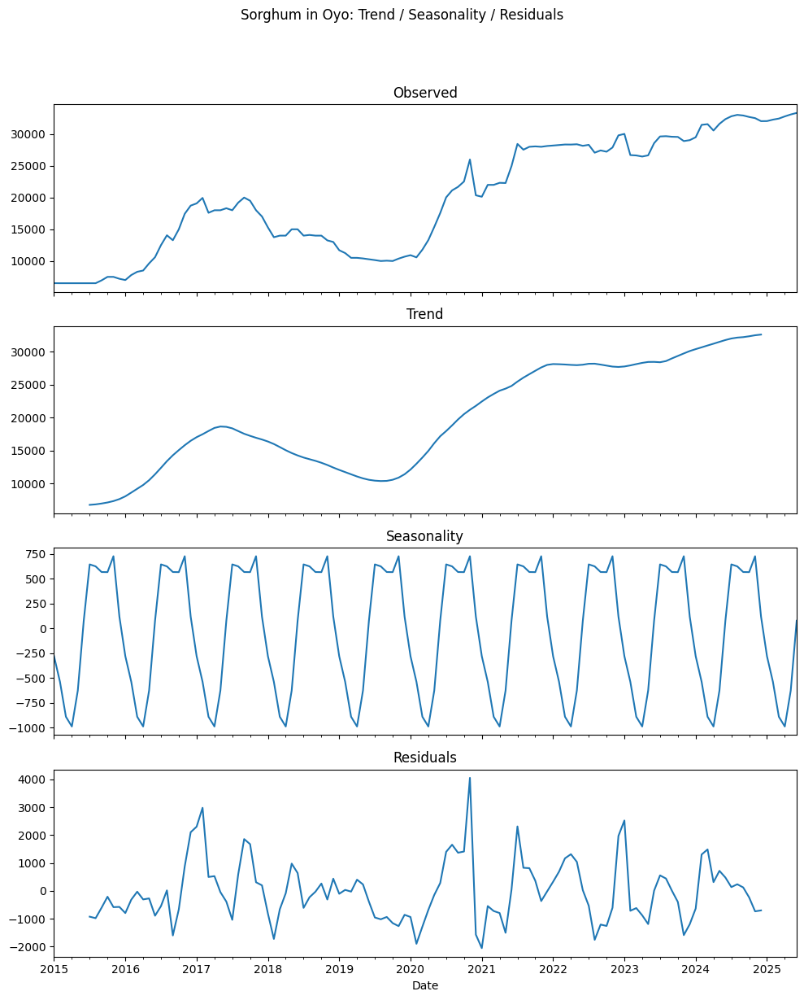

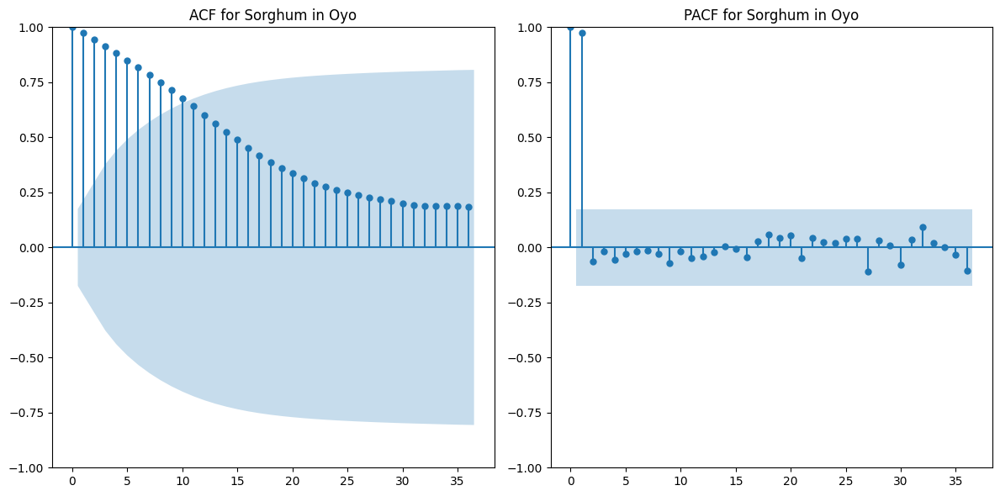


--- Analyzing: Sorghum in Yobe ---
Observations for Sorghum in Yobe: 126


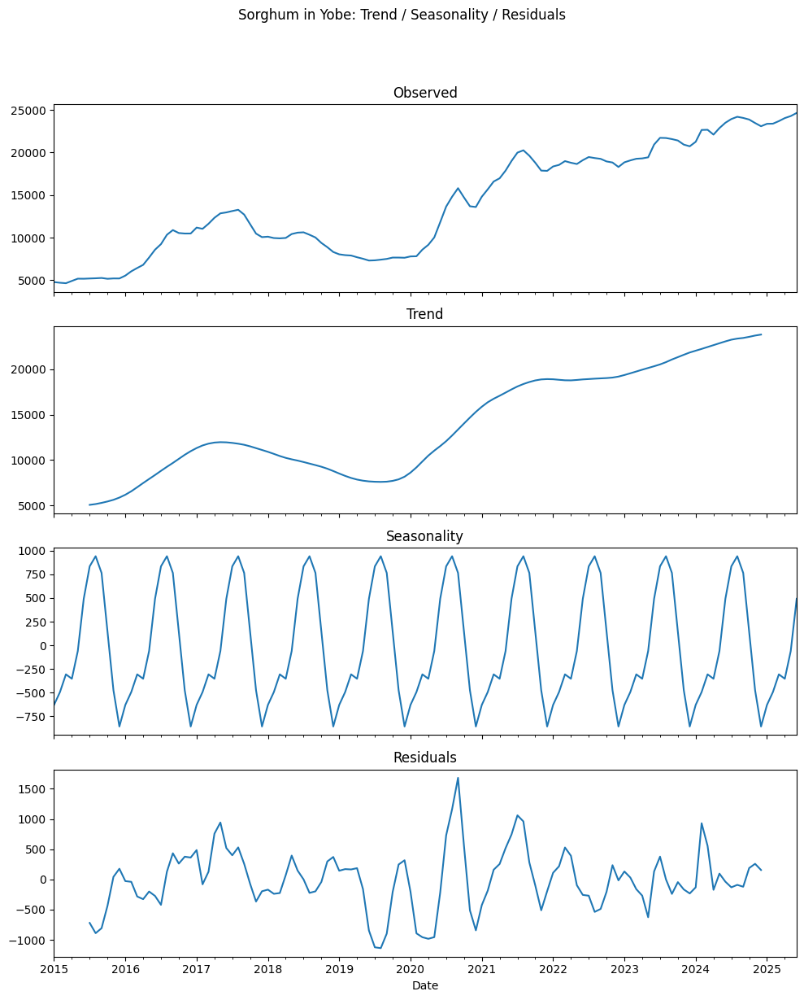

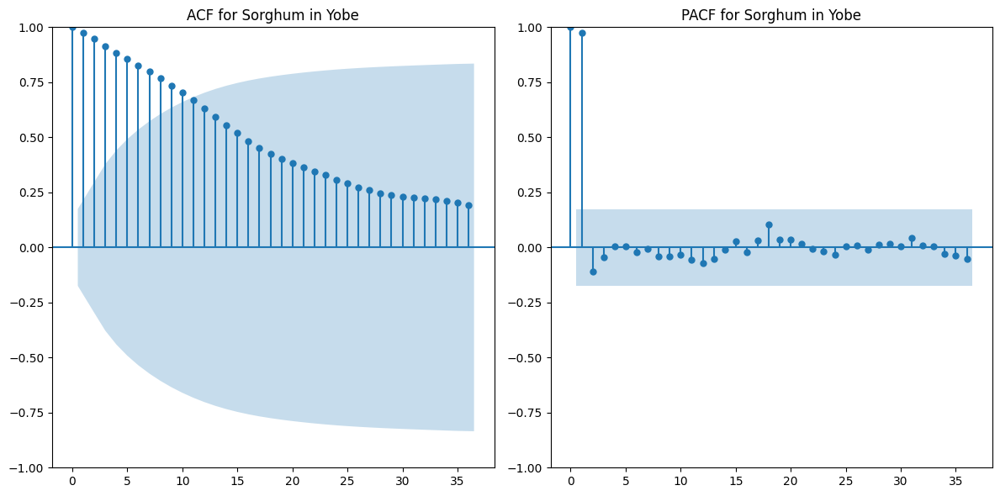


--- Analyzing: Sorghum in Zamfara ---
Observations for Sorghum in Zamfara: 126


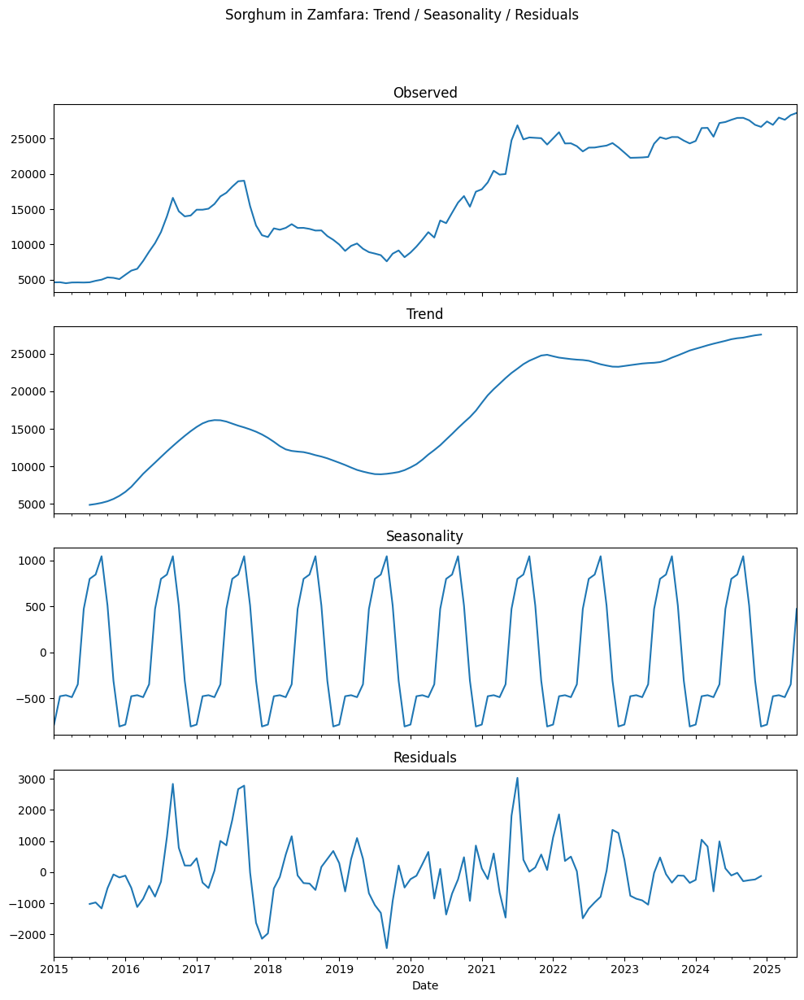

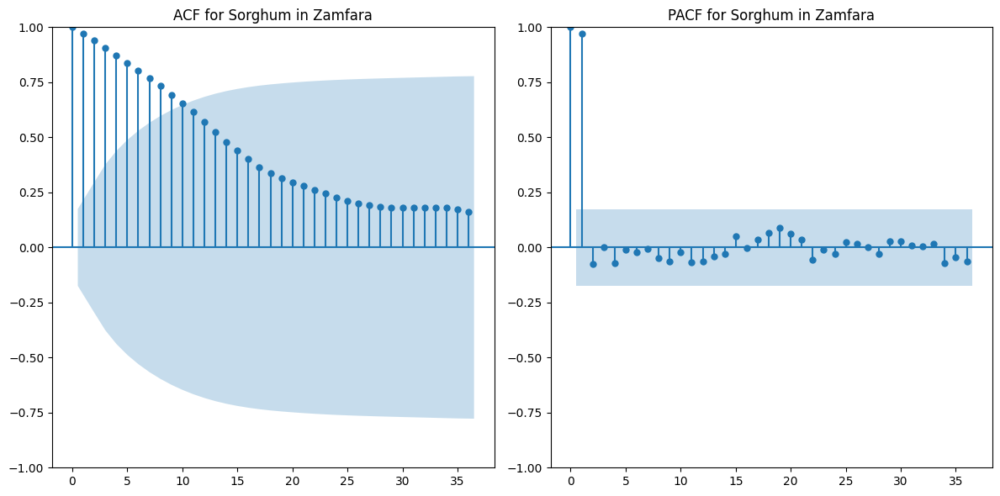


--- Analyzing: Cassava_meal in Abia ---
Observations for Cassava_meal in Abia: 126


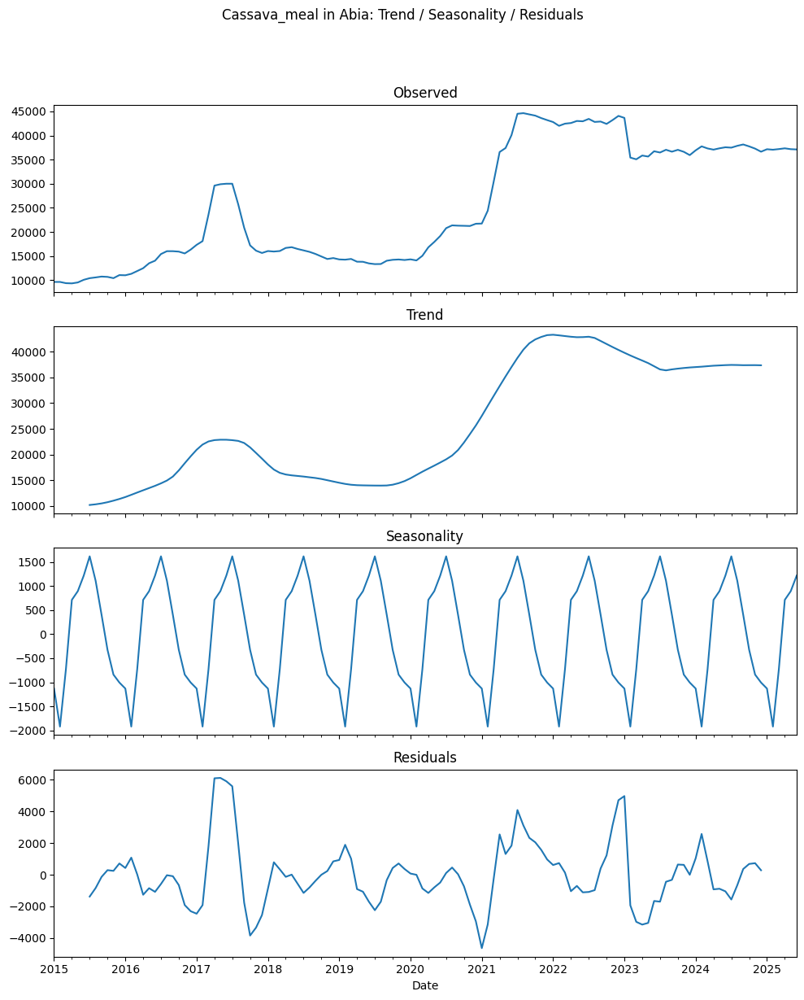

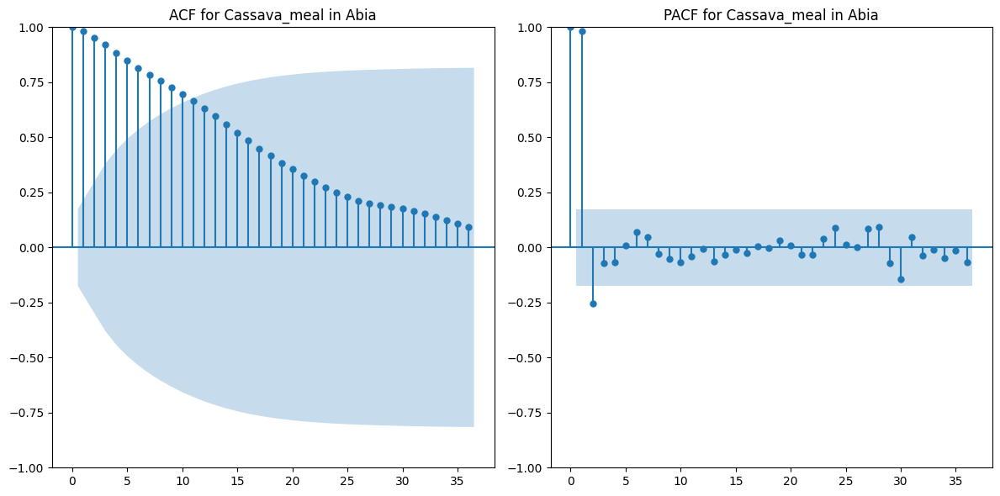


--- Analyzing: Cassava_meal in Adamawa ---
Observations for Cassava_meal in Adamawa: 126


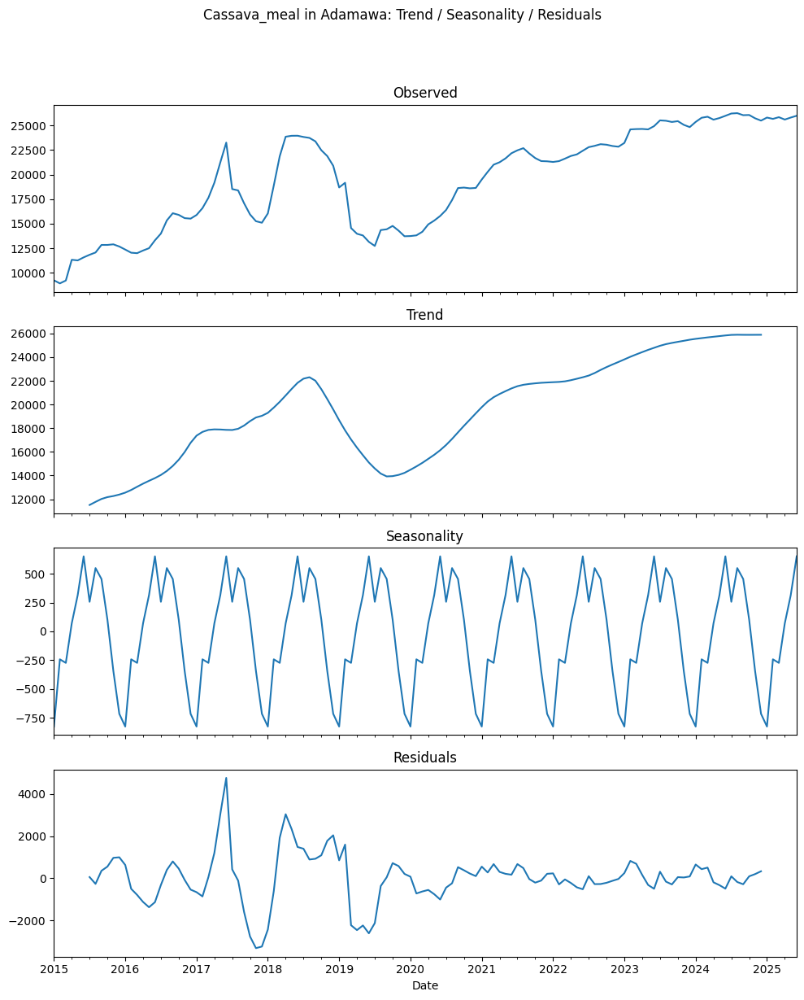

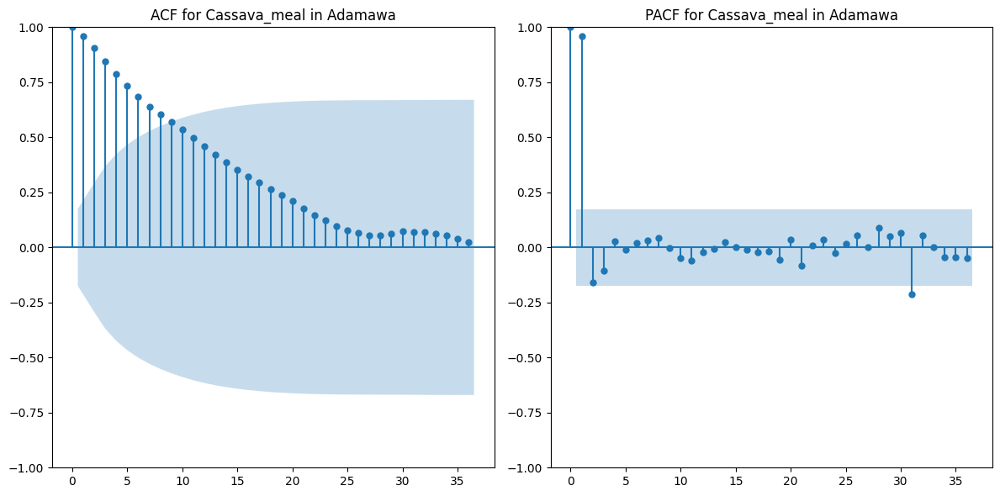


--- Analyzing: Cassava_meal in Borno ---
Observations for Cassava_meal in Borno: 126


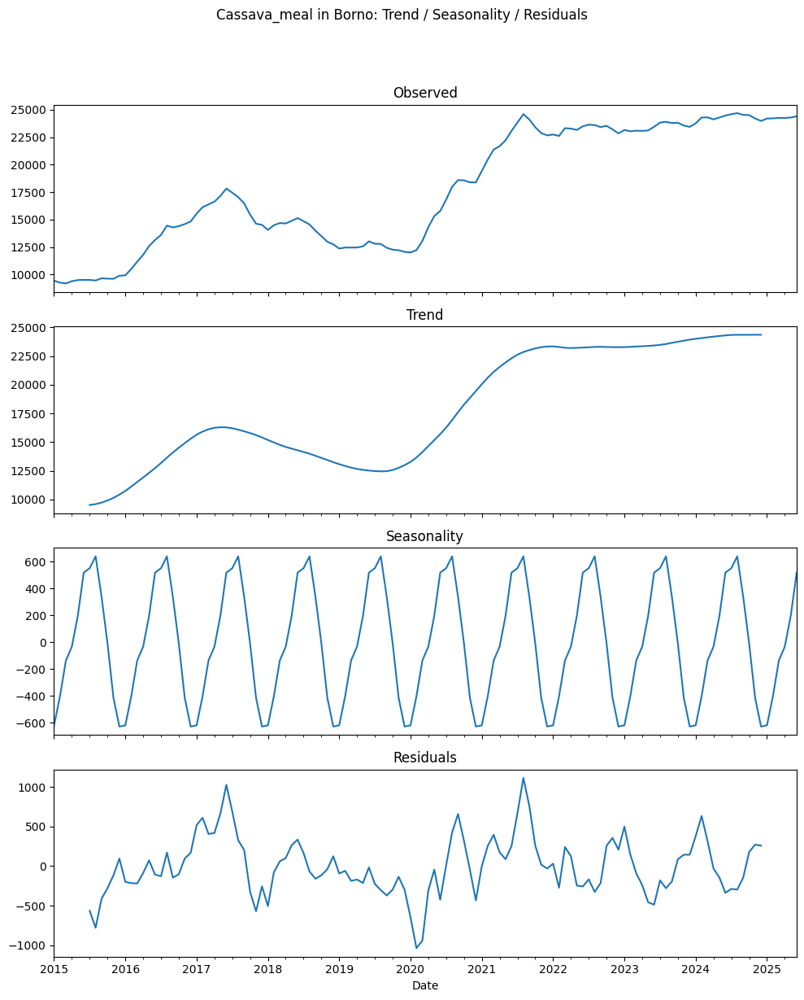

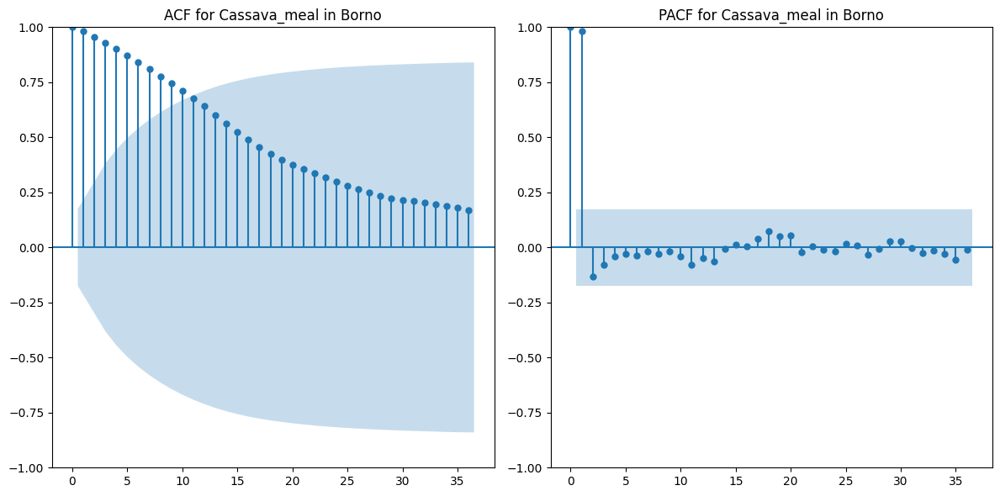


--- Analyzing: Cassava_meal in Gombe ---
Observations for Cassava_meal in Gombe: 126


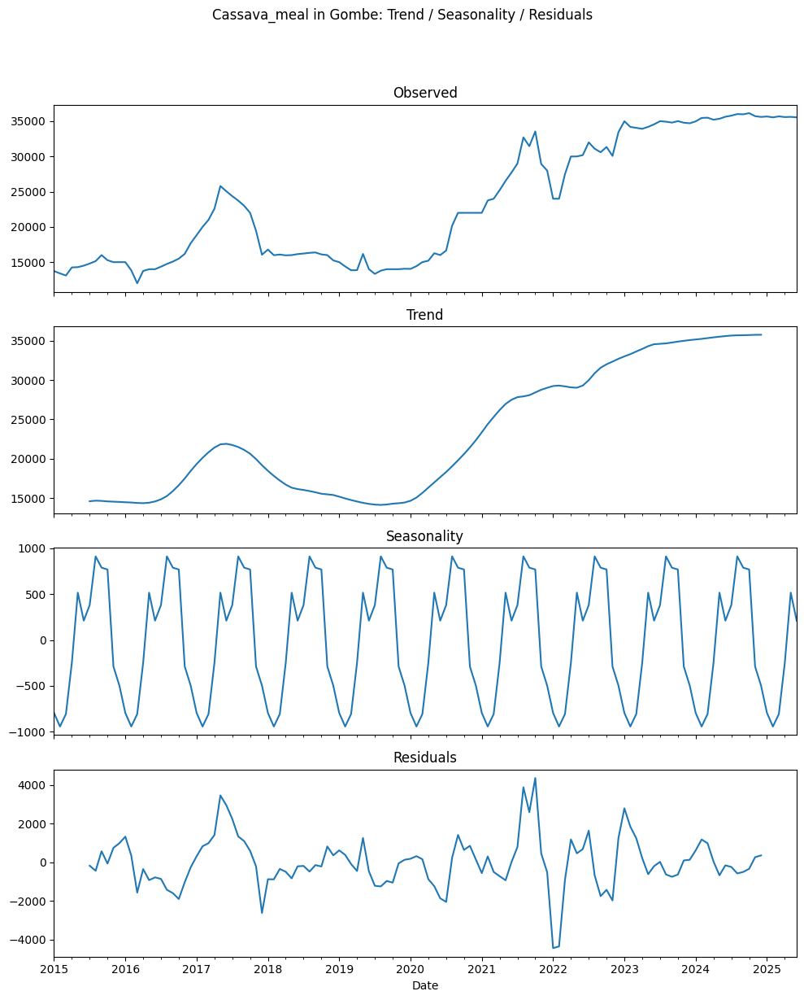

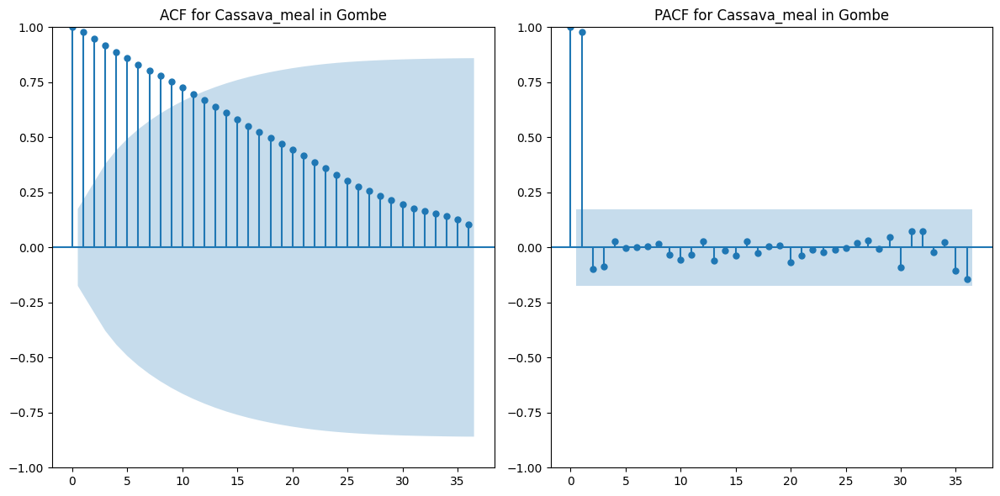


--- Analyzing: Cassava_meal in Jigawa ---
Observations for Cassava_meal in Jigawa: 126


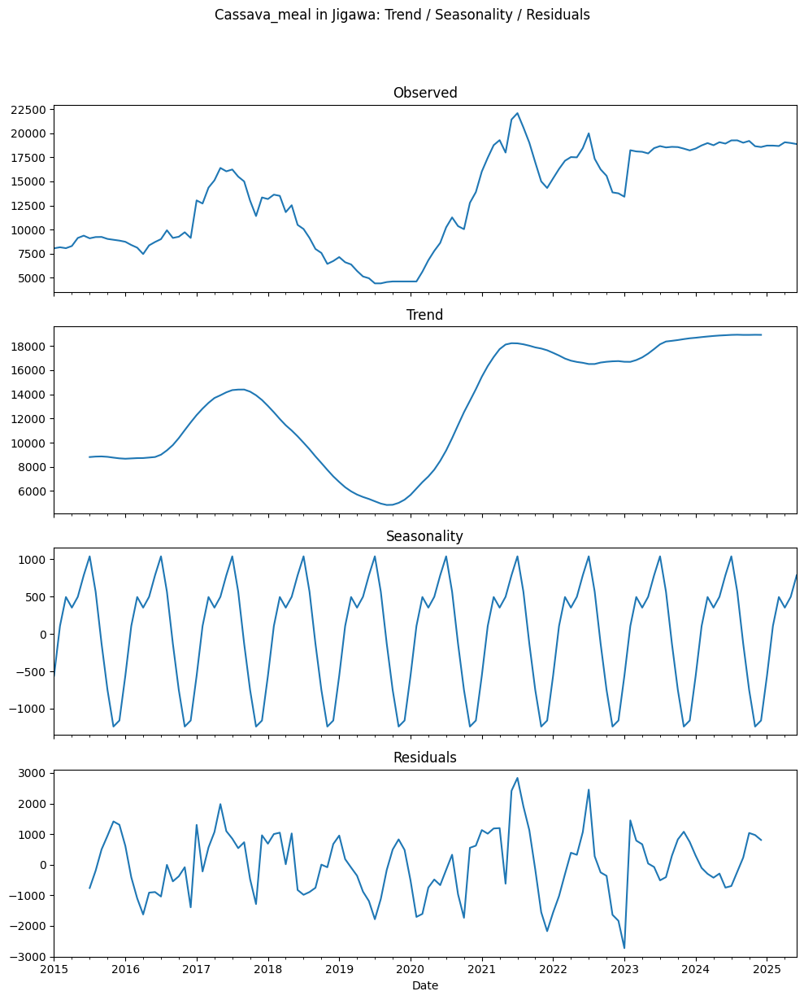

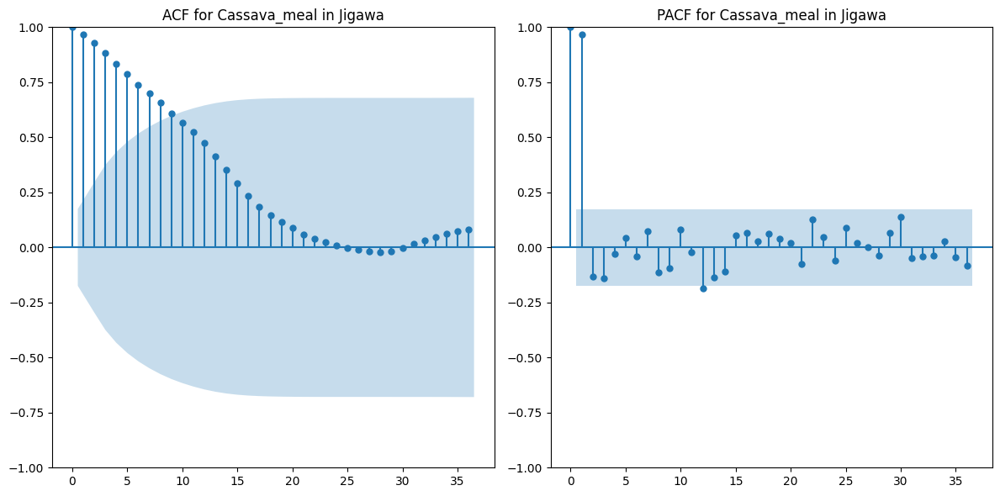


--- Analyzing: Cassava_meal in Kaduna ---
Observations for Cassava_meal in Kaduna: 126


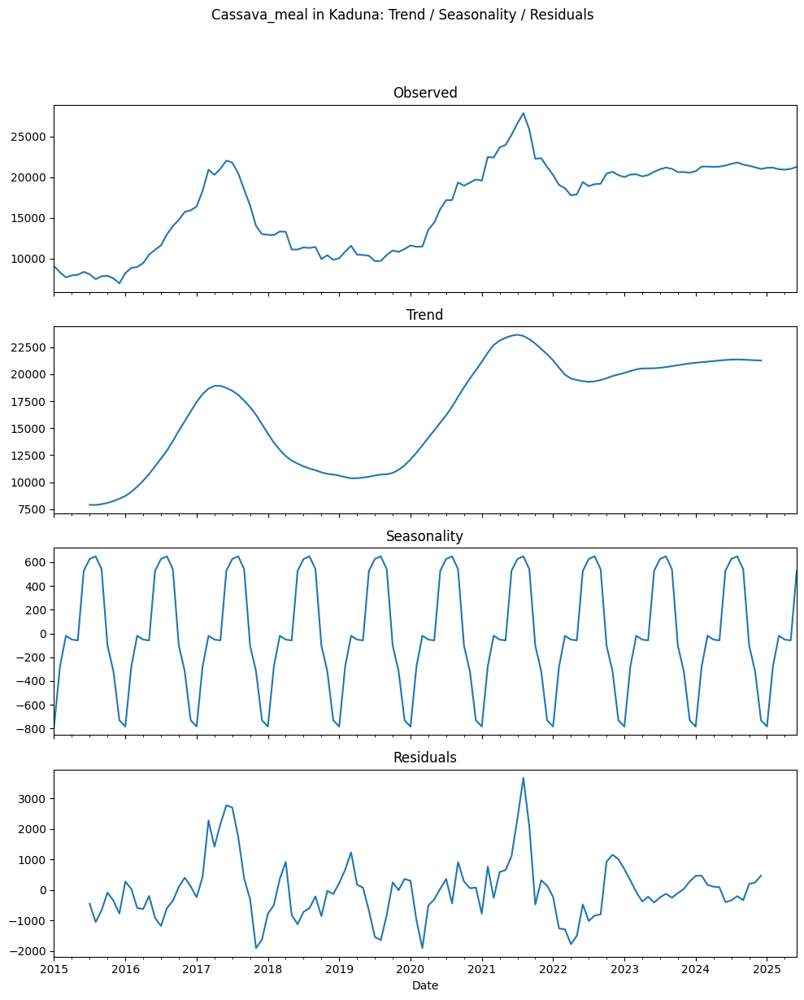

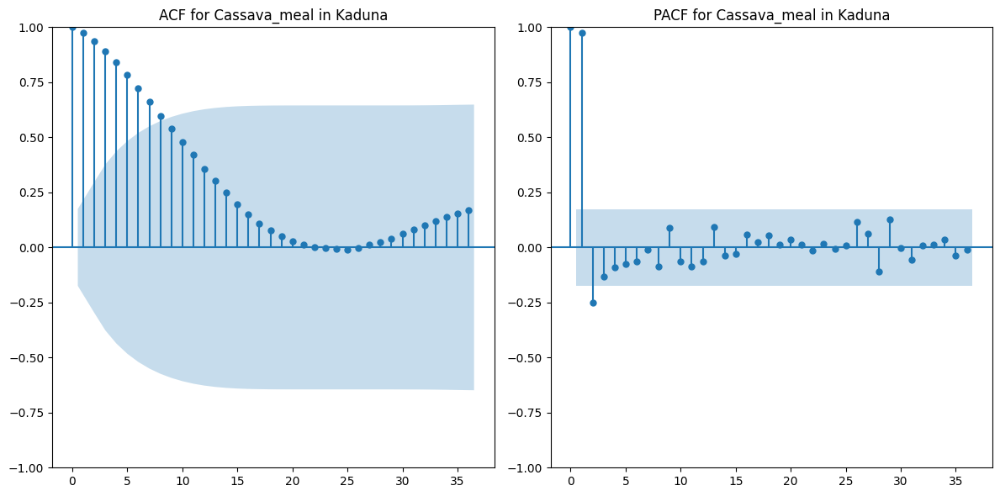


--- Analyzing: Cassava_meal in Kano ---
Observations for Cassava_meal in Kano: 126


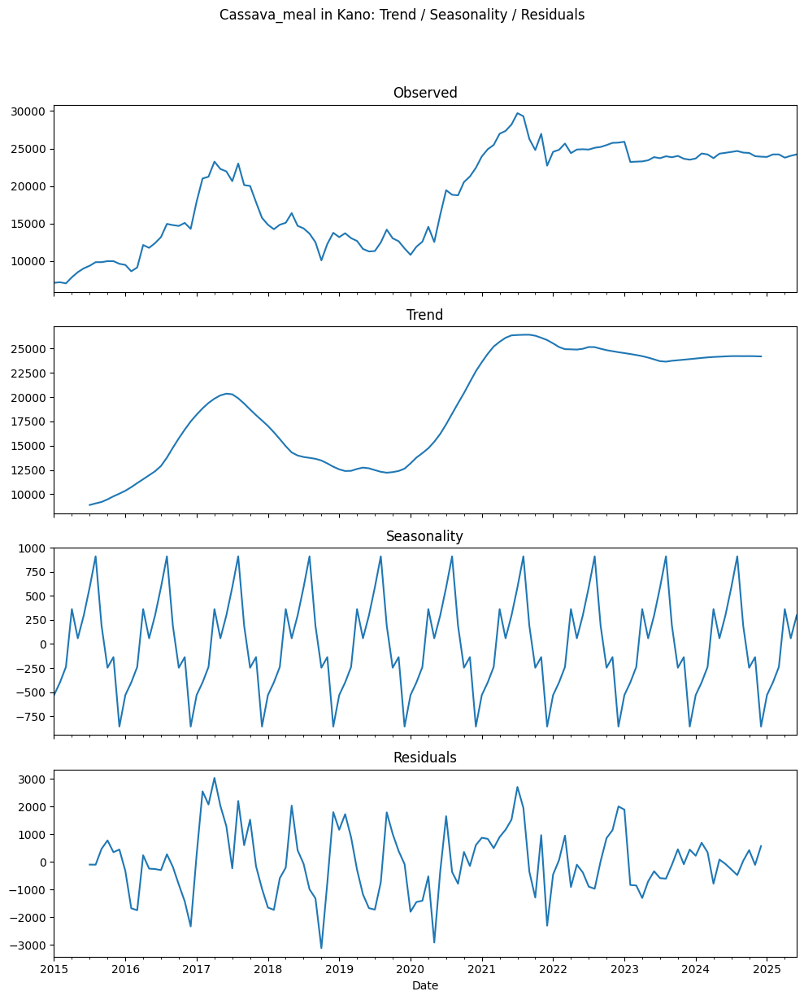

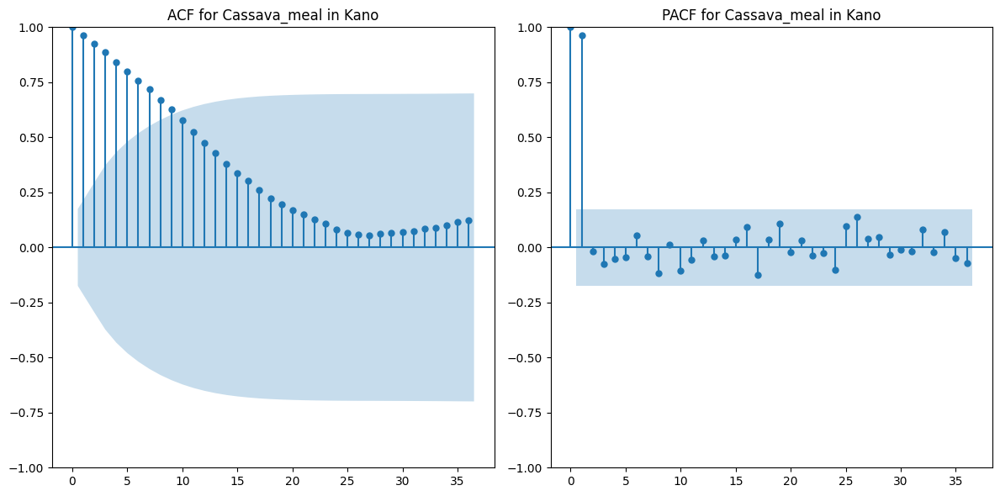


--- Analyzing: Cassava_meal in Katsina ---
Observations for Cassava_meal in Katsina: 126


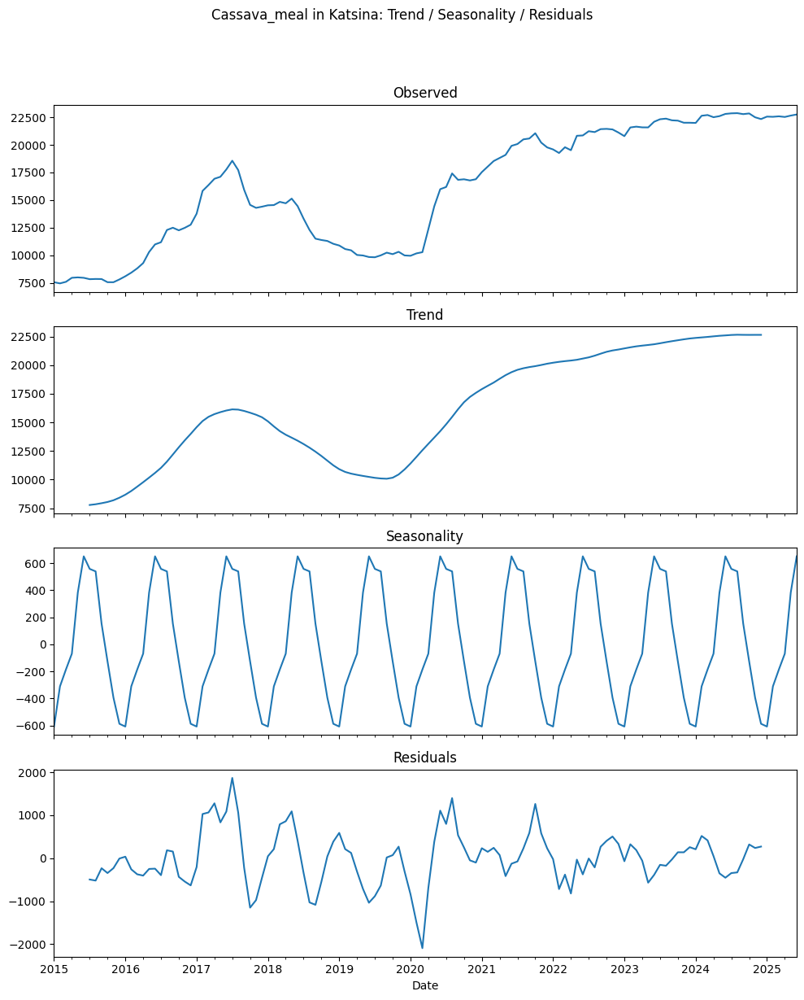

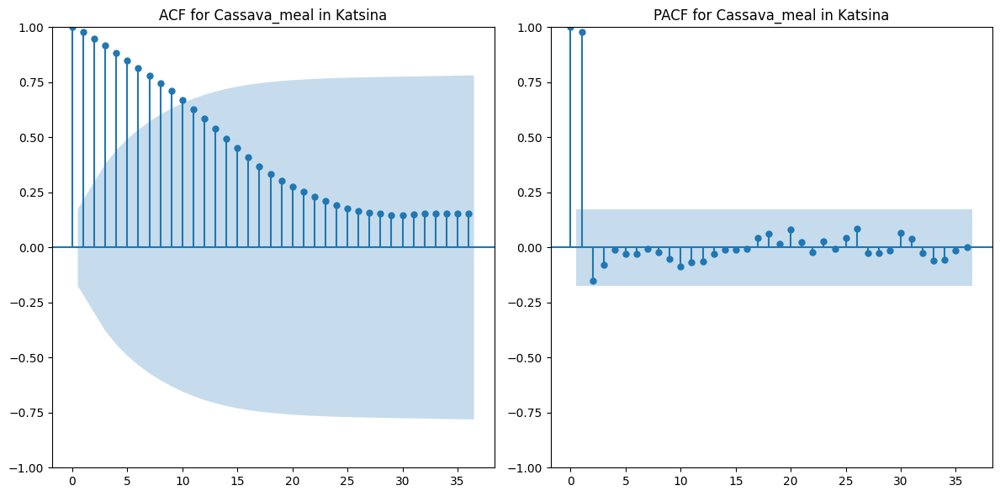


--- Analyzing: Cassava_meal in Kebbi ---
Observations for Cassava_meal in Kebbi: 126


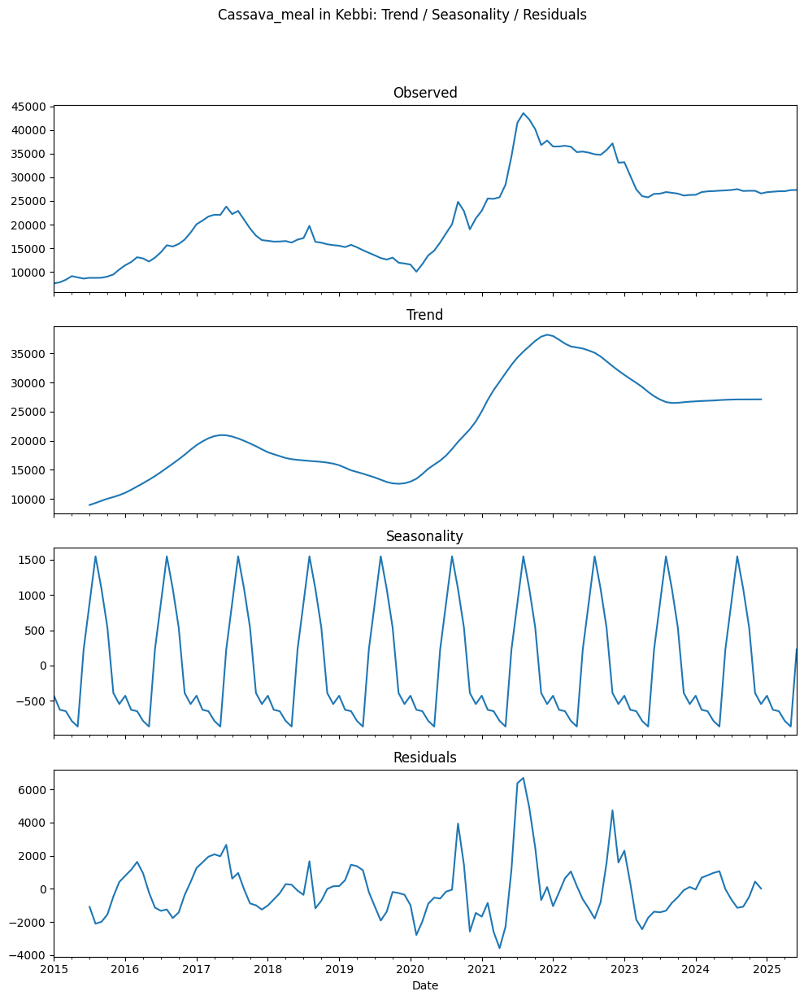

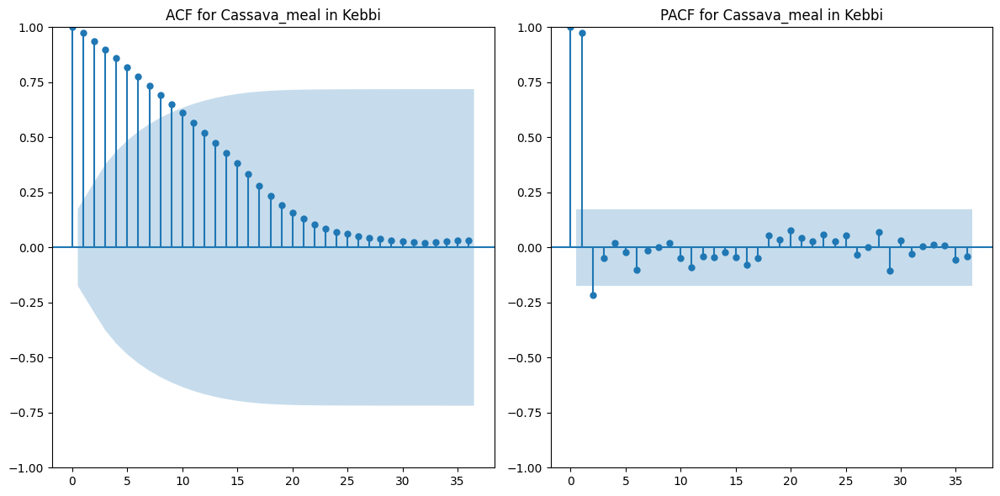


--- Analyzing: Cassava_meal in Lagos ---
Observations for Cassava_meal in Lagos: 126


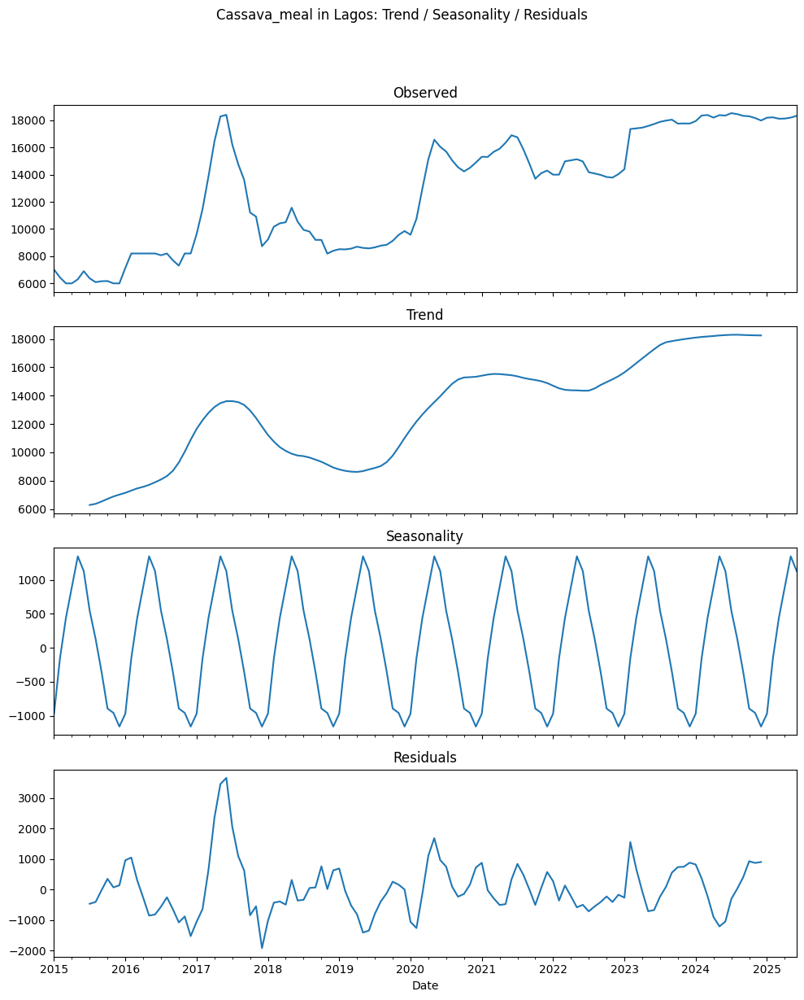

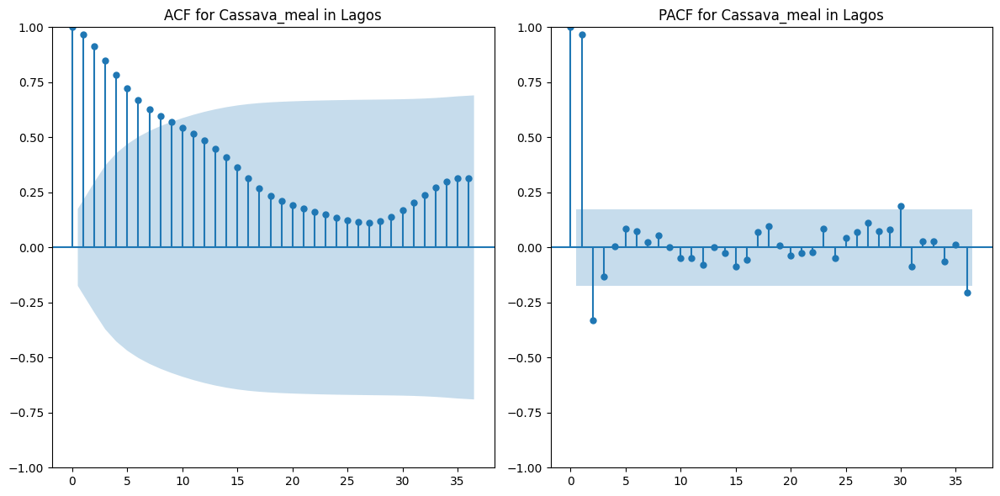


--- Analyzing: Cassava_meal in Oyo ---
Observations for Cassava_meal in Oyo: 126


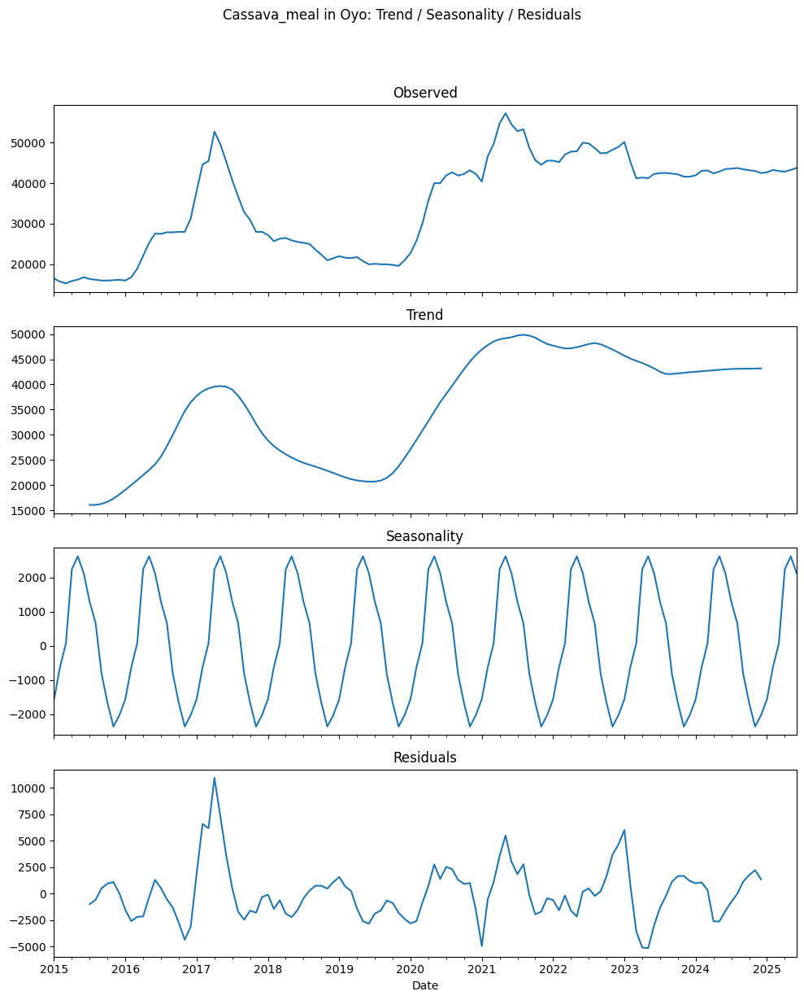

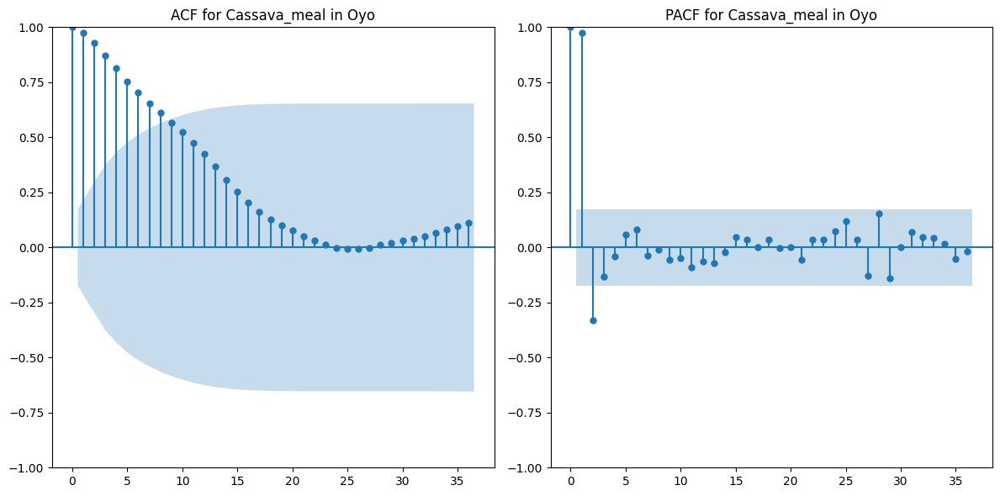


--- Analyzing: Cassava_meal in Yobe ---
Observations for Cassava_meal in Yobe: 126


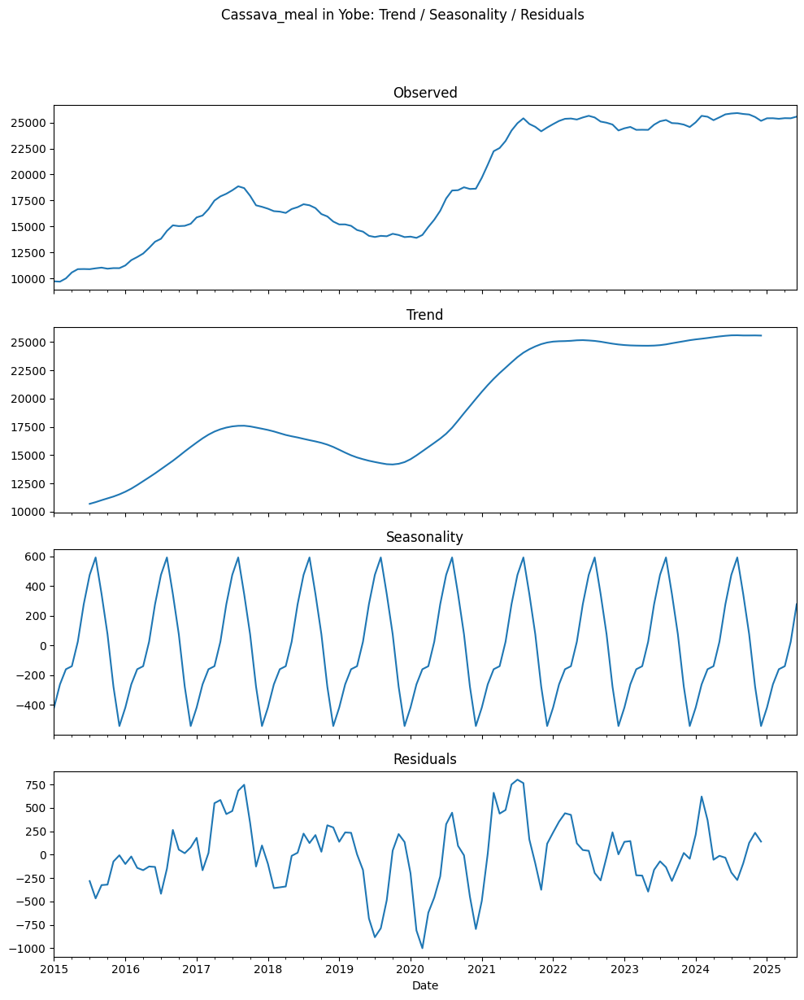

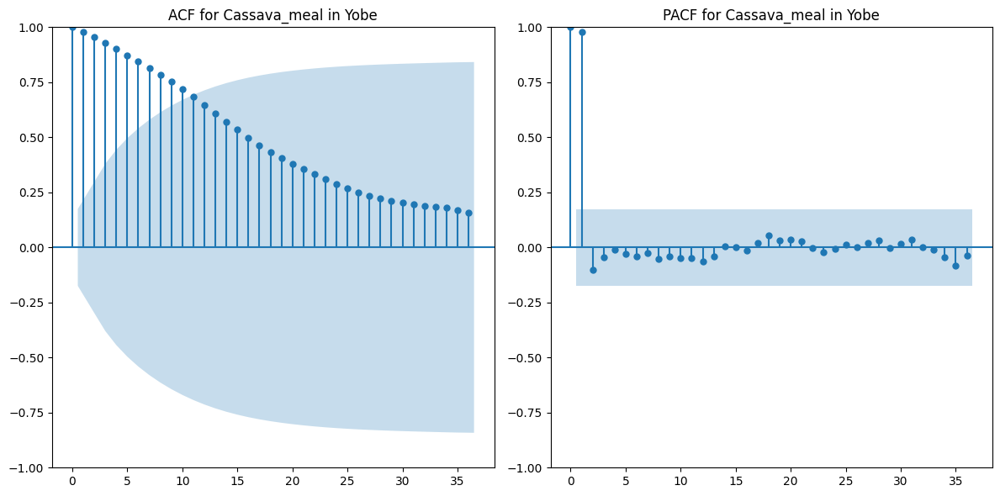


--- Analyzing: Cassava_meal in Zamfara ---
Observations for Cassava_meal in Zamfara: 126


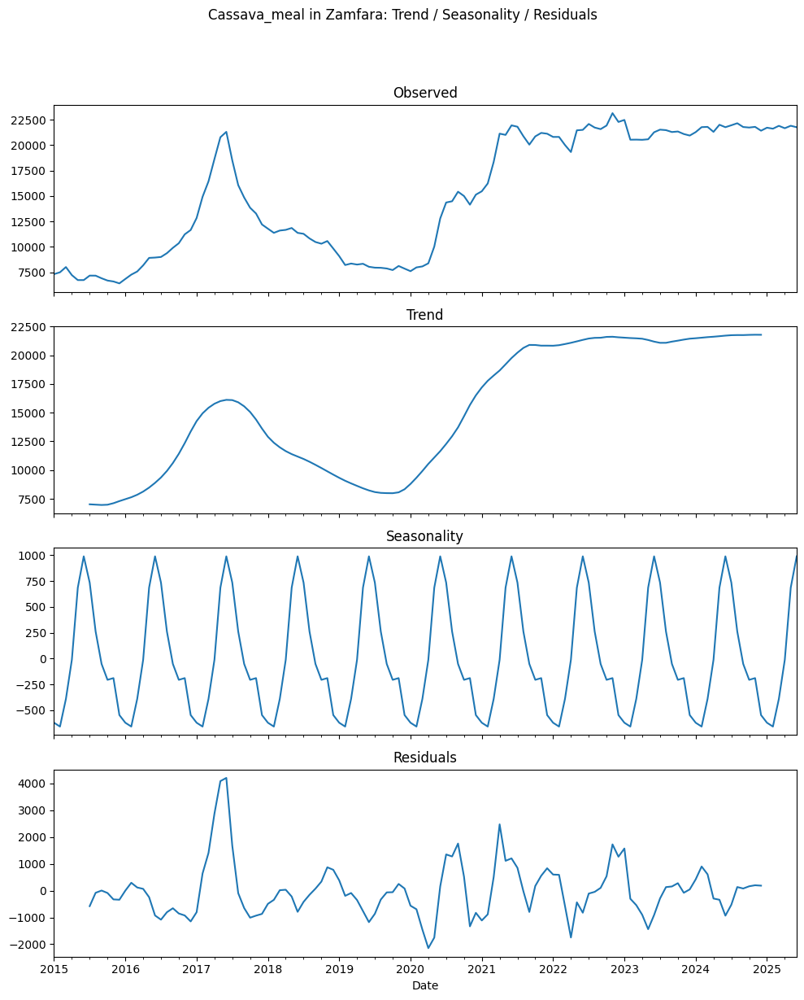

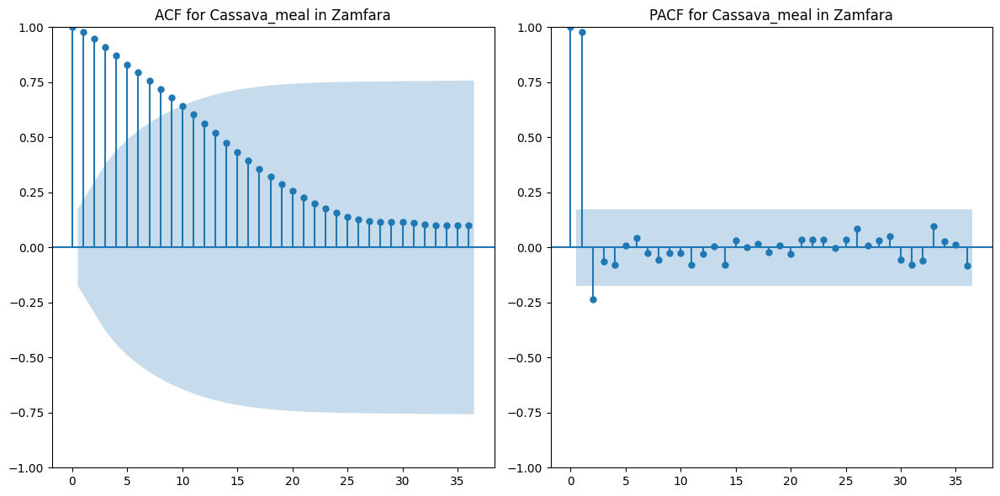


--- All specified food item and state analyses complete ---


In [50]:
##Time Series Decomposition and Autocorrelation Analysis,
##From this we see that the series need differencing i.e it is not stationary, may also need seasonal differencing as well

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

food_items = ['Gari', 'Groundnuts', 'Maize', 'Millet', 'Sorghum', 'Cassava_meal']

# Get all unique states from your DataFrame
unique_states = df_food_prices['State'].unique()

# --- Iterate through each food item and then each state ---
for item in food_items:
    for state in unique_states:
        # Filter the DataFrame for the current food item and state
        item_state_df = df_food_prices[(df_food_prices['Food_Item'] == item) &
                                       (df_food_prices['State'] == state)].copy()

        # Create a 'Date' column from Year and Month
        # Ensure we assign a day to create a valid datetime object
        item_state_df['Date'] = pd.to_datetime(item_state_df[['Year', 'Month']].assign(DAY=1))

        # Set 'Date' as index and get the 'Price' series, then sort by index
        series = item_state_df.set_index('Date')['Price'].sort_index()

        print(f"\n--- Analyzing: {item} in {state} ---")
        print(f"Observations for {item} in {state}: {len(series)}")

        # Skip if insufficient data for decomposition (need at least 2 full periods for seasonal=12, so 24)
        if len(series) < 24:
            print(f"⚠️ Skipping {item} in {state}: not enough data (need at least 24 months for decomposition). Found {len(series)}.")
            continue

        # --- Time Series Decomposition ---
        try:
            # period=12 for monthly data (12 months in a year)
            res = seasonal_decompose(series, model='additive', period=12)
            fig, axes = plt.subplots(4, 1, figsize=(10, 12), sharex=True)
            res.observed.plot(ax=axes[0], title='Observed')
            res.trend.plot(ax=axes[1], title='Trend')
            res.seasonal.plot(ax=axes[2], title='Seasonality')
            res.resid.plot(ax=axes[3], title='Residuals')
            plt.suptitle(f"{item} in {state}: Trend / Seasonality / Residuals", y=1.02) # Adjust suptitle position
            plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to prevent suptitle overlap
            plt.show()
        except Exception as e:
            print(f"❌ Error during decomposition for {item} in {state}: {e}")
            print("This usually happens if the series is too short or has constant values after filtering.")
            continue

        # --- Autocorrelation and Partial Autocorrelation Functions (ACF and PACF) ---
        plt.figure(figsize=(12, 6))
        
        plt.subplot(121) # 1 row, 2 columns, 1st plot
        plot_acf(series, lags=36, ax=plt.gca(), title=f"ACF for {item} in {state}")
        
        plt.subplot(122) # 1 row, 2 columns, 2nd plot
        plot_pacf(series, lags=36, ax=plt.gca(), title=f"PACF for {item} in {state}")
        
        plt.tight_layout()
        plt.show()

print("\n--- All specified food item and state analyses complete ---")


In [52]:

#Performs an Augmented Dickey-Fuller (ADF) test on time series data for food items to check for stationarity.
##Confirms only first order differencing required in most cases, except for groundnuts


import pandas as pd
from statsmodels.tsa.stattools import adfuller
import warnings

# Suppress specific warnings from statsmodels, especially concerning insufficient observations for ADF
warnings.filterwarnings("ignore", category=UserWarning, module='statsmodels')


# List of food items to analyze (or get all unique if needed)
food_items_to_analyze = ['Cassava_meal', 'Gari', 'Sorghum', 'Maize', 'Groundnuts']

# Get all unique states from your DataFrame
unique_states = df_food_prices['State'].unique()

results = []

# Iterate through each food item
for item in food_items_to_analyze:
    # Iterate through each state
    for state in unique_states:
        print(f"\n--- Running ADF Test for {item} in {state} ---")

        # Filter the DataFrame for the current food item and state
        # Create a 'Date' column and set it as index for time series
        series_df = df_food_prices[(df_food_prices['Food_Item'] == item) &
                                   (df_food_prices['State'] == state)].copy()
        series_df['Date'] = pd.to_datetime(series_df[['Year', 'Month']].assign(DAY=1))
        series = series_df.set_index('Date')['Price'].sort_index().dropna()

        # Check if there's enough data for ADF test (minimum 3 observations)
        # However, for meaningful results, especially with differencing, more data is needed (e.g., > 12)
        if len(series) < 12: # Changed minimum observations for more reliable results
            print(f"⚠️ Skipping {item} in {state}: Not enough observations (need at least 12 for robust ADF, found {len(series)}).")
            results.append({
                'Food_Item': item,
                'State': state,
                'Observations': len(series),
                'ADF p-value (original)': 'N/A',
                'ADF p-value (1st diff)': 'N/A',
                'ADF p-value (2nd diff)': 'N/A',
                'ADF p-value (seasonal diff, lag=12)': 'N/A',
                'Conclusion': 'Insufficient Data'
            })
            continue

        # Initialize p-values to None for clarity if not computed
        p_orig = None
        p_diff1 = None
        p_diff2 = None
        p_seasonal = None
        conclusion = "Non-Stationary (requires further differencing)"

        try:
            # Step 1: ADF on original series
            p_orig = adfuller(series)[1]
            if p_orig <= 0.05:
                conclusion = "Stationary (original)"
            print(f"  - Original Series p-value: {p_orig:.4f}")

            # Step 2: First differencing
            if conclusion == "Non-Stationary (requires further differencing)":
                series_diff1 = series.diff().dropna()
                if len(series_diff1) >= 12: # Ensure enough data after differencing
                    p_diff1 = adfuller(series_diff1)[1]
                    if p_diff1 <= 0.05:
                        conclusion = "Stationary (1st diff)"
                    print(f"  - 1st Differencing p-value: {p_diff1:.4f}")
                else:
                    print(f"  - 1st Differencing: Not enough data after differencing ({len(series_diff1)} obs).")


            # Step 3: Second differencing (if still non-stationary after 1st diff)
            if conclusion == "Non-Stationary (requires further differencing)" and p_diff1 is not None and p_diff1 > 0.05:
                series_diff2 = series_diff1.diff().dropna() # Use series_diff1 here
                if len(series_diff2) >= 12: # Ensure enough data
                    p_diff2 = adfuller(series_diff2)[1]
                    if p_diff2 <= 0.05:
                        conclusion = "Stationary (2nd diff)"
                    print(f"  - 2nd Differencing p-value: {p_diff2:.4f}")
                else:
                     print(f"  - 2nd Differencing: Not enough data after differencing ({len(series_diff2)} obs).")


            # Step 4: Seasonal differencing (lag=12) (consider if still non-stationary or for seasonality)
            # Apply seasonal diff to the ORIGINAL series, or a suitable differenced series
            if conclusion == "Non-Stationary (requires further differencing)" or (p_orig is None and p_diff1 is None and p_diff2 is None):
                series_seasonal = series.diff(12).dropna()
                if len(series_seasonal) >= 12: # Ensure enough data after seasonal differencing
                    p_seasonal = adfuller(series_seasonal)[1]
                    if p_seasonal <= 0.05:
                        conclusion = "Stationary (seasonal diff, lag=12)"
                    print(f"  - Seasonal Differencing (lag=12) p-value: {p_seasonal:.4f}")
                else:
                    print(f"  - Seasonal Differencing: Not enough data after differencing ({len(series_seasonal)} obs).")


        except Exception as e:
            print(f"❌ Error performing ADF test for {item} in {state}: {e}")
            conclusion = f"Error: {e}"

        # Store results for this food item and state
        results.append({
            'Food_Item': item,
            'State': state,
            'Observations': len(series),
            'ADF p-value (original)': f"{p_orig:.4f}" if p_orig is not None else 'N/A',
            'ADF p-value (1st diff)': f"{p_diff1:.4f}" if p_diff1 is not None else 'N/A',
            'ADF p-value (2nd diff)': f"{p_diff2:.4f}" if p_diff2 is not None else 'N/A',
            'ADF p-value (seasonal diff, lag=12)': f"{p_seasonal:.4f}" if p_seasonal is not None else 'N/A',
            'Conclusion': conclusion
        })

# Convert all results to a DataFrame for easy viewing
adf_df_per_item_state = pd.DataFrame(results)
pd.set_option('display.max_rows', None) # Display all rows
pd.set_option('display.max_columns', None) # Display all columns
pd.set_option('display.width', 1000) # Adjust display width
print("\n--- ADF Test Results per Food Item and State ---")
print(adf_df_per_item_state)



--- Running ADF Test for Cassava_meal in Abia ---
  - Original Series p-value: 0.5348
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Adamawa ---
  - Original Series p-value: 0.2240
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Borno ---
  - Original Series p-value: 0.6157
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Gombe ---
  - Original Series p-value: 0.7667
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Jigawa ---
  - Original Series p-value: 0.1971
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Kaduna ---
  - Original Series p-value: 0.2516
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Kano ---
  - Original Series p-value: 0.4174
  - 1st Differencing p-value: 0.0000

--- Running ADF Test for Cassava_meal in Katsina ---
  - Original Series p-value: 0.6768
  - 1st Differencing p-value: 0.0

# # THIS IS FOR DATA ACQUSITION, CLEANING AND EXPLORATORY DATA ANALYSIS OF DIESEL FUEL PRICE DATA

In [3]:
import requests
import pandas as pd
from datetime import datetime
import json
import warnings

def fetch_fuel_prices_last_10_years():
    """
    Fetches fuel price data from the World Bank API for the last 10 years.

    The function iterates through API pages to retrieve all available records
    for 'Nigeria' with specific fuel-related price columns. It then filters
    this data to include only records from the last 10 years based on the 'year' column.
    Finally, it averages the prices of 'Fuel_Diesel_Price' and 'Fuel_Petrol_Gasoline_Price'
    by state, year, and month, and includes 'DATES'.

    Returns:
        pd.DataFrame: A pandas DataFrame containing the fetched, filtered, and averaged fuel price data.
                      Returns an empty DataFrame if no data is found or an error occurs.
    """
    API_URL = "https://microdata.worldbank.org/index.php/api/tables/data/fcv/wld_2023_rtep_v01_m"
    
    # Define the specific fuel items and their API column names
    fuel_item_codes = ['fuel_diesel'] # Corrected to match API field
    api_price_columns = [f'c_{item}' for item in fuel_item_codes]
    
    # Define all expected columns for the API request
    expected_api_columns = [
        'country', 'mkt_name', 'adm1_name', 'year', 'month', 'DATES'
    ] + api_price_columns
    
    fields_param = ','.join(expected_api_columns)
    
    limit = 1000 # Fetch 1000 records per request
    offset = 0
    all_records = []
    
    current_year = datetime.now().year
    start_year = current_year - 10 # Data for the last 10 years

    print(f"Fetching fuel data from World Bank API for years {start_year} onwards...")

    while True:
        params = {
            'limit': limit,
            'offset': offset,
            'country': 'Nigeria', # Filter for Nigeria
            'fields': fields_param
        }
        
        try:
            # Send GET request to the API
            response = requests.get(API_URL, params=params, timeout=30)
            response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
            
            data = response.json()
            
            if 'data' in data:
                records = data['data']
                if not records:
                    # No more records, break the loop
                    print("No more records found. Breaking pagination loop.")
                    break
                
                all_records.extend(records)
                offset += limit
                print(f"Fetched {len(records)} records, total fetched: {len(all_records)}. Next offset: {offset}")
            else:
                print("No 'data' key in API response or unexpected response structure. Breaking loop.")
                break # Break if 'data' key is missing or structure is unexpected
                
        except requests.exceptions.RequestException as e:
            print(f"Error fetching data from World Bank API: {e}")
            break
        except json.JSONDecodeError as e:
            print(f"Error decoding JSON from API response: {e}")
            break
        except Exception as e:
            print(f"An unexpected error occurred: {e}")
            break

    df = pd.DataFrame(all_records)
    
    if df.empty:
        print("No data fetched or DataFrame is empty after API calls.")
        return pd.DataFrame()

    # Convert year and month to numeric, coercing errors to NaN
    df['year'] = pd.to_numeric(df['year'], errors='coerce')
    df['month'] = pd.to_numeric(df['month'], errors='coerce')

    # Convert price columns to numeric, coercing errors to NaN
    # Also create a list of price columns that are actually present in the DataFrame
    present_api_price_columns = []
    for col in api_price_columns:
        if col in df.columns:
            df[col] = pd.to_numeric(df[col], errors='coerce')
            present_api_price_columns.append(col)
        else:
            warnings.warn(f"Column '{col}' not found in the fetched data. It might be missing from the API response.")

    # Drop rows where 'year' or 'month' are NaN (couldn't be converted)
    df.dropna(subset=['year', 'month'], inplace=True)

    # Filter for the last 10 years
    df = df[df['year'] >= start_year].copy()

    # Create DATES column if not already present or ensure it's datetime
    if 'DATES' in df.columns:
        df['DATES'] = pd.to_datetime(df['DATES'], errors='coerce')
        df.dropna(subset=['DATES'], inplace=True)
    else:
        # If DATES column is not available, create a date column from year and month
        df['DATES'] = pd.to_datetime(df['year'].astype(int).astype(str) + '-' + 
                                    df['month'].astype(int).astype(str) + '-01', errors='coerce')
        df.dropna(subset=['DATES'], inplace=True) # Drop rows where Date creation failed

    # Define the grouping columns for averaging - now includes DATES
    groupby_cols = ['adm1_name', 'year', 'month', 'DATES']

    # Group by state, year, month, DATES and average all *present* fuel price columns
    if present_api_price_columns:
        df_averaged = df.groupby(groupby_cols)[present_api_price_columns].mean().reset_index()
    else:
        print("No fuel price columns found for averaging. Returning grouping keys only.")
        # If no price columns, return just the grouping keys
        return df.groupby(groupby_cols).size().reset_index().drop(columns=0)

    # Rename the averaged columns to the desired output names
    column_rename_map = {
        'c_fuel_diesel': 'Fuel_Diesel_Price',
    }
    df_averaged.rename(columns=column_rename_map, inplace=True)


    # Rename grouping columns for better readability and to match desired output
    df_averaged.rename(columns={
        'adm1_name': 'State',
        'year': 'Year',
        'month': 'Month'
    }, inplace=True)

    # Select and reorder relevant columns to ensure only the requested ones are present
    final_columns = [
        'State', 'Year', 'Month', 'DATES', 
        'Fuel_Diesel_Price', 
    ]
    
    # Filter final_columns to only include those that actually exist in df_averaged
    df_averaged = df_averaged[[col for col in final_columns if col in df_averaged.columns]]
    
    df_averaged.sort_values(by=['State', 'DATES'], inplace=True)
    df_averaged.reset_index(drop=True, inplace=True)

    print(f"Successfully fetched, filtered, and averaged {len(df_averaged)} records for the last 10 years with all requested fuel prices.")
    return df_averaged



In [4]:

if __name__ == "__main__":
    fuel_data = fetch_fuel_prices_last_10_years()
    if not fuel_data.empty:
        print("\nFirst 5 rows of fetched fuel data:")
        print(fuel_data.head())
        print(f"\nTotal records: {len(fuel_data)}")
        print(f"Time range: {fuel_data['DATES'].min()} to {fuel_data['DATES'].max()}")
        print("\nColumns and their data types:")
        print(fuel_data.info())
    else:
        print("No fuel data was retrieved.")

Fetching fuel data from World Bank API for years 2015 onwards...
Fetched 1000 records, total fetched: 1000. Next offset: 1000
Fetched 1000 records, total fetched: 2000. Next offset: 2000
Fetched 1000 records, total fetched: 3000. Next offset: 3000
Fetched 1000 records, total fetched: 4000. Next offset: 4000
Fetched 1000 records, total fetched: 5000. Next offset: 5000
Fetched 1000 records, total fetched: 6000. Next offset: 6000
Fetched 1000 records, total fetched: 7000. Next offset: 7000
Fetched 1000 records, total fetched: 8000. Next offset: 8000
Fetched 1000 records, total fetched: 9000. Next offset: 9000
Fetched 1000 records, total fetched: 10000. Next offset: 10000
Fetched 1000 records, total fetched: 11000. Next offset: 11000
Fetched 1000 records, total fetched: 12000. Next offset: 12000
Fetched 876 records, total fetched: 12876. Next offset: 13000
No more records found. Breaking pagination loop.
Successfully fetched, filtered, and averaged 1764 records for the last 10 years with a

In [162]:
fuel_data.head(50)

,State,Year,Month,DATES,Fuel_Diesel_Price
0,Abia,2015,1,2015-01-01,160.00
1,Abia,2015,2,2015-02-01,160.00
2,Abia,2015,3,2015-03-01,160.00
3,Abia,2015,4,2015-04-01,160.00
4,Abia,2015,5,2015-05-01,160.00
5,Abia,2015,6,2015-06-01,160.00
6,Abia,2015,7,2015-07-01,160.00
7,Abia,2015,8,2015-08-01,160.00
8,Abia,2015,9,2015-09-01,160.00
9,Abia,2015,10,2015-10-01,160.64


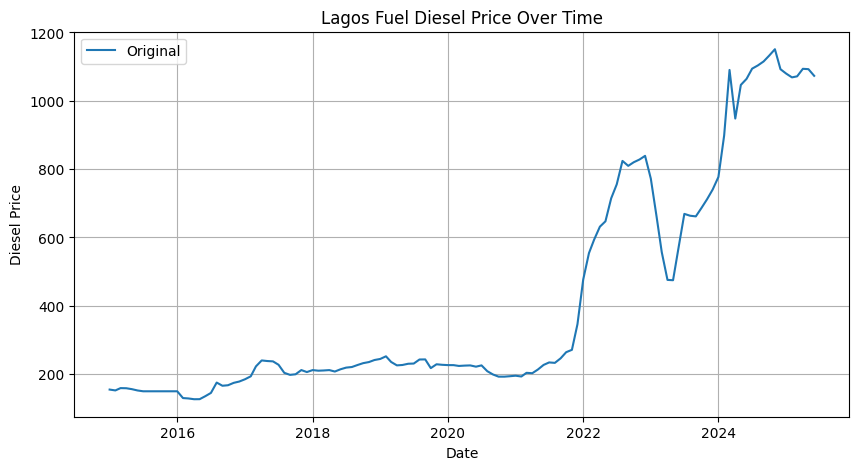

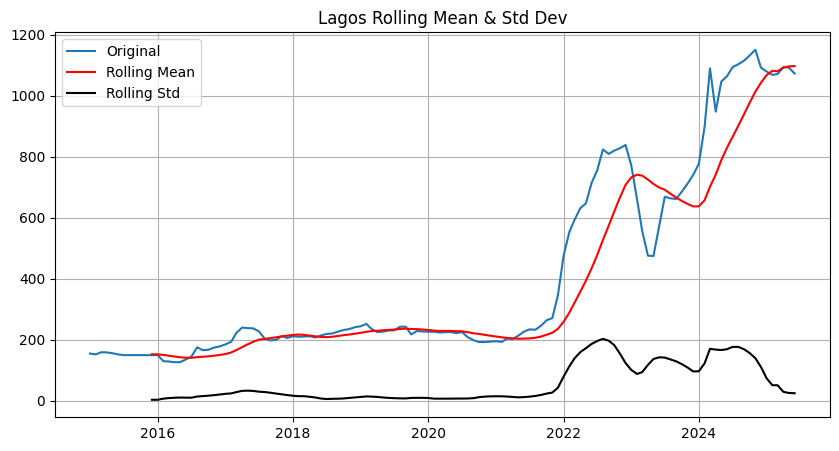

=== Augmented Dickey-Fuller Test ===
ADF Statistic: 0.027222437854969705
p-value: 0.9607262921257713
Critical Value (1%): -3.484219653271961
Critical Value (5%): -2.885145235641637
Critical Value (10%): -2.579359138917794

⚠️ The series is likely non-stationary (fail to reject null hypothesis).


In [164]:
#CHECK FOR STATIONARITY

import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

def check_stationarity(df, state_name='Lagos'):
    """
    Checks stationarity for a specific state's fuel price time series using ADF test and visual inspection.
    
    Args:
        df (pd.DataFrame): DataFrame with columns ['State', 'DATES', 'Fuel_Diesel_Price']
        state_name (str): State to filter the time series for
    """
    state_df = df[df['State'] == state_name].copy()
    state_df.set_index('DATES', inplace=True)
    ts = state_df['Fuel_Diesel_Price'].dropna()

    # Plot time series
    plt.figure(figsize=(10, 5))
    plt.plot(ts, label='Original')
    plt.title(f"{state_name} Fuel Diesel Price Over Time")
    plt.xlabel("Date")
    plt.ylabel("Diesel Price")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Rolling statistics
    rolmean = ts.rolling(window=12).mean()
    rolstd = ts.rolling(window=12).std()

    # Plot rolling mean and std
    plt.figure(figsize=(10, 5))
    plt.plot(ts, label='Original')
    plt.plot(rolmean, label='Rolling Mean', color='red')
    plt.plot(rolstd, label='Rolling Std', color='black')
    plt.title(f"{state_name} Rolling Mean & Std Dev")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Perform Augmented Dickey-Fuller test
    print("=== Augmented Dickey-Fuller Test ===")
    result = adfuller(ts.dropna(), autolag='AIC')
    print(f"ADF Statistic: {result[0]}")
    print(f"p-value: {result[1]}")
    for key, value in result[4].items():
        print(f"Critical Value ({key}): {value}")
    
    if result[1] < 0.05:
        print("\n✅ The series is likely stationary (reject null hypothesis).")
    else:
        print("\n⚠️ The series is likely non-stationary (fail to reject null hypothesis).")



check_stationarity(fuel_data, state_name='Lagos')  # You can replace with any state name


In [165]:
def difference_series(df, state_name='Lagos', seasonal_period=12):
    """
    Applies first and seasonal differencing to make the time series stationary.

    Args:
        df (pd.DataFrame): DataFrame with ['State', 'DATES', 'Fuel_Diesel_Price']
        state_name (str): State to filter the series
        seasonal_period (int): Number of periods for seasonal differencing

    Returns:
        pd.Series: Differenced series (after both first and seasonal differencing)
    """
    state_df = df[df['State'] == state_name].copy()
    state_df.set_index('DATES', inplace=True)
    ts = state_df['Fuel_Diesel_Price'].dropna()

    # First-order differencing
    first_diff = ts.diff().dropna()

    # Seasonal differencing
    seasonal_diff = ts.diff(seasonal_period).dropna()
    
    both_diffs = first_diff.diff(seasonal_period).dropna()

    # Plot original, first diff, seasonal diff
    plt.figure(figsize=(12, 8))
    plt.subplot(3, 1, 1)
    plt.plot(ts, label='Original')
    plt.title(f'{state_name} - Original Series')
    plt.grid(True)

    plt.subplot(3, 1, 2)
    plt.plot(first_diff, label='1st Difference', color='orange')
    plt.title('First Differencing (y(t) - y(t-1))')
    plt.grid(True)

    plt.subplot(3, 1, 3)
    plt.plot(seasonal_diff, label='Seasonal Difference', color='green')
    plt.title(f'Seasonal Differencing (Period = {seasonal_period})')
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()

    return both_diffs


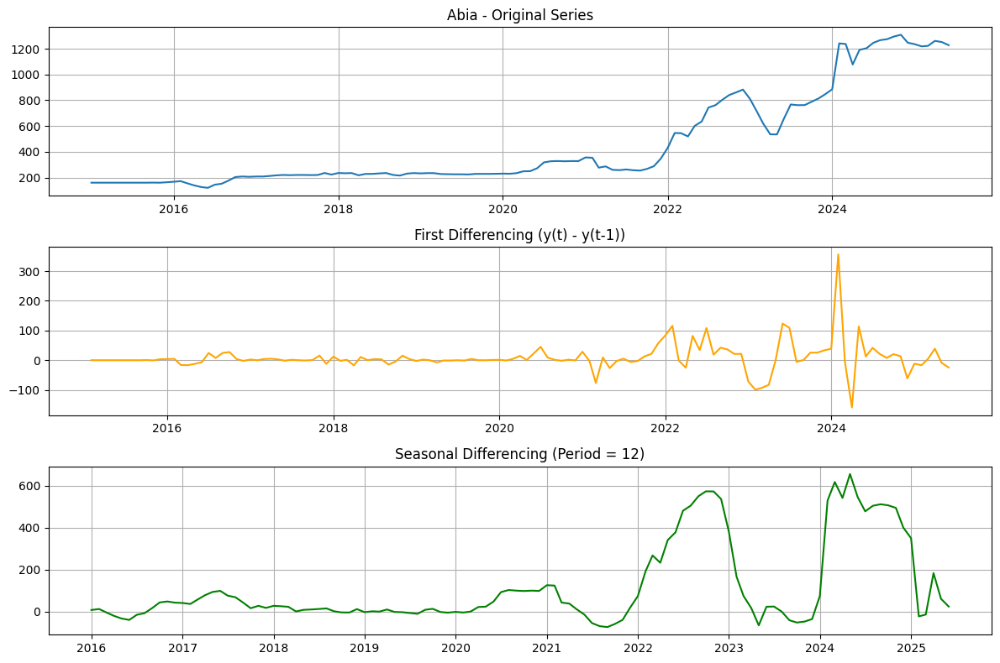


=== ADF Test on Differenced Series ===
ADF Statistic: -5.539409156066853
p-value: 1.71518556597536e-06
Critical Value (1%): -3.497501033
Critical Value (5%): -2.89090644
Critical Value (10%): -2.5824349

✅ The differenced series is stationary.


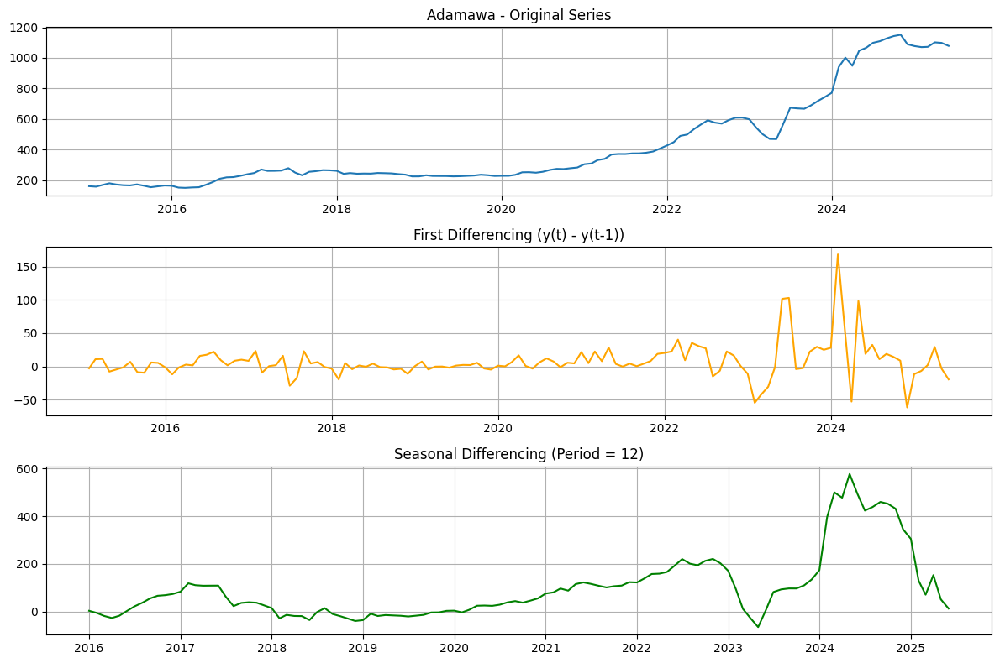


=== ADF Test on Differenced Series ===
ADF Statistic: -3.89758425197843
p-value: 0.0020526977878248267
Critical Value (1%): -3.498198082189098
Critical Value (5%): -2.891208211860468
Critical Value (10%): -2.5825959973472097

✅ The differenced series is stationary.


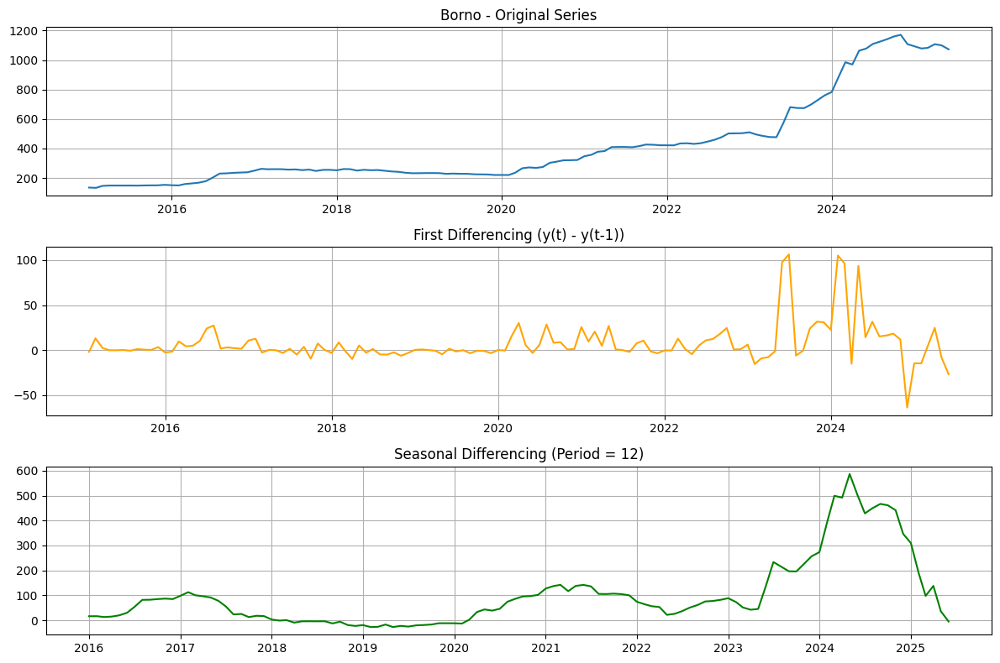


=== ADF Test on Differenced Series ===
ADF Statistic: -4.677717125305953
p-value: 9.26489494045137e-05
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


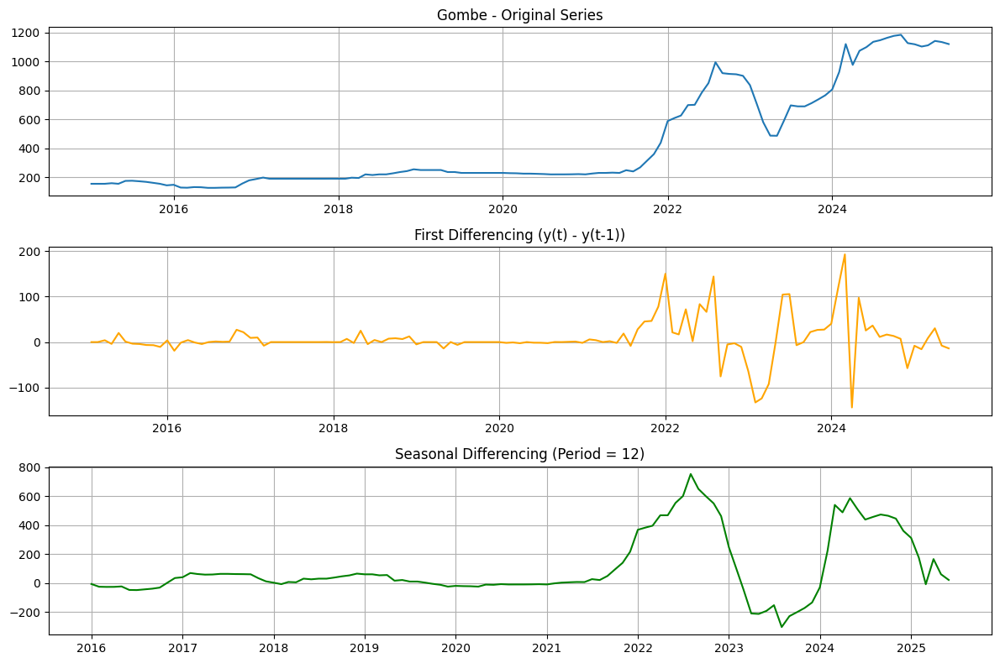


=== ADF Test on Differenced Series ===
ADF Statistic: -7.088036889298276
p-value: 4.485062679163407e-10
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


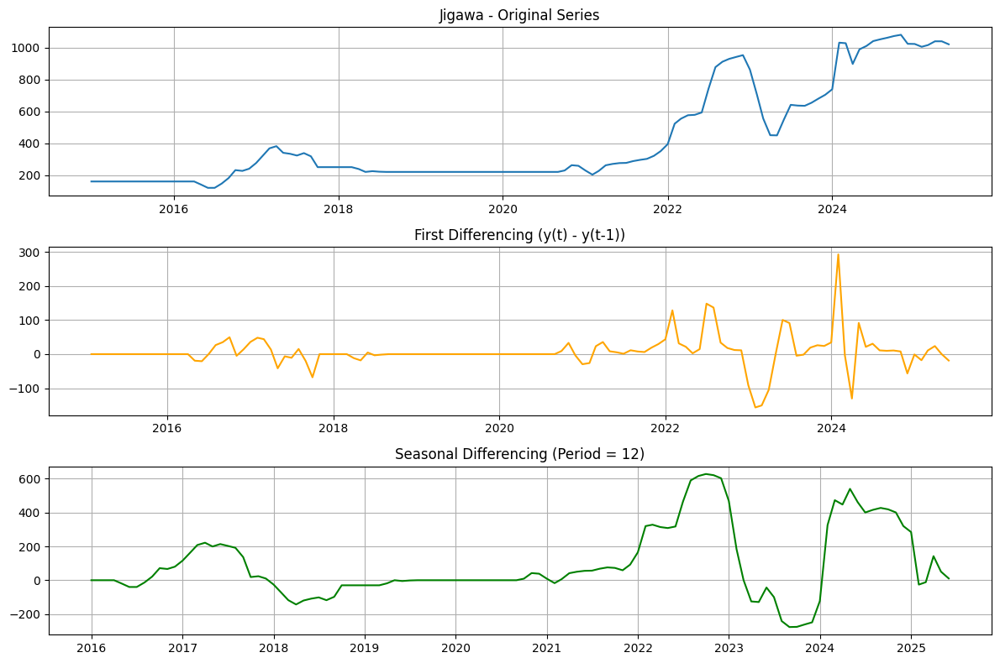


=== ADF Test on Differenced Series ===
ADF Statistic: -4.581978051336093
p-value: 0.00013941826466203495
Critical Value (1%): -3.498198082189098
Critical Value (5%): -2.891208211860468
Critical Value (10%): -2.5825959973472097

✅ The differenced series is stationary.


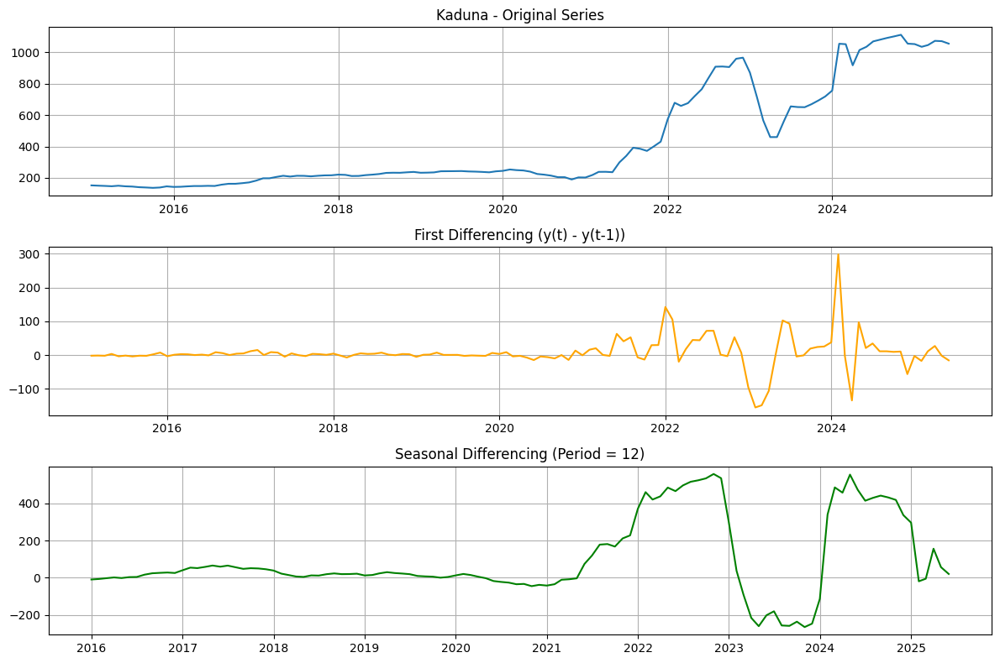


=== ADF Test on Differenced Series ===
ADF Statistic: -4.262817132032755
p-value: 0.0005148880766311643
Critical Value (1%): -3.497501033
Critical Value (5%): -2.89090644
Critical Value (10%): -2.5824349

✅ The differenced series is stationary.


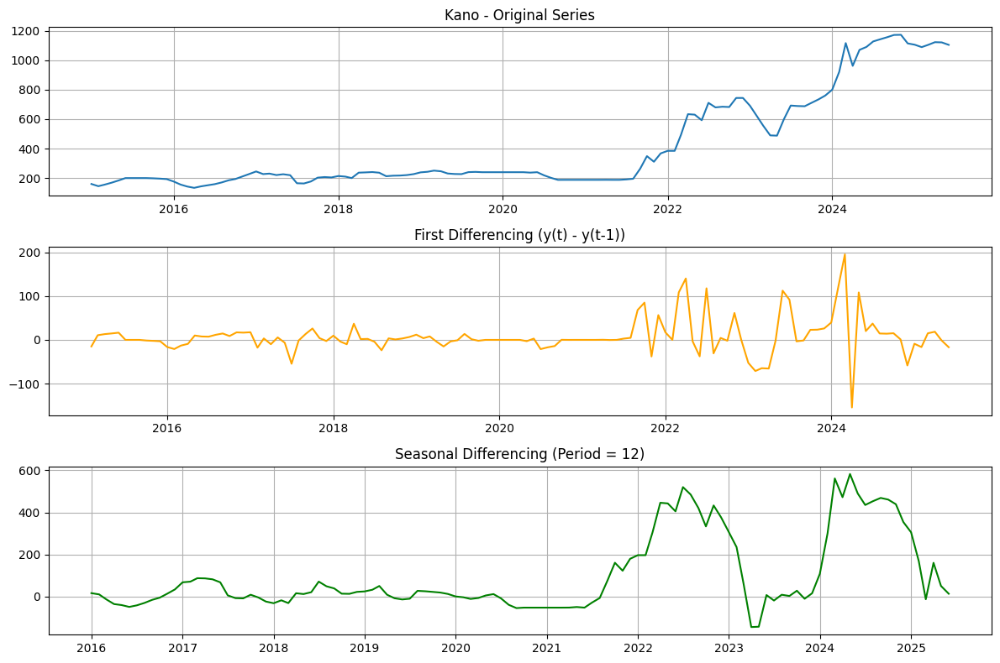


=== ADF Test on Differenced Series ===
ADF Statistic: -7.870382063947177
p-value: 5.003517763128795e-12
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


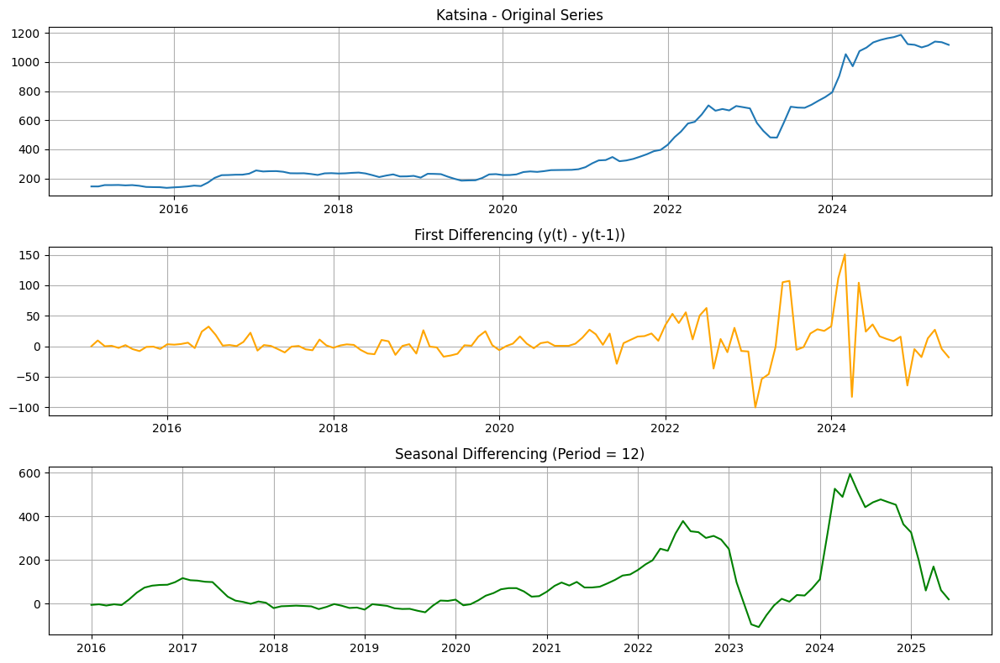


=== ADF Test on Differenced Series ===
ADF Statistic: -7.49337667305899
p-value: 4.4447313097112754e-11
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


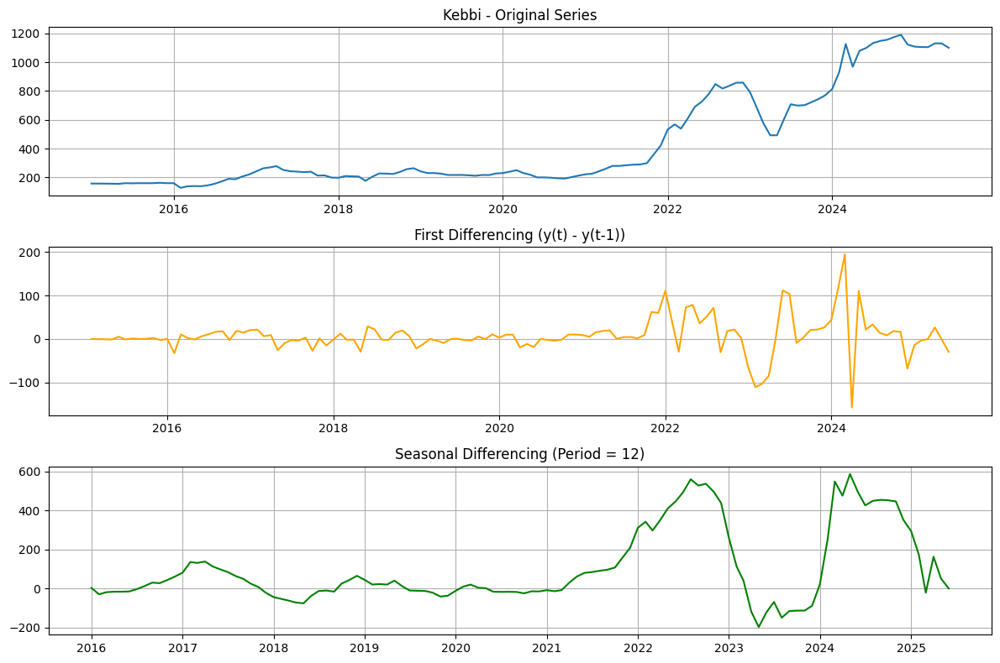


=== ADF Test on Differenced Series ===
ADF Statistic: -6.561855213726995
p-value: 8.342941377426086e-09
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


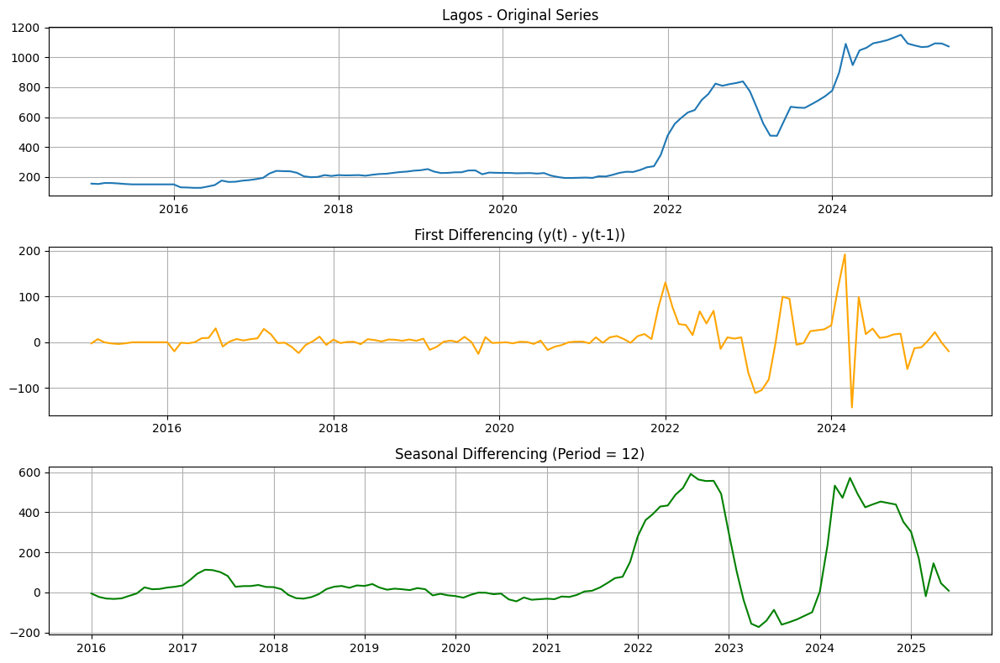


=== ADF Test on Differenced Series ===
ADF Statistic: -7.928344791419286
p-value: 3.5683009427031565e-12
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


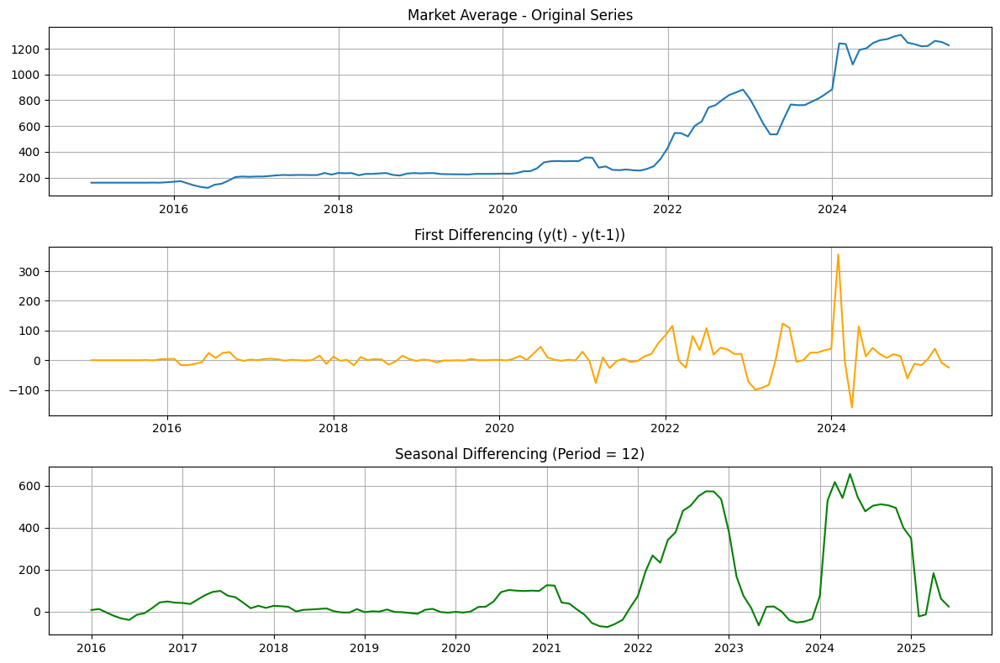


=== ADF Test on Differenced Series ===
ADF Statistic: -5.539409156066853
p-value: 1.71518556597536e-06
Critical Value (1%): -3.497501033
Critical Value (5%): -2.89090644
Critical Value (10%): -2.5824349

✅ The differenced series is stationary.


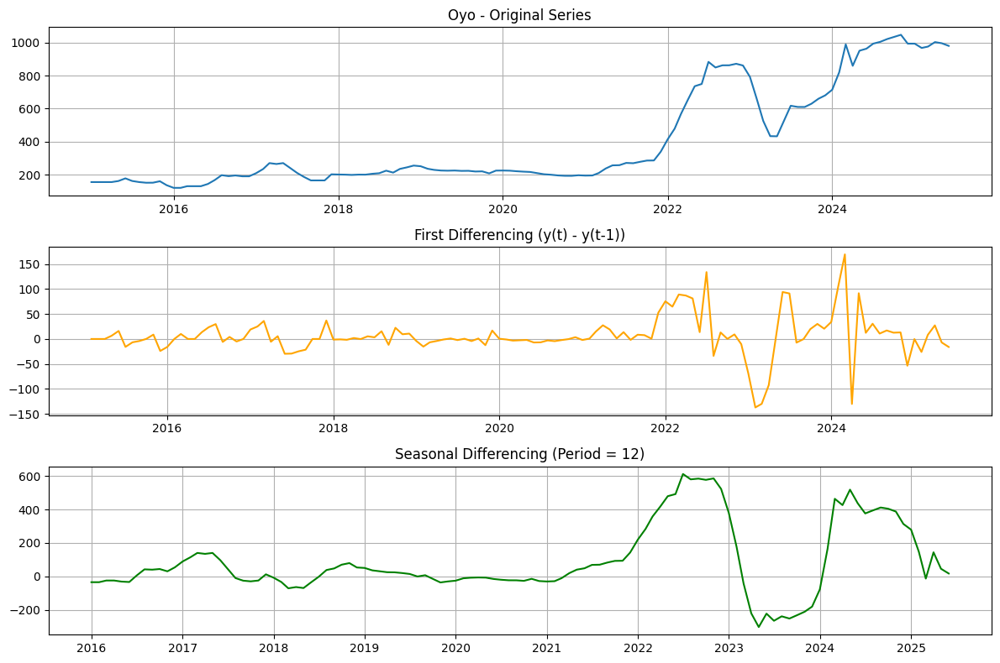


=== ADF Test on Differenced Series ===
ADF Statistic: -4.375770700683345
p-value: 0.00032755231590795675
Critical Value (1%): -3.497501033
Critical Value (5%): -2.89090644
Critical Value (10%): -2.5824349

✅ The differenced series is stationary.


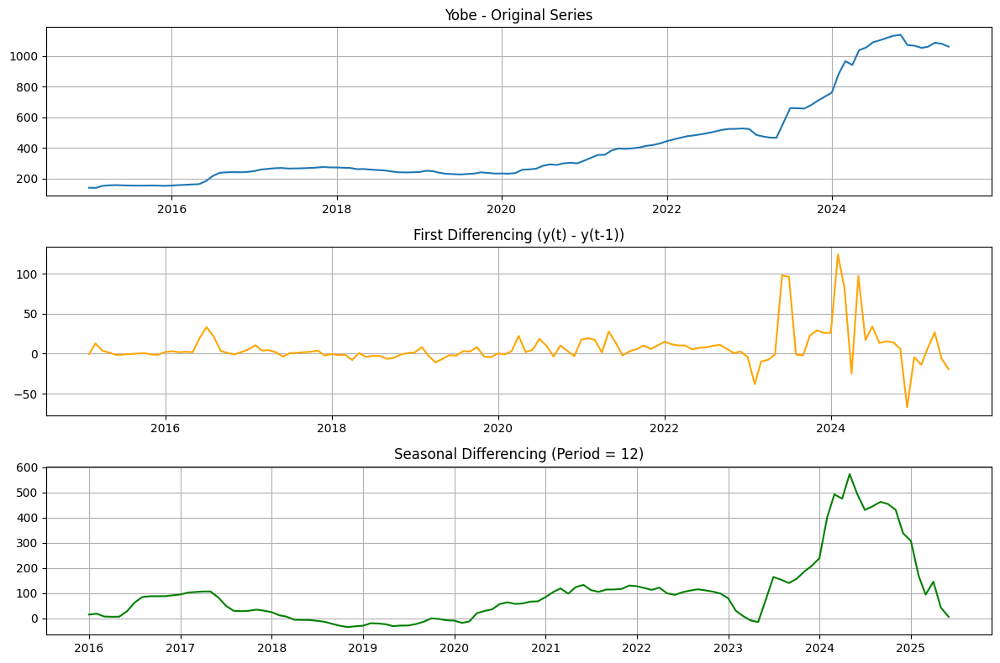


=== ADF Test on Differenced Series ===
ADF Statistic: -5.401161504027841
p-value: 3.3682289393131433e-06
Critical Value (1%): -3.4968181663902103
Critical Value (5%): -2.8906107514600103
Critical Value (10%): -2.5822770483285953

✅ The differenced series is stationary.


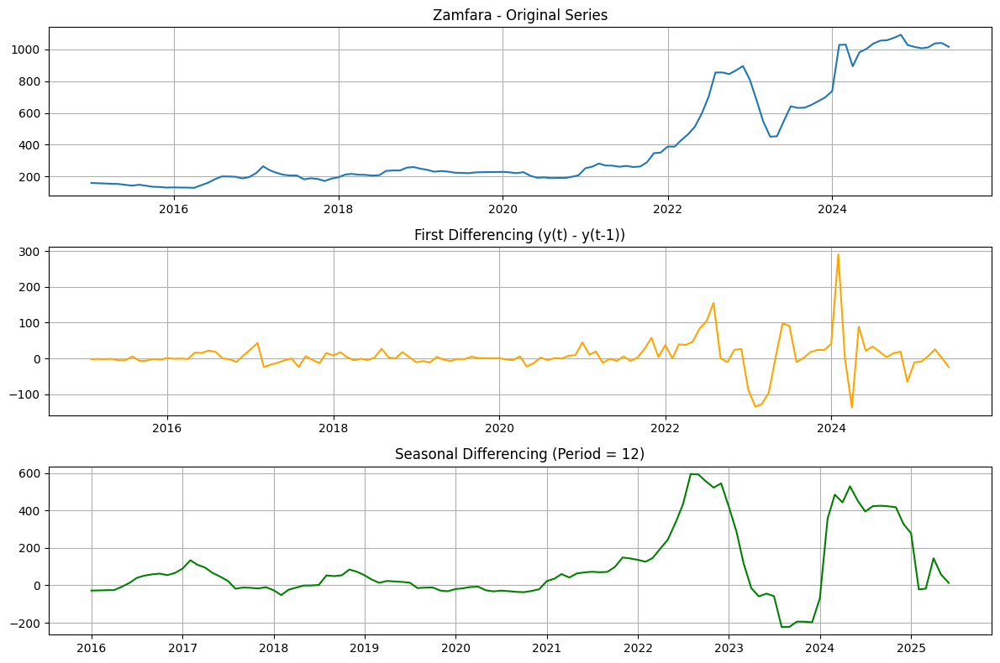


=== ADF Test on Differenced Series ===
ADF Statistic: -4.377413777557836
p-value: 0.0003253773775877339
Critical Value (1%): -3.497501033
Critical Value (5%): -2.89090644
Critical Value (10%): -2.5824349

✅ The differenced series is stationary.


In [166]:
#test both first and seasonal differencing

for i in (fuel_data['State'].unique()):

    diff_series = difference_series(fuel_data, state_name=i)
    print("\n=== ADF Test on Differenced Series ===")
    adf_result = adfuller(diff_series)
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    for key, value in adf_result[4].items():
        print(f"Critical Value ({key}): {value}")

    if adf_result[1] < 0.05:
        print("\n✅ The differenced series is stationary.")
    else:
        print("\n⚠️ The differenced series is still non-stationary.")


C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


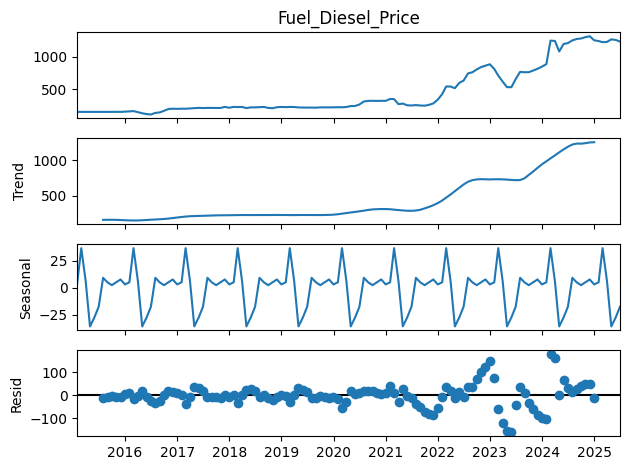

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


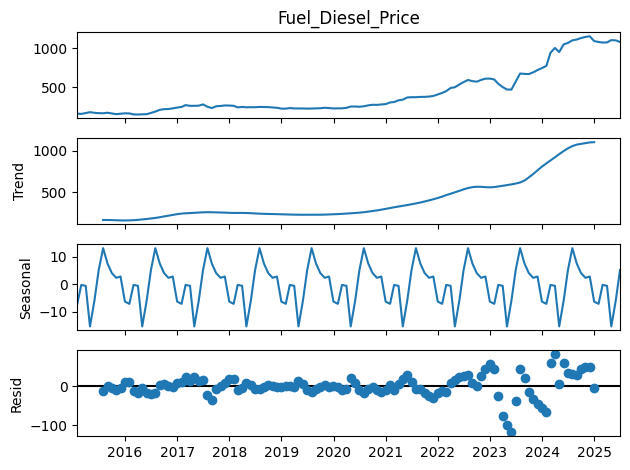

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


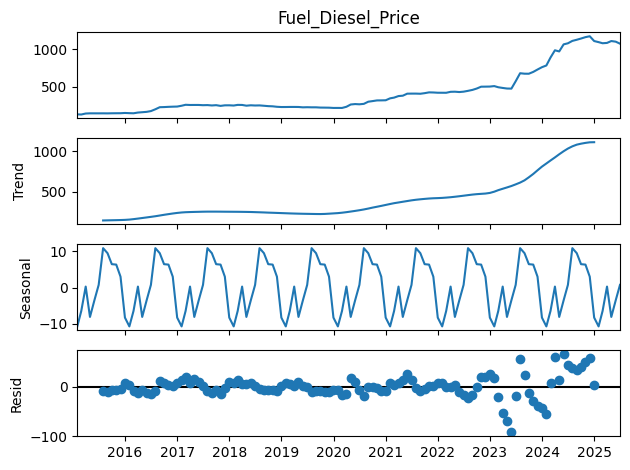

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


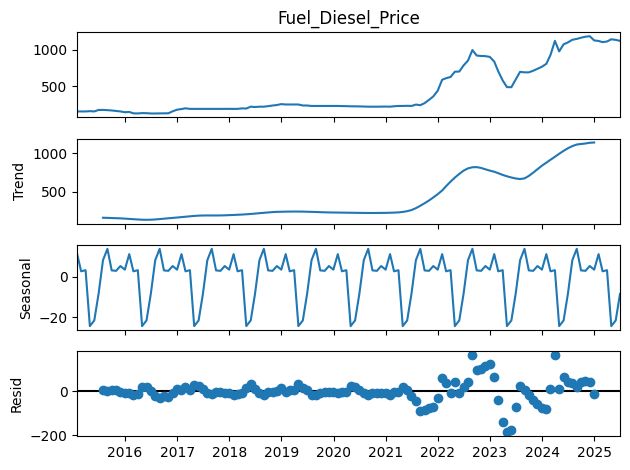

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


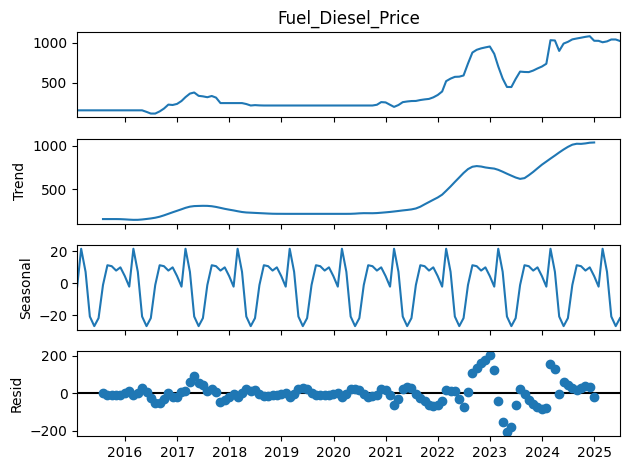

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


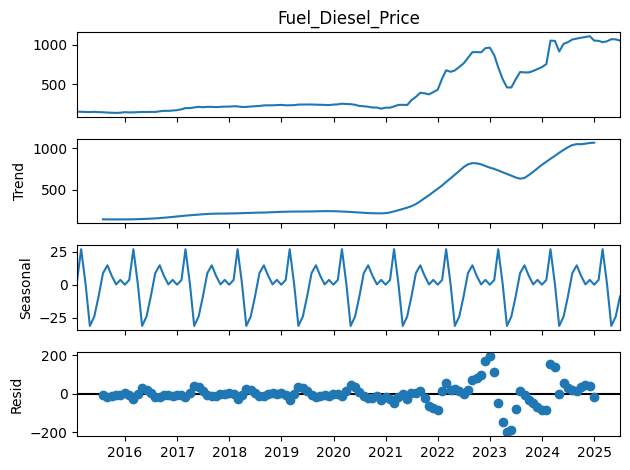

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


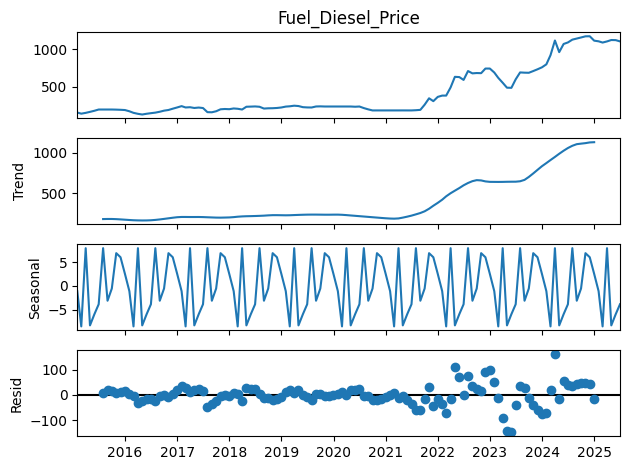

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


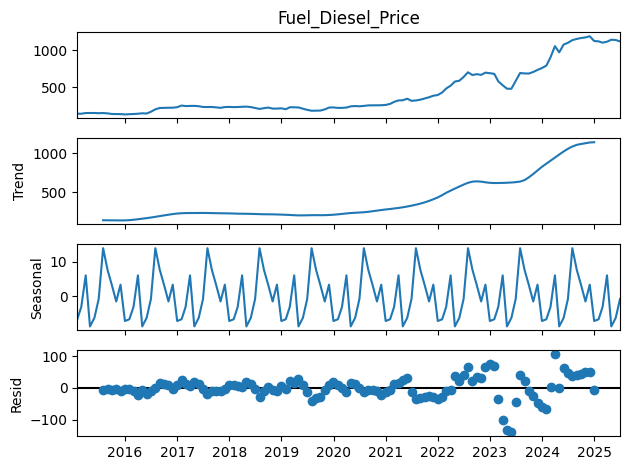

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


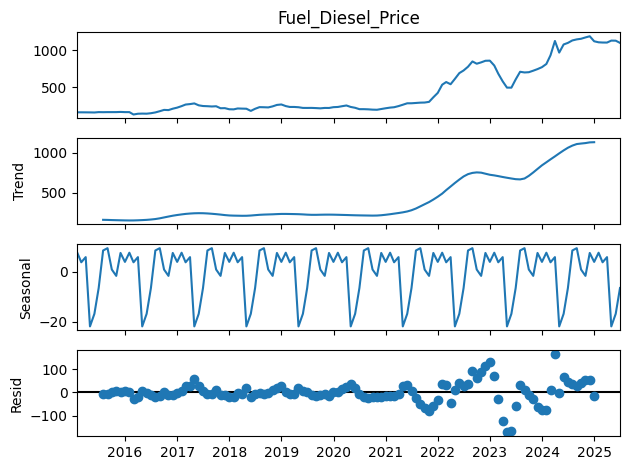

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


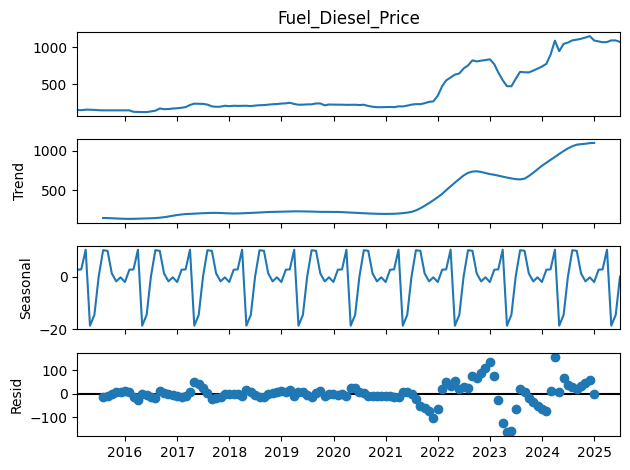

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


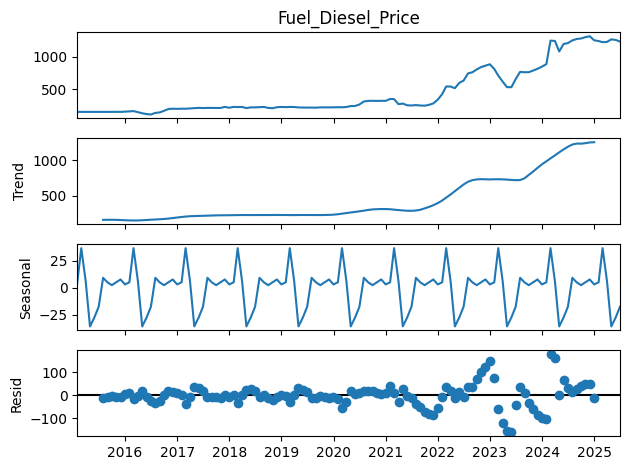

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


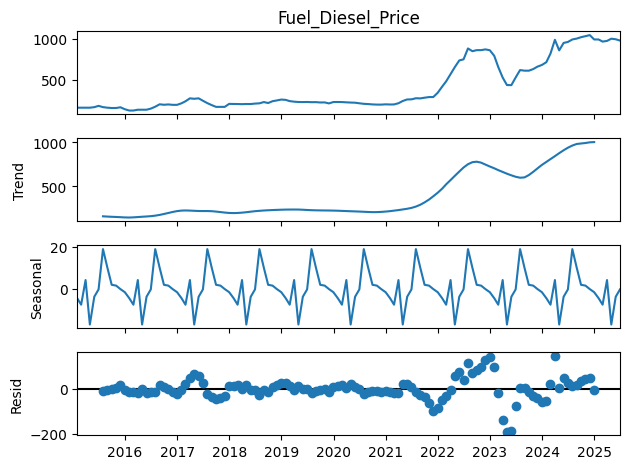

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


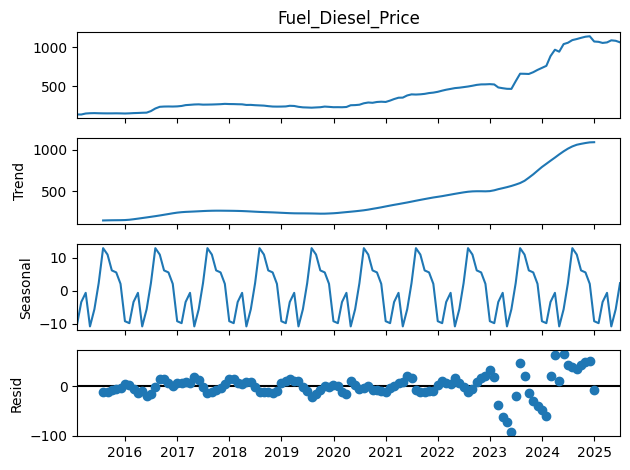

C:\Users\ibuku\AppData\Local\Temp\ipykernel_30356\1082111395.py:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()


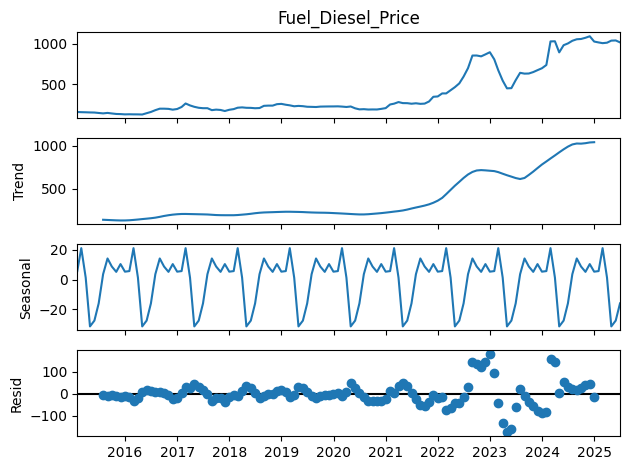

In [128]:
##ANALYZE FUEL PRICE SEASONALITY FOR EACH STATE
##FUEL PRICE MIGHT NEED DIFFERENCING BEFORE BEING USED AS AN EXOG

from statsmodels.tsa.seasonal import seasonal_decompose
for i in (fuel_data['State'].unique()):
    # Assuming your data is monthly and indexed by date
    state_df = df[df['State'] == i].copy()
    state_df.set_index('DATES', inplace=True)
    state_df = state_df['Fuel_Diesel_Price'].resample('M').mean()

    result = seasonal_decompose(state_df, model='additive', period=12)
    result.plot()
    plt.show()



In [9]:
#MERGE THE DATA

fuel_data = fuel_data[['State','Year', 'Month', 'Fuel_Diesel_Price']]

df_merged = pd.merge(df_food_prices, fuel_data, on=['State', 'Year', 'Month'], how='left')

df_merged.head()

,State,Year,Month,Food_Item,Unit,Price,Fuel_Diesel_Price
0,Abia,2015,1,Cassava_meal,100 KG,9638.49,160.0
1,Abia,2015,1,Gari,100 KG,8103.82,160.0
2,Abia,2015,1,Groundnuts,100 KG,17624.43,160.0
3,Abia,2015,1,Maize,100 KG,4994.13,160.0
4,Abia,2015,1,Sorghum,100 KG,6243.33,160.0


# THIS IS FOR DATA ACQUSITION, CLEANING AND EXPLORATORY DATA ANALYSIS OF EXCHANGE RATE DATA

In [5]:
##FUNCTION TO IMPORT AND CLEAN USD TO NGN EXCHANGE RATE DATA

import requests
import pandas as pd
from datetime import datetime

def fetch_ex_rate(api_url, item_list, country='Nigeria', years_back=10):
    """
    Fetch and process exchange rate data from World Bank Microdata API.
    
    Parameters:
        api_url (str): API endpoint URL.
        item_list (list): List of string(s), column name(s) to extract, e.g. ['value'].
        country (str): Country name to filter.
        years_back (int): How many years of data to fetch.

    Returns:
        pd.DataFrame: Cleaned long-format dataframe with exchange rate info.
    """
    limit = 10000
    offset = 0
    all_records = []

    fields_param = ','.join(['country', 'adm1_name', 'year', 'month'] + item_list)

    while True:
        params = {
            'limit': limit,
            'offset': offset,
            'country': country,
            'fields': fields_param
        }
        response = requests.get(api_url, params=params)
        if response.status_code == 200:
            data = response.json()
            records = data.get('data', [])
            if not records:
                break
            all_records.extend(records)
            offset += limit
        else:
            print(f"Failed to fetch data. Status code: {response.status_code}")
            return pd.DataFrame()  # Return empty DataFrame on failure

    df = pd.DataFrame(all_records)

    if df.empty:
        print("No data returned from API.")
        return df

    # Ensure proper datatypes
    df['year'] = pd.to_numeric(df['year'], errors='coerce')
    df['month'] = pd.to_numeric(df['month'], errors='coerce')
    df.dropna(subset=['year', 'month'], inplace=True)

    # Create a proper date column
    df['date'] = pd.to_datetime(df['year'].astype(int).astype(str) + '-' + df['month'].astype(int).astype(str) + '-01', errors='coerce')
    df.dropna(subset=['date'], inplace=True)

    # Filter by years
    start_year = datetime.now().year - years_back
    df = df[df['year'] >= start_year].copy()

    for col in item_list:
        df[col] = pd.to_numeric(df[col], errors='coerce')

    df.dropna(subset=item_list, how='all', inplace=True)

    # Grouping and averaging
    groupby_cols = ['country', 'adm1_name', 'year', 'month']
    df_avg = df.groupby(groupby_cols)[item_list].mean().reset_index()

    # Rename columns
    df_avg.rename(columns={'adm1_name': 'State', 'year': 'Year', 'month': 'Month'}, inplace=True)
    df_avg.drop('country', axis=1, inplace=True)

    # Convert from wide to long format
    df_long = pd.melt(
        df_avg,
        id_vars=['State', 'Year', 'Month'],
        value_vars=item_list,
        var_name='Rate_Type',
        value_name='Value'
    )

    df_long.dropna(subset=['Value'], inplace=True)
    df_long.sort_values(by=['State', 'Year', 'Month', 'Rate_Type'], inplace=True)
    df_long.reset_index(drop=True, inplace=True)

    return df_long


In [7]:
##FUNCTION CALL

exchange_rate_data = fetch_ex_rate(
    'https://microdata.worldbank.org/index.php/api/tables/data/fcv/wld_2023_rtfx_v01_m',
    item_list=['exchange_rate_unofficial'],
    country='Nigeria',
    years_back=10
)

exchange_rate_data.head(126)

,State,Year,Month,Rate_Type,Value
0,Abia,2015,1,exchange_rate_unofficial,169.68
1,Abia,2015,2,exchange_rate_unofficial,169.68
2,Abia,2015,3,exchange_rate_unofficial,197.07
3,Abia,2015,4,exchange_rate_unofficial,197.00
4,Abia,2015,5,exchange_rate_unofficial,197.00
...,...,...,...,...,...
121,Abia,2025,2,exchange_rate_unofficial,1500.47
122,Abia,2025,3,exchange_rate_unofficial,1525.87
123,Abia,2025,4,exchange_rate_unofficial,1594.55
124,Abia,2025,5,exchange_rate_unofficial,1594.70


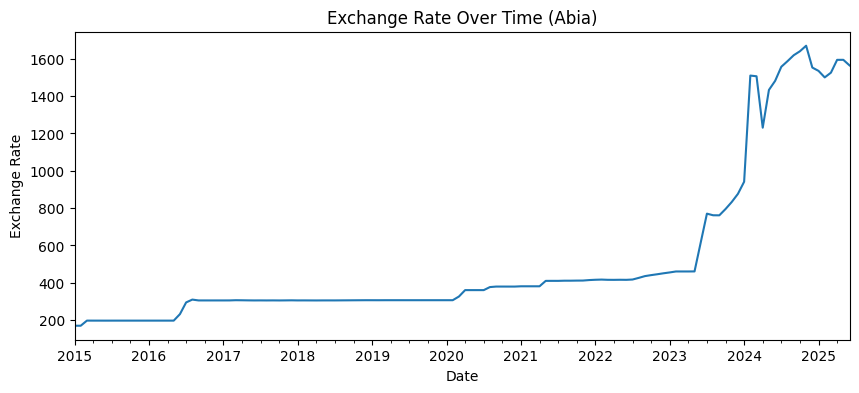

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


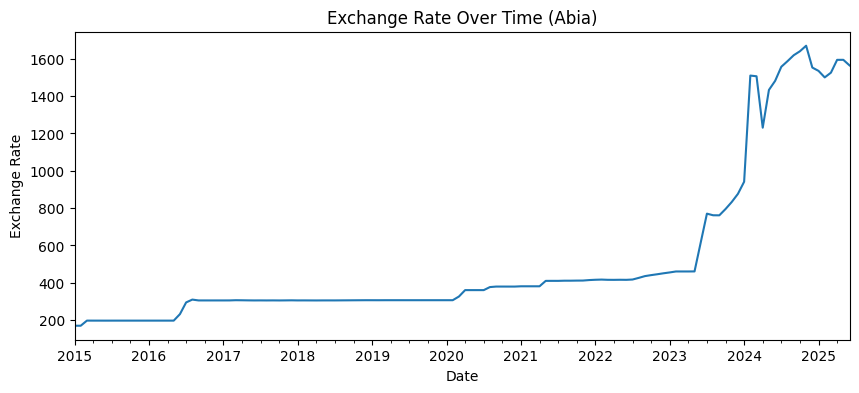

ADF Statistic: 0.3847507141107316
p-value: 0.9809156294192404
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


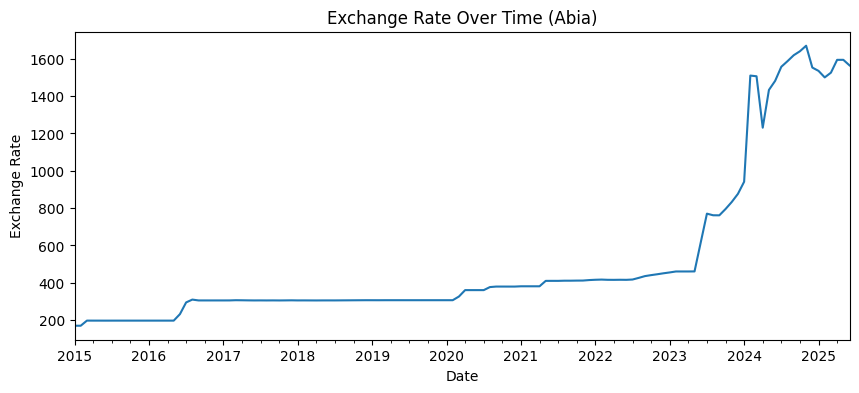

ADF Statistic: 0.3847507141107306
p-value: 0.9809156294192404
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


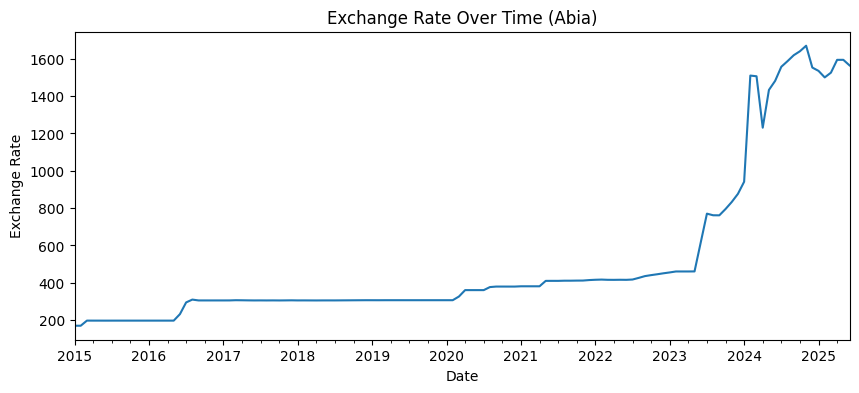

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


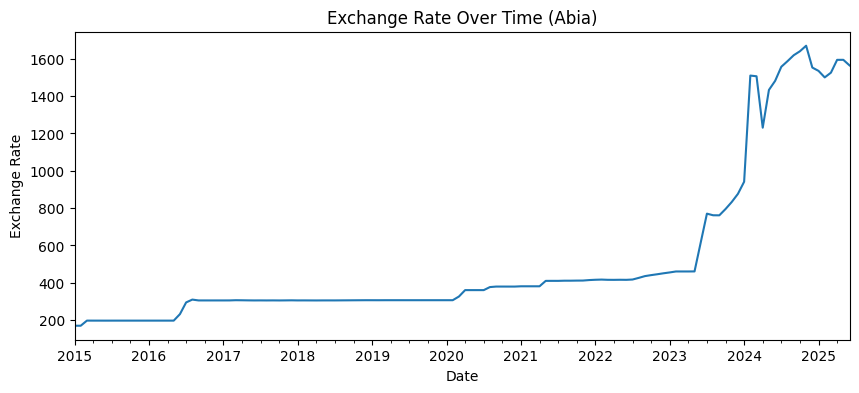

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


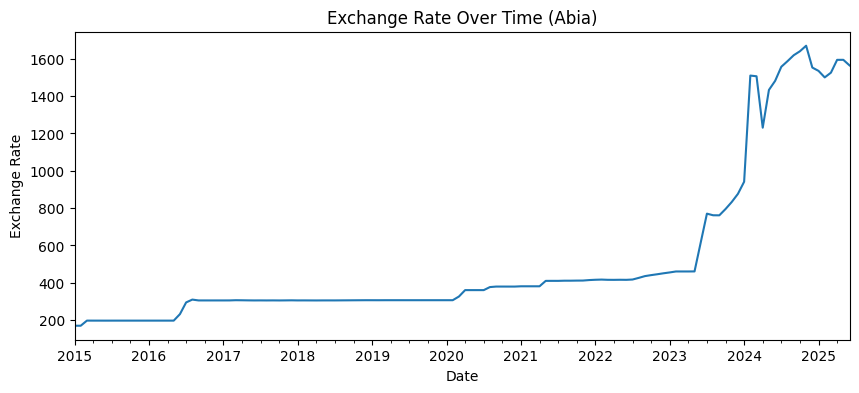

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


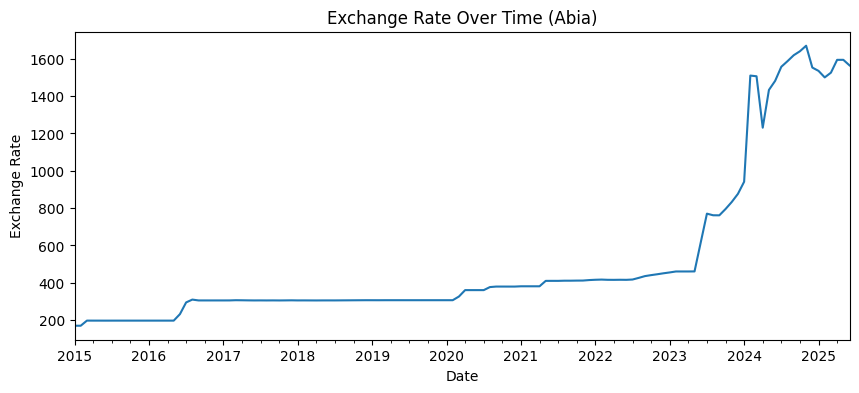

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


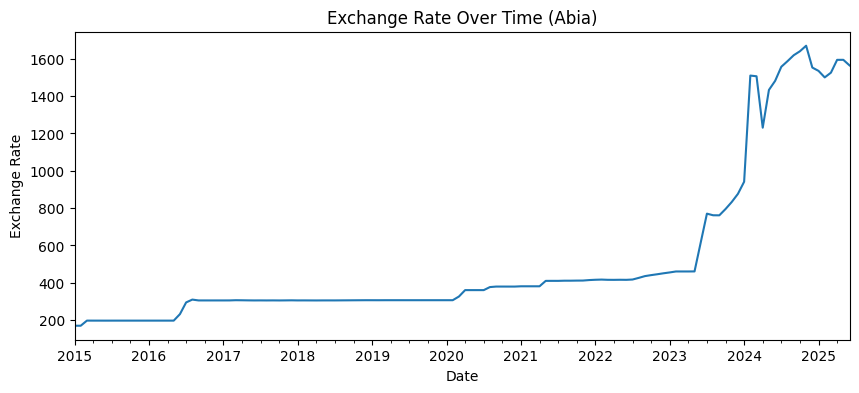

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


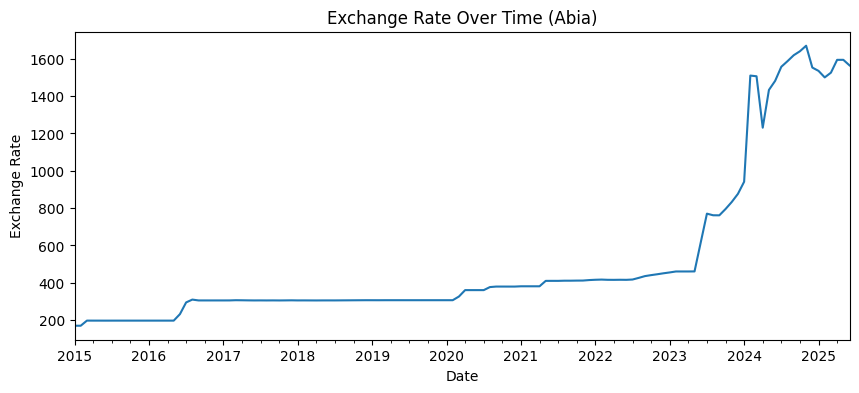

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


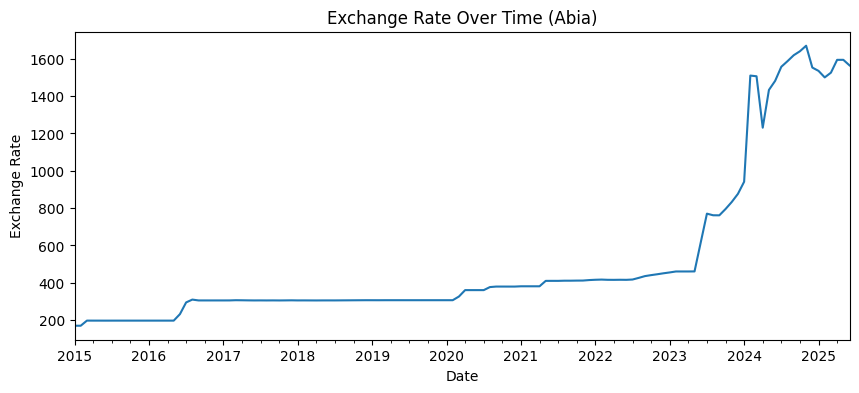

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


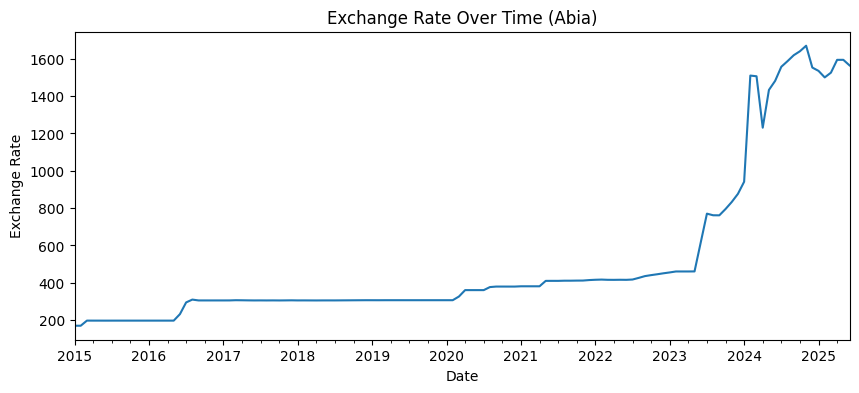

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


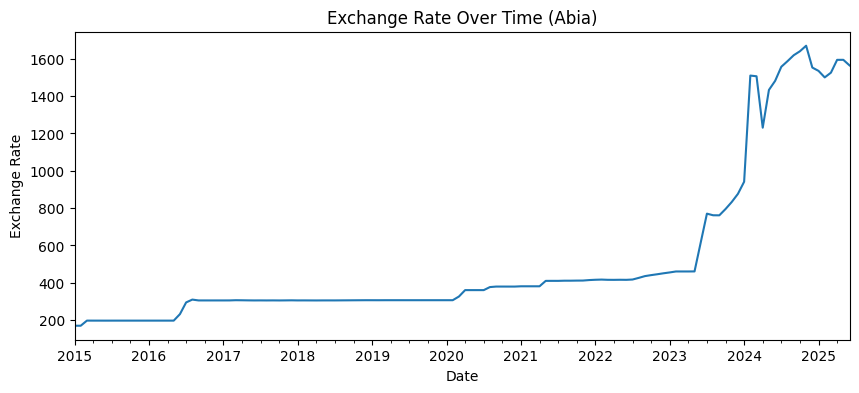

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


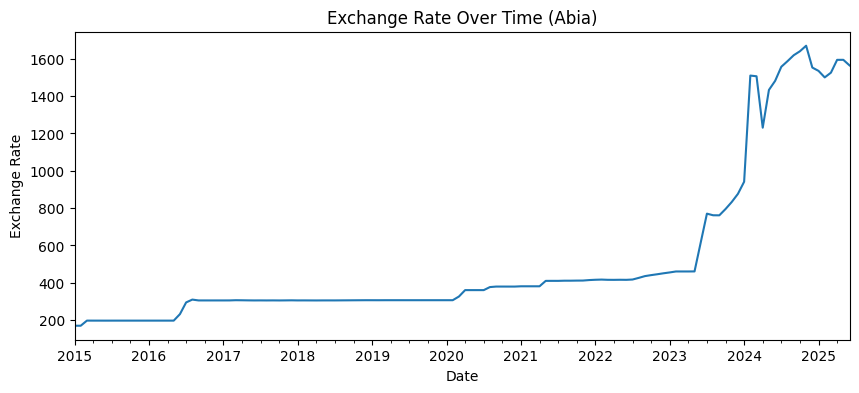

ADF Statistic: 0.38475071411072953
p-value: 0.9809156294192404
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


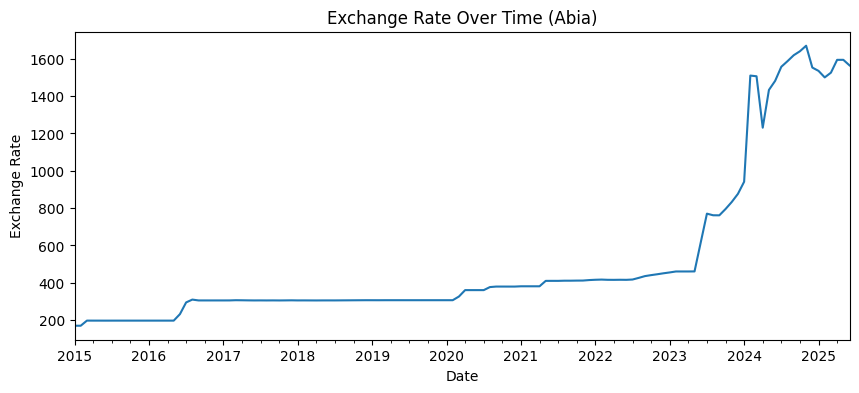

ADF Statistic: 0.3847507141107318
p-value: 0.9809156294192405
Critical Value (1%): -3.489589552580676
Critical Value (5%): -2.887477210140433
Critical Value (10%): -2.580604145195395
⚠️ Series is likely non-stationary (fail to reject null hypothesis).


In [119]:

import pandas as pd
from statsmodels.tsa.stattools import adfuller
import matplotlib.pyplot as plt

for i in (exchange_rate_data['State'].unique()):
    # Step 1: Filter to just one state (e.g., Abia) and sort
    state_df = exchange_rate_data[exchange_rate_data['State'] == i ].copy()
    state_df = state_df.sort_values(by=['Year', 'Month'])

    # Step 2: Create datetime index
    state_df['Date'] = pd.to_datetime(state_df[['Year', 'Month']].assign(DAY=1))
    state_df.set_index('Date', inplace=True)

    # Step 3: Plot the exchange rate
    state_df['Value'].plot(title='Exchange Rate Over Time (Abia)', figsize=(10,4))
    plt.ylabel("Exchange Rate")
    plt.show()

    # Step 4: ADF test
    result = adfuller(state_df['Value'])

    # Step 5: Print results
    print("ADF Statistic:", result[0])
    print("p-value:", result[1])
    for key, value in result[4].items():
        print(f"Critical Value ({key}): {value}")

    # Interpretation tip
    if result[1] < 0.05:
        print("✅ Series is likely stationary (reject null hypothesis).")
    else:
        print("⚠️ Series is likely non-stationary (fail to reject null hypothesis).")


In [151]:
def difference_series(df, state_name='Lagos', seasonal_period=12):
    """
    Applies first and seasonal differencing to make the time series stationary.

    Args:
        df (pd.DataFrame): DataFrame with ['State', 'DATES', 'Fuel_Diesel_Price']
        state_name (str): State to filter the series
        seasonal_period (int): Number of periods for seasonal differencing

    Returns:
        pd.Series: Differenced series (after both first and seasonal differencing)
    """
    df['DATES'] = pd.to_datetime(df['Year'].astype(int).astype(str) + '-' + 
                                    df['Month'].astype(int).astype(str) + '-01', errors='coerce')
    state_df = df[df['State'] == state_name].copy()
    state_df.set_index('DATES', inplace=True)
    ts = state_df['Value'].dropna()

    # First-order differencing
    first_diff = ts.diff().dropna()

    # Seasonal differencing
    second_diff = first_diff.diff().dropna()
    
    both_diffs = first_diff.diff(seasonal_period).dropna()

    # Plot original, first diff, seasonal diff
    plt.figure(figsize=(12, 8))
    plt.subplot(3, 1, 1)
    plt.plot(ts, label='Original')
    plt.title(f'{state_name} - Original Series')
    plt.grid(True)

    plt.subplot(3, 1, 2)
    plt.plot(first_diff, label='1st Difference', color='orange')
    plt.title('First Differencing (y(t) - y(t-1))')
    plt.grid(True)

    plt.subplot(3, 1, 3)
    plt.plot(second_diff, label='Seasonal Difference', color='green')
    plt.title(f'Seasonal Differencing (Period = {seasonal_period})')
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()

    return second_diff


In [10]:
##final merge

import pandas as pd


exchange_rate_data = exchange_rate_data.rename(columns={'Value': 'Exchange_Rate(USD-NGN)'})

# 2. Merge the DataFrames on State, Year, Month
merged_df = pd.merge(
    df_merged,
    exchange_rate_data[['State', 'Year', 'Month', 'Exchange_Rate(USD-NGN)']],
    on=['State', 'Year', 'Month'],
    how='left'  # Use 'inner' if you only want rows with matching exchange rate
)

# 3. Inspect result
print(merged_df.head())


  State  Year  Month     Food_Item    Unit     Price  Fuel_Diesel_Price  \
0  Abia  2015      1  Cassava_meal  100 KG   9638.49              160.0   
1  Abia  2015      1          Gari  100 KG   8103.82              160.0   
2  Abia  2015      1    Groundnuts  100 KG  17624.43              160.0   
3  Abia  2015      1         Maize  100 KG   4994.13              160.0   
4  Abia  2015      1       Sorghum  100 KG   6243.33              160.0   

   Exchange_Rate(USD-NGN)  
0                  169.68  
1                  169.68  
2                  169.68  
3                  169.68  
4                  169.68  


In [11]:
merged_df.head(100)

,State,Year,Month,Food_Item,Unit,Price,Fuel_Diesel_Price,Exchange_Rate(USD-NGN)
0,Abia,2015,1,Cassava_meal,100 KG,9638.49,160.0,169.68
1,Abia,2015,1,Gari,100 KG,8103.82,160.0,169.68
2,Abia,2015,1,Groundnuts,100 KG,17624.43,160.0,169.68
3,Abia,2015,1,Maize,100 KG,4994.13,160.0,169.68
4,Abia,2015,1,Sorghum,100 KG,6243.33,160.0,169.68
...,...,...,...,...,...,...,...,...
95,Abia,2016,8,Cassava_meal,100 KG,16015.72,152.0,309.73
96,Abia,2016,8,Gari,100 KG,14161.57,152.0,309.73
97,Abia,2016,8,Groundnuts,100 KG,30175.40,152.0,309.73
98,Abia,2016,8,Maize,100 KG,9508.30,152.0,309.73


In [172]:
df_merged

,State,Year,Month,Food_Item,Unit,Price,Fuel_Diesel_Price
0,Abia,2015,1,Cassava_meal,100 KG,9638.49,160.0
1,Abia,2015,1,Gari,100 KG,8103.82,160.0
2,Abia,2015,1,Groundnuts,100 KG,17624.43,160.0
3,Abia,2015,1,Maize,100 KG,4994.13,160.0
4,Abia,2015,1,Sorghum,100 KG,6243.33,160.0
...,...,...,...,...,...,...,...
8185,Zamfara,2025,6,Cassava_meal,100 KG,21753.19,1016.6
8186,Zamfara,2025,6,Gari,100 KG,21228.56,1016.6
8187,Zamfara,2025,6,Groundnuts,100 KG,49615.77,1016.6
8188,Zamfara,2025,6,Maize,100 KG,25987.81,1016.6


# ARIMA MODELLING WITHOUT EXOG


--- Processing: State='Borno', Food_Item='Cassava_meal' ---
  RMSE: 181.75
  MAE: 134.41

  Model Summary (last fitted model):
                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, [1], 12)   Log Likelihood                -895.391
Date:                              Fri, 06 Jun 2025   AIC                           1798.781
Time:                                      18:18:29   BIC                           1810.062
Sample:                                           0   HQIC                          1803.364
                                              - 125                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

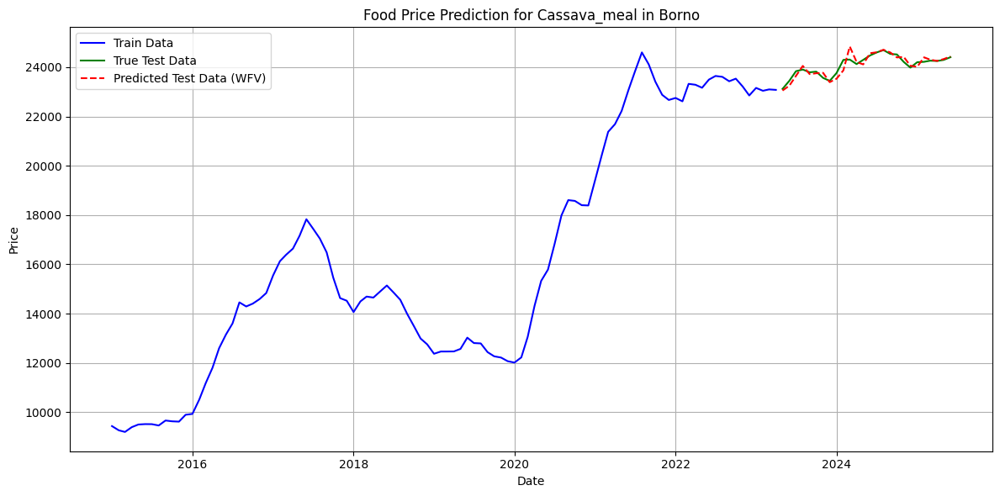


--- Processing: State='Borno', Food_Item='Gari' ---
  RMSE: 403.60
  MAE: 283.49

  Model Summary (last fitted model):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood                -908.928
Date:                            Fri, 06 Jun 2025   AIC                           1823.855
Time:                                    18:22:10   BIC                           1832.316
Sample:                                         0   HQIC                          1827.292
                                            - 125                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

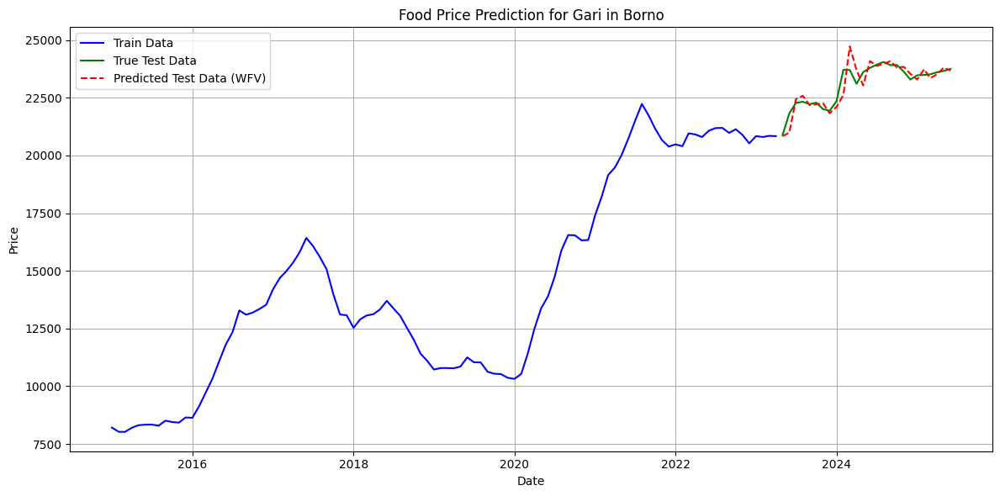


--- Processing: State='Borno', Food_Item='Groundnuts' ---
  RMSE: 738.29
  MAE: 541.83

  Model Summary (last fitted model):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood               -1018.579
Date:                            Fri, 06 Jun 2025   AIC                           2045.158
Time:                                    18:23:39   BIC                           2056.439
Sample:                                         0   HQIC                          2049.740
                                            - 125                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

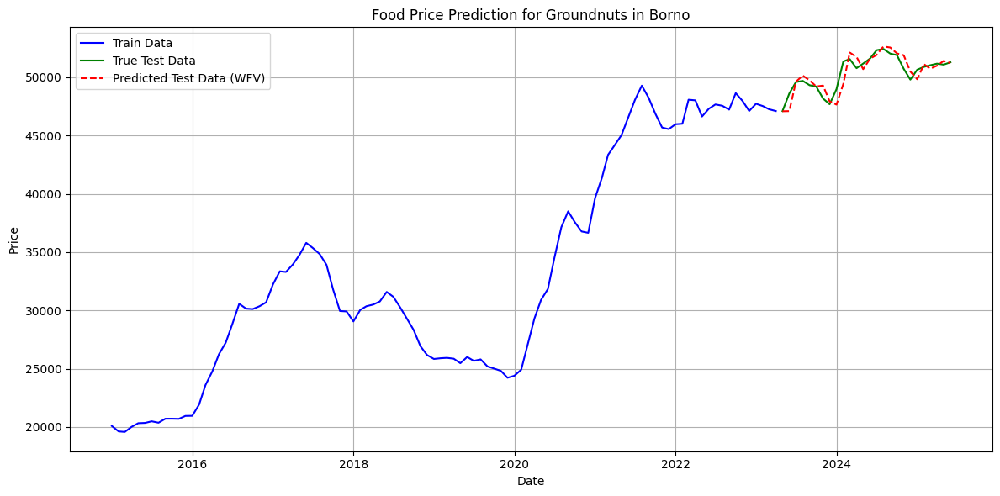


--- Processing: State='Borno', Food_Item='Maize' ---
  RMSE: 437.52
  MAE: 355.16

  Model Summary (last fitted model):
                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, [1, 2], 12)   Log Likelihood                -926.248
Date:                                 Fri, 06 Jun 2025   AIC                           1864.496
Time:                                         18:27:21   BIC                           1881.418
Sample:                                              0   HQIC                          1871.370
                                                 - 125                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------

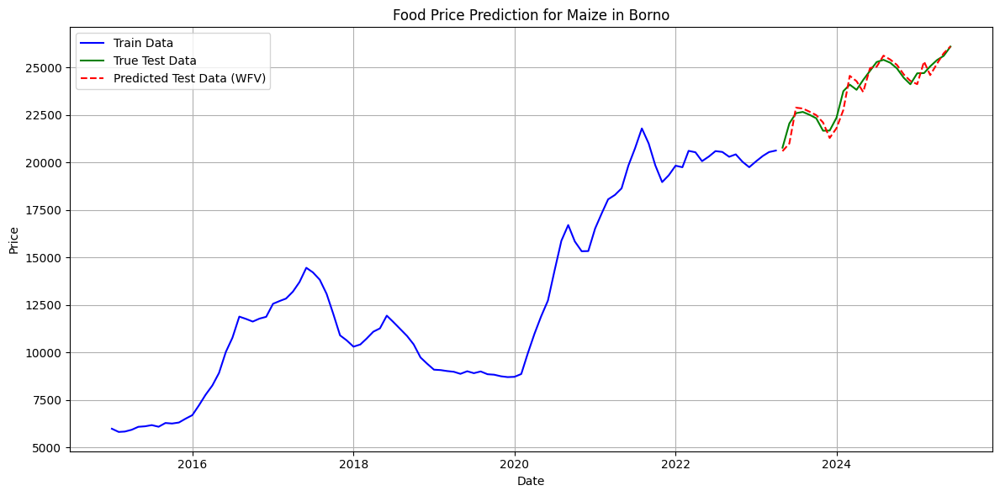


--- Processing: State='Borno', Food_Item='Sorghum' ---
  RMSE: 493.40
  MAE: 399.29

  Model Summary (last fitted model):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood                -936.141
Date:                            Fri, 06 Jun 2025   AIC                           1878.282
Time:                                    18:32:37   BIC                           1886.742
Sample:                                         0   HQIC                          1881.719
                                            - 125                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------

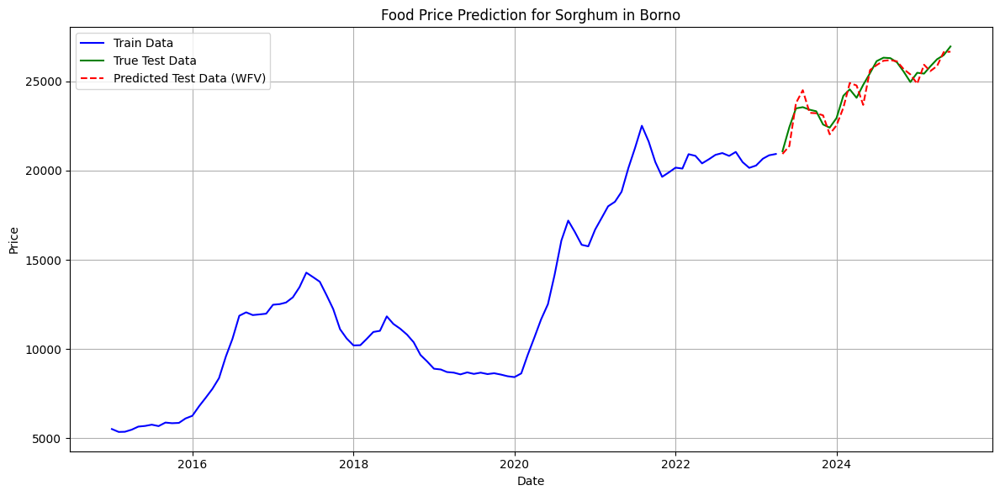


--- ARIMA modeling complete for selected states. ---


In [13]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

# Ensure datetime column
merged_df['Date'] = pd.to_datetime(merged_df['Year'].astype(str) + '-' + merged_df['Month'].astype(str), format='%Y-%m')

# Choose states of interest
selected_states = ['Borno']
filtered_df = merged_df[merged_df['State'].isin(selected_states)]

# Average price per state, food, and time
df_avg_price = filtered_df.groupby(['State', 'Food_Item', 'Date'])['Price'].mean().reset_index()
df_avg_price = df_avg_price.sort_values(by=['State', 'Food_Item', 'Date'])

# Unique combinations
unique_combinations = df_avg_price[['State', 'Food_Item']].drop_duplicates()

# Loop through combinations
for index, row in unique_combinations.iterrows():
    state = row['State']
    food_item = row['Food_Item']

    print(f"\n--- Processing: State='{state}', Food_Item='{food_item}' ---")

    series = df_avg_price[(df_avg_price['State'] == state) & (df_avg_price['Food_Item'] == food_item)].set_index('Date')['Price']
    series = series.asfreq('MS')

    if len(series) < 20:
        print(f"Skipping (not enough data points): State='{state}', Food_Item='{food_item}' (Length: {len(series)})")
        continue

    train_size = int(len(series) * 0.8)
    train_data, test_data = series[0:train_size], series[train_size:]

    predictions = []
    true_values = test_data.tolist()
    history = [x for x in train_data]

    for t in range(len(test_data)):
        try:
            model = auto_arima(history,
                               start_p=1, start_q=1,
                               test='adf',
                               max_p=5, max_q=5,
                               m=12,
                               d=None,
                               seasonal=True,
                               start_P=0,
                               trace=False,
                               error_action='ignore',
                               suppress_warnings=True,
                               stepwise=True)

            yhat = model.predict(n_periods=1)[0]
            predictions.append(yhat)
            history.append(test_data.iloc[t])
        except Exception as e:
            print(f"Error fitting ARIMA for {state}, {food_item} at step {t}: {e}")
            predictions.append(np.nan)
            history.append(test_data.iloc[t])

    predictions_series = pd.Series(predictions, index=test_data.index)

    valid_true = [true_values[i] for i, val in enumerate(predictions) if not np.isnan(val)]
    valid_predictions = [val for val in predictions if not np.isnan(val)]

    if len(valid_true) > 0:
        rmse = np.sqrt(mean_squared_error(valid_true, valid_predictions))
        mae = mean_absolute_error(valid_true, valid_predictions)
        print(f"  RMSE: {rmse:.2f}")
        print(f"  MAE: {mae:.2f}")

        print("\n  Model Summary (last fitted model):")
        if 'model' in locals():
            print(model.summary())
            print(f"  Non-seasonal order: {model.order}")
            print(f"  Seasonal order: {model.seasonal_order}")
        else:
            print("  No model summary available.")

        plt.figure(figsize=(12, 6))
        plt.plot(train_data.index, train_data, label='Train Data', color='blue')
        plt.plot(test_data.index, test_data, label='True Test Data', color='green')
        plt.plot(predictions_series.index, predictions_series, label='Predicted Test Data (WFV)', color='red', linestyle='--')
        plt.title(f'Food Price Prediction for {food_item} in {state}')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    else:
        print("  No valid predictions to evaluate or plot.")

print("\n--- ARIMA modeling complete for selected states. ---")


In [174]:
merged_df['Date'] = pd.to_datetime(merged_df[['Year', 'Month']].assign(DAY=1))
merged_df = merged_df.sort_values(['State', 'Food_Item', 'Date'])

# Aggregate average price by State, Food_Item, Date
grouped = merged_df.groupby(['State', 'Food_Item', 'Date']).agg({
    'Price': 'mean'
}).reset_index()

grouped

,State,Food_Item,Date,Price
0,Abia,Cassava_meal,2015-01-01,9638.49
1,Abia,Cassava_meal,2015-02-01,9643.04
2,Abia,Cassava_meal,2015-03-01,9384.38
3,Abia,Cassava_meal,2015-04-01,9341.25
4,Abia,Cassava_meal,2015-05-01,9535.43
...,...,...,...,...
8185,Zamfara,Sorghum,2025-02-01,26926.62
8186,Zamfara,Sorghum,2025-03-01,27951.89
8187,Zamfara,Sorghum,2025-04-01,27643.50
8188,Zamfara,Sorghum,2025-05-01,28301.03


# ARIMA MODELLING WITH EXOG - diesel price


--- Processing: State='Borno', Food_Item='Cassava_meal' ---
  RMSE (WFV): 181.75
  MAE (WFV): 134.41

  Final Model Summary (last fit in WFV):
                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, [1], 12)   Log Likelihood                -895.391
Date:                              Fri, 06 Jun 2025   AIC                           1798.781
Time:                                      18:42:51   BIC                           1810.062
Sample:                                  01-01-2015   HQIC                          1803.364
                                       - 05-01-2025                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------

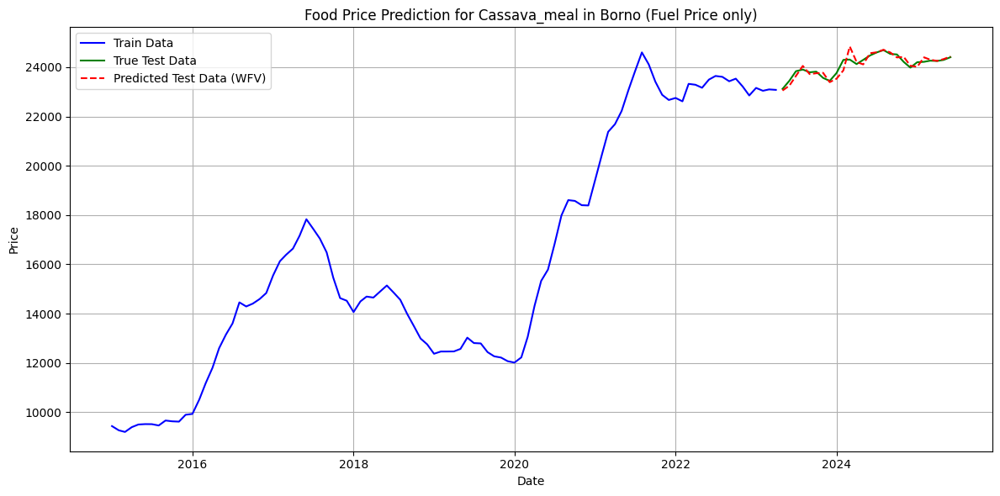


--- Processing: State='Borno', Food_Item='Gari' ---
  RMSE (WFV): 403.60
  MAE (WFV): 283.49

  Final Model Summary (last fit in WFV):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood                -908.928
Date:                            Fri, 06 Jun 2025   AIC                           1823.855
Time:                                    18:54:12   BIC                           1832.316
Sample:                                01-01-2015   HQIC                          1827.292
                                     - 05-01-2025                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------

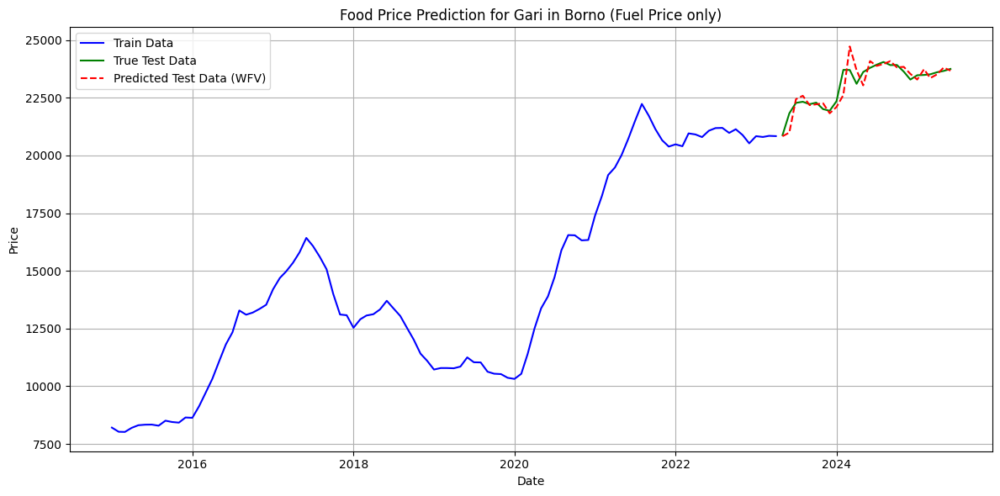


--- Processing: State='Borno', Food_Item='Groundnuts' ---
  RMSE (WFV): 738.29
  MAE (WFV): 541.83

  Final Model Summary (last fit in WFV):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood               -1018.579
Date:                            Fri, 06 Jun 2025   AIC                           2045.158
Time:                                    18:58:52   BIC                           2056.439
Sample:                                01-01-2015   HQIC                          2049.740
                                     - 05-01-2025                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------

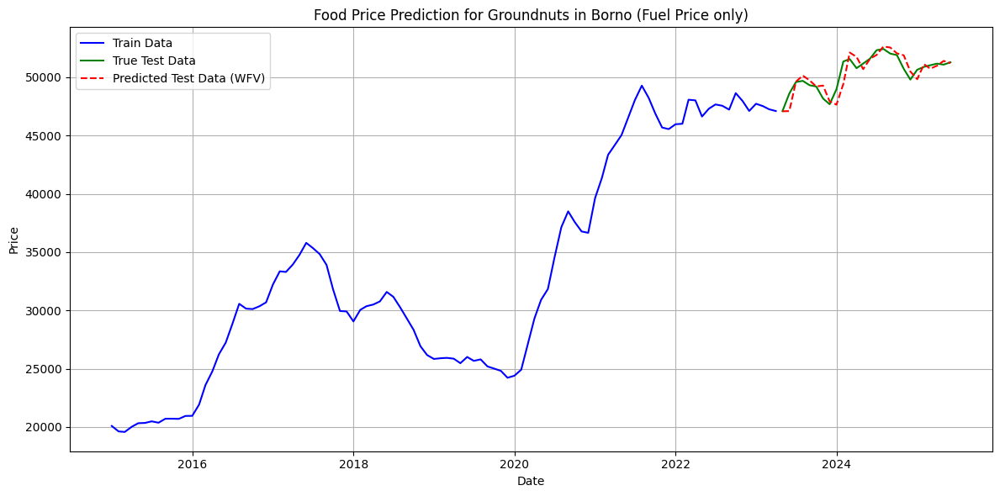


--- Processing: State='Borno', Food_Item='Maize' ---
  RMSE (WFV): 437.52
  MAE (WFV): 355.16

  Final Model Summary (last fit in WFV):
                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, [1, 2], 12)   Log Likelihood                -926.248
Date:                                 Fri, 06 Jun 2025   AIC                           1864.496
Time:                                         19:07:28   BIC                           1881.418
Sample:                                     01-01-2015   HQIC                          1871.370
                                          - 05-01-2025                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------

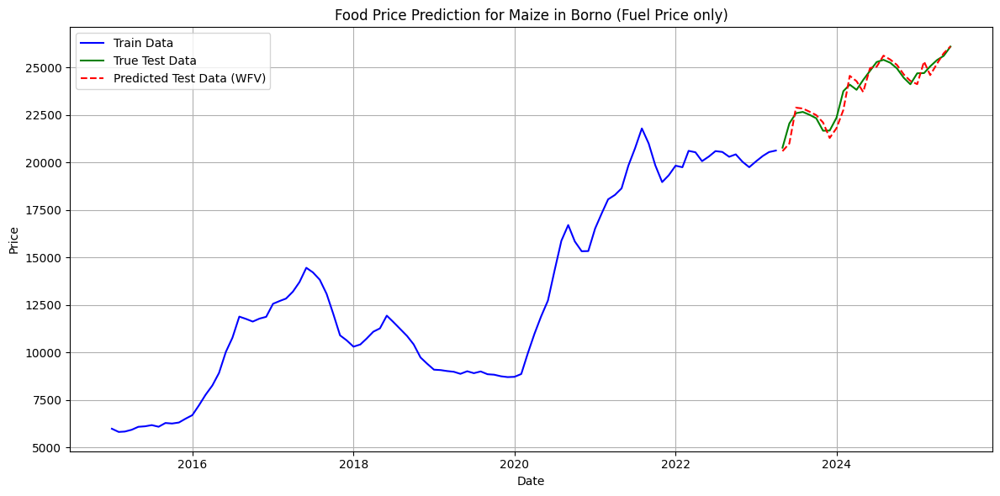


--- Processing: State='Borno', Food_Item='Sorghum' ---
  RMSE (WFV): 493.40
  MAE (WFV): 399.29

  Final Model Summary (last fit in WFV):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood                -936.141
Date:                            Fri, 06 Jun 2025   AIC                           1878.282
Time:                                    19:21:57   BIC                           1886.742
Sample:                                01-01-2015   HQIC                          1881.719
                                     - 05-01-2025                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------

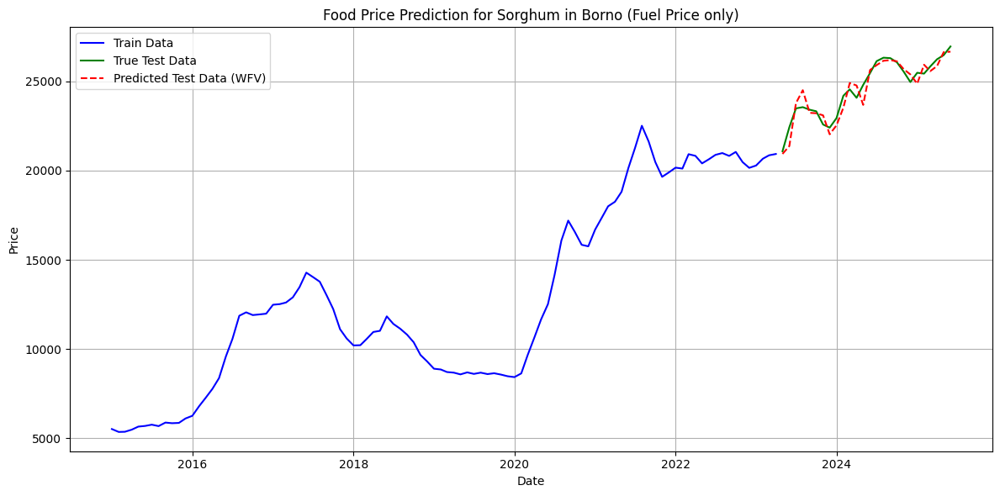


--- ARIMA modeling with WFV and single exogenous variable (Fuel Price) complete. ---


In [14]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

# Ensure datetime column
merged_df['Date'] = pd.to_datetime(merged_df['Year'].astype(str) + '-' + merged_df['Month'].astype(str), format='%Y-%m')

# Choose states of interest
selected_states = ['Borno']
filtered_df = merged_df[merged_df['State'].isin(selected_states)]

# Average price per state, food, and time
df_avg_price = filtered_df.groupby(['State', 'Food_Item', 'Date'])[['Price', 'Fuel_Diesel_Price']].mean().reset_index()
df_avg_price = df_avg_price.sort_values(by=['State', 'Food_Item', 'Date'])

# Unique combinations
unique_combinations = df_avg_price[['State', 'Food_Item']].drop_duplicates()

# Loop through combinations
for index, row in unique_combinations.iterrows():
    state = row['State']
    food_item = row['Food_Item']

    print(f"\n--- Processing: State='{state}', Food_Item='{food_item}' ---")

    subset = df_avg_price[(df_avg_price['State'] == state) & (df_avg_price['Food_Item'] == food_item)].set_index('Date')
    subset = subset.asfreq('MS')

    if len(subset) < 20:
        print(f"Skipping (not enough data points): State='{state}', Food_Item='{food_item}' (Length: {len(subset)})")
        continue

    price_series = subset['Price']
    exog_series = subset[['Fuel_Diesel_Price']]

    train_size = int(len(price_series) * 0.8)
    train_y, test_y = price_series[:train_size], price_series[train_size:]
    train_exog, test_exog = exog_series[:train_size], exog_series[train_size:]

    predictions = []
    true_values = test_y.tolist()
    history_y = train_y.copy()
    history_exog = train_exog.copy()

    for t in range(len(test_y)):
        try:
            model = auto_arima(history_y,
                               exogenous=history_exog,
                               start_p=1, start_q=1,
                               test='adf',
                               max_p=5, max_q=5,
                               m=12,
                               seasonal=True,
                               start_P=0,
                               trace=False,
                               error_action='ignore',
                               suppress_warnings=True,
                               stepwise=True)

            next_exog = test_exog.iloc[[t]]
            yhat = model.predict(n_periods=1, exogenous=next_exog)[0]
            predictions.append(yhat)

            # Update history with true test value
            history_y = pd.concat([history_y, test_y.iloc[[t]]])
            history_exog = pd.concat([history_exog, next_exog])
        except Exception as e:
            print(f"  Error fitting WFV model for {state}, {food_item} at t={t}: {e}")
            predictions.append(np.nan)
            history_y = pd.concat([history_y, test_y.iloc[[t]]])
            history_exog = pd.concat([history_exog, test_exog.iloc[[t]]])

    predictions_series = pd.Series(predictions, index=test_y.index)

    valid_true = [true_values[i] for i, val in enumerate(predictions) if not np.isnan(val)]
    valid_predictions = [val for val in predictions if not np.isnan(val)]

    if len(valid_true) > 0:
        rmse = np.sqrt(mean_squared_error(valid_true, valid_predictions))
        mae = mean_absolute_error(valid_true, valid_predictions)
        print(f"  RMSE (WFV): {rmse:.2f}")
        print(f"  MAE (WFV): {mae:.2f}")

        print("\n  Final Model Summary (last fit in WFV):")
        print(model.summary())
        print(f"  Non-seasonal order: {model.order}")
        print(f"  Seasonal order: {model.seasonal_order}")

        plt.figure(figsize=(12, 6))
        plt.plot(train_y.index, train_y, label='Train Data', color='blue')
        plt.plot(test_y.index, test_y, label='True Test Data', color='green')
        plt.plot(predictions_series.index, predictions_series, label='Predicted Test Data (WFV)', color='red', linestyle='--')
        plt.title(f'Food Price Prediction for {food_item} in {state} (Fuel Price only)')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    else:
        print("  No valid predictions to evaluate or plot.")

print("\n--- ARIMA modeling with WFV and single exogenous variable (Fuel Price) complete. ---")


In [196]:
subset1 = df_avg_price[(df_avg_price['State'] == state) & (df_avg_price['Food_Item'] == food_item)].set_index('Date')
df_avg_price = filtered_df.groupby(['State', 'Food_Item', 'Date'])[['Price', 'Exchange_Rate(USD-NGN)']].mean().reset_index()
subset1 = subset1.asfreq('MS')


subset1[['Price', 'Exchange_Rate(USD-NGN)']].corr()



,Price,Exchange_Rate(USD-NGN)
Price,1.000000,0.737303
Exchange_Rate(USD-NGN),0.737303,1.000000


In [199]:
subset1['Exchange_Rate_Lag1'] = subset1['Exchange_Rate(USD-NGN)'].shift(1)
subset1[['Price', 'Exchange_Rate_Lag1']].corr()

,Price,Exchange_Rate_Lag1
Price,1.000000,0.728841
Exchange_Rate_Lag1,0.728841,1.000000


In [200]:
# Detrend both series
detrended_price = subset1['Price'].diff().dropna()
detrended_fuel = subset1['Exchange_Rate(USD-NGN)'].diff().dropna()

# Check correlation after differencing
detrended_corr = detrended_price.corr(detrended_fuel)
print(f'Detrended correlation: {detrended_corr}')


Detrended correlation: 0.30860151547695847


In [208]:
from statsmodels.tsa.stattools import grangercausalitytests

data_gc = subset[['Price', 'Fuel_Diesel_Price']].dropna()
grangercausalitytests(data_gc, maxlag=12, verbose=True)



Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.0226  , p=0.8809  , df_denom=122, df_num=1
ssr based chi2 test:   chi2=0.0231  , p=0.8792  , df=1
likelihood ratio test: chi2=0.0231  , p=0.8792  , df=1
parameter F test:         F=0.0226  , p=0.8809  , df_denom=122, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.0484  , p=0.9527  , df_denom=119, df_num=2
ssr based chi2 test:   chi2=0.1009  , p=0.9508  , df=2
likelihood ratio test: chi2=0.1009  , p=0.9508  , df=2
parameter F test:         F=0.0484  , p=0.9527  , df_denom=119, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.1273  , p=0.9437  , df_denom=116, df_num=3
ssr based chi2 test:   chi2=0.4051  , p=0.9392  , df=3
likelihood ratio test: chi2=0.4044  , p=0.9393  , df=3
parameter F test:         F=0.1273  , p=0.9437  , df_denom=116, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=0.2341  , p=0.9186  

{1: ({'ssr_ftest': (0.02255771708746158, 0.8808609545913002, 122.0, 1),
   'ssr_chi2test': (0.02311241504862867, 0.8791651050508978, 1),
   'lrtest': (0.023110278576950805, 0.8791706471720246, 1),
   'params_ftest': (0.02255771708749779, 0.8808609545912292, 122.0, 1.0)},
   array([[0., 1., 0.]])]),
 2: ({'ssr_ftest': (0.04843404039503312, 0.9527389493261496, 119.0, 2),
   'ssr_chi2test': (0.1009381682182203, 0.9507833225314152, 2),
   'lrtest': (0.10089710778242988, 0.950802842520572, 2),
   'params_ftest': (0.04843404039508041, 0.9527389493261055, 119.0, 2.0)},
   array([[0., 0., 1., 0., 0.],
          [0., 0., 0., 1., 0.]])]),
 3: ({'ssr_ftest': (0.12734395125639586, 0.9437229484519426, 116.0, 3),
   'ssr_chi2test': (0.40508550011732825, 0.9391899575154927, 3),
   'lrtest': (0.4044199112270235, 0.9393279387597716, 3),
   'params_ftest': (0.12734395125640754, 0.9437229484519373, 116.0, 3.0)},
   array([[0., 0., 0., 1., 0., 0., 0.],
          [0., 0., 0., 0., 1., 0., 0.],
          [0.


--- Processing: State='Borno', Food_Item='Cassava_meal' ---
  RMSE (WFV): 181.75
  MAE (WFV): 134.41

  Final Model Summary (last fit in WFV):
                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, [1], 12)   Log Likelihood                -895.391
Date:                              Fri, 06 Jun 2025   AIC                           1798.781
Time:                                      15:31:32   BIC                           1810.062
Sample:                                  01-01-2015   HQIC                          1803.364
                                       - 05-01-2025                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------

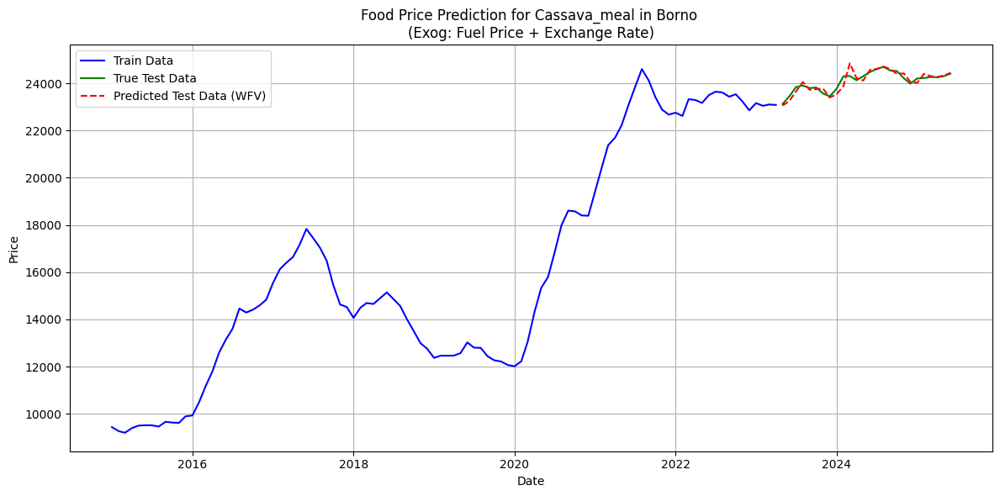


--- Processing: State='Borno', Food_Item='Gari' ---
  RMSE (WFV): 403.60
  MAE (WFV): 283.49

  Final Model Summary (last fit in WFV):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood                -908.928
Date:                            Fri, 06 Jun 2025   AIC                           1823.855
Time:                                    15:38:36   BIC                           1832.316
Sample:                                01-01-2015   HQIC                          1827.292
                                     - 05-01-2025                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------

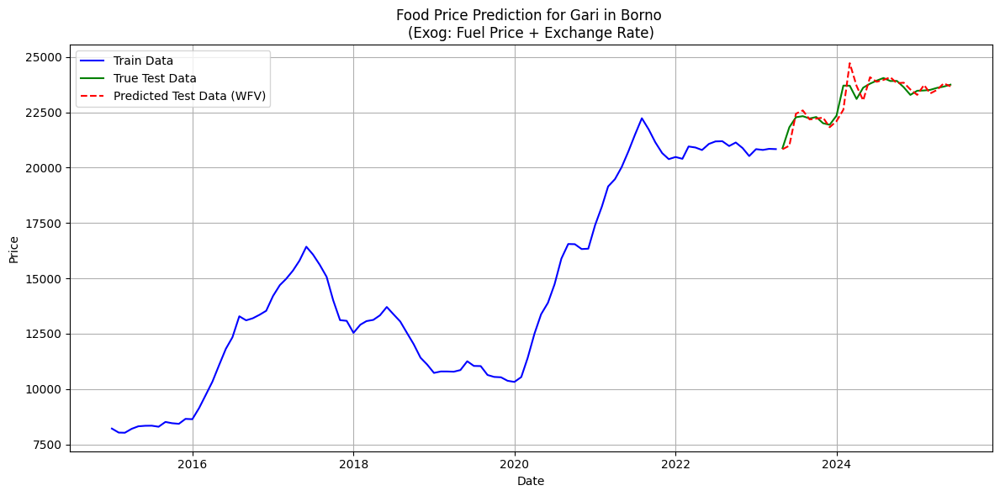


--- Processing: State='Borno', Food_Item='Groundnuts' ---
  RMSE (WFV): 738.29
  MAE (WFV): 541.83

  Final Model Summary (last fit in WFV):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, 0, 12)   Log Likelihood               -1018.579
Date:                            Fri, 06 Jun 2025   AIC                           2045.158
Time:                                    15:41:10   BIC                           2056.439
Sample:                                01-01-2015   HQIC                          2049.740
                                     - 05-01-2025                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------

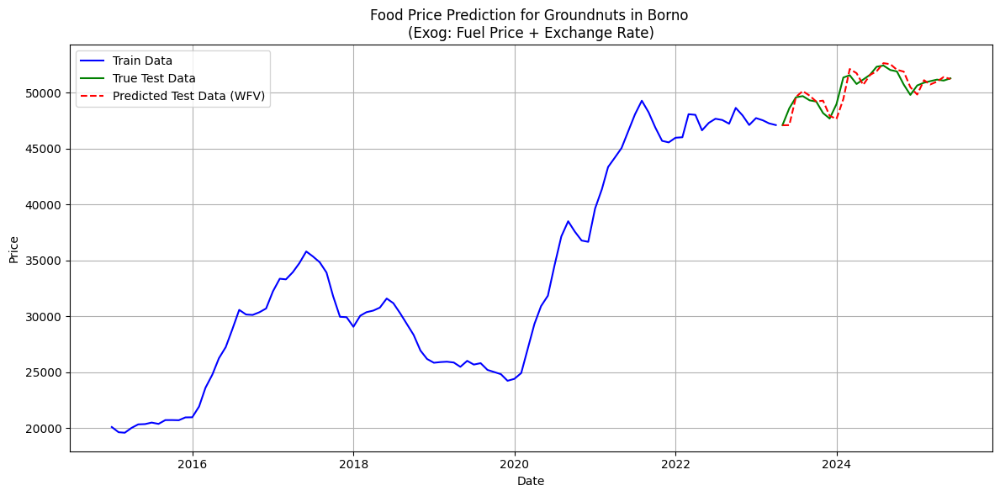


--- Processing: State='Borno', Food_Item='Maize' ---
  RMSE (WFV): 437.52
  MAE (WFV): 355.16

  Final Model Summary (last fit in WFV):
                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  125
Model:             SARIMAX(1, 1, 0)x(1, 0, [1, 2], 12)   Log Likelihood                -926.248
Date:                                 Fri, 06 Jun 2025   AIC                           1864.496
Time:                                         15:46:00   BIC                           1881.418
Sample:                                     01-01-2015   HQIC                          1871.370
                                          - 05-01-2025                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------

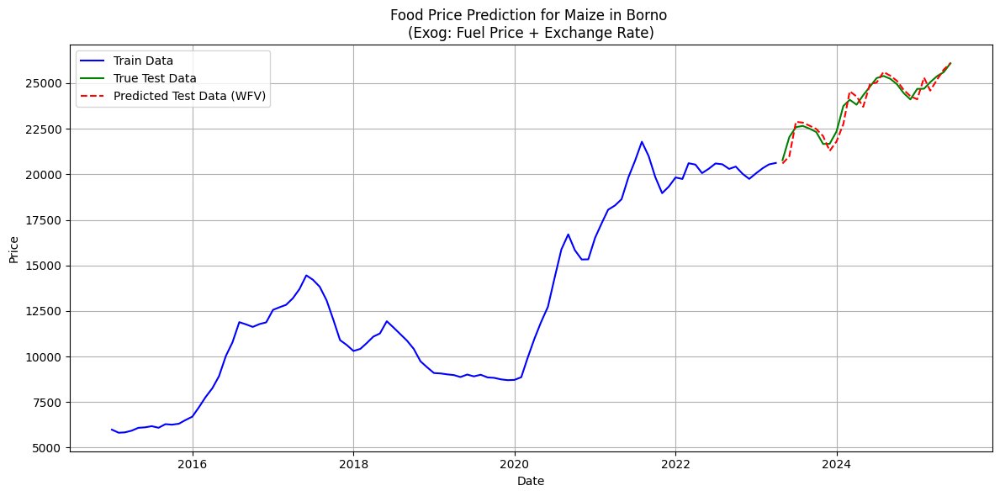


--- Processing: State='Borno', Food_Item='Sorghum' ---


In [ ]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

warnings.filterwarnings("ignore")

# Ensure datetime column
merged_df['Date'] = pd.to_datetime(merged_df['Year'].astype(str) + '-' + merged_df['Month'].astype(str), format='%Y-%m')

# Keep only the three states of interest
selected_states = ['Borno']
filtered_df = merged_df[merged_df['State'].isin(selected_states)]

# Average price per state, food, and time (include Exchange Rate)
df_avg_price = filtered_df.groupby(['State', 'Food_Item', 'Date'])[
    ['Price', 'Fuel_Diesel_Price', 'Exchange_Rate(USD-NGN)']
].mean().reset_index()

df_avg_price = df_avg_price.sort_values(by=['State', 'Food_Item', 'Date'])

# Unique combinations
unique_combinations = df_avg_price[['State', 'Food_Item']].drop_duplicates()

# Loop through combinations
for index, row in unique_combinations.iterrows():
    state = row['State']
    food_item = row['Food_Item']

    print(f"\n--- Processing: State='{state}', Food_Item='{food_item}' ---")

    subset = df_avg_price[(df_avg_price['State'] == state) & (df_avg_price['Food_Item'] == food_item)].set_index('Date')
    subset = subset.asfreq('MS')

    if len(subset) < 20:
        print(f"Skipping (not enough data points): State='{state}', Food_Item='{food_item}' (Length: {len(subset)})")
        continue

    price_series = subset['Price']
    exog_series = subset[['Fuel_Diesel_Price', 'Exchange_Rate(USD-NGN)']]

    train_size = int(len(price_series) * 0.8)
    train_y, test_y = price_series[:train_size], price_series[train_size:]
    train_exog, test_exog = exog_series[:train_size], exog_series[train_size:]

    predictions = []
    true_values = test_y.tolist()
    history_y = train_y.copy()
    history_exog = train_exog.copy()

    for t in range(len(test_y)):
        try:
            model = auto_arima(history_y,
                               exogenous=history_exog,
                               start_p=1, start_q=1,
                               test='adf',
                               max_p=5, max_q=5,
                               m=12,
                               seasonal=True,
                               start_P=0,
                               trace=False,
                               error_action='ignore',
                               suppress_warnings=True,
                               stepwise=True)

            next_exog = test_exog.iloc[[t]]
            yhat = model.predict(n_periods=1, exogenous=next_exog)[0]
            predictions.append(yhat)

            # Update history with true test value
            history_y = pd.concat([history_y, test_y.iloc[[t]]])
            history_exog = pd.concat([history_exog, next_exog])
        except Exception as e:
            print(f"  Error fitting WFV model for {state}, {food_item} at t={t}: {e}")
            predictions.append(np.nan)
            history_y = pd.concat([history_y, test_y.iloc[[t]]])
            history_exog = pd.concat([history_exog, test_exog.iloc[[t]]])

    predictions_series = pd.Series(predictions, index=test_y.index)

    valid_true = [true_values[i] for i, val in enumerate(predictions) if not np.isnan(val)]
    valid_predictions = [val for val in predictions if not np.isnan(val)]

    if len(valid_true) > 0:
        rmse = np.sqrt(mean_squared_error(valid_true, valid_predictions))
        mae = mean_absolute_error(valid_true, valid_predictions)
        print(f"  RMSE (WFV): {rmse:.2f}")
        print(f"  MAE (WFV): {mae:.2f}")

        print("\n  Final Model Summary (last fit in WFV):")
        print(model.summary())
        print(f"  Non-seasonal order: {model.order}")
        print(f"  Seasonal order: {model.seasonal_order}")

        plt.figure(figsize=(12, 6))
        plt.plot(train_y.index, train_y, label='Train Data', color='blue')
        plt.plot(test_y.index, test_y, label='True Test Data', color='green')
        plt.plot(predictions_series.index, predictions_series, label='Predicted Test Data (WFV)', color='red', linestyle='--')
        plt.title(f'Food Price Prediction for {food_item} in {state} \n(Exog: Fuel Price + Exchange Rate)')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    else:
        print("  No valid predictions to evaluate or plot.")

print("\n--- ARIMA modeling with WFV and multiple exogenous variables complete. ---")


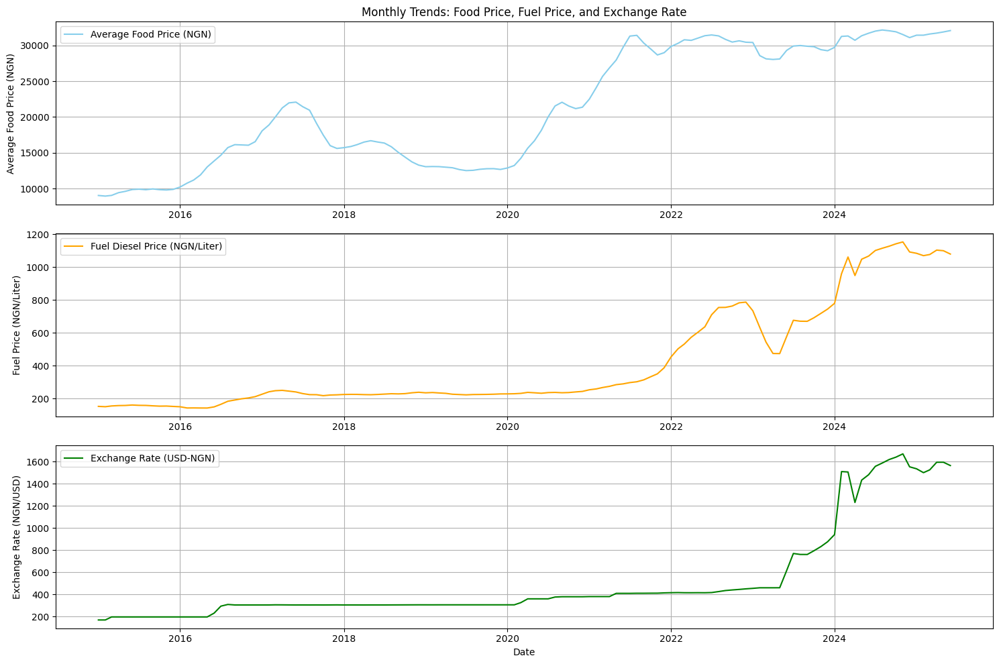

Line plots generated successfully, showing monthly trends of average food prices, fuel prices, and exchange rates.


In [204]:
monthly_trends = merged_df.groupby('Date').agg({
    'Price': 'mean',
    'Fuel_Diesel_Price': 'mean',
    'Exchange_Rate(USD-NGN)': 'mean'
}).reset_index()

# Set 'Date' as index for easier plotting
monthly_trends = monthly_trends.set_index('Date')

# --- Plotting the data ---
plt.figure(figsize=(15, 10))

# Subplot 1: Average Food Price
plt.subplot(3, 1, 1) # 3 rows, 1 column, 1st plot
plt.plot(monthly_trends.index, monthly_trends['Price'], label='Average Food Price (NGN)', color='skyblue')
plt.title('Monthly Trends: Food Price, Fuel Price, and Exchange Rate')
plt.ylabel('Average Food Price (NGN)')
plt.legend()
plt.grid(True)

# Subplot 2: Fuel Diesel Price
plt.subplot(3, 1, 2) # 3 rows, 1 column, 2nd plot
plt.plot(monthly_trends.index, monthly_trends['Fuel_Diesel_Price'], label='Fuel Diesel Price (NGN/Liter)', color='orange')
plt.ylabel('Fuel Price (NGN/Liter)')
plt.legend()
plt.grid(True)

# Subplot 3: Exchange Rate (USD-NGN)
plt.subplot(3, 1, 3) # 3 rows, 1 column, 3rd plot
plt.plot(monthly_trends.index, monthly_trends['Exchange_Rate(USD-NGN)'], label='Exchange Rate (USD-NGN)', color='green')
plt.xlabel('Date')
plt.ylabel('Exchange Rate (NGN/USD)')
plt.legend()
plt.grid(True)

plt.tight_layout() # Adjust layout to prevent overlapping titles/labels
plt.show()

print("Line plots generated successfully, showing monthly trends of average food prices, fuel prices, and exchange rates.")


In [220]:
unique_states = merged_df['State'].unique()
unique_food_items = merged_df['Food_Item'].unique()

print(f"Unique States: {unique_states}")
print(f"Unique Food Items: {unique_food_items}\n")

all_granger_results = {} # To store all results for deeper analysis

# --- Granger Causality Test for Fuel Diesel Price --> Food Price ---
print("--- Starting Granger Causality Tests: Fuel Diesel Price --> Food Price ---")
for state in unique_states:
    for item in unique_food_items:
        print(f"\n--- Testing: {item} in {state} (Dependent: Price, Independent: Fuel_Diesel_Price) ---")

        # Select relevant columns and filter for current state-item combo
        data_subset = merged_df[(merged_df['State'] == state) & (merged_df['Food_Item'] == item)].copy()
        
        # IMPORTANT: Perform differencing for stationarity before Granger causality if your data is non-stationary
        # Assuming you've already determined the appropriate differencing order (e.g., 1st difference)
        data_subset['Price_diff'] = data_subset['Price'].diff()
        data_subset['Fuel_Diesel_Price_diff'] = data_subset['Fuel_Diesel_Price'].diff()
        
        # Drop NaN values created by differencing
        data_gc = data_subset[['Price_diff', 'Fuel_Diesel_Price_diff']].dropna()

        maxlag = 12 # Test up to 12 months lag

        # Ensure enough observations for maxlag
        if len(data_gc) > maxlag * 2 + 1: # A common heuristic for minimum data points
            try:
                gc_test_result = grangercausalitytests(data_gc, maxlag=maxlag, verbose=False)
                
                # Store results for this specific state-item pair
                key = f"{state}_{item}_Fuel"
                all_granger_results[key] = gc_test_result

                print(f"  Results for {item} in {state}:")
                found_significant_lag = False
                for lag in range(1, maxlag + 1):
                    p_value_f_test = gc_test_result[lag][0]['ssr_ftest'][1]
                    if p_value_f_test < 0.05:
                        print(f"    Lag {lag}: p-value = {p_value_f_test:.4f} (Significant at 5%)")
                        found_significant_lag = True
                if not found_significant_lag:
                    print(f"    No significant Granger Causality found for any lag (1-{maxlag}) at 5% level.")

            except ValueError as e:
                print(f"  Error running Granger Causality for {item} in {state}: {e}")
                print("  This often happens if there's insufficient variation or perfect multicollinearity in the differenced series.")
        else:
            print(f"  Not enough data ({len(data_gc)} observations) for {item} in {state} to run Granger Causality tests with maxlag={maxlag}.")
        print("-" * 60)

# --- Repeat the above loop for Exchange Rate --> Food Price ---
print("\n--- Starting Granger Causality Tests: Exchange Rate --> Food Price ---")
for state in unique_states:
    for item in unique_food_items:
        print(f"\n--- Testing: {item} in {state} (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---")

        data_subset = merged_df[(merged_df['State'] == state) & (merged_df['Food_Item'] == item)].copy()
        data_subset['Price_diff'] = data_subset['Price'].diff()
        data_subset['Exchange_Rate(USD-NGN)_diff'] = data_subset['Exchange_Rate(USD-NGN)'].diff()
        
        data_gc = data_subset[['Price_diff', 'Exchange_Rate(USD-NGN)_diff']].dropna()

        maxlag = 12

        if len(data_gc) > maxlag * 2 + 1:
            try:
                gc_test_result = grangercausalitytests(data_gc, maxlag=maxlag, verbose=False)
                
                key = f"{state}_{item}_ExchangeRate"
                all_granger_results[key] = gc_test_result

                print(f"  Results for {item} in {state}:")
                found_significant_lag = False
                for lag in range(1, maxlag + 1):
                    p_value_f_test = gc_test_result[lag][0]['ssr_ftest'][1]
                    if p_value_f_test < 0.05:
                        print(f"    Lag {lag}: p-value = {p_value_f_test:.4f} (Significant at 5%)")
                        found_significant_lag = True
                if not found_significant_lag:
                    print(f"    No significant Granger Causality found for any lag (1-{maxlag}) at 5% level.")
            except ValueError as e:
                print(f"  Error running Granger Causality for {item} in {state}: {e}")
                print("  This often happens if there's insufficient variation or perfect multicollinearity in the differenced series.")
        else:
            print(f"  Not enough data ({len(data_gc)} observations) for {item} in {state} to run Granger Causality tests with maxlag={maxlag}.")
        print("-" * 60)

Unique States: ['Abia' 'Adamawa' 'Borno' 'Gombe' 'Jigawa' 'Kaduna' 'Kano' 'Katsina'
 'Kebbi' 'Lagos' 'Oyo' 'Yobe' 'Zamfara']
Unique Food Items: ['Cassava_meal' 'Gari' 'Groundnuts' 'Maize' 'Sorghum']

--- Starting Granger Causality Tests: Fuel Diesel Price --> Food Price ---

--- Testing: Cassava_meal in Abia (Dependent: Price, Independent: Fuel_Diesel_Price) ---
  Results for Cassava_meal in Abia:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Gari in Abia (Dependent: Price, Independent: Fuel_Diesel_Price) ---
  Results for Gari in Abia:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Groundnuts in Abia (Dependent: Price, Independent: Fuel_Diesel_Price) ---
  Results for Groundnuts in Abia:
    No significant Granger Causality found for any lag (1-12) at 5% level.
--------------------

  Results for Maize in Kano:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Sorghum in Kano (Dependent: Price, Independent: Fuel_Diesel_Price) ---
  Results for Sorghum in Kano:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Cassava_meal in Katsina (Dependent: Price, Independent: Fuel_Diesel_Price) ---
  Results for Cassava_meal in Katsina:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Gari in Katsina (Dependent: Price, Independent: Fuel_Diesel_Price) ---
  Results for Gari in Katsina:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Groundnuts in Katsina (Dependent: Price, Independ

  Results for Sorghum in Abia:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Cassava_meal in Adamawa (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---
  Results for Cassava_meal in Adamawa:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Gari in Adamawa (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---
  Results for Gari in Adamawa:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Groundnuts in Adamawa (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---
  Results for Groundnuts in Adamawa:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Maize in Adamawa (De

  Results for Sorghum in Katsina:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Cassava_meal in Kebbi (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---
  Results for Cassava_meal in Kebbi:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Gari in Kebbi (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---
  Results for Gari in Kebbi:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Groundnuts in Kebbi (Dependent: Price, Independent: Exchange_Rate(USD-NGN)) ---
  Results for Groundnuts in Kebbi:
    No significant Granger Causality found for any lag (1-12) at 5% level.
------------------------------------------------------------

--- Testing: Maize in Kebbi (Dependent: Pr

--- Plotting Gari in Borno ---


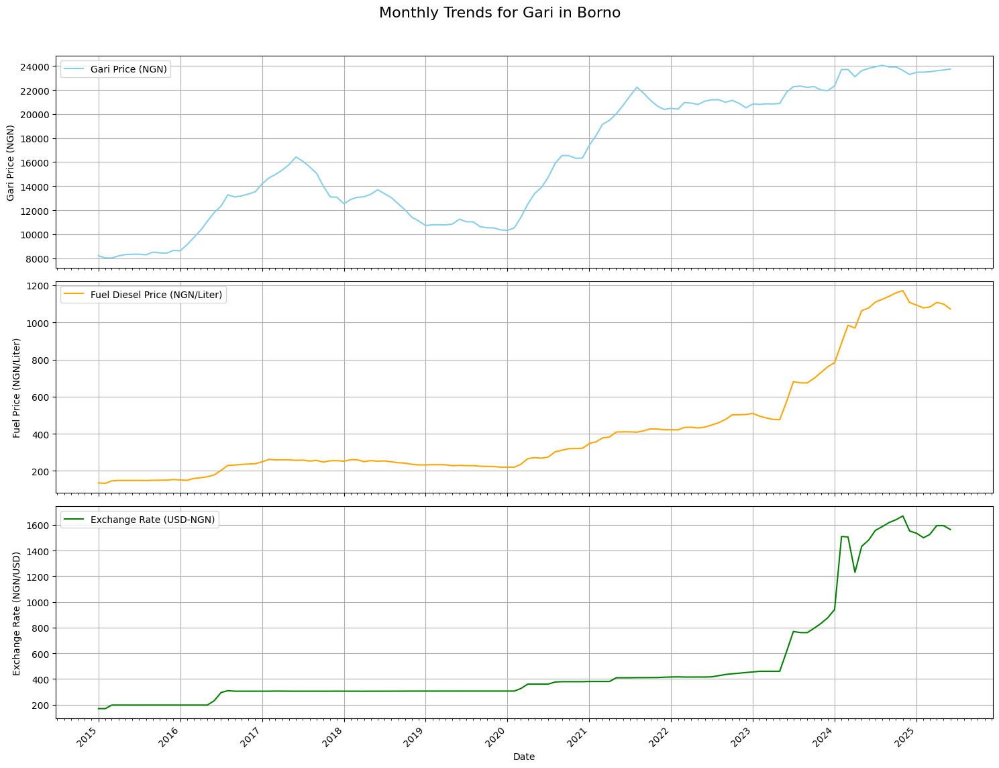


--- Plotting Gari in Yobe ---


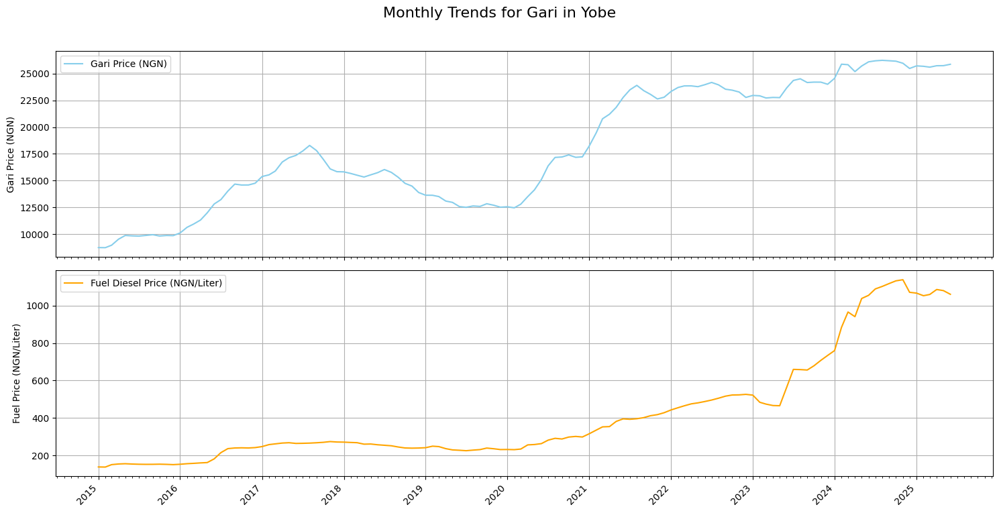


--- Plotting Groundnuts in Yobe ---


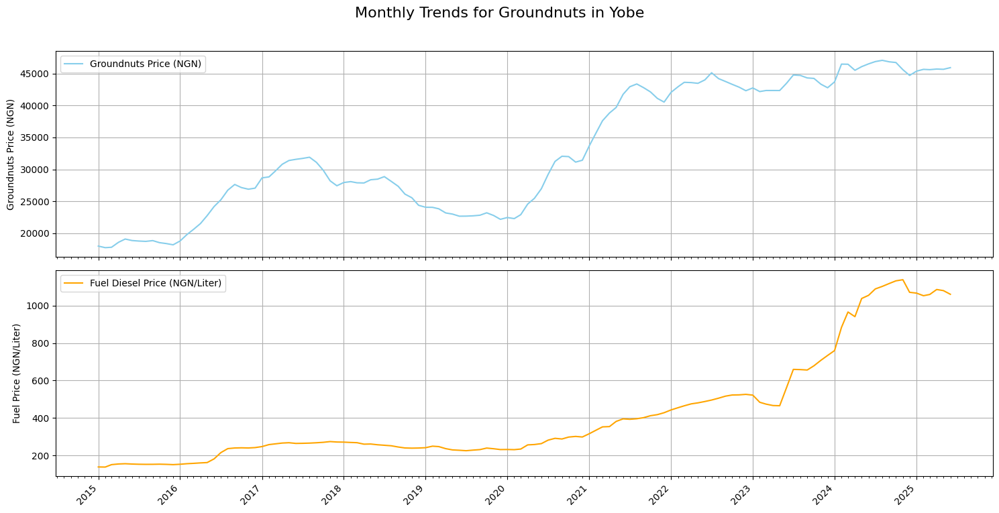


--- Plotting Maize in Yobe ---


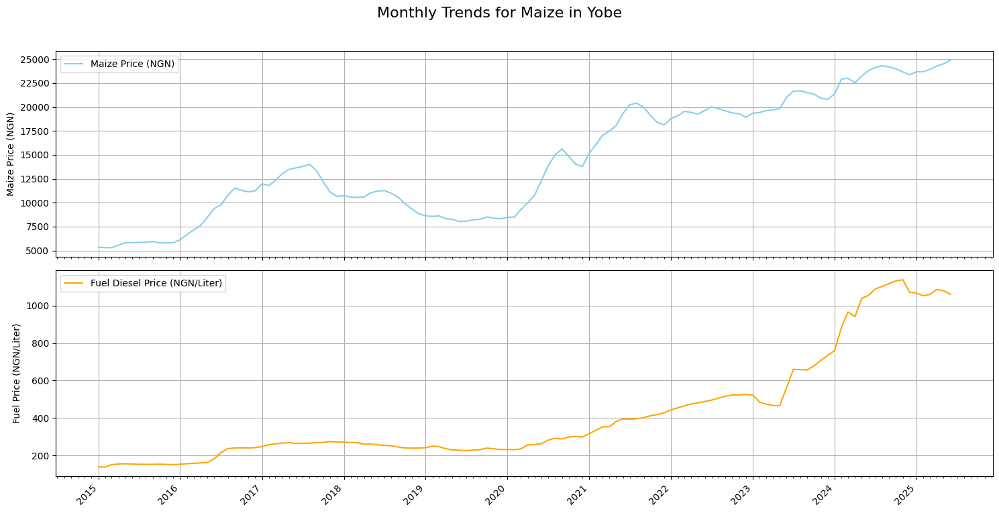


--- Plotting Sorghum in Yobe ---


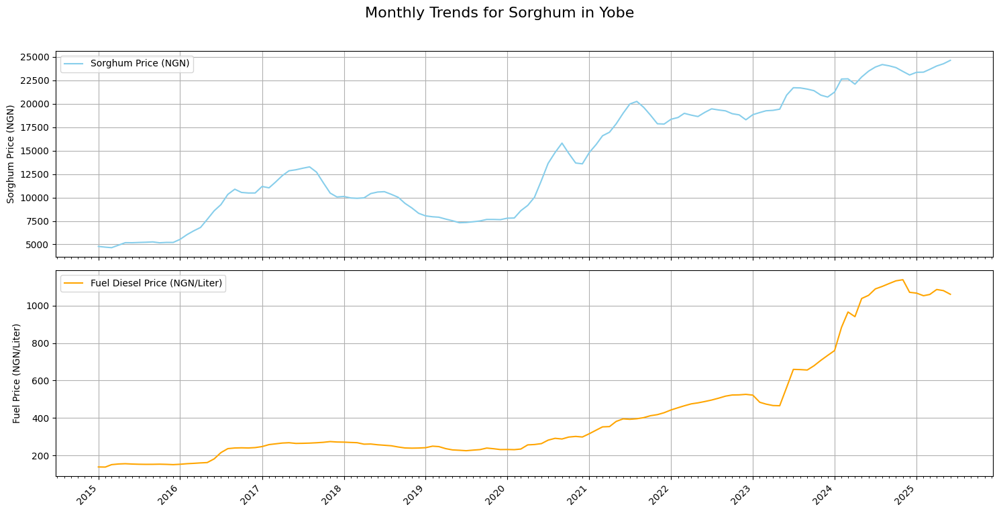


Individual line plots generated successfully.


In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Assuming merged_df is already loaded and preprocessed as in your original environment
# Example structure for merged_df (replace with your actual data loading)
# data = {
#     'Date': pd.to_datetime(pd.date_range(start='2020-01-01', periods=60, freq='M').tolist() * 13 * 5),
#     'State': ['Abia', 'Adamawa', 'Borno', 'Gombe', 'Jigawa', 'Kaduna', 'Kano', 'Katsina', 'Kebbi', 'Lagos', 'Oyo', 'Yobe', 'Zamfara'] * (60 * 5),
#     'Food_Item': (['Cassava_meal', 'Gari', 'Groundnuts', 'Maize', 'Sorghum'] * 13 * 60),
#     'Price': [i * 100 + j for i in range(60) for j in range(13 * 5)],
#     'Fuel_Diesel_Price': [200 + i * 5 for i in range(60)] * (13 * 5),
#     'Exchange_Rate(USD-NGN)': [400 + i * 10 for i in range(60)] * (13 * 5)
# }
# merged_df = pd.DataFrame(data)
# merged_df['Price'] = merged_df['Price'].mask(merged_df['Food_Item'] == 'Gari', merged_df['Price'] * 1.2) # Example for variation
# merged_df['Price'] = merged_df['Price'].mask(merged_df['State'] == 'Borno', merged_df['Price'] * 1.5) # Example for variation
# merged_df = merged_df.sort_values(by=['Date', 'State', 'Food_Item']).reset_index(drop=True)


def plot_specific_trends(df, food_item, state, plot_exchange_rate=True):
    """
    Plots the price trend for a specific food item in a given state,
    along with Fuel Diesel Price and optionally Exchange Rate.
    """
    filtered_df = df[(df['Food_Item'] == food_item) & (df['State'] == state)].copy()
    filtered_df = filtered_df.set_index('Date')
    filtered_df = filtered_df.sort_index() # Ensure chronological order

    if filtered_df.empty:
        print(f"No data found for {food_item} in {state}. Skipping plot.")
        return

    num_plots = 2 if plot_exchange_rate else 1
    fig, axes = plt.subplots(num_plots + 1, 1, figsize=(15, 4 * (num_plots + 1)), sharex=True)
    fig.suptitle(f'Monthly Trends for {food_item} in {state}', fontsize=16)

    # Plot 1: Food Item Price
    axes[0].plot(filtered_df.index, filtered_df['Price'], label=f'{food_item} Price (NGN)', color='skyblue')
    axes[0].set_ylabel(f'{food_item} Price (NGN)')
    axes[0].legend()
    axes[0].grid(True)

    # Plot 2: Fuel Diesel Price
    axes[1].plot(filtered_df.index, filtered_df['Fuel_Diesel_Price'], label='Fuel Diesel Price (NGN/Liter)', color='orange')
    axes[1].set_ylabel('Fuel Price (NGN/Liter)')
    axes[1].legend()
    axes[1].grid(True)

    # Plot 3: Exchange Rate (if requested)
    if plot_exchange_rate:
        axes[2].plot(filtered_df.index, filtered_df['Exchange_Rate(USD-NGN)'], label='Exchange Rate (USD-NGN)', color='green')
        axes[2].set_ylabel('Exchange Rate (NGN/USD)')
        axes[2].set_xlabel('Date')
        axes[2].legend()
        axes[2].grid(True)

    # Format x-axis for better readability
    for ax in axes:
        ax.xaxis.set_major_locator(mdates.YearLocator())
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        ax.xaxis.set_minor_locator(mdates.MonthLocator())
        plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha="right")


    plt.tight_layout(rect=[0, 0.03, 1, 0.96]) # Adjust layout to prevent overlapping titles/labels
    plt.show()

# --- Call the function for specific combinations ---

print("--- Plotting Gari in Borno ---")
plot_specific_trends(merged_df, 'Gari', 'Borno', plot_exchange_rate=True)

print("\n--- Plotting Gari in Yobe ---")
plot_specific_trends(merged_df, 'Gari', 'Yobe', plot_exchange_rate=False) # Only Fuel Diesel showed causality

print("\n--- Plotting Groundnuts in Yobe ---")
plot_specific_trends(merged_df, 'Groundnuts', 'Yobe', plot_exchange_rate=False) # Only Fuel Diesel showed causality

print("\n--- Plotting Maize in Yobe ---")
plot_specific_trends(merged_df, 'Maize', 'Yobe', plot_exchange_rate=False) # Only Fuel Diesel showed causality

print("\n--- Plotting Sorghum in Yobe ---")
plot_specific_trends(merged_df, 'Sorghum', 'Yobe', plot_exchange_rate=False) # Only Fuel Diesel showed causality

print("\nIndividual line plots generated successfully.")

    # TESTS


--- Processing: State='Yobe', Food_Item='Gari' ---
  RMSE (WFV): 395.27
  MAE (WFV): 296.92
  MAPE (WFV): 1.17%

  Final Model Summary (last fit in WFV):
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  115
Model:             SARIMAX(1, 1, 1)x(1, 0, 1, 12)   Log Likelihood                -831.890
Date:                            Sat, 07 Jun 2025   AIC                           1675.780
Time:                                    16:22:32   BIC                           1692.197
Sample:                                11-01-2015   HQIC                          1682.443
                                     - 05-01-2025                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------

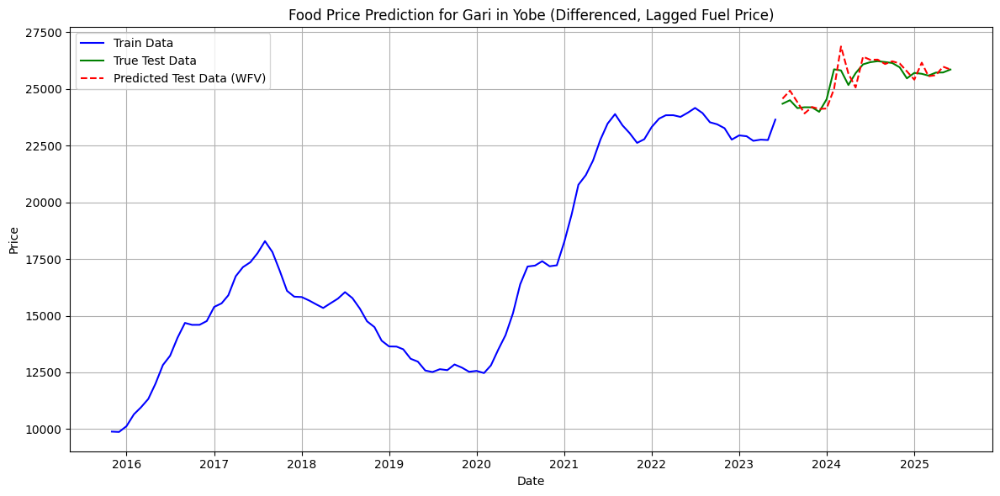


--- ARIMAX modeling for Gari in Borno with specific differenced, lagged exogenous variables complete. ---


In [53]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

# --- Initial Data Preparation ---
# Ensure datetime column
merged_df['Date'] = pd.to_datetime(merged_df['Year'].astype(str) + '-' + merged_df['Month'].astype(str), format='%Y-%m')

# Filter specifically for Borno State and Gari food item
state = 'Yobe'
food_item = 'Gari'

print(f"\n--- Processing: State='{state}', Food_Item='{food_item}' ---")

# Extract the specific subset for Gari in Borno
subset = merged_df[(merged_df['State'] == state) & (merged_df['Food_Item'] == food_item)].set_index('Date')
subset = subset.asfreq('MS') # Ensure monthly frequency

# --- Define the specific significant lags for Fuel_Diesel_Price ---
# These are the lags you provided for Gari in Borno
SIGNIFICANT_EXOG_LAGS = [1, 9]

# --- Prepare Differenced Exogenous Variables with Lags ---
# Drop rows with any NaN values in core columns that might arise from asfreq initially
subset = subset.dropna(subset=['Price', 'Fuel_Diesel_Price'])

# First, difference the Fuel_Diesel_Price series.
subset['Fuel_Diesel_Price_Diff'] = subset['Fuel_Diesel_Price'].diff(1)

# Create lagged columns for the DIFFERENCED Fuel_Diesel_Price
exog_columns = []
for lag in SIGNIFICANT_EXOG_LAGS:
    col_name = f'Fuel_Diesel_Price_Diff_Lag_{lag}'
    subset[col_name] = subset['Fuel_Diesel_Price_Diff'].shift(lag)
    exog_columns.append(col_name)

# Drop any rows at the beginning that now have NaNs due to differencing or lagging.
# This ensures perfect alignment between dependent and independent variables.
subset_for_model = subset.dropna(subset=exog_columns + ['Price'])

# Define your price series and the prepared exogenous data
price_series = subset_for_model['Price']
exog_data_full = subset_for_model[exog_columns]

# Ensure exog_data_full is a DataFrame for auto_arima
if not isinstance(exog_data_full, pd.DataFrame):
    exog_data_full = exog_data_full.to_frame()

if len(price_series) < 20:
    print(f"Skipping (not enough data points after preprocessing): State='{state}', Food_Item='{food_item}' (Length: {len(price_series)})")
else:
    # --- Split Data for Walk-Forward Validation ---
    train_size = int(len(price_series) * 0.8)

    train_y, test_y = price_series[:train_size], price_series[train_size:]
    train_exog, test_exog = exog_data_full[:train_size], exog_data_full[train_size:]

    predictions = []
    history_y = train_y.copy()
    history_exog = train_exog.copy()

    # --- Walk-Forward Validation Loop ---
    for t in range(len(test_y)):
        try:
            # Get the current exogenous data point for prediction
            current_test_exog_point = test_exog.iloc[[t]]

            # Fit auto_arima model with the pre-differenced and lagged exogenous variables
            model = auto_arima(history_y,
                               exogenous=history_exog,
                               start_p=0, start_q=0,
                               test='adf',
                               max_p=5, max_q=5,
                               m=12, # Monthly seasonality
                               seasonal=True,
                               start_P=0, start_Q=0,
                               max_P=2, max_Q=2,
                               trace=False,
                               error_action='ignore',
                               suppress_warnings=True,
                               stepwise=True)

            # Predict the next step using the current (future) exogenous data
            yhat = model.predict(n_periods=1, exogenous=current_test_exog_point)[0]
            predictions.append(yhat)

            # Update history with the true test value and its corresponding exogenous data
            history_y = pd.concat([history_y, pd.Series([test_y.iloc[t]], index=[test_y.index[t]])])
            history_exog = pd.concat([history_exog, current_test_exog_point])

        except Exception as e:
            print(f"  Error fitting WFV model for {state}, {food_item} at t={t}: {e}")
            predictions.append(np.nan)
            # Still append to history to move forward, even if prediction failed
            history_y = pd.concat([history_y, pd.Series([test_y.iloc[t]], index=[test_y.index[t]])])
            history_exog = pd.concat([history_exog, test_exog.iloc[[t]]]) # Use actual test_exog for history

    predictions_series = pd.Series(predictions, index=test_y.index)

    # --- Evaluate and Plot Results ---
    valid_true = [test_y.iloc[i] for i, val in enumerate(predictions) if not np.isnan(val)]
    valid_predictions = [val for val in predictions if not np.isnan(val)]

    if len(valid_true) > 0:
        rmse = np.sqrt(mean_squared_error(valid_true, valid_predictions))
        mae = mean_absolute_error(valid_true, valid_predictions)
        mape = np.mean(np.abs((np.array(valid_true) - np.array(valid_predictions)) / np.array(valid_true))) * 100
        print(f"  RMSE (WFV): {rmse:.2f}")
        print(f"  MAE (WFV): {mae:.2f}")
        print(f"  MAPE (WFV): {mape:.2f}%")

        print("\n  Final Model Summary (last fit in WFV):")
        if 'model' in locals() and model is not None:
            print(model.summary())
            print(f"  Non-seasonal order: {model.order}")
            print(f"  Seasonal order: {model.seasonal_order}")
        else:
            print("  Model could not be fit successfully in the last iteration.")

        plt.figure(figsize=(12, 6))
        plt.plot(train_y.index, train_y, label='Train Data', color='blue')
        plt.plot(test_y.index, test_y, label='True Test Data', color='green')
        plt.plot(predictions_series.index, predictions_series, label='Predicted Test Data (WFV)', color='red', linestyle='--')
        plt.title(f'Food Price Prediction for {food_item} in {state} (Differenced, Lagged Fuel Price)')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    else:
        print("  No valid predictions to evaluate or plot.")

print("\n--- ARIMAX modeling for Gari in Borno with specific differenced, lagged exogenous variables complete. ---")


--- Processing: State='Borno', Food_Item='Gari' ---
Dataset size (after lookback): 123
Train set size: 86
Validation set size: 18
Test set size: 19

--- Training the LSTM Model ---
Epoch 1/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 236ms/step - loss: 0.1618 - val_loss: 0.6388
Epoch 2/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.1664 - val_loss: 0.6104
Epoch 3/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.1551 - val_loss: 0.5833
Epoch 4/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.1444 - val_loss: 0.5578
Epoch 5/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.1440 - val_loss: 0.5328
Epoch 6/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 0.1384 - val_loss: 0.5079
Epoch 7/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.1204 - val_loss: 0.4833
Epoch 8/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.1273 - val_loss: 0.4573
Epoch 9/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.1166 - val_loss: 0.4308
Epoch 10/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 0.1036 - val

Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_19 (LSTM)                       │ (None, 50)                  │          10,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_19 (Dense)                     │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 31,355 (122.48 KB)

 Trainable params: 10,451 (40.82 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 20,904 (81.66 KB)


--- Evaluating on Test Set ---
Test Loss (MSE): 0.0012
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
RMSE: 545.85
MAE: 399.63
MAPE: 1.69%


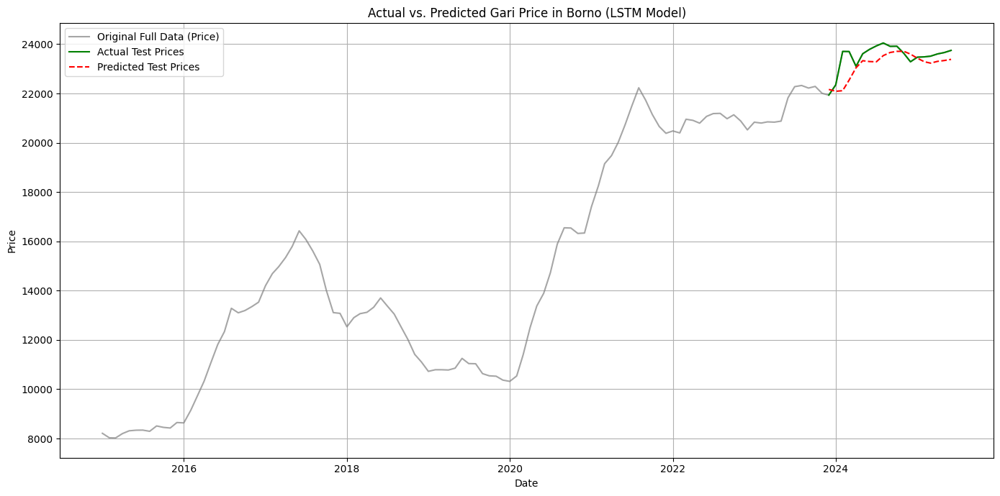

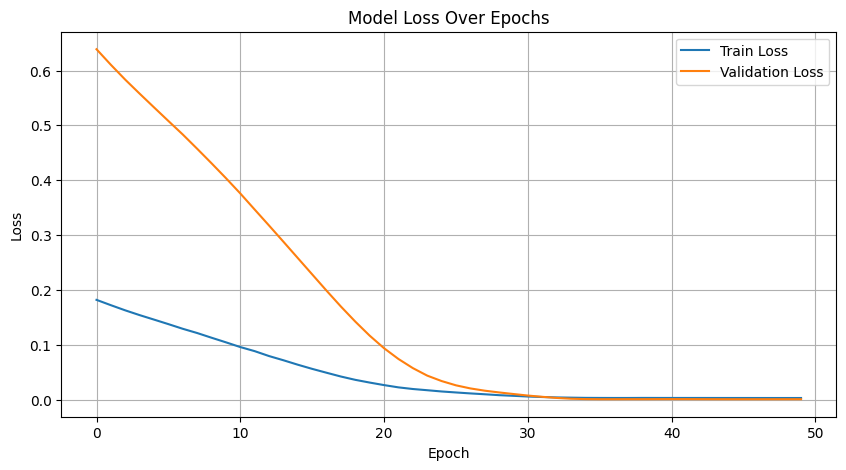


--- LSTM modeling for Gari in Borno complete. ---


In [43]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
import warnings

warnings.filterwarnings("ignore")





# Filter specifically for Borno State and Gari food item
state = 'Yobe'
food_item = 'Gari'

print(f"\n--- Processing: State='{state}', Food_Item='{food_item}' ---")

# Extract the specific subset for Gari in Borno
subset = merged_df[(merged_df['State'] == state) & (merged_df['Food_Item'] == food_item)].copy()
subset = subset.asfreq('MS') # Ensure monthly frequency

# --- Feature Engineering and Preparation for LSTM ---
# You can decide which columns to use as features (exogenous variables)
# Let's use Price, Fuel_Diesel_Price, and Exchange_Rate(USD-NGN) as features
# We'll normalize them together.
features = ['Price']
data_for_lstm = subset[features].dropna() # Drop any rows with missing feature data

if len(data_for_lstm) < 30: # Need enough data for sequence and train/test split
    print(f"Skipping (not enough data points for LSTM after preprocessing): {state}, {food_item} (Length: {len(data_for_lstm)})")
else:
    # 1. Scaling the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(data_for_lstm)

    # 2. Define sequence (lookback) and prediction horizon
    # Lookback: How many past timesteps to consider for prediction
    # For a simple LSTM, a common starting point is 1 to 12. Let's start with 3.
    LOOKBACK = 3
    # We are predicting 1 step ahead (next month's price)

    # Function to create sequences for LSTM
    def create_sequences(data, lookback):
        X, y = [], []
        for i in range(len(data) - lookback):
            # X: sequence of 'lookback' timesteps (all features)
            X.append(data[i:(i + lookback), :])
            # y: the target value (Price) at the next timestep
            y.append(data[i + lookback, 0]) # Assuming 'Price' is the first column (index 0)
        return np.array(X), np.array(y)

    X, y = create_sequences(scaled_data, LOOKBACK)

    # 3. Train-Validation-Test Split
    # Common split: Train (e.g., 70%), Validation (e.g., 15%), Test (e.g., 15%)
    # For time series, it's crucial to maintain chronological order.
    train_split_ratio = 0.7
    val_split_ratio = 0.15 # Remaining 15% for test
    total_samples = len(X)

    train_end = int(total_samples * train_split_ratio)
    val_end = int(total_samples * (train_split_ratio + val_split_ratio))

    X_train, y_train = X[:train_end], y[:train_end]
    X_val, y_val = X[train_end:val_end], y[train_end:val_end]
    X_test, y_test = X[val_end:], y[val_end:]

    print(f"Dataset size (after lookback): {total_samples}")
    print(f"Train set size: {len(X_train)}")
    print(f"Validation set size: {len(X_val)}")
    print(f"Test set size: {len(X_test)}")

    # --- Build the LSTM Model ---
    model = Sequential()
    # Adding a single LSTM layer. You can experiment with more layers and units.
    # The input_shape is (timesteps, features)
    model.add(LSTM(50, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dense(1)) # Output layer for single value prediction (Price)

    # Compile the model
    # Adam optimizer is a good default. Mean Squared Error (MSE) is common for regression.
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    # --- Fine-tuning (Hyperparameter Tuning via Early Stopping) ---
    # EarlyStopping helps prevent overfitting by stopping training when validation loss stops improving.
    # 'patience' is the number of epochs with no improvement after which training will be stopped.
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    print("\n--- Training the LSTM Model ---")
    history = model.fit(X_train, y_train,
                        epochs=50, # Max epochs, EarlyStopping will likely stop it sooner
                        batch_size=32, # Number of samples per gradient update
                        validation_data=(X_val, y_val),
                        callbacks=[early_stopping],
                        verbose=1) # 1 for progress bar, 0 for silent

    # --- Model Summary ---
    print("\n--- LSTM Model Summary ---")
    model.summary()

    # --- Evaluate on Test Set ---
    print("\n--- Evaluating on Test Set ---")
    test_loss = model.evaluate(X_test, y_test, verbose=0)
    print(f"Test Loss (MSE): {test_loss:.4f}")

    # Make predictions
    y_pred_scaled = model.predict(X_test)

    # Inverse transform predictions and actual values to original scale
    # Create dummy arrays to inverse transform only the 'Price' column (index 0)
    # We need to fill other columns with zeros for the scaler to work correctly
    dummy_pred_array = np.zeros((len(y_pred_scaled), len(features)))
    dummy_pred_array[:, 0] = y_pred_scaled.flatten() # Put predictions into the Price column
    y_pred_original = scaler.inverse_transform(dummy_pred_array)[:, 0]

    dummy_test_array = np.zeros((len(y_test), len(features)))
    dummy_test_array[:, 0] = y_test.flatten()
    y_test_original = scaler.inverse_transform(dummy_test_array)[:, 0]

    # --- Evaluate Metrics ---
    rmse = np.sqrt(mean_squared_error(y_test_original, y_pred_original))
    mae = mean_absolute_error(y_test_original, y_pred_original)
    mape = np.mean(np.abs((y_test_original - y_pred_original) / y_test_original)) * 100

    print(f"RMSE: {rmse:.2f}")
    print(f"MAE: {mae:.2f}")
    print(f"MAPE: {mape:.2f}%")

    # --- Plot Actual vs. Predicted Prices ---
    plt.figure(figsize=(14, 7))
    # Get actual dates for the test set for plotting
    test_dates = data_for_lstm.index[len(data_for_lstm) - len(y_test_original):]

    plt.plot(data_for_lstm.index, data_for_lstm['Price'], label='Original Full Data (Price)', color='gray', alpha=0.7)
    plt.plot(test_dates, y_test_original, label='Actual Test Prices', color='green')
    plt.plot(test_dates, y_pred_original, label='Predicted Test Prices', color='red', linestyle='--')

    plt.title(f'Actual vs. Predicted Gari Price in Borno (LSTM Model)')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot training and validation loss
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss Over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.show()

print("\n--- LSTM modeling for Gari in Borno complete. ---")

In [22]:
merged_df

,State,Year,Month,Food_Item,Unit,Price,Fuel_Diesel_Price,Exchange_Rate(USD-NGN)
Date,,,,,,,,
2015-01-01,Abia,2015,1,Cassava_meal,100 KG,9638.490000,160.000000,169.68
2015-01-01,Jigawa,2015,1,Gari,100 KG,6634.610000,160.000000,169.68
2015-01-01,Jigawa,2015,1,Cassava_meal,100 KG,8048.730000,160.000000,169.68
2015-01-01,Lagos,2015,1,Cassava_meal,100 KG,7015.480000,155.000000,169.68
2015-01-01,Lagos,2015,1,Gari,100 KG,5960.810000,155.000000,169.68
...,...,...,...,...,...,...,...,...
2025-06-01,Borno,2025,6,Cassava_meal,100 KG,24407.245926,1072.592593,1564.79
2025-06-01,Borno,2025,6,Gari,100 KG,23747.157037,1072.592593,1564.79
2025-06-01,Borno,2025,6,Groundnuts,100 KG,51287.351111,1072.592593,1564.79
